In [1]:
import os
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings("ignore")
import matplotlib.pyplot as plt
import seaborn as sns

In [5]:
os.makedirs('ccxt/return/')

path = 'ccxt/binance/numerai_symbols/'
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    if name == 'AGIX_USDT':
        df = pd.read_csv(path + full_name)

        df['return'] = df['Close'].pct_change()
        
        df.to_csv(f'ccxt/return/{name}.csv',index=False)


##### convert output.txt to csv

In [9]:
import pandas as pd

# Read the text file
with open('output.txt', 'r') as file:
    data = file.read()

# Split the data into individual entries
entries = data.split('symbol: ')[1:]

# Prepare lists for each column
symbols = []
markets = []
current_prices = []
circulating_supplies = []

# Process each entry
for entry in entries:
    parts = entry.split('|')
    symbol = parts[0].strip()
    market = parts[1].split(':')[1].strip()
    current_price = parts[2].split(':')[1].strip()
    circulating_supply = parts[3].split(':')[1].strip()
    
    symbols.append(symbol)
    markets.append(market)
    current_prices.append(current_price)
    circulating_supplies.append(circulating_supply)

# Create a DataFrame
df = pd.DataFrame({
    'symbol': symbols,
    'market Cap': markets,
    'Current Price': current_prices,
    'Circulating Supply': circulating_supplies
})

# Save to CSV
df.to_csv('output.csv', index=False)

In [10]:
df

,symbol,market Cap,Current Price,Circulating Supply
0,ETH/USDT,361697443158.8958,3007.8,120253156.18023
1,BNB/USDT,80398643017.869,551.1,145887575.79
2,SOL/USDT,72320048937.11644,155.44,465260222.189375
3,XRP/USDT,30917204668.795002,0.5521,55999283950.0
4,DOGE/USDT,16208426801.510778,0.11152,145340986383.705
...,...,...,...,...
176,QUICK/USDT,17206.967061274365,0.02392,719354.810253945
177,POLS/USDT,30605700.9128,0.3079,99401432.0
178,BIFI/USDT,18536000.0,231.7,80000.0
179,AKRO/USDT,393000.00000000006,0.00393,100000000.0


In [21]:
import os
market_cap = pd.read_csv('output.csv')
os.makedirs('ccxt/market_cap/')

path = 'ccxt/return/'
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    for index, row in market_cap.iterrows():
        if row['symbol'] == name.replace('_', '/'):
            df['Market_Cap'] = df['Close'] * row['Circulating Supply']
            df.to_csv(f"ccxt/market_cap/{name}.csv", index=False)

In [7]:
import os
import pandas as pd
market_cap = pd.read_csv('output.csv')
path = 'ccxt/return/'
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    for index, row in market_cap.iterrows():
        if 'OCEAN/USDT' == name.replace('_', '/') or 'AGIX/USDT' == name.replace('_', '/'):
            df = pd.read_csv(path + full_name)
            df['Market_Cap'] = df['Close'] * row['Circulating Supply']
            df.to_csv(f"ccxt/market_cap/{name}.csv", index=False)

#### Cunstruct Factors

##### market cap

In [ ]:
df['market_cap'] = df['Close'] * circulating_supply


##### Momentum

In [ ]:
df['Momentum'] = df['Close'].pct_change(periods=14)

##### Volatility

In [ ]:
df['Volatility'] = df['Return'].rolling(window=30).std()

##### Liquidity

In [ ]:
df['Liquidity'] = df['Volume'].rolling(window=30).mean()

##### Market Factor

In [ ]:
risk_free_rate = .0425 # Example: 0.01% daily risk-free rate
market_data['Market_Factor'] = market_data['Return'] - risk_free_rate

##### Size Factor

In [10]:
df.columns

Index(['Open', 'High', 'Low', 'Close', 'Volume', 'Bid Price', 'Ask Price',
       'Bid Depth', 'Ask Depth', 'Bid-Ask Spread', 'return', 'Market_Cap',
       'Momentum', 'Volatility', 'Liquidity', 'amihud_illiquidity',
       'Market_Factor', 'Size', 'size_factor', 'Date', 'NVT', 'NVT_rank',
       'HML', 'size_rank', 'SMB'],
      dtype='object')

In [33]:
df['Size'] = pd.cut(df['Market_Cap'], bins=[0,  1e8, float('inf')], labels=['Small', 'Large'])

small_caps = df[df['Size'] == 'Small']['return'].mean()
large_caps = df[df['Size'] == 'Large']['return'].mean()

print(name , small_caps , large_caps)
small_caps - large_caps


ZRX_USDT nan 0.00040688103286094557


nan

In [9]:
smb_series = []

for timestamp, group in df.groupby(df.index):
    group['size_rank'] = group['Market_Cap'].rank()
    
    small_threshold = group['size_rank'].quantile(0.1)
    large_threshold = group['size_rank'].quantile(0.9)
    
    small_group = group[group['size_rank'] <= small_threshold]
    large_group = group[group['size_rank'] > large_threshold]
    print('small:', small_group['return'].mean(), 'large:', large_group['return'].mean())
    smb = small_group['return'].mean() - large_group['return'].mean()
    smb_series.append((timestamp, smb))

df_smb = pd.DataFrame(smb_series, columns=['Timestamp', 'SMB']).set_index('Timestamp')
df_smb.isnull().sum()


small: 0.0 large: nan
small: 0.0293307647345617 large: nan
small: 0.0672040261979762 large: nan
small: -0.0085622050110305 large: nan
small: -0.0308484269651845 large: nan
small: -0.0016671693708142 large: nan
small: -0.010066189872335 large: nan
small: 0.0040199787187686 large: nan
small: 0.0176933830382106 large: nan
small: -0.0291878246190805 large: nan
small: -0.0557782084099891 large: nan
small: 0.0047619943565371 large: nan
small: -0.0572252454931131 large: nan
small: 0.020400544052006 large: nan
small: 0.0285134561560416 large: nan
small: -0.0181801250797429 large: nan
small: -0.0405110571078921 large: nan
small: 0.0230071978719643 large: nan
small: -0.0070033212683695 large: nan
small: 0.0318887737102386 large: nan
small: -0.0887686235294357 large: nan
small: 0.0185104081726477 large: nan
small: 0.0466703568993491 large: nan
small: 0.0087537503352255 large: nan
small: -0.0142911663529564 large: nan
small: 0.0041002230706774 large: nan
small: -0.0123063993171524 large: nan
small

SMB    1000
dtype: int64

In [2]:
path = 'ccxt/factors/'
risk_free_rate = .0425 
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    df['size_rank'] = df['Market_Cap'].rank()

    small_threshold = df['size_rank'].quantile(0.5)
    large_threshold = df['size_rank'].quantile(0.5)
    small_group = df[df['size_rank'] <= small_threshold]
    large_group = df[df['size_rank'] > large_threshold]
    smb = small_group['return'].mean() - large_group['return'].mean()
    df['SMB'] = smb
    print(name, smb)
    # df.to_csv(f'ccxt/factors/{name}.csv',index=False)



1INCH_USDT -0.0005204184490632468
AAVE_USDT -0.007007440365634721
ADA_USDT 0.00027988159472584566
AKRO_USDT -0.007506949454215008
ALGO_USDT 0.0006139604780963791
ALICE_USDT -0.0021200175604903938
ALPHA_USDT -0.0063044763156079806
ARDR_USDT -0.005062556066378135
ARPA_USDT -0.0024606164235598344
AR_USDT -0.004794091311494587
ATOM_USDT -0.004100900840512935
AUCTION_USDT -0.004601403356174883
AUDIO_USDT -0.0013699177283822634
AVAX_USDT 0.00046212707196106466
AXS_USDT -0.0013198669922866932
BADGER_USDT -0.0031875780190559286
BAL_USDT -0.004021792588598209
BAND_USDT -0.009119072517778607
BAT_USDT -0.0033886769262368287
BCH_USDT -0.0017605513818338015
BLZ_USDT -0.002560779869001847
BNB_USDT -0.0038294280175892054
BTC_USDT -0.0022823339363817505


KeyboardInterrupt: 

##### Value Factor

In [ ]:
df['Value'] = pd.cut(df['P/E Ratio'], bins=[0, 10, 20, float('inf')], labels=['High', 'Medium', 'Low'])

high_value = df[df['Value'] == 'High']['Return'].mean()
low_value = df[df['Value'] == 'Low']['Return'].mean()

HML = high_value - low_value

In [10]:

# Calculate NVT ratio
df['NVT'] = df['Market_Cap'] / df['Volume']

# Calculate HML specific for BTC
def calculate_hml(df):
    nvt = df['NVT']
    returns = df['return']
    
    # Separate into high and low NVT ranks
    nvt_ranks = nvt.rank()
    high_group = returns[nvt_ranks > nvt_ranks.quantile(0.7)]
    low_group = returns[nvt_ranks <= nvt_ranks.quantile(0.3)]
    
    # Calculate average returns for high and low groups
    high_return = high_group.mean() if not high_group.empty else 0
    low_return = low_group.mean() if not low_group.empty else 0
    
    # Calculate HML factor
    return low_return - high_return

# Calculate HML
hml_value = calculate_hml(df)

print(hml_value)

0.028440600101374378


In [29]:

path = 'AI tokens/'
risk_free_rate = .0425 
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    df['NVT'] = df['Market_Cap'] / df['Volume']
    window_size = 15
    df['NVT_rank'] = df['NVT'].rolling(window=window_size).apply(lambda x: x.rank().iloc[-1])
    high_threshold = df['NVT_rank'].quantile(0.7)
    low_threshold = df['NVT_rank'].quantile(0.3)
    df['HML'] = np.nan
    for i in range(window_size, len(df)):
        current_rank = df['NVT_rank'].iloc[i]
        if current_rank > high_threshold:
            df['HML'].iloc[i] = -df['return'].iloc[i] 
        elif current_rank <= low_threshold:
            df['HML'].iloc[i] = df['return'].iloc[i]  
    # print(df['HML'].isna().sum())
    df['HML'].fillna(0, inplace=True)
    df.to_csv(f'AI tokens/{name}.csv',index=False)



##### factors

In [31]:
import os 
import pandas as pd
path = 'ccxt/factors/'
risk_free_rate = .0425 
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    df['Momentum'] = df['Close'].pct_change(periods=14)
    df['Volatility'] = df['return'].rolling(window=30).std()
    df['Liquidity'] = df['Volume'].rolling(window=30).mean()
    df['amihud_illiquidity'] = (df['return'].abs() / df['Volume']).rolling(window=30).mean()

    df['Market_Factor'] = df['return'] - risk_free_rate

    df['Size'] = pd.cut(df['Market_Cap'], bins=[0,  1e6, 1e8, float('inf')], labels=['Small','medium', 'Large'])
    df['size_factor'] = df.apply(lambda row: -1 if row['Size'] == 'Large' else 1 if row['Size'] == 'Small' else 0, axis=1)
    
    df.to_csv(f'ccxt/factors/{name}.csv',index=False)


1INCH_USDT    mom -21.50338312878603    vol 41.74754239596665    liq 10098308643.011333    iliq 4.296310542718042e-06
AAVE_USDT    mom 2.652712537016569    vol 47.659846443959026    liq 164741286.56933    iliq 0.00025498474401969653
ADA_USDT    mom -10.623839902848932    vol 38.638505233265384    liq 142304930279.512    iliq 2.1031126158896885e-07
AKRO_USDT    mom -0.9098544108433408    vol 63.21165347529469    liq 492785692665.2667    iliq 1.4637289097524545e-07
ALGO_USDT    mom -22.960642028260313    vol 42.21623230867297    liq 50607121218.85507    iliq 7.089135843386951e-07
ALICE_USDT    mom -13.818387532746451    vol 51.764404253901546    liq 3105707667.8636665    iliq 1.4958073761787088e-05
ALPHA_USDT    mom -18.657833589037335    vol 49.87235312798778    liq 24193068062.32733    iliq 2.6762317108435008e-06
ARDR_USDT    mom -10.066414252797708    vol 40.3411824491647    liq 8590956188.8    iliq 8.709817089066821e-06
ARPA_USDT    mom -2.516188116251463    vol 52.65427563947278    

In [ ]:
import os 
import pandas as pd
path = 'ccxt/factors1/'
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    df.drop(columns=['Trade Prices','Trade Volumes','Trade Timestamps'], inplace=True)
    print(name ,  '   mom',df['Momentum'].sum() , '   vol',df['Volatility'].sum(), '   liq',df['Liquidity'].sum(), '   spread',df['Bid-Ask Spread'].sum(), '   iliq',df['amihud_illiquidity'].sum())

    df.to_csv(f'ccxt/factors/{name}.csv',index=False)

##### fama- french

In [33]:
import statsmodels.api as sm
YELLOW_BOLD = "\033[1;33m"
RESET = "\033[0m"

# Print text in yellow and bold
path = 'ccxt/factors/'
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    print(f"{YELLOW_BOLD}{name}{RESET}")
    df = pd.read_csv(path + full_name)
    X = df[['Market_Factor', 'size_factor', 'HML']]
    y = df['return'].dropna()
    X = sm.add_constant(X)
    model = sm.OLS(y, X).fit()
    print(model.summary())

1INCH_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 3.618e+05
Date:                Thu, 22 Aug 2024   Prob (F-statistic):               0.00
Time:                        13:27:02   Log-Likelihood:                 5196.1
No. Observations:                1000   AIC:                        -1.038e+04
Df Residuals:                     996   BIC:                        -1.036e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             0.0423      0.000

In [39]:
df = pd.read_csv('ccxt/combined_df.csv')
X = df[['Market_Factor', 'size_factor', 'HML']]
y = df['return'].dropna()
X = sm.add_constant(X)
model = sm.OLS(y, X).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 7.517e+07
Date:                Thu, 22 Aug 2024   Prob (F-statistic):               0.00
Time:                        14:04:31   Log-Likelihood:             6.5451e+05
No. Observations:              126000   AIC:                        -1.309e+06
Df Residuals:                  125996   BIC:                        -1.309e+06
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             0.0424   6.42e-06   6596.806

In [41]:
df[['Market_Factor', 'size_factor', 'HML','return']].describe()

,Market_Factor,size_factor,HML,return
count,126000.000000,126000.000000,126000.000000,126000.000000
mean,-0.042645,0.562175,0.001190,-0.000188
std,0.056817,0.652622,0.049331,0.056801
min,-1.041696,-1.000000,-0.999196,-0.999196
25%,-0.068666,0.000000,-0.005967,-0.026166
50%,-0.042816,1.000000,0.000000,-0.000316
75%,-0.018779,1.000000,0.008435,0.023608
max,2.762676,1.000000,2.805176,2.805176


#### Preprocessing

##### Remove incomplete tokens 

In [24]:
import os 
import pandas as pd
path = 'ccxt/factors/'
os.makedirs('ccxt/imperfect_tokens/')
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    if len(df) < 1000 or df['Bid-Ask Spread'].sum() == 0 :
        print (name)
        df.to_csv(f'ccxt/imperfect_tokens/{name}.csv',index=False)
        os.remove(f'ccxt/factors/{name}.csv')

ACH_USDT
AERGO_USDT
AGIX_USDT
ALCX_USDT
API3_USDT
APT_USDT
ARB_USDT
ARK_USDT
BICO_USDT
BIFI_USDT
BLUR_USDT
BONK_USDT
BSW_USDT
CVX_USDT
ENS_USDT
FLUX_USDT
FXS_USDT
GAS_USDT
GLM_USDT
GMX_USDT
HIFI_USDT
HIGH_USDT
IMX_USDT
IQ_USDT
JOE_USDT
KAS_USDT
KDA_USDT
LEVER_USDT
LISTA_USDT
LOOM_USDT
LQTY_USDT
LUNC_USDT
MAGIC_USDT
MOVR_USDT
NEXO_USDT
OCEAN_USDT
OP_USDT
ORBS_USDT
OSMO_USDT
PENDLE_USDT
PEPE_USDT
POLS_USDT
POWR_USDT
PYR_USDT
RDNT_USDT
RENDER_USDT
SCRT_USDT
SNT_USDT
SSV_USDT
STEEM_USDT
STG_USDT
SUI_USDT
TURBO_USDT
WOO_USDT
XNO_USDT
ZETA_USDT


#####  Combined df

In [11]:
import pandas as pd
import os
path = 'econo/'
all_dataframes = []
for full_name in os.listdir(path):
    df = pd.read_csv(os.path.join(path, full_name)) 
    df['Crypto'] = full_name.split(".")[0]  
    all_dataframes.append(df)  
combined_df = pd.concat(all_dataframes, ignore_index=True)
combined_df.columns
combined_df.to_csv('econo_combined.csv', index=False)

In [ ]:
print(combined_df.isnull().sum())

combined_df.fillna(method='ffill', inplace=True) 
combined_df.fillna(0, inplace=True)
combined_df.to_csv('ccxt/combined_df.csv', index=False)


In [16]:
combined_df.describe()

,Timestamp,Open,High,Low,Close,Volume,Bid Price,Ask Price,Bid Depth,Ask Depth,Bid-Ask Spread,return,Market_Cap,Momentum,Volatility,Liquidity,amihud_illiquidity,Market_Factor,size_factor
count,1.260000e+05,126000.000000,126000.000000,126000.000000,126000.000000,1.260000e+05,126000.000000,126000.000000,1.260000e+05,1.260000e+05,1.260000e+05,126000.000000,1.260000e+05,126000.000000,126000.000000,1.260000e+05,1.260000e+05,126000.000000,126000.000000
mean,1.679254e+12,438.715717,449.521263,427.208924,438.451419,5.329077e+10,625.573526,625.627171,1.922486e+07,5.554783e+06,7.245546e-04,-0.000230,1.929491e+10,-0.004544,0.049723,5.151576e+10,8.752197e-07,-0.042730,0.562175
std,2.500260e+10,3738.910128,3823.280976,3647.746459,3737.963492,9.310457e+11,5614.173537,5614.198363,2.147205e+08,6.184398e+07,4.475496e-04,0.056822,1.241904e+11,0.214740,0.026220,6.965004e+11,6.247840e-06,0.056822,0.652622
min,1.622938e+12,0.000007,0.000007,0.000005,0.000007,4.331622e+01,0.000015,0.000015,1.180000e-03,2.800000e-02,1.587705e-07,-0.999196,0.000000e+00,-0.999408,0.000000,0.000000e+00,0.000000e+00,-1.041696,-1.000000
25%,1.657584e+12,0.119207,0.124200,0.114600,0.119100,7.342754e+05,0.097000,0.097100,8.470000e+01,8.610000e+01,3.692762e-04,-0.026267,1.145205e+08,-0.120532,0.033402,9.738181e+05,9.207286e-10,-0.068767,0.000000
50%,1.679270e+12,0.689000,0.718000,0.660000,0.687550,6.312682e+06,0.402700,0.402850,8.000000e+02,8.010950e+02,6.500902e-04,-0.000427,3.736504e+08,-0.022596,0.045078,8.066430e+06,5.096279e-09,-0.042927,1.000000
75%,1.700892e+12,8.380000,8.720000,8.020000,8.360000,4.115864e+07,7.130000,7.140000,6.218900e+03,7.518000e+03,9.596929e-04,0.023611,1.806727e+09,0.082238,0.059073,4.856890e+07,3.966824e-08,-0.018888,1.000000
max,1.722470e+12,73072.400000,73777.000000,71333.310000,73072.410000,1.216112e+14,62984.000000,62984.010000,2.419863e+09,6.969881e+08,2.079002e-03,2.805176,2.951669e+12,7.628575,0.528632,2.810302e+13,9.741379e-05,2.762676,1.000000


In [3]:
combined_df.columns

Index(['Timestamp', 'Open', 'High', 'Low', 'Close', 'Volume', 'Bid Price',
       'Ask Price', 'Bid Depth', 'Ask Depth', 'Bid-Ask Spread', 'return',
       'Market_Cap', 'Momentum', 'Volatility', 'Liquidity',
       'amihud_illiquidity', 'Market_Factor', 'Size', 'size_factor', 'Crypto'],
      dtype='object')

In [29]:
combined_df.head()

,Timestamp,Open,High,Low,Close,Volume,Bid Price,Ask Price,Bid Depth,Ask Depth,...,return,Market_Cap,Momentum,Volatility,Liquidity,amihud_illiquidity,Market_Factor,Size,size_factor,Crypto
0,1636156800000,4.390,4.490,4.133,4.419,7555754.3,0.3395,0.3396,1473.7,25.3,...,NaN,5.546997e+09,NaN,NaN,NaN,NaN,NaN,Medium,0,1INCH_USDT
1,1636243200000,4.420,4.621,4.360,4.571,7404798.9,0.3395,0.3396,1473.7,25.3,...,0.034397,5.737796e+09,NaN,NaN,NaN,NaN,-0.008103,Medium,0,1INCH_USDT
2,1636329600000,4.572,4.635,4.414,4.629,5860956.6,0.3395,0.3396,1473.7,25.3,...,0.012689,5.810602e+09,NaN,NaN,NaN,NaN,-0.029811,Medium,0,1INCH_USDT
3,1636416000000,4.630,4.650,4.416,4.433,6889214.1,0.3395,0.3396,1473.7,25.3,...,-0.042342,5.564571e+09,NaN,NaN,NaN,NaN,-0.084842,Medium,0,1INCH_USDT
4,1636502400000,4.432,4.732,3.782,4.073,17234942.6,0.3395,0.3396,1473.7,25.3,...,-0.081209,5.112677e+09,NaN,NaN,NaN,NaN,-0.123709,Medium,0,1INCH_USDT


In [77]:
combined_df = pd.read_csv('ccxt/combined_df.csv')
average_returns = combined_df.groupby('Crypto')['return'].mean()
average_Volume = combined_df.groupby('Crypto')['Volume'].mean()
average_volatility = combined_df.groupby('Crypto')['Volatility'].mean()
average_liquidity = combined_df.groupby('Crypto')['Liquidity'].mean()
average_Momentum = combined_df.groupby('Crypto')['Momentum'].mean()
average_size_factor = combined_df.groupby('Crypto')['size_factor'].mean()
average_value_factor = combined_df.groupby('Crypto')['HML'].mean()

trends_df = pd.DataFrame({
    'Average Return': average_returns,
    'Average Volume': average_Volume,
    'Average Volatility': average_volatility,
    'Average Liquidity': average_liquidity,
    'Average Momentum': average_Momentum,
    'Average Size Factor': average_size_factor,
    'Average Value Factor': average_value_factor,
}).reset_index()

correlation_matrix = combined_df[[ 'Open', 'High', 'Low', 'Close', 'Volume', 'Bid Price',
       'Ask Price', 'Bid Depth', 'Ask Depth', 'Bid-Ask Spread', 'return',
       'Market_Cap', 'Momentum', 'Volatility', 'Liquidity',
       'amihud_illiquidity', 'Market_Factor', 'size_factor','HML']].corr()




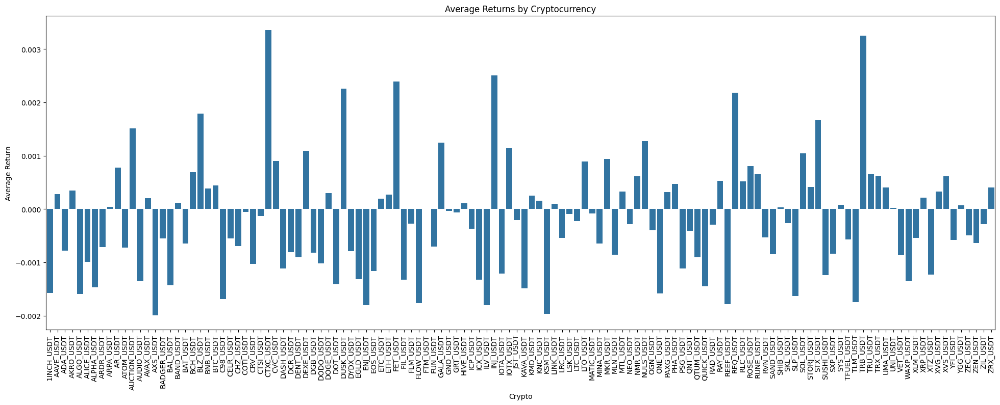

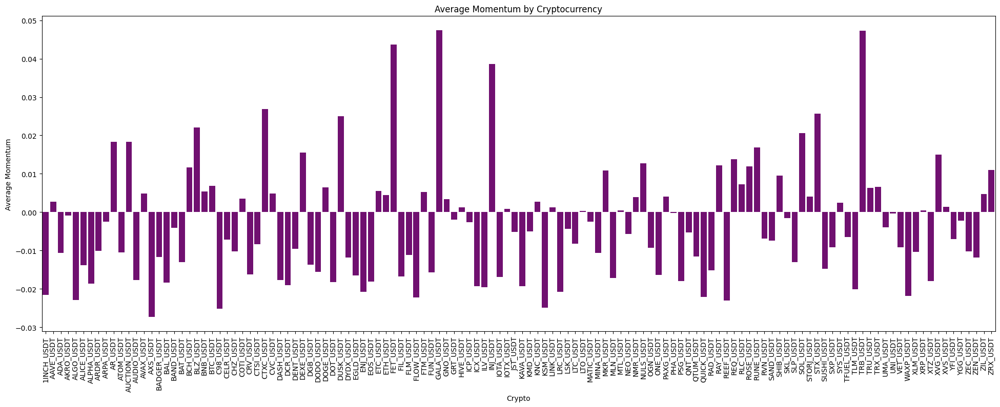

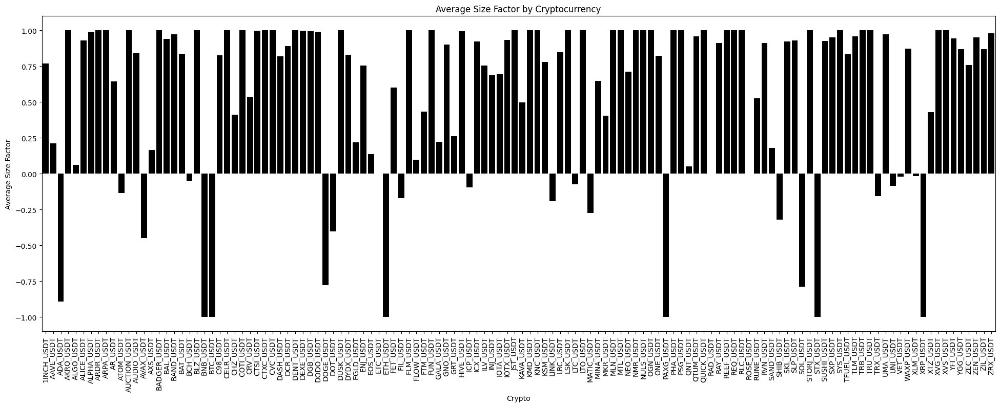

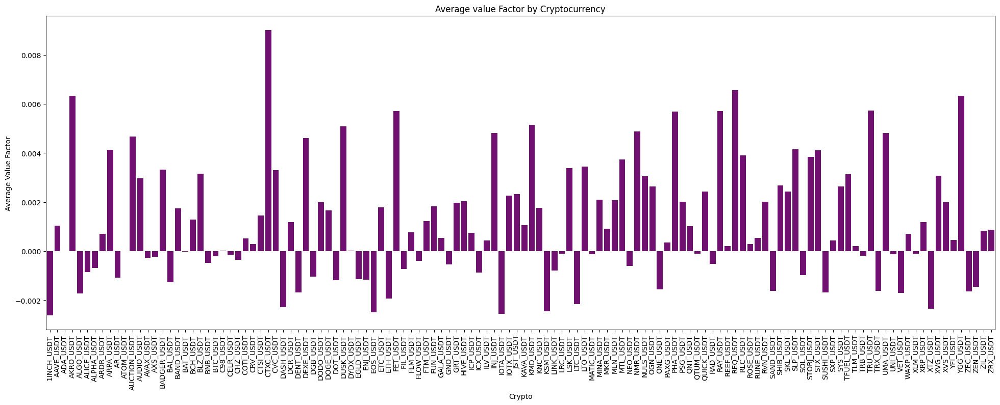

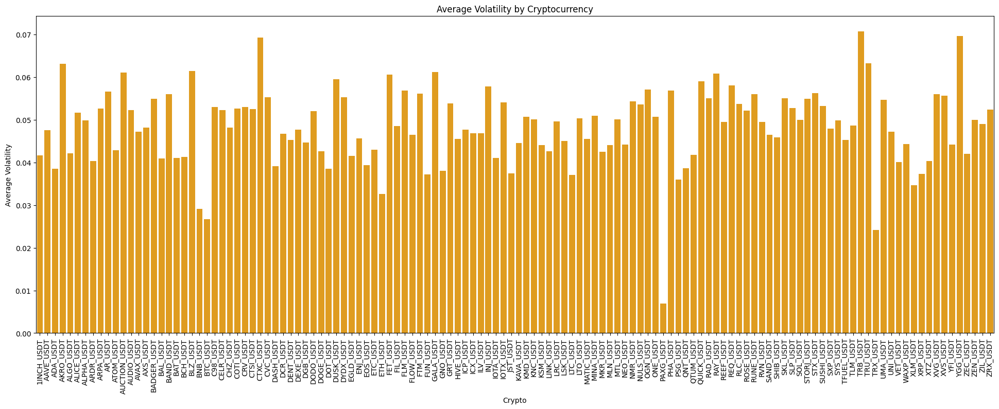

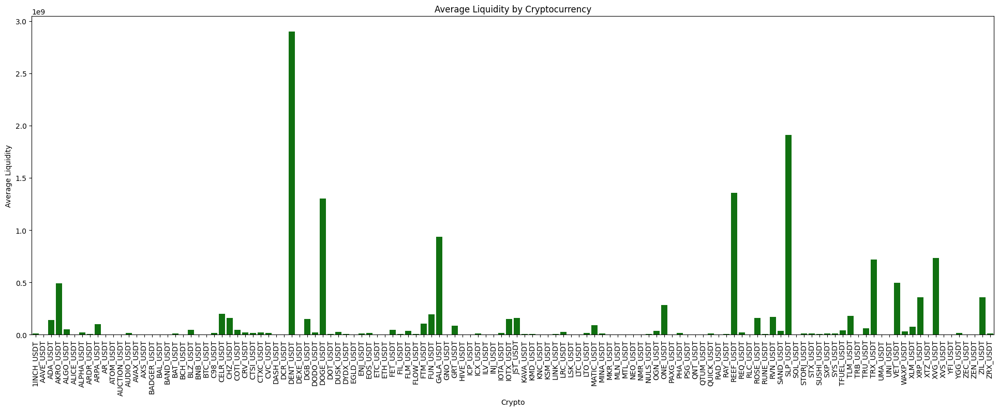

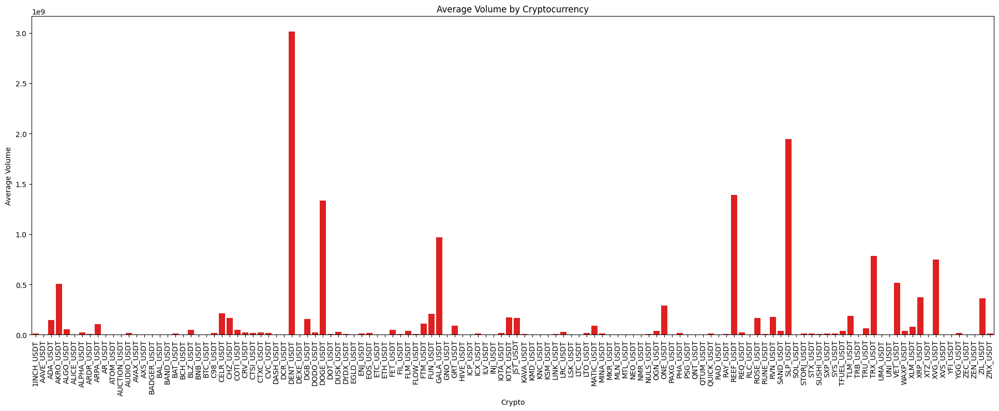

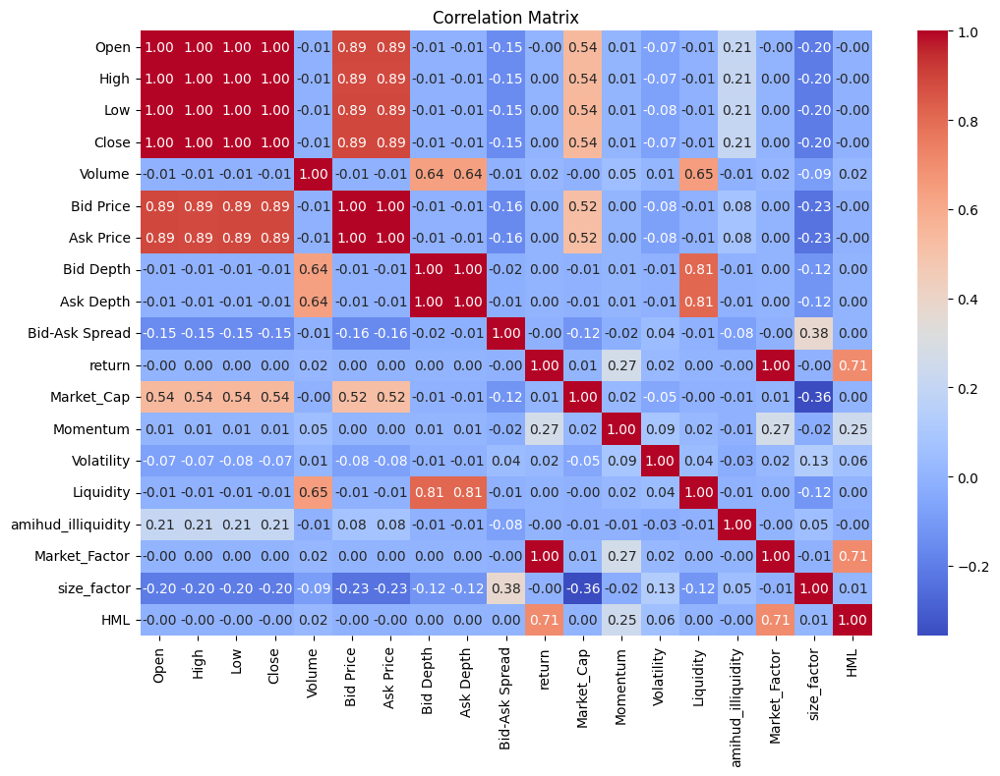

In [50]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(24, 8))
sns.barplot(x='Crypto', y='Average Return', data=trends_df)
plt.xticks(rotation=90)
plt.title('Average Returns by Cryptocurrency')
plt.show()

plt.figure(figsize=(24, 8))
sns.barplot(x='Crypto', y='Average Momentum', data=trends_df, color='purple')
plt.xticks(rotation=90)
plt.title('Average Momentum by Cryptocurrency')
plt.show()

plt.figure(figsize=(24, 8))
sns.barplot(x='Crypto', y='Average Size Factor', data=trends_df, color='black')
plt.xticks(rotation=90)
plt.title('Average Size Factor by Cryptocurrency')
plt.show()

plt.figure(figsize=(24, 8))
sns.barplot(x='Crypto', y='Average Value Factor', data=trends_df, color='purple')
plt.xticks(rotation=90)
plt.title('Average value Factor by Cryptocurrency')
plt.show()


plt.figure(figsize=(24, 8))
sns.barplot(x='Crypto', y='Average Volatility', data=trends_df, color='orange')
plt.xticks(rotation=90)
plt.title('Average Volatility by Cryptocurrency')
plt.show()
filtered_trends_df = trends_df[~trends_df['Crypto'].isin(['SHIB_USDT', 'SKL_USDT'])]

plt.figure(figsize=(24, 8))
sns.barplot(x='Crypto', y='Average Liquidity', data=filtered_trends_df, color='green')
plt.xticks(rotation=90)
plt.title('Average Liquidity by Cryptocurrency')
plt.show()

plt.figure(figsize=(24, 8))
sns.barplot(x='Crypto', y='Average Volume', data=filtered_trends_df, color='red')
plt.xticks(rotation=90)
plt.title('Average Volume by Cryptocurrency')
plt.show()

plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

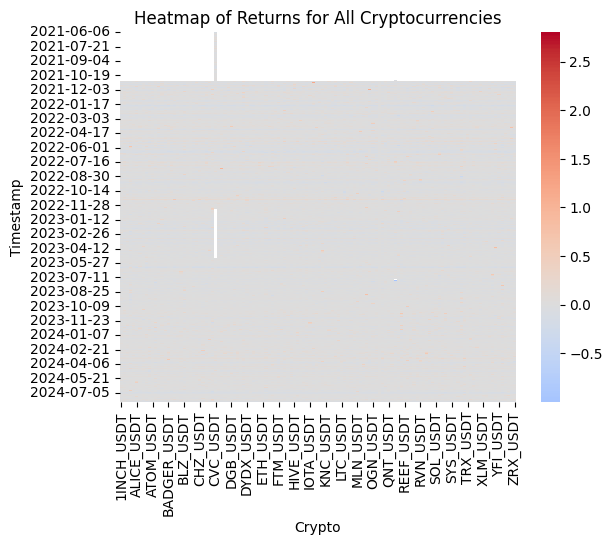

In [78]:
pivot_df = combined_df.pivot(index='Timestamp', columns='Crypto', values='return')  # Assuming there's a 'Cryptocurrency' column
sns.heatmap(pivot_df, cmap='coolwarm', center=0)
plt.title('Heatmap of Returns for All Cryptocurrencies')
plt.show()

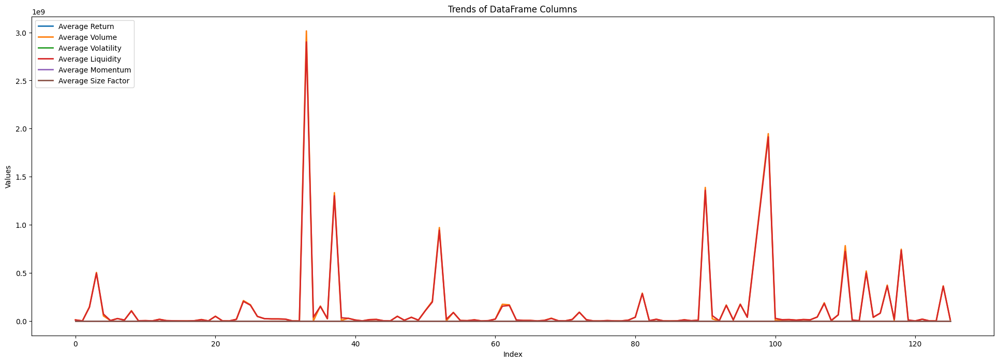

In [25]:
import pandas as pd
import matplotlib.pyplot as plt

filtered_trends_df.plot(figsize=(24, 8), linewidth=2)
plt.legend(loc='upper left')
plt.title('Trends of DataFrame Columns')
plt.xlabel('Index')
plt.ylabel('Values')

plt.show()

In [9]:
import statsmodels.api as sm

# Example: Regression analysis to see the impact of liquidity on returns
X = combined_df['Liquidity']
y = combined_df['return']

# Adding a constant for the intercept
X = sm.add_constant(X)

model = sm.OLS(y, X).fit()
print(model.summary())


                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                 6.422e-05
Date:                Tue, 13 Aug 2024   Prob (F-statistic):              0.994
Time:                        11:26:35   Log-Likelihood:             1.8256e+05
No. Observations:              126000   AIC:                        -3.651e+05
Df Residuals:                  125998   BIC:                        -3.651e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0002      0.000     -1.434      0.1

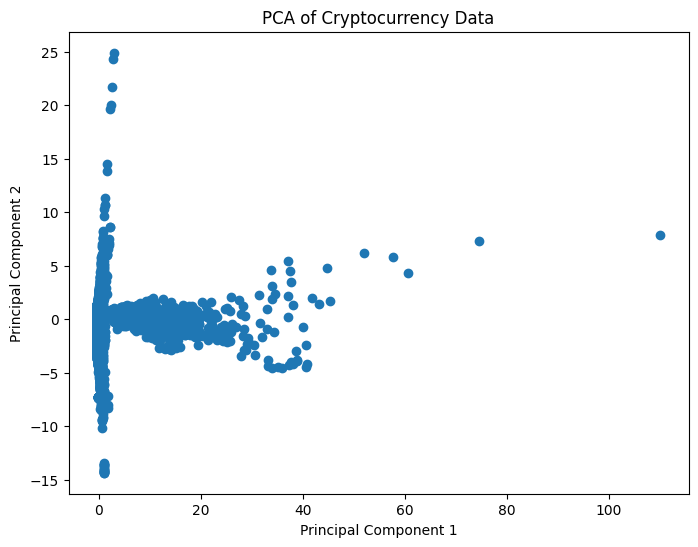

In [22]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
df = pd.read_csv('ccxt/combined_df.csv')

features = ['Open', 'High', 'Low', 'Close', 'Volume', 'Market_Cap', 'Momentum', 'Volatility', 'Liquidity']
x = df[features].dropna()
x = StandardScaler().fit_transform(x)

pca = PCA(n_components=4)
principal_components = pca.fit_transform(x)
# principal_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])
principal_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2','PC3', 'PC4'])

plt.figure(figsize=(8, 6))
plt.scatter(principal_df['PC2'], principal_df['PC4'])
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of Cryptocurrency Data')
plt.show()

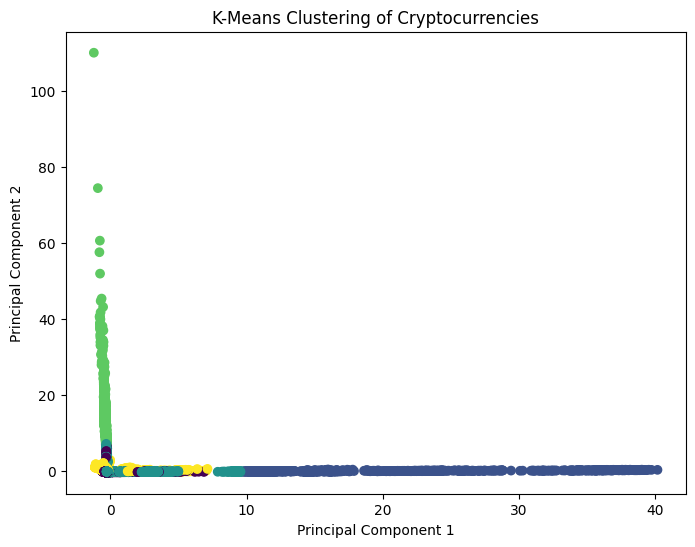

In [23]:
from sklearn.cluster import KMeans
df = pd.read_csv('ccxt/combined_df.csv')
kmeans = KMeans(n_clusters=5)
clusters = kmeans.fit_predict(x)

plt.figure(figsize=(8, 6))
plt.scatter(principal_df['PC1'], principal_df['PC2'], c=clusters)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('K-Means Clustering of Cryptocurrencies')
plt.show()

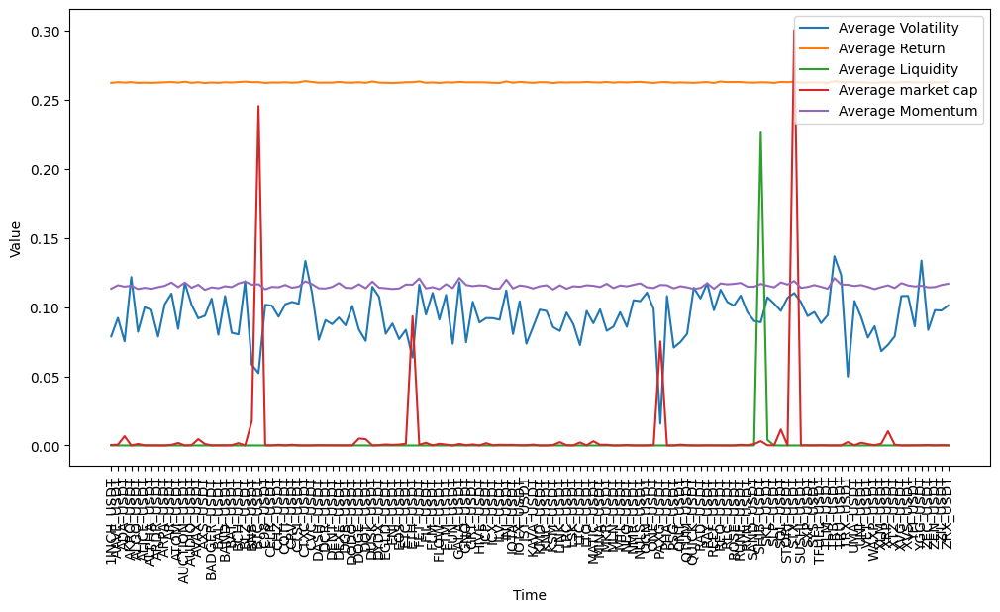

In [45]:
from sklearn.preprocessing import MinMaxScaler

df = pd.read_csv('ccxt/combined_df.csv')

# Select features for clustering
features = df[['Close', 'Volume', 'Market_Cap', 'return', 'Volatility', 'Liquidity', 'Momentum']]
scaler = MinMaxScaler()
# scaler = StandardScaler()
# scaled_features = df
scaled_features = pd.DataFrame(scaler.fit_transform(features), columns=['Close', 'Volume', 'Market_Cap', 'return', 'Volatility', 'Liquidity', 'Momentum'])
scaled_features[['Timestamp', 'Crypto']] = df[['Timestamp','Crypto']]

overall_volatility = scaled_features.groupby('Crypto')['Volatility'].mean()
overall_return = scaled_features.groupby('Crypto')['return'].mean()
overall_liquidity = scaled_features.groupby('Crypto')['Liquidity'].mean()
overall_Market_Cap = scaled_features.groupby('Crypto')['Market_Cap'].mean()
overall_Momentum = scaled_features.groupby('Crypto')['Momentum'].mean()

plt.figure(figsize=(12, 6))
plt.plot(overall_volatility.index, overall_volatility, label='Average Volatility')
plt.plot(overall_return.index, overall_return, label='Average Return')
plt.plot(overall_liquidity.index, overall_liquidity, label='Average Liquidity')
plt.plot(overall_Market_Cap.index, overall_Market_Cap, label='Average market cap')
plt.plot(overall_Momentum.index, overall_Momentum, label='Average Momentum')
plt.xlabel('Time')
plt.xticks(rotation=90)
plt.ylabel('Value')
# plt.title('Average Volatility and Return Over Time')
plt.legend()
plt.show()

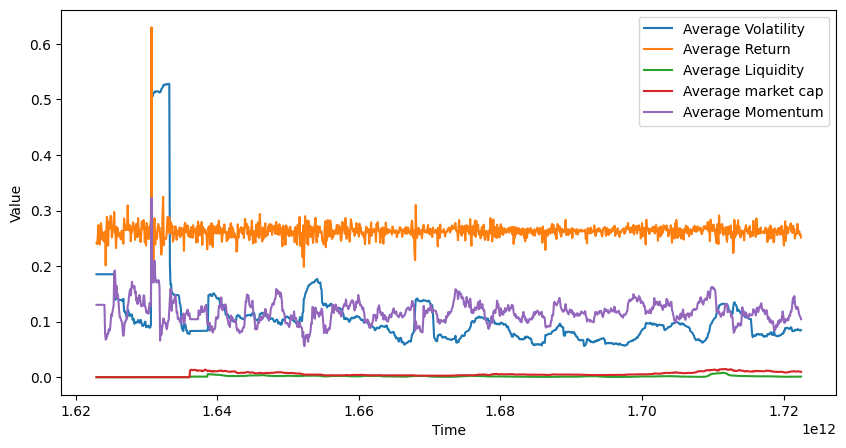

In [35]:
from sklearn.preprocessing import MinMaxScaler

df = pd.read_csv('ccxt/combined_df.csv')

# Select features for clustering
features = df[['Close', 'Volume', 'Market_Cap', 'return', 'Volatility', 'Liquidity', 'Momentum']]
scaler = MinMaxScaler()
# scaler = StandardScaler()
scaled_features = pd.DataFrame(scaler.fit_transform(features), columns=['Close', 'Volume', 'Market_Cap', 'return', 'Volatility', 'Liquidity', 'Momentum'])
scaled_features['Timestamp'] = df['Timestamp']
overall_volatility = scaled_features.groupby('Timestamp')['Volatility'].mean()
overall_return = scaled_features.groupby('Timestamp')['return'].mean()
overall_liquidity = scaled_features.groupby('Timestamp')['Liquidity'].mean()
overall_Market_Cap = scaled_features.groupby('Timestamp')['Market_Cap'].mean()
overall_Momentum = scaled_features.groupby('Timestamp')['Momentum'].mean()

plt.figure(figsize=(10, 5))
plt.plot(overall_volatility.index, overall_volatility, label='Average Volatility')
plt.plot(overall_return.index, overall_return, label='Average Return')
plt.plot(overall_liquidity.index, overall_liquidity, label='Average Liquidity')
plt.plot(overall_Market_Cap.index, overall_Market_Cap, label='Average market cap')
plt.plot(overall_Momentum.index, overall_Momentum, label='Average Momentum')
plt.xlabel('Time')
plt.ylabel('Value')
# plt.title('Average Volatility and Return Over Time')
plt.legend()
plt.show()

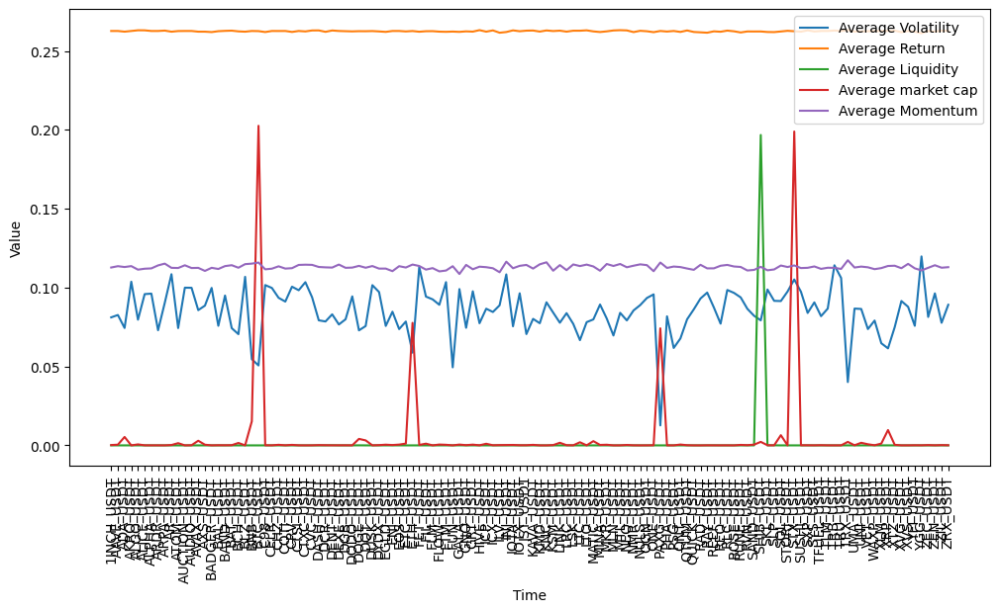

In [48]:
from sklearn.preprocessing import MinMaxScaler

df = pd.read_csv('ccxt/combined_df.csv')

# Select features for clustering
features = df[['Close', 'Volume', 'Market_Cap', 'return', 'Volatility', 'Liquidity', 'Momentum']]
scaler = MinMaxScaler()
# scaler = StandardScaler()
# scaled_features = df
scaled_features = pd.DataFrame(scaler.fit_transform(features), columns=['Close', 'Volume', 'Market_Cap', 'return', 'Volatility', 'Liquidity', 'Momentum'])
scaled_features[['Timestamp', 'Crypto']] = df[['Timestamp','Crypto']]

overall_volatility = scaled_features.groupby('Crypto')['Volatility'].median()
overall_return = scaled_features.groupby('Crypto')['return'].median()
overall_liquidity = scaled_features.groupby('Crypto')['Liquidity'].median()
overall_Market_Cap = scaled_features.groupby('Crypto')['Market_Cap'].median()
overall_Momentum = scaled_features.groupby('Crypto')['Momentum'].median()

plt.figure(figsize=(12, 6))
plt.plot(overall_volatility.index, overall_volatility, label='Average Volatility')
plt.plot(overall_return.index, overall_return, label='Average Return')
plt.plot(overall_liquidity.index, overall_liquidity, label='Average Liquidity')
plt.plot(overall_Market_Cap.index, overall_Market_Cap, label='Average market cap')
plt.plot(overall_Momentum.index, overall_Momentum, label='Average Momentum')
plt.xlabel('Time')
plt.xticks(rotation=90)
plt.ylabel('Value')
# plt.title('Average Volatility and Return Over Time')
plt.legend()
plt.show()

In [ ]:
pivot_df = df.pivot(index='Timestamp', columns='Cryptocurrency', values='return')  # Assuming there's a 'Cryptocurrency' column
sns.heatmap(pivot_df, cmap='coolwarm', center=0)
plt.title('Heatmap of Returns for All Cryptocurrencies')
plt.show()

##### Merge df with google trend based on timestamp

In [58]:
coin_ids = {
    'BTC/USDT': 'bitcoin',
    'ETH/USDT': 'ethereum',
    'BNB/USDT': 'binancecoin',
    'SOL/USDT': 'solana',
    'XRP/USDT': 'ripple',
    'DOGE/USDT': 'dogecoin',
    'TON/USDT': 'toncoin',
    'ADA/USDT': 'cardano',
    'TRX/USDT': 'tron',
    'AVAX/USDT': 'avalanche-2',
    'SHIB/USDT': 'shiba-inu',
    'BCH/USDT': 'bitcoin-cash',
    'DOT/USDT': 'polkadot',
    'LINK/USDT': 'chainlink',
    'NEAR/USDT': 'near-protocol',
    'LEO/USDT': 'leo-token',
    'LTC/USDT': 'litecoin',
    'KAS/USDT': 'kaspa',
    'MATIC/USDT': 'matic-network',
    'PEPE/USDT': 'pepe',
    'UNI/USDT': 'uniswap',
    'ICP/USDT': 'internet-computer',
    'ETC/USDT': 'ethereum-classic',
    'APT/USDT': 'aptos',
    'XLM/USDT': 'stellar',
    'FET/USDT': 'fetch-ai',
    'XMR/USDT': 'monero',
    'MKR/USDT': 'maker',
    'STX/USDT': 'stacks',
    'FIL/USDT': 'filecoin',
    'OKB/USDT': 'okb',
    'MNT/USDT': 'montenegro',
    'CRO/USDT': 'crypto-com-chain',
    'ATOM/USDT': 'cosmos',
    'HBAR/USDT': 'hedera',
    'RENDER/USDT': 'render-token',
    'ARB/USDT': 'arbitrum',
    'TAO/USDT': 'tao',
    'IMX/USDT': 'immutable-x',
    'INJ/USDT': 'injective-protocol',
    'VET/USDT': 'vechain',
    'AR/USDT': 'arweave',
    'OP/USDT': 'optimism',
    'SUI/USDT': 'sui',
    'GRT/USDT': 'the-graph',
    'BONK/USDT': 'bonk',
    'AAVE/USDT': 'aave',
    'BGB/USDT': 'bgb',
    'FLOKI/USDT': 'floki-inu',
    'RUNE/USDT': 'thorchain',
    'JASMY/USDT': 'jasmy',
    'THETA/USDT': 'theta-network',
    'CHEEL/USDT': 'cheel',
    'FTM/USDT': 'fantom',
    'ALGO/USDT': 'algorand',
    'CORE/USDT': 'core',
    'FLOW/USDT': 'flow',
    'BSV/USDT': 'bitcoin-sv',
    'OM/USDT': 'om',
    'KCS/USDT': 'kucoin-shares',
    'BEAM/USDT': 'beam',
    'EOS/USDT': 'eos',
    'FLZ/USDT': 'flz',
    'BTT/USDT': 'bittorrent',
    'EGLD/USDT': 'elrond-erd-2',
    'AXS/USDT': 'axie-infinity',
    'ENS/USDT': 'ethereum-name-service',
    'QNT/USDT': 'quant-network',
    'HNT/USDT': 'harmony',
    'NEO/USDT': 'neo',
    'ORDI/USDT': 'ordi',
    'FLR/USDT': 'flare',
    'XEC/USDT': 'xec',
    'XTZ/USDT': 'tezos',
    'GALA/USDT': 'gala',
    'DYDX/USDT': 'dydx',
    'FTN/USDT': 'ftn',
    'CFX/USDT': 'conflux-network',
    'SAND/USDT': 'the-sandbox',
    'AKT/USDT': 'akt',
    'GT/USDT': 'gt',
    'MOG/USDT': 'mog',
    'NEXO/USDT': 'nexo',
    'WLD/USDT': 'wld',
    'AIOZ/USDT': 'aioz',
    'RON/USDT': 'ron',
    'XAUt/USDT': 'xaut',
    'RAY/USDT': 'raydium',
    'CHZ/USDT': 'chiliz',
    'MINA/USDT': 'mina-protocol',
    'ZEC/USDT': 'zcash',
    'ROSE/USDT': 'rose',
    'PENDLE/USDT': 'pendle',
    'SNX/USDT': 'synthetix',
    'BNX/USDT': 'bnx',
    'GNO/USDT': 'gnosis',
    'KLAY/USDT': 'klaytn',
    'DEXE/USDT': 'dexe',
    'IOTA/USDT': 'iota',
    'ASTR/USDT': 'astr',
    'CKB/USDT': 'ckb',
    'LPT/USDT': 'livepeer',
    'BTG/USDT': 'bitcoin-gold',
    'PAXG/USDT': 'paxos-standard',
    'APE/USDT': 'ape',
    'AXL/USDT': 'axl',
    'FTT/USDT': 'ftt',
    'SAFE/USDT': 'safe',
    'XDC/USDT': 'xdc-network',
    'COMP/USDT': 'compound',
    'KAVA/USDT': 'kava',
    'CAKE/USDT': 'pancakeswap',
    '1INCH/USDT': '1inch',
    'TFUEL/USDT': 'theta-fuel',
    'LUNC/USDT': 'terra-luna',
    'NFT/USDT': 'nft',
    'TWT/USDT': 'twt',
    'WEMIX/USDT': 'wemix',
    'IOTX/USDT': 'iotex',
    'MX/USDT': 'mx',
    'H2O/USDT': 'h2o',
    'SFP/USDT': 'sfp',
    'ANT/USDT': 'ant',
    'PEOPLE/USDT': 'people',
    'TURBO/USDT': 'turbo',
    'WOO/USDT': 'woo-network',
    'GAL/USDT': 'gal',
    'GMT/USDT': 'gmt',
    'BLUR/USDT': 'blur',
    'GLM/USDT': 'golem',
    'DASH/USDT': 'dash',
    'SUPER/USDT': 'super',
    'KSM/USDT': 'kusama',
    'CRV/USDT': 'curve-dao-token',
    'ZRX/USDT': '0x',
    'LUNA/USDT': 'luna',
    'ZIL/USDT': 'zilliqa',
    'PRIME/USDT': 'prime',
    'OSMO/USDT': 'osmosis',
    'SSV/USDT': 'ssv-network',
    'BDX/USDT': 'bdx',
    'ID/USDT': 'id',
    'SC/USDT': 'sc',
    'XRD/USDT': 'xrd',
    'ENJ/USDT': 'enjincoin',
    'BAT/USDT': 'basic-attention-token',
    'CVX/USDT': 'convex-finance',
    'HOT/USDT': 'holo',
    'ELF/USDT': 'elf',
    'JST/USDT': 'just',
    'TRAC/USDT': 'origintrail',
    'QTUM/USDT': 'qtum',
    'SKL/USDT': 'skale',
    'ARKM/USDT': 'arkm',
    'PAAL/USDT': 'paal',
    'GMX/USDT': 'gmx',
    'ETHW/USDT': 'ethw',
    'ILV/USDT': 'illuvium',
    'METIS/USDT': 'metis',
    'RVN/USDT': 'ravencoin',
    'PEPECOIN/USDT': 'pepecoin',
    'RSR/USDT': 'reserve-rights',
    'CFG/USDT': 'centrifuge',
    'GAS/USDT': 'gas',
    'BICO/USDT': 'biconomy',
    'T/USDT': 't',
    'POLYX/USDT': 'polyx',
    'FLUX/USDT': 'flux',
    'TRB/USDT': 'tellor',
    'UMA/USDT': 'uma',
    'XEM/USDT': 'nem',
    'DCR/USDT': 'decred',
    'CSPR/USDT': 'casper-network',
    'BAND/USDT': 'band-protocol',
    'XCH/USDT': 'chia',
    'LRC/USDT': 'loopring',
    'RLB/USDT': 'rlb',
    'ZIG/USDT': 'zigcoin',
    'YFI/USDT': 'yearn-finance',
    'ONE/USDT': 'harmony',
    'EDU/USDT': 'edu',
    'FXS/USDT': 'frax-share',
    'ABT/USDT': 'arcblock',
    'VANRY/USDT': 'vanry',
    'CHR/USDT': 'chromia',
    'SUSHI/USDT': 'sushi',
    'AMP/USDT': 'amp',
    'ACH/USDT': 'alchemix',
    'STORJ/USDT': 'storj',
    'BORG/USDT': 'borg',
    'CTC/USDT': 'ctc',
    'HONEY/USDT': 'honey',
    'BabyDoge/USDT': 'babydoge',
    'GLMR/USDT': 'glimmer',
    'YGG/USDT': 'yield-guild-games',
    'AUDIO/USDT': 'audius',
    'TEL/USDT': 'telcoin',
    'COTI/USDT': 'coti',
    'ALPH/USDT': 'alpha-finance',
    'API3/USDT': 'api3',
    'ICX/USDT': 'icon',
    'ZETA/USDT': 'zeta',
    'VENOM/USDT': 'venom',
    'SXP/USDT': 'swipe',
    'ZEN/USDT': 'zencash',
    'KDA/USDT': 'kadena',
    'RSS3/USDT': 'rss3',
    'NTRN/USDT': 'ntrn',
    'WAVES/USDT': 'waves',
    'LSK/USDT': 'lisk',
    'PCI/USDT': 'pci',
    'BAL/USDT': 'balancer',
    'WAXP/USDT': 'wax',
    'TRU/USDT': 'truefi',
    'ORCA/USDT': 'orca',
    'AGI/USDT': 'singularitynet',
    'PRO/USDT': 'pro',
    'BITCOIN/USDT': 'bitcoin',
    'AZERO/USDT': 'aleph-zero',
    'IOST/USDT': 'iost',
    'JOE/USDT': 'joe',
    'MAGIC/USDT': 'magic',
    'ONG/USDT': 'ontologynetwork',
    'BMX/USDT': 'bmx',
    'XNO/USDT': 'nervos-network',
    'XVS/USDT': 'venus',
    'AUCTION/USDT': 'auction',
    'POND/USDT': 'pond',
    'LISTA/USDT': 'lista',
    'LCX/USDT': 'lcx',
    'DGB/USDT': 'digibyte',
    'PROM/USDT': 'prom',
    'Gomining/USDT': 'gomining',
    'RLC/USDT': 'iexec-rlc',
    'C98/USDT': 'coin98',
    'CTSI/USDT': 'cartesi',
    'IQ/USDT': 'everipedia',
    'ZENT/USDT': 'zent',
    'KUJI/USDT': 'kujira',
    'POWR/USDT': 'power-ledger',
    'MOBILE/USDT': 'mobile',
    'PUNDIX/USDT': 'pundix',
    'GNS/USDT': 'gns',
    'SLP/USDT': 'smooth-love-potion',
    'HIVE/USDT': 'hive',
    'EVER/USDT': 'ever',
    'MVL/USDT': 'mvl',
    'BONE/USDT': 'bone',
    'RIF/USDT': 'rif',
    'BORA/USDT': 'bora',
    'DUSK/USDT': 'dusk-network',
    'HIGH/USDT': 'high',
    'ORAI/USDT': 'orai',
    'RDNT/USDT': 'radiant',
    'SFUND/USDT': 'seedify-fund',
    'LON/USDT': 'lon',
    'CVC/USDT': 'civic',
    'NMR/USDT': 'numeraire',
    'SUN/USDT': 'sun',
    'CELR/USDT': 'celer-network',
    'NOS/USDT': 'nos',
    'STMX/USDT': 'stmx',
    'STRAX/USDT': 'strax',
    'KNC/USDT': 'kyber-network',
    'WMT/USDT': 'wmt',
    'DAR/USDT': 'dar',
    'SNT/USDT': 'status',
    'MLK/USDT': 'mlk',
    'APEX/USDT': 'apex',
    'SPELL/USDT': 'spell',
    'ELON/USDT': 'dogelon-mars',
    'PHA/USDT': 'pha',
    'WILD/USDT': 'wild',
    'OAS/USDT': 'oas',
    'CTK/USDT': 'ctk',
    'WIN/USDT': 'win',
    'STEEM/USDT': 'steem',
    'MCOIN/USDT': 'mcoin',
    'MOVR/USDT': 'moonriver',
    'DODO/USDT': 'dodo',
    'HOOK/USDT': 'hook',
    'DENT/USDT': 'dent',
    'STPT/USDT': 'stpt',
    'MPLX/USDT': 'mplx',
    'ORBS/USDT': 'orbs',
    'NYM/USDT': 'nym',
    'LADYS/USDT': 'ladys',
    'VELO/USDT': 'velo',
    'PYR/USDT': 'vulcan-forged',
    'DAG/USDT': 'dag',
    'MPL/USDT': 'mpl',
    'MED/USDT': 'med',
    'SYN/USDT': 'synth',
    'HFT/USDT': 'hft',
    'CPOOL/USDT': 'cpool',
    'BOBO/USDT': 'bobo',
    'LQTY/USDT': 'liquity',
    'GODS/USDT': 'gods-unchained',
    'NAKA/USDT': 'naka',
    'ALEX/USDT': 'alex',
    'XPLA/USDT': 'xpla',
    'REQ/USDT': 'request-network',
    'GFI/USDT': 'gfi',
    'AURORA/USDT': 'aurora',
    'LOOM/USDT': 'loom-network',
    'SYS/USDT': 'syscoin',
    'ALICE/USDT': 'my-neighbor-alice',
    'PHB/USDT': 'phb',
    'MTL/USDT': 'metal',
    'SHDW/USDT': 'shadows',
    'LAT/USDT': 'lat',
    'OXT/USDT': 'oxen',
    'BLZ/USDT': 'bluzelle',
    'STG/USDT': 'stargate-finance',
    'CGPT/USDT': 'cgpt',
    'XYO/USDT': 'xyo',
    'STC/USDT': 'stc',
    'SCRT/USDT': 'secret',
    'EUL/USDT': 'euler',
    'AITECH/USDT': 'aitech',
    'MBX/USDT': 'mbx',
    'DESO/USDT': 'deso',
    'BAKE/USDT': 'bake',
    'FRONT/USDT': 'front',
    'AGLD/USDT': 'agld',
    'LMWR/USDT': 'lmwr',
    'LEVER/USDT': 'lever',
    'ARK/USDT': 'ark',
    'ARDR/USDT': 'ardor',
    'SNEK/USDT': 'snek',
    'TLOS/USDT': 'tlos',
    'ACA/USDT': 'aca',
    'BFIC/USDT': 'bfic',
    'BADGER/USDT': 'badger-dao',
    'HIFI/USDT': 'hifi-finance',
    'QKC/USDT': 'qkc',
    'UQC/USDT': 'uqc',
    'XVG/USDT': 'verge',
    'DAO/USDT': 'dao',
    'GHX/USDT': 'ghx',
    'BFC/USDT': 'bfc',
    'POKT/USDT': 'pokt',
    'HPO/USDT': 'hpo',
    'RAD/USDT': 'rad',
    'CREAM/USDT': 'cream-finance',
    'DIONE/USDT': 'dione',
    'RBN/USDT': 'ribbon-finance',
    'ARPA/USDT': 'arpa',
    'ACS/USDT': 'acs',
    'MBOX/USDT': 'mbox',
    'GTC/USDT': 'gtc',
    'ALI/USDT': 'ali',
    'RACA/USDT': 'raca',
    'ZCX/USDT': 'zcx',
    'OGN/USDT': 'origin-protocol',
    'ALPHA/USDT': 'alpha-finance',
    'RARE/USDT': 'rare',
    'NXRA/USDT': 'nxra',
    'MYRIA/USDT': 'myria',
    'GHST/USDT': 'ghst',
    'EWT/USDT': 'energy-web-token',
    'OGY/USDT': 'ogy',
    'FX/USDT': 'fx',
    'AIDOGE/USDT': 'aidoge',
    'TKO/USDT': 'tko',
    'ACX/USDT': 'acx',
    'WXT/USDT': 'wxt',
    'AOG/USDT': 'aog',
    'MAV/USDT': 'mav',
    'WRX/USDT': 'wrx',
    'LTO/USDT': 'lto-network',
    'MBL/USDT': 'mbl',
    'TLM/USDT': 'alien-worlds',
    'CBK/USDT': 'cbk',
    'FORTH/USDT': 'forth',
    'ERN/USDT': 'ern',
    'REI/USDT': 'rei',
    'BRISE/USDT': 'brise',
    'MLN/USDT': 'melon',
    'ETN/USDT': 'electroneum',
    'RARI/USDT': 'rari',
    'GEAR/USDT': 'gear',
    'META/USDT': 'meta',
    'CTXC/USDT': 'cortex',
    'DNX/USDT': 'dnx',
    'MAPO/USDT': 'mapo',
    'CLV/USDT': 'clv',
    'TET/USDT': 'tet',
    'LOOKS/USDT': 'looksrare',
    'XCN/USDT': 'xcn',
    'AERGO/USDT': 'aergo',
    'SWEAT/USDT': 'sweat',
    'BOSON/USDT': 'boson',
    'VR/USDT': 'vr',
    'BETA/USDT': 'beta',
    'SOLO/USDT': 'solo',
    'ROUTE/USDT': 'route',
    'DIMO/USDT': 'dimo',
    'ORN/USDT': 'orn',
    'DNT/USDT': 'district0x',
    'ALEPH/USDT': 'aleph',
    'BOBA/USDT': 'boba-network',
    'GOG/USDT': 'gog',
    'DMTR/USDT': 'dmtr',
    'DIA/USDT': 'dia',
    'COS/USDT': 'cos',
    'LOVELY/USDT': 'lovely-inu',
    'HUNT/USDT': 'hunt',
    'TT/USDT': 'tt',
    'DEP/USDT': 'dep',
    'FUN/USDT': 'funfair',
    'FLM/USDT': 'flamingo-finance',
    'RLY/USDT': 'rally',
    'AL/USDT': 'al',
    'DATA/USDT': 'data',
    'KMD/USDT': 'komodo',
    'VIC/USDT': 'vic',
    'ALCX/USDT': 'alchemix',
    'QUACK/USDT': 'quack',
    'DORA/USDT': 'dora',
    'GAFI/USDT': 'gafi',
    'STRK/USDT': 'strik',
    'LINA/USDT': 'linera',
    'UOS/USDT': 'ultra',
    'PDA/USDT': 'pda',
    'XCHNG/USDT': 'xchng',
    'STRX/USDT': 'strx',
    'COMBO/USDT': 'combo',
    'OMG/USDT': 'omg-network',
    'GFAL/USDT': 'gf',
    'CWIF/USDT': 'cwif',
    'VRTX/USDT': 'vrtx',
    'FIDA/USDT': 'fida',
    'WAN/USDT': 'wan',
    'ISIKC/USDT': 'isikc',
    'LEASH/USDT': 'leash',
    'SAUCE/USDT': 'sauce',
    'TRADE/USDT': 'trade',
    'COREUM/USDT': 'coreum',
    'UNFI/USDT': 'unfi',
    'VAI/USDT': 'vai',
    'PSG/USDT': 'paris-saint-germain-fan-token',
    'SAMO/USDT': 'samo',
    'NUM/USDT': 'num',
    'FCT/USDT': 'factom',
    'VRA/USDT': 'verasity',
    'AVA/USDT': 'ava',
    'ROG/USDT': 'rog',
    'NULS/USDT': 'nuls',
    'DEGO/USDT': 'dego',
    'LOKA/USDT': 'loka',
    'KEY/USDT': 'key',
    'FARM/USDT': 'farm',
    'REEF/USDT': 'reef',
    'CEEK/USDT': 'ceek',
    'NEON/USDT': 'neon',
    'MDT/USDT': 'mdt',
    'STT/USDT': 'stt',
    'GRS/USDT': 'groestlcoin',
    'BSW/USDT': 'biswap',
    'QUICK/USDT': 'quick',
    'NPT/USDT': 'npt',
    'LIME/USDT': 'lime',
    'ATLAS/USDT': 'atlas',
    'AMPL/USDT': 'ampleforth',
    'POLS/USDT': 'polkastarter',
    'ASD/USDT': 'asda',
    'GST/USDT': 'gala',
    'IRIS/USDT': 'iris',
    'KLIMA/USDT': 'klima',
    'MOC/USDT': 'moc',
    'VOXEL/USDT': 'voxel',
    'CERE/USDT': 'cere',
    'AMB/USDT': 'amb',
    'GMEE/USDT': 'gmee',
    'VGX/USDT': 'voyager-token',
    'BIFI/USDT': 'beefy-finance',
    'A8/USDT': 'a8',
    'KLV/USDT': 'klv',
    'GFT/USDT': 'gft',
    'TOMI/USDT': 'tomi',
    'AKRO/USDT': 'akropolis',
    'AQT/USDT': 'aqt',
    'ADX/USDT': 'adx',
    'DFI/USDT': 'dfi',
    'ZKL/USDT': 'zkl',
    'OPUL/USDT': 'opul',
    'HOPR/USDT': 'hopr',
    'MXC/USDT': 'mxc',
    'UTK/USDT': 'utk',
    'SABAI/USDT': 'sabai',
    'KP3R/USDT': 'kp3r',
    'BURGER/USDT': 'burger',
    'WING/USDT': 'wing',
    'BAR/USDT': 'bar',
    'CLORE/USDT': 'clore',
    'XCAD/USDT': 'xcad',
    'BOB/USDT': 'bob',
    'SRX/USDT': 'srx',
    'DF/USDT': 'df'
}
   

In [70]:
import os
import pandas as pd
# os.makedirs('merged_weekly/')
path = 'ccxt/factors/'
path2 = 'google trends/'
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    for full_name1 in os.listdir(path2):
        name1 = full_name1.split(".")[0]
        if name1 == coin_ids[name.replace('_', '/')]:
            trdf = pd.read_csv(path2+full_name1)
            if 'date' in trdf.columns:
                merged  = pd.merge(trdf,df,  left_on='date', right_on='Timestamp' )
                merged.to_csv(f'merged_weekly/{name}.csv',index=False)


combine all 

In [3]:
import pandas as pd
import os
path = 'merged_weekly/'
all_dataframes = []
for full_name in os.listdir(path):
    df = pd.read_csv(os.path.join(path, full_name)) 
    df.rename(columns={df.columns[1]: 'google_trend'}, inplace=True)

    df['Crypto'] = full_name.split(".")[0]  
    all_dataframes.append(df)  
combined_df = pd.concat(all_dataframes, ignore_index=True)
combined_df.columns

Index(['date', 'google_trend', 'isPartial', 'Timestamp', 'Open', 'High', 'Low',
       'Close', 'Volume', 'Bid Price', 'Ask Price', 'Bid Depth', 'Ask Depth',
       'Bid-Ask Spread', 'return', 'Market_Cap', 'Momentum', 'Volatility',
       'Liquidity', 'amihud_illiquidity', 'Market_Factor', 'Size',
       'size_factor', 'Date', 'NVT', 'NVT_rank', 'HML', 'Crypto'],
      dtype='object')

In [72]:
# combined_df = pd.read_csv('ccxt/combined_df.csv')
average_returns = combined_df.groupby('Crypto')['return'].mean()
average_Volume = combined_df.groupby('Crypto')['Volume'].mean()
average_volatility = combined_df.groupby('Crypto')['Volatility'].mean()
average_liquidity = combined_df.groupby('Crypto')['Liquidity'].mean()
average_Momentum = combined_df.groupby('Crypto')['Momentum'].mean()
average_size_factor = combined_df.groupby('Crypto')['size_factor'].mean()
average_value_factor = combined_df.groupby('Crypto')['HML'].mean()
average_google_trend = combined_df.groupby('Crypto')['google_trend'].mean()

trends_df = pd.DataFrame({
    'Average Return': average_returns,
    'Average Volume': average_Volume,
    'Average Volatility': average_volatility,
    'Average Liquidity': average_liquidity,
    'Average Momentum': average_Momentum,
    'Average Size Factor': average_size_factor,
    'Average Value Factor': average_value_factor,
    'Average google Factor': average_google_trend,
}).reset_index()

correlation_matrix = combined_df[[ 'Open', 'High', 'Low', 'Close', 'Volume', 'Bid Price',
       'Ask Price', 'Bid Depth', 'Ask Depth', 'Bid-Ask Spread', 'return',
       'Market_Cap', 'Momentum', 'Volatility', 'Liquidity',
       'amihud_illiquidity', 'Market_Factor', 'size_factor' , 'google_trend']].corr()



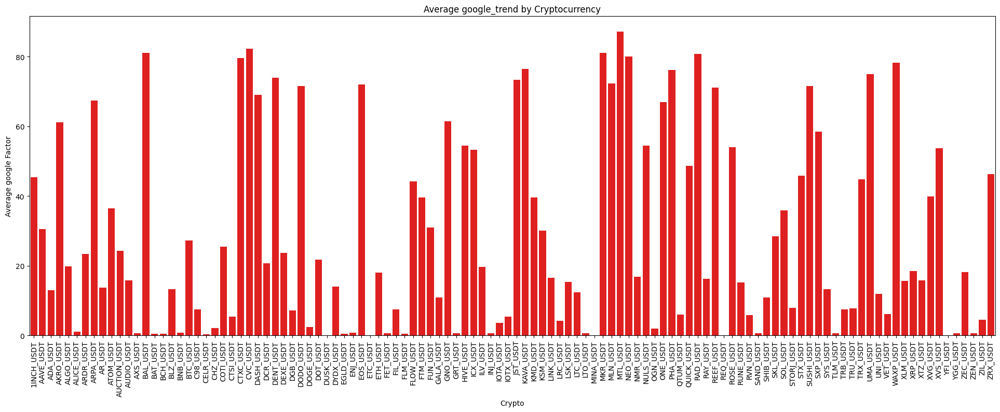

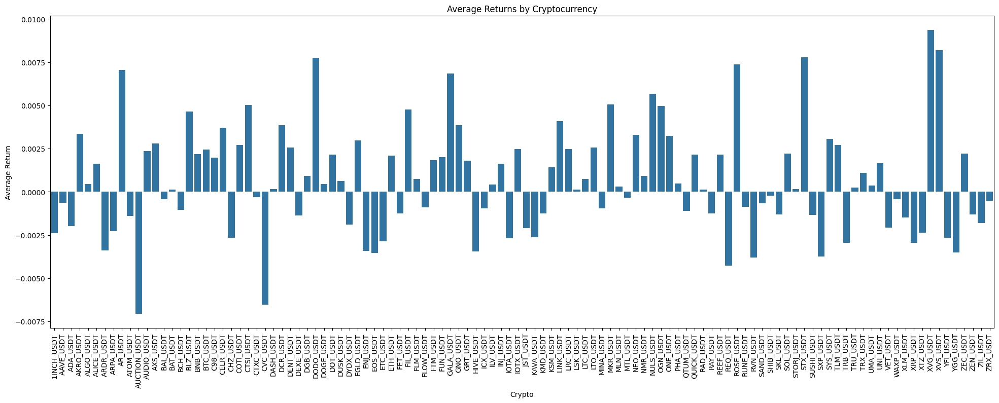

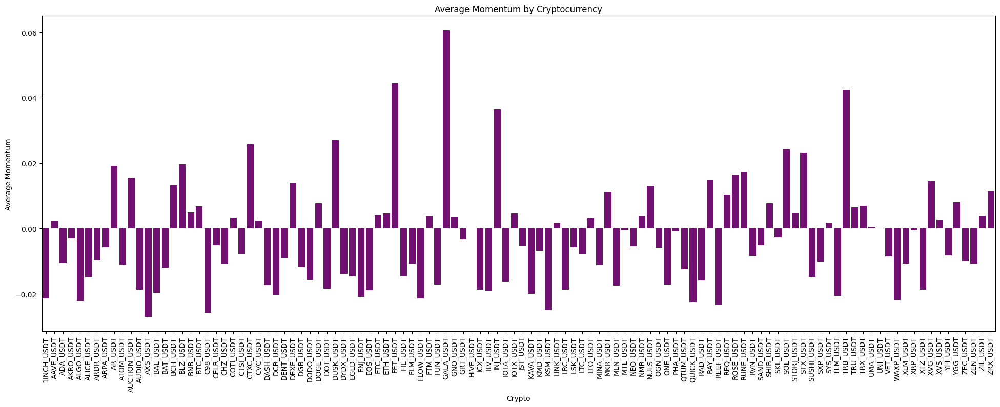

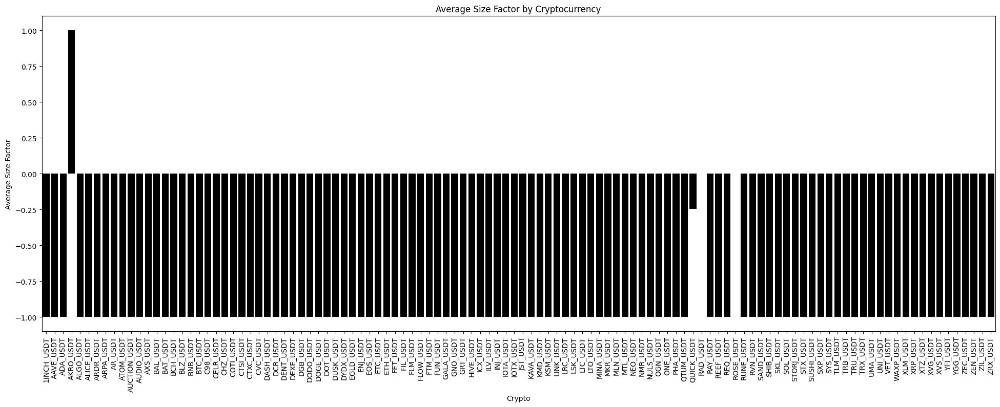

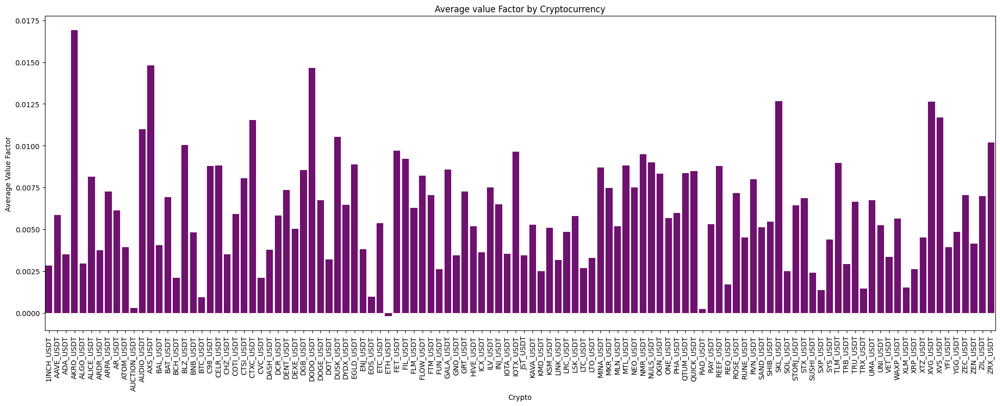

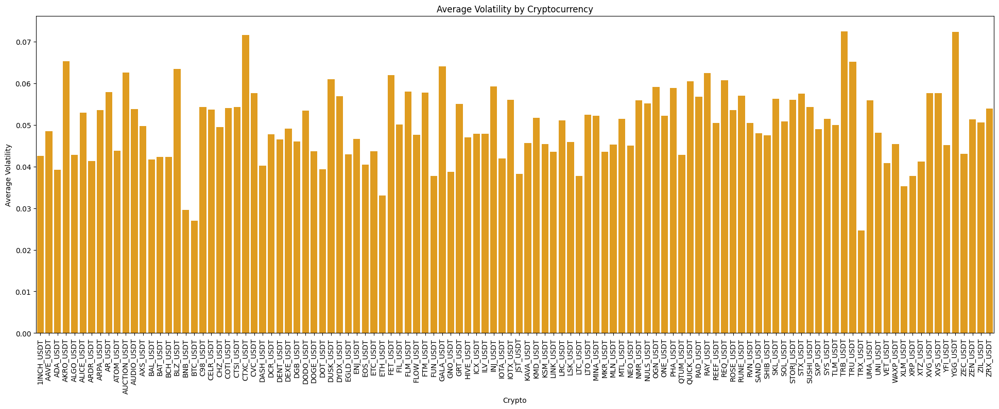

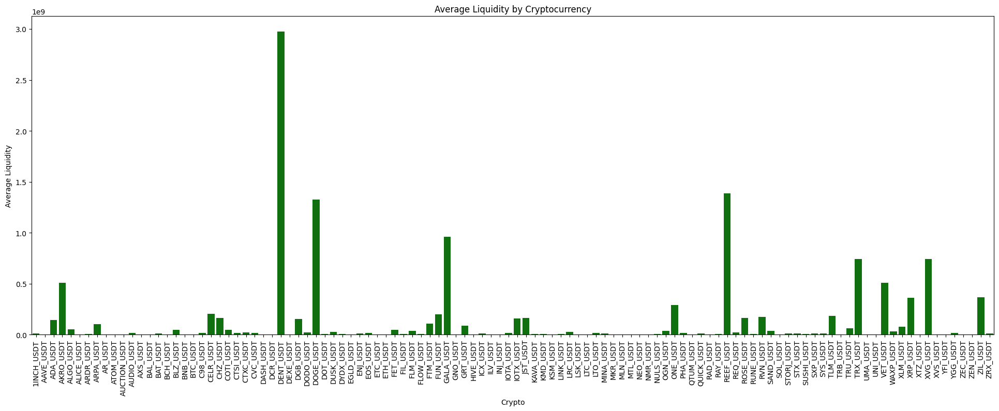

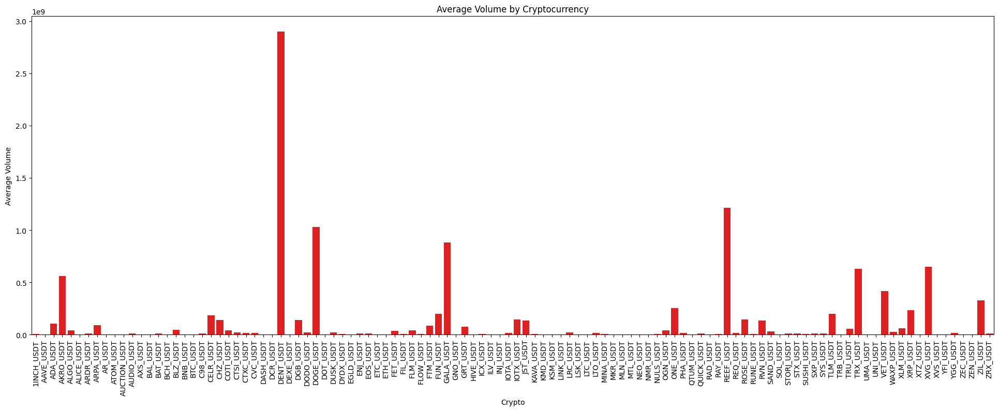

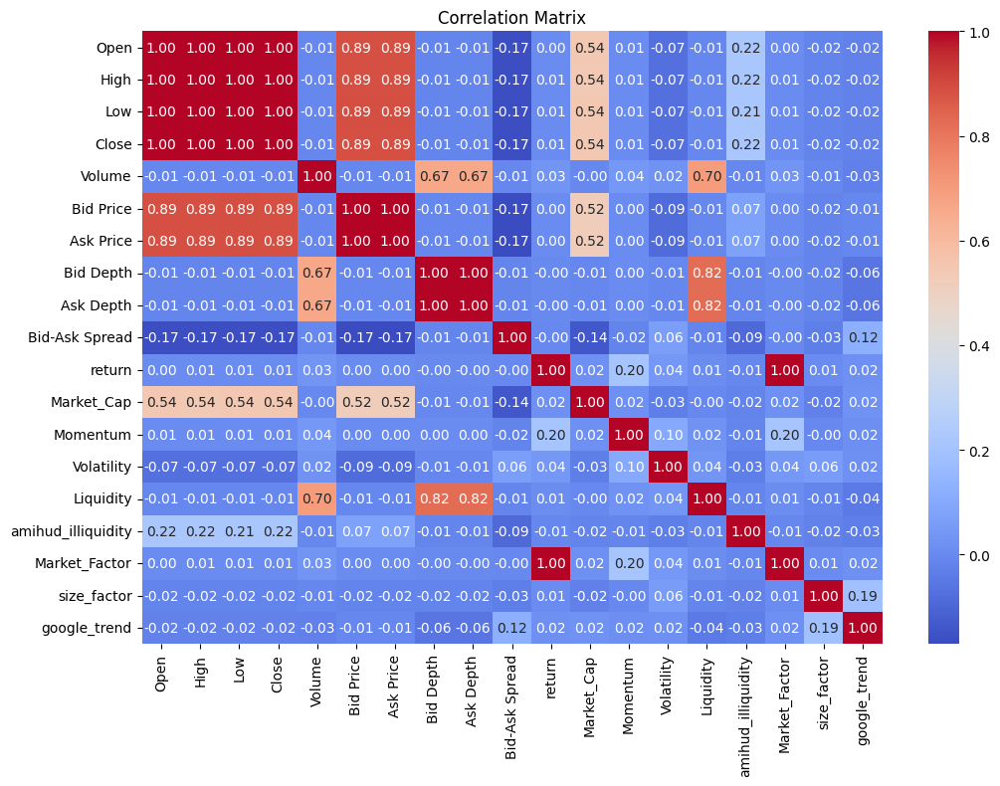

In [73]:
plt.figure(figsize=(24, 8))
sns.barplot(x='Crypto', y='Average google Factor', data=trends_df , color='red')
plt.xticks(rotation=90)
plt.title('Average google_trend by Cryptocurrency')
plt.show()


plt.figure(figsize=(24, 8))
sns.barplot(x='Crypto', y='Average Return', data=trends_df)
plt.xticks(rotation=90)
plt.title('Average Returns by Cryptocurrency')
plt.show()

plt.figure(figsize=(24, 8))
sns.barplot(x='Crypto', y='Average Momentum', data=trends_df, color='purple')
plt.xticks(rotation=90)
plt.title('Average Momentum by Cryptocurrency')
plt.show()

plt.figure(figsize=(24, 8))
sns.barplot(x='Crypto', y='Average Size Factor', data=trends_df, color='black')
plt.xticks(rotation=90)
plt.title('Average Size Factor by Cryptocurrency')
plt.show()

plt.figure(figsize=(24, 8))
sns.barplot(x='Crypto', y='Average Value Factor', data=trends_df, color='purple')
plt.xticks(rotation=90)
plt.title('Average value Factor by Cryptocurrency')
plt.show()


plt.figure(figsize=(24, 8))
sns.barplot(x='Crypto', y='Average Volatility', data=trends_df, color='orange')
plt.xticks(rotation=90)
plt.title('Average Volatility by Cryptocurrency')
plt.show()
filtered_trends_df = trends_df[~trends_df['Crypto'].isin(['SHIB_USDT', 'SKL_USDT'])]

plt.figure(figsize=(24, 8))
sns.barplot(x='Crypto', y='Average Liquidity', data=filtered_trends_df, color='green')
plt.xticks(rotation=90)
plt.title('Average Liquidity by Cryptocurrency')
plt.show()

plt.figure(figsize=(24, 8))
sns.barplot(x='Crypto', y='Average Volume', data=filtered_trends_df, color='red')
plt.xticks(rotation=90)
plt.title('Average Volume by Cryptocurrency')
plt.show()

plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

correlation

In [46]:
path = 'merged_weekly/'
high_corr = {}
moderate_corr = {}
low_corr = {}
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    df = df.rename(columns={df.columns[1]: 'google_trend'})
    df.to_csv('merged_weekly/'+name+'.csv', index=False)
    corr = df[['google_trend', 'return']].corr()
    if corr.iloc[1, 0] >= 0.7 or corr.iloc[1, 0] <= -0.7  :
        high_corr.update({name:corr.iloc[1, 0]})
    elif (corr.iloc[1, 0] >= 0.3 and corr.iloc[1, 0] < 0.7 ) or (corr.iloc[1, 0] <= -0.3 and corr.iloc[1, 0] > -0.7 ):
        moderate_corr.update({name:corr.iloc[1, 0]})
    elif corr.iloc[1, 0]< 0.3 or  corr.iloc[1, 0]> -0.3 :
        low_corr.update({name:corr.iloc[1, 0]})
print('high_corr', high_corr)
print('moderate_corr', moderate_corr)
print('low_corr', low_corr)


high_corr {}
moderate_corr {'1INCH_USDT': 0.3135473074628679, 'BLZ_USDT': 0.3185770397804029, 'DGB_USDT': 0.3149872481742219, 'FIL_USDT': 0.42945165383258765, 'OGN_USDT': 0.3382824749792888}
low_corr {'AAVE_USDT': -0.045149315329501616, 'ADA_USDT': 0.05403217907248982, 'AKRO_USDT': 0.0078707762755155, 'ALGO_USDT': -0.03030584889978007, 'ALICE_USDT': -0.021005787219373833, 'ARDR_USDT': 0.02732150718873554, 'ARPA_USDT': -0.02664345622931389, 'AR_USDT': 0.13472490939938056, 'ATOM_USDT': 0.03982547959188212, 'AUCTION_USDT': -0.10690068943062181, 'AUDIO_USDT': 0.06299012592606505, 'AXS_USDT': 0.029082920995017785, 'BAL_USDT': 0.07408561189486883, 'BAT_USDT': 0.11979370822955696, 'BCH_USDT': 0.03875766877492082, 'BNB_USDT': 0.022464799348927672, 'BTC_USDT': 0.029633192985160095, 'C98_USDT': -0.035149513394795114, 'CELR_USDT': -0.009397815375882964, 'CHZ_USDT': 0.001030618517980656, 'COTI_USDT': 0.14768784593186052, 'CTSI_USDT': 0.2170085300019664, 'CTXC_USDT': 0.16580315897290604, 'CVC_USDT'

##### Merge with economic

In [12]:
import os
import pandas as pd
# os.makedirs('econo')
dff = pd.read_csv('economic/day-DFF.csv')
inf = pd.read_csv('economic/day-T10YIE.csv')
path = 'ccxt/factors/'
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    merged = pd.merge(dff, df, left_on='DATE' , right_on='Timestamp')
    merged = pd.merge(inf, merged, left_on='DATE' , right_on='Timestamp')
    merged.to_csv(f'econo/{name}.csv',index=False)


In [4]:
path = 'econo/'
high_corr = {}
moderate_corr = {}
low_corr = {}
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    df['T5YIE'].replace('.', '0', inplace=True)
    df[['T5YIE', 'return']] = df[['T5YIE', 'return']].astype(float)
    corr = df[['T5YIE', 'return']].corr()
    if corr.iloc[1, 0] >= 0.7 or corr.iloc[1, 0] <= -0.7 :
        high_corr.update({name:corr.iloc[1, 0]})
    elif (corr.iloc[1, 0] >= 0.3 and corr.iloc[1, 0] < 0.7 ) or (corr.iloc[1, 0] <= -0.3 and corr.iloc[1, 0] > -0.7):
        moderate_corr.update({name:corr.iloc[1, 0]})
    elif corr.iloc[1, 0]< 0.3 or corr.iloc[1, 0]> -0.3 :
        low_corr.update({name:corr.iloc[1, 0]})
print('high_corr', high_corr)
print('moderate_corr', moderate_corr)
print('low_corr', low_corr)


high_corr {}
moderate_corr {}
low_corr {'1INCH_USDT': -0.07823852970658957, 'AAVE_USDT': -0.08365454131246518, 'ADA_USDT': -0.07823995963082357, 'AKRO_USDT': -0.096257772534039, 'ALGO_USDT': -0.05112838832899488, 'ALICE_USDT': -0.006097600489046667, 'ALPHA_USDT': -0.06543973672737935, 'ARDR_USDT': -0.05093029678810893, 'ARPA_USDT': -0.04807639533290029, 'AR_USDT': -0.07505745617960174, 'ATOM_USDT': -0.027030977295246172, 'AUCTION_USDT': -0.04553924350098855, 'AUDIO_USDT': -0.03747118916797565, 'AVAX_USDT': -0.036598059421537085, 'AXS_USDT': -0.08206097056909492, 'BADGER_USDT': -0.0569468692407385, 'BAL_USDT': -0.05977253072884589, 'BAND_USDT': -0.015319262838538376, 'BAT_USDT': -0.05485276995827573, 'BCH_USDT': -0.06220402682605608, 'BLZ_USDT': 0.03016253817106277, 'BNB_USDT': -0.038855560836388955, 'BTC_USDT': -0.0726079670304686, 'C98_USDT': -0.059387391432334444, 'CELR_USDT': -0.03183291052762073, 'CHZ_USDT': -0.01277687576916613, 'COTI_USDT': -0.04962530675922643, 'CRV_USDT': -0.05

In [5]:
path = 'econo/'
high_corr = {}
moderate_corr = {}
low_corr = {}
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    df['DFF'].replace('.', '0', inplace=True)
    df[['DFF', 'return']] = df[['DFF', 'return']].astype(float)
    corr = df[['DFF', 'return']].corr()
    if corr.iloc[1, 0] >= 0.7 or corr.iloc[1, 0] <= -0.7 :
        high_corr.update({name:corr.iloc[1, 0]})
    elif (corr.iloc[1, 0] >= 0.3 and corr.iloc[1, 0] < 0.7 ) or (corr.iloc[1, 0] <= -0.3 and corr.iloc[1, 0] > -0.7):
        moderate_corr.update({name:corr.iloc[1, 0]})
    elif corr.iloc[1, 0]< 0.3 or corr.iloc[1, 0]> -0.3 :
        low_corr.update({name:corr.iloc[1, 0]})
print('high_corr', high_corr)
print('moderate_corr', moderate_corr)
print('low_corr', low_corr)


high_corr {}
moderate_corr {}
low_corr {'1INCH_USDT': 0.051964852400433865, 'AAVE_USDT': 0.016633459275831305, 'ADA_USDT': 0.0725202742711889, 'AKRO_USDT': 0.07238096410282076, 'ALGO_USDT': 0.0423745160355952, 'ALICE_USDT': 0.03893054145892555, 'ALPHA_USDT': 0.04665051943447089, 'ARDR_USDT': 0.05699963329152694, 'ARPA_USDT': 0.04996480694162481, 'AR_USDT': 0.07462738273475401, 'ATOM_USDT': 0.003897033124788856, 'AUCTION_USDT': 0.0754216244185081, 'AUDIO_USDT': 0.07484890723397966, 'AVAX_USDT': 0.03714275038814749, 'AXS_USDT': 0.0732960691455367, 'BADGER_USDT': 0.06760959898427726, 'BAL_USDT': 0.022049886329613213, 'BAND_USDT': 0.028503643469225657, 'BAT_USDT': 0.0131106078420533, 'BCH_USDT': 0.07139139618443918, 'BLZ_USDT': 0.0044181855990798775, 'BNB_USDT': 0.06158200422984764, 'BTC_USDT': 0.08858992195606835, 'C98_USDT': 0.03060525286987705, 'CELR_USDT': 0.04680338968213729, 'CHZ_USDT': 0.028643366637647504, 'COTI_USDT': 0.041940967058637875, 'CRV_USDT': 0.00618242709364768, 'CTSI_US

##### High, moderate and low corr

In [28]:
path = 'ccxt/factors/'
high_corr = {}
moderate_corr = {}
low_corr = {}
selected_cols = [ 'Close', 'Volume', 'return',
                'Market_Cap', 'Momentum', 'Volatility', 'Liquidity',
                'amihud_illiquidity', 'Market_Factor', 'HML', 'size_factor', 'T10YIE', 'DFF']
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    corr = df[selected_cols].corr()
    for col in selected_cols:
        if col != 'return':
            if corr['return'][col] >= 0.7 or corr['return'][col] <= -0.7  :
                high_corr.update({(col, name): corr['return'][col]})
            elif (corr['return'][col]>= 0.3 and corr['return'][col] < 0.7 ) or (corr['return'][col]<= -0.3 and corr['return'][col] > -0.7 ):
                moderate_corr.update({(col, name): corr['return'][col]})
            elif corr['return'][col]< 0.3 or corr['return'][col]> -0.3 :
                low_corr.update({(col , name): corr['return'][col]})
print('high_corr', high_corr)
print('moderate_corr', moderate_corr)
print('low_corr', low_corr)


high_corr {('Market_Factor', '1INCH_USDT'): 0.9995396693028011, ('Market_Factor', 'AAVE_USDT'): 0.9996630538121021, ('Market_Factor', 'ADA_USDT'): 0.9994907097045905, ('Market_Factor', 'AKRO_USDT'): 0.9998294406285267, ('Market_Factor', 'ALGO_USDT'): 0.9995649569973808, ('Market_Factor', 'ALICE_USDT'): 0.9997274187330832, ('Market_Factor', 'ALPHA_USDT'): 0.9996876023743989, ('Market_Factor', 'ARDR_USDT'): 0.9995418192621124, ('Market_Factor', 'ARPA_USDT'): 0.9997374816326389, ('Market_Factor', 'AR_USDT'): 0.9997665830523841, ('Market_Factor', 'ATOM_USDT'): 0.9996004055770598, ('Market_Factor', 'AUCTION_USDT'): 0.9998129596321201, ('Market_Factor', 'AUDIO_USDT'): 0.999732082461103, ('Market_Factor', 'AVAX_USDT'): 0.9996683200225734, ('Market_Factor', 'AXS_USDT'): 0.9996698572267166, ('Market_Factor', 'BADGER_USDT'): 0.9997705900820743, ('Market_Factor', 'BAL_USDT'): 0.9995490547559073, ('Market_Factor', 'BAND_USDT'): 0.9998172529234367, ('Market_Factor', 'BAT_USDT'): 0.9995817493647089,

In [43]:
path = 'econo/'
high_corr = {}
moderate_corr = {}
low_corr = {}
selected_cols = [ 'Close', 'Volume', 'return',
                'Market_Cap', 'Momentum', 'Volatility', 'Liquidity',
                'amihud_illiquidity', 'Market_Factor', 'HML', 'size_factor', 'T10YIE', 'DFF']
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    df['T10YIE'] = df['T10YIE'].replace('.', '0')
    df['T10YIE'] = df['T10YIE'].astype(float)   
    df['DFF'] = df['DFF'].replace('.', '0')
    df['DFF'] = df['DFF'].astype(float)
    corr = df[selected_cols].corr()
  
    for col in selected_cols:
        if col != 'return':
            if corr['return'][col] >= 0.7 or corr['return'][col] <= -0.7  :
                high_corr.update({(col, name): corr['return'][col]})
            elif (corr['return'][col]>= 0.3 and corr['return'][col] < 0.7 ) or (corr['return'][col]<= -0.3 and corr['return'][col] > -0.7 ):
                moderate_corr.update({(col, name): corr['return'][col]})
            elif corr['return'][col]< 0.3 or corr['return'][col]> -0.3 :
                low_corr.update({(col , name): corr['return'][col]})
print('high_corr', high_corr)
print('moderate_corr', moderate_corr)
print('low_corr', low_corr)


high_corr {('Market_Factor', '1INCH_USDT'): 1.0, ('Market_Factor', 'AAVE_USDT'): 1.0, ('Market_Factor', 'ADA_USDT'): 0.9999999999999999, ('HML', 'ADA_USDT'): 0.7707710129059268, ('Market_Factor', 'AKRO_USDT'): 1.0, ('HML', 'AKRO_USDT'): 0.8044458151579368, ('Market_Factor', 'ALGO_USDT'): 1.0, ('Market_Factor', 'ALICE_USDT'): 1.0, ('Market_Factor', 'ALPHA_USDT'): 1.0, ('Market_Factor', 'ARDR_USDT'): 0.9999999999999999, ('Market_Factor', 'ARPA_USDT'): 1.0, ('HML', 'ARPA_USDT'): 0.7155739212575151, ('Market_Factor', 'AR_USDT'): 1.0, ('Market_Factor', 'ATOM_USDT'): 1.0000000000000004, ('HML', 'ATOM_USDT'): 0.7013661207520271, ('Market_Factor', 'AUCTION_USDT'): 1.0, ('Market_Factor', 'AUDIO_USDT'): 1.0, ('Market_Factor', 'AVAX_USDT'): 0.9999999999999996, ('Market_Factor', 'AXS_USDT'): 0.9999999999999999, ('HML', 'AXS_USDT'): 0.7092297450556192, ('Market_Factor', 'BADGER_USDT'): 1.0000000000000002, ('HML', 'BADGER_USDT'): 0.7456920709075722, ('Market_Factor', 'BAL_USDT'): 0.9999999999999999,

In [45]:
path = 'merged_weekly/'
high_corr = {}
moderate_corr = {}
low_corr = {}
selected_cols = [ 'google_trend', 'return']
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    df.rename(columns={df.columns[1]: 'google_trend'}, inplace=True)
    corr = df[selected_cols].corr()
  
    for col in selected_cols:
        if col != 'return':
            if corr['return'][col] >= 0.7 or corr['return'][col] <= -0.7  :
                high_corr.update({(col, name): corr['return'][col]})
            elif (corr['return'][col]>= 0.3 and corr['return'][col] < 0.7 ) or (corr['return'][col]<= -0.3 and corr['return'][col] > -0.7 ):
                moderate_corr.update({(col, name): corr['return'][col]})
            elif corr['return'][col]< 0.3 or corr['return'][col]> -0.3 :
                low_corr.update({(col , name): corr['return'][col]})
print('high_corr', high_corr)
print('moderate_corr', moderate_corr)
print('low_corr', low_corr)


high_corr {}
moderate_corr {('google_trend', '1INCH_USDT'): 0.3135473074628679, ('google_trend', 'BLZ_USDT'): 0.3185770397804029, ('google_trend', 'DGB_USDT'): 0.3149872481742219, ('google_trend', 'FIL_USDT'): 0.42945165383258765, ('google_trend', 'OGN_USDT'): 0.3382824749792888}
low_corr {('google_trend', 'AAVE_USDT'): -0.045149315329501616, ('google_trend', 'ADA_USDT'): 0.05403217907248982, ('google_trend', 'AKRO_USDT'): 0.0078707762755155, ('google_trend', 'ALGO_USDT'): -0.03030584889978007, ('google_trend', 'ALICE_USDT'): -0.021005787219373833, ('google_trend', 'ARDR_USDT'): 0.02732150718873554, ('google_trend', 'ARPA_USDT'): -0.02664345622931389, ('google_trend', 'AR_USDT'): 0.13472490939938056, ('google_trend', 'ATOM_USDT'): 0.03982547959188212, ('google_trend', 'AUCTION_USDT'): -0.10690068943062181, ('google_trend', 'AUDIO_USDT'): 0.06299012592606505, ('google_trend', 'AXS_USDT'): 0.029082920995017785, ('google_trend', 'BAL_USDT'): 0.07408561189486883, ('google_trend', 'BAT_USDT

#### Analysis

##### kmeans

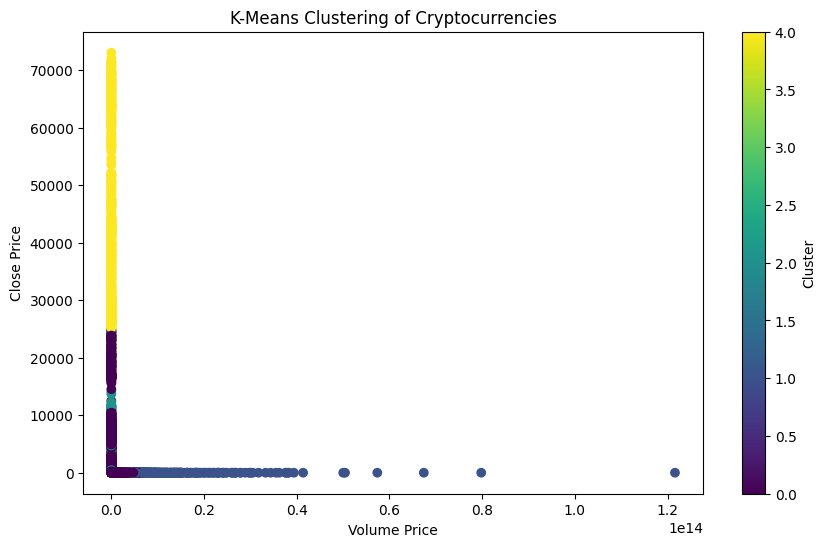

In [5]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

df = pd.read_csv('ccxt/combined_df.csv')
features = df[['Close', 'Volume', 'Market_Cap', 'return', 'Volatility', 'Liquidity']]

scaler = StandardScaler()
scaled_features = scaler.fit_transform(features)

kmeans = KMeans(n_clusters=5)  
df['Cluster'] = kmeans.fit_predict(scaled_features)

plt.figure(figsize=(10, 6))
plt.scatter(df['Volume'], df['Close'], c=df['Cluster'], cmap='viridis')
plt.title('K-Means Clustering of Cryptocurrencies')
plt.xlabel('Volume Price')
plt.ylabel('Close Price')
plt.colorbar(label='Cluster')
plt.show()

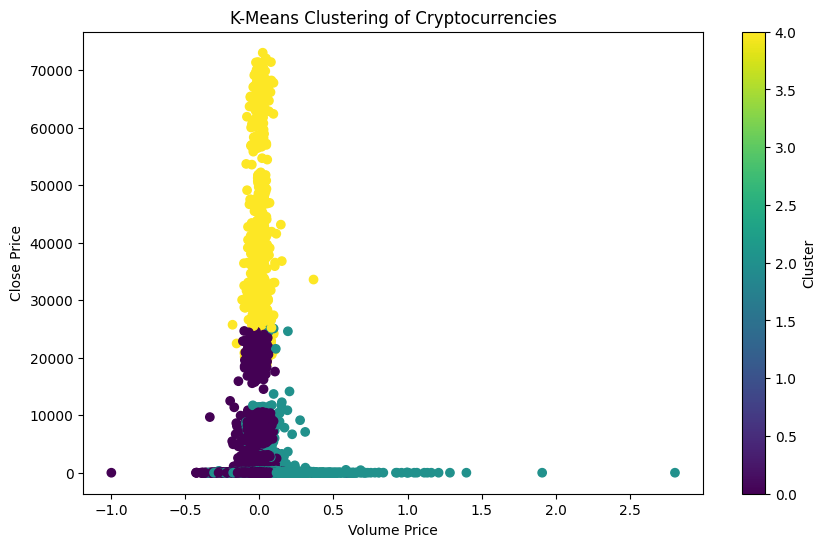

In [6]:

# Plotting the results
plt.figure(figsize=(10, 6))
plt.scatter(df['return'], df['Close'], c=df['Cluster'], cmap='viridis')
plt.title('K-Means Clustering of Cryptocurrencies')
plt.xlabel('Return Price')
plt.ylabel('Close Price')
plt.colorbar(label='Cluster')
plt.show()

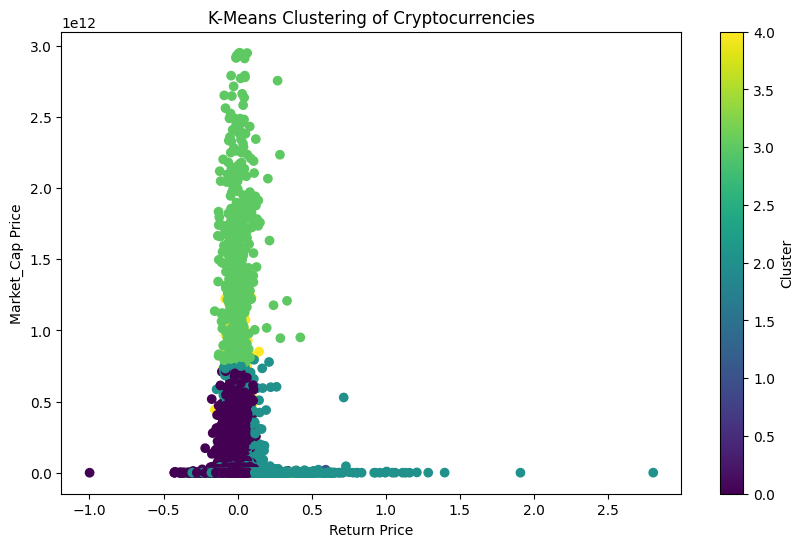

In [7]:

# Plotting the results
plt.figure(figsize=(10, 6))
plt.scatter(df['return'], df['Market_Cap'], c=df['Cluster'], cmap='viridis')
plt.title('K-Means Clustering of Cryptocurrencies')
plt.xlabel('Return Price')
plt.ylabel('Market_Cap Price')
plt.colorbar(label='Cluster')
plt.show()

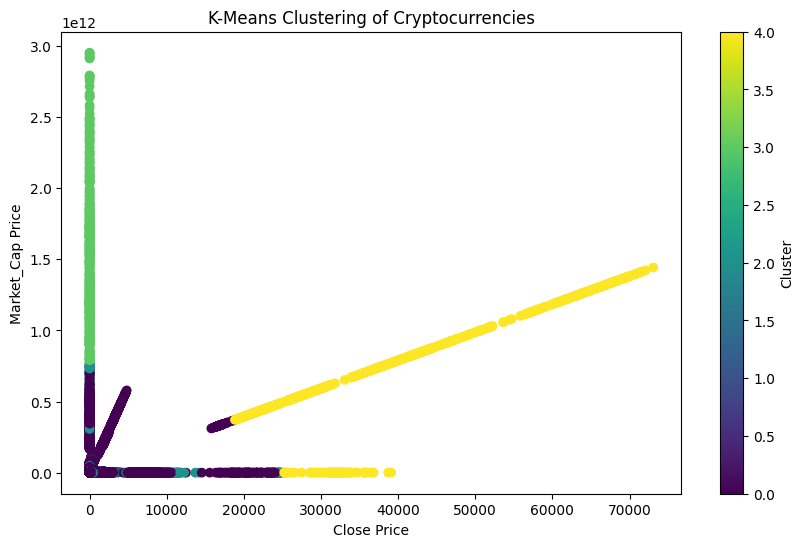

In [9]:

# Plotting the results
plt.figure(figsize=(10, 6))
plt.scatter(df['Close'], df['Market_Cap'], c=df['Cluster'], cmap='viridis')
plt.title('K-Means Clustering of Cryptocurrencies')
plt.xlabel('Close Price')
plt.ylabel('Market_Cap Price')
plt.colorbar(label='Cluster')
plt.show()

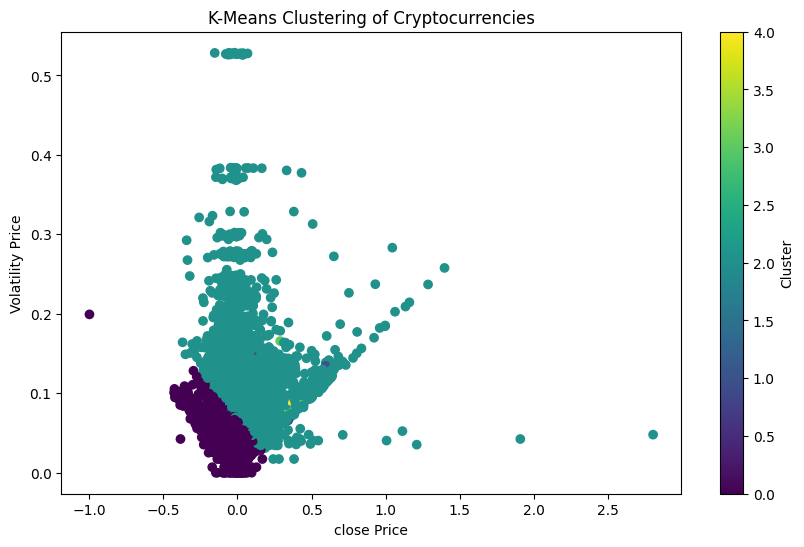

In [13]:

# Plotting the results
plt.figure(figsize=(10, 6))
plt.scatter(df['return'], df['Volatility'], c=df['Cluster'], cmap='viridis')
plt.title('K-Means Clustering of Cryptocurrencies')
plt.xlabel('close Price')
plt.ylabel('Volatility Price')
plt.colorbar(label='Cluster')
plt.show()

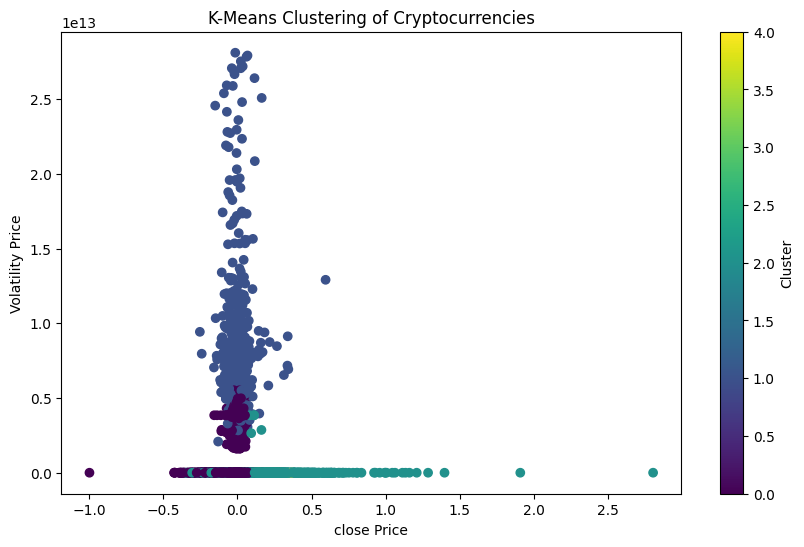

In [14]:

# Plotting the results
plt.figure(figsize=(10, 6))
plt.scatter(df['return'], df['Liquidity'], c=df['Cluster'], cmap='viridis')
plt.title('K-Means Clustering of Cryptocurrencies')
plt.xlabel('close Price')
plt.ylabel('Volatility Price')
plt.colorbar(label='Cluster')
plt.show()

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Load your dataset
combined_df = pd.read_csv('ccxt/combined_df.csv')

# Select relevant features for clustering
features = ['return', 'Volatility', 'Liquidity']  # Example features for clustering
X = combined_df[features]

# Scale the features
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Calculate WCSS for different numbers of clusters
wcss = []
for n_clusters in range(1, 11):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(X_scaled)
    wcss.append(kmeans.inertia_)

# Plot the Elbow Method
plt.figure(figsize=(10, 6))
plt.plot(range(1, 11), wcss, marker='o')
plt.title('Elbow Method for Optimal Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.xticks(range(1, 11))
plt.grid()
plt.show()

In [ ]:
from sklearn.cluster import KMeans
df = pd.read_csv('ccxt/combined_df.csv')
kmeans = KMeans(n_clusters=5)
clusters = kmeans.fit_predict(x)

plt.figure(figsize=(8, 6))
plt.scatter(principal_df['PC1'], principal_df['PC2'], c=clusters)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('K-Means Clustering of Cryptocurrencies')
plt.show()

##### overall trends

median

In [ ]:
top_cryptos = df.groupby('Timestamp')['Market_Cap'].nlargest(10).reset_index()
plt.figure(figsize=(10, 5))
for crypto in top_cryptos['Cryptocurrency'].unique():
    plt.plot(top_cryptos[top_cryptos['Cryptocurrency'] == crypto]['Timestamp'], 
             top_cryptos[top_cryptos['Cryptocurrency'] == crypto]['Market_Cap'], 
             label=crypto)

plt.xlabel('Time')
plt.ylabel('Market Cap')
plt.title('Market Cap Dominance of Top Cryptocurrencies')
plt.legend()
plt.show()

#### Visualization

In [ ]:
import os 
import pandas as pd
import matplotlib.pyplot as plt

path = 'ccxt/factors/'
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    df.plot(figsize=(10, 6), linewidth=2)
    plt.legend(loc='upper left')
    plt.title(f'Trends of {name} Columns')
    plt.xlabel('Index')
    plt.ylabel('Values')

    plt.show()

In [ ]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
import os 
import pandas as pd
import matplotlib.pyplot as plt

path = 'ccxt/factors/'
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    df = pd.read_csv(path + full_name)
    scaler = StandardScaler()
    normalized_columns =['Close', 'Volume', 'Bid Price',
                        'Market_Cap', 'Momentum', 'Volatility', 'Liquidity',
                        'amihud_illiquidity', 'Market_Factor', 'return']
    # df[normalized_columns] = scaler.fit_transform(df[normalized_columns])
    df[normalized_columns].plot(figsize=(10, 6), linewidth=2)

    plt.legend(loc='upper left')

    plt.title(f'Trends of {name} Columns')
    plt.xlabel('Index')
    plt.ylabel('Values')

    plt.show()

#### AI tokens 

In [55]:
# os.makedirs('AI tokens')
dff = pd.read_csv('economic/day-DFF.csv')
inf = pd.read_csv('economic/day-T10YIE.csv')
path = 'ccxt/imperfect_tokens/'
path2='google trends/'
path3 = 'economic/'
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    if 'ocean' in name.lower() or 'agix' in name.lower() or 'nmr' in name.lower():
        df = pd.read_csv(path + full_name)
        df['Timestamp'] = pd.to_datetime(df['Timestamp'], unit='ms')
        dff['DATE'] = pd.to_datetime(dff['DATE'])
        inf['DATE'] = pd.to_datetime(inf['DATE'])

        merged = pd.merge(df, dff , left_on='Timestamp', right_on='DATE')
        merged = pd.merge(merged, inf , left_on='Timestamp', right_on='DATE')
        merged.to_csv(f'AI tokens/{name}.csv',index=False)

path = 'AI tokens/'
all_dataframes = []
for full_name in os.listdir(path):
    df = pd.read_csv(os.path.join(path, full_name)) 
    df['Crypto'] = full_name.split(".")[0]  
    all_dataframes.append(df)  
combined_df = pd.concat(all_dataframes, ignore_index=True)
combined_df.columns
combined_df.to_csv('AI tokens/combined.csv', index=False)

In [73]:
import pandas as pd
import os
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

# scaler = MinMaxScaler()
# scaler = StandardScaler()
combined_df = pd.read_csv('AI tokens/combined.csv')
columns = ['Market_Cap', 'Momentum', 'Volatility', 'Liquidity', 
            'amihud_illiquidity', 'Bid Price', 'Ask Price', 'Bid Depth', 'Ask Depth',
            'Bid-Ask Spread', 'Volume','return', 'size_factor', 'NVT', 'HML',  ]

# df_standardized = pd.DataFrame(scaler.fit_transform(combined_df[columns]), columns=columns)
# df_standardized['Crypto'] = combined_df['Crypto']
df_standardized = combined_df
average_returns = df_standardized.groupby('Crypto')['return'].mean()
average_Volume = df_standardized.groupby('Crypto')['Volume'].mean()
average_volatility = df_standardized.groupby('Crypto')['Volatility'].mean()
average_liquidity = df_standardized.groupby('Crypto')['Liquidity'].mean()
average_Momentum = df_standardized.groupby('Crypto')['Momentum'].mean()
average_size_factor = df_standardized.groupby('Crypto')['size_factor'].mean()
average_value_factor = df_standardized.groupby('Crypto')['HML'].mean()
average_Market_Cap = df_standardized.groupby('Crypto')['Market_Cap'].mean()

trends_df = pd.DataFrame({
    'Average Return': average_returns,
    'Average Volume': average_Volume,
    'Average Volatility': average_volatility,
    'Average Liquidity': average_liquidity,
    'Average Momentum': average_Momentum,
    'Average Size Factor': average_size_factor,
    'Average Value Factor': average_value_factor,
    'Average Market Cap': average_Market_Cap,
}).reset_index()

correlation_matrix = df_standardized[[  'Volume', 'Bid Price',
       'Ask Price', 'Bid Depth', 'Ask Depth', 'Bid-Ask Spread', 'return',
       'Market_Cap', 'Momentum', 'Volatility', 'Liquidity',
       'amihud_illiquidity',  'size_factor','HML']].corr()





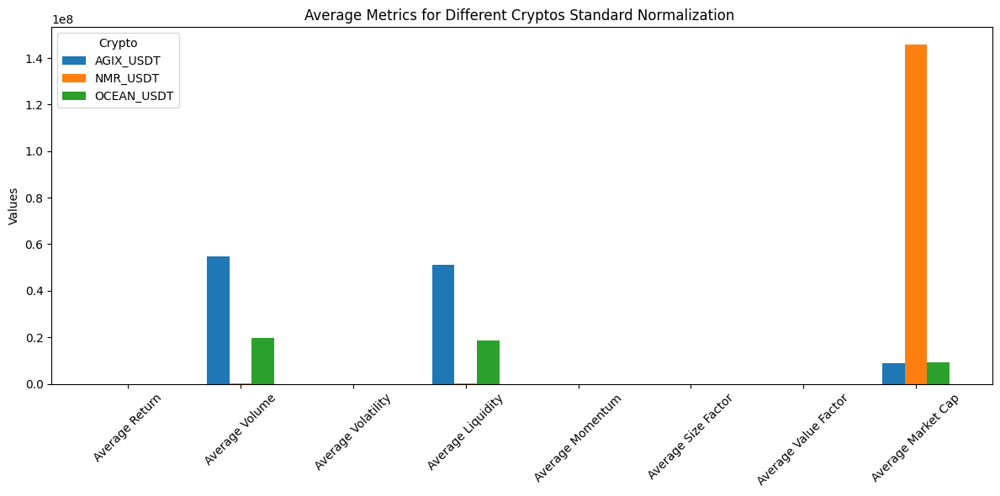

In [74]:

trends_df = trends_df.set_index('Crypto').T

# Create a range for the x-axis
x = np.arange(len(trends_df.index))  # the label locations
width = 0.2  # the width of the bars
multiplier = 0

fig, ax = plt.subplots(figsize=(12, 6))

# Plot each crypto as a separate set of bars
for crypto in trends_df.columns:
    offset = width * multiplier
    rects = ax.bar(x + offset, trends_df[crypto], width, label=crypto)
    # ax.bar_label(rects, padding=3)
    multiplier += 1

# Set labels and title
ax.set_ylabel('Values')
ax.set_title('Average Metrics for Different Cryptos Standard Normalization ')
ax.set_xticks(x + width, trends_df.index)
ax.legend(title='Crypto')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

AGIX_USDT
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 357 entries, 0 to 356
Data columns (total 27 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Timestamp           357 non-null    object 
 1   Open                357 non-null    float64
 2   High                357 non-null    float64
 3   Low                 357 non-null    float64
 4   Close               357 non-null    float64
 5   Volume              357 non-null    float64
 6   Bid Price           357 non-null    float64
 7   Ask Price           357 non-null    float64
 8   Bid Depth           357 non-null    float64
 9   Ask Depth           357 non-null    float64
 10  Bid-Ask Spread      357 non-null    float64
 11  return              357 non-null    float64
 12  Market_Cap          357 non-null    float64
 13  Momentum            357 non-null    float64
 14  Volatility          357 non-null    float64
 15  Liquidity           357 non-null    float64
 16

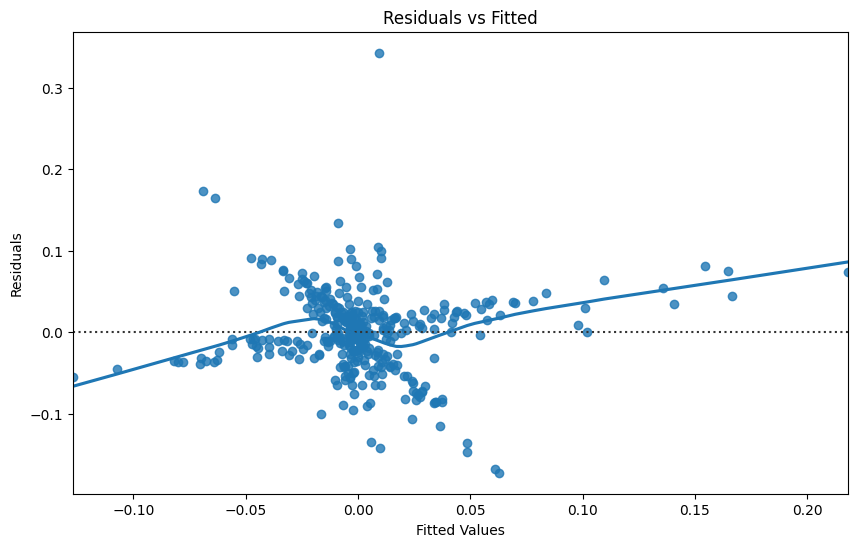

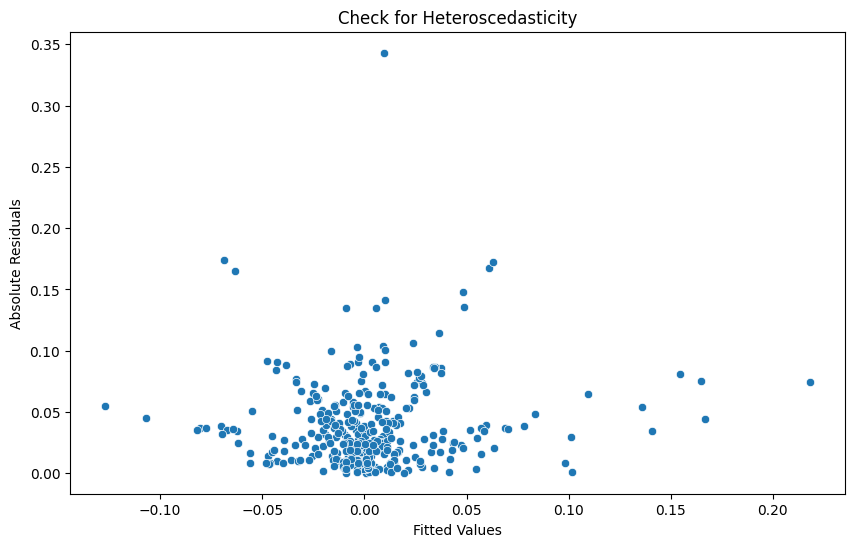

Results and plots have been saved to the output directory.
NMR_USDT
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 714 entries, 0 to 713
Data columns (total 28 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   DATE_x              714 non-null    object 
 1   T10YIE              714 non-null    float64
 2   DATE_y              714 non-null    object 
 3   DFF                 714 non-null    float64
 4   Timestamp           714 non-null    object 
 5   Open                714 non-null    float64
 6   High                714 non-null    float64
 7   Low                 714 non-null    float64
 8   Close               714 non-null    float64
 9   Volume              714 non-null    float64
 10  Bid Price           714 non-null    float64
 11  Ask Price           714 non-null    float64
 12  Bid Depth           714 non-null    float64
 13  Ask Depth           714 non-null    float64
 14  Bid-Ask Spread      714 non-null    fl

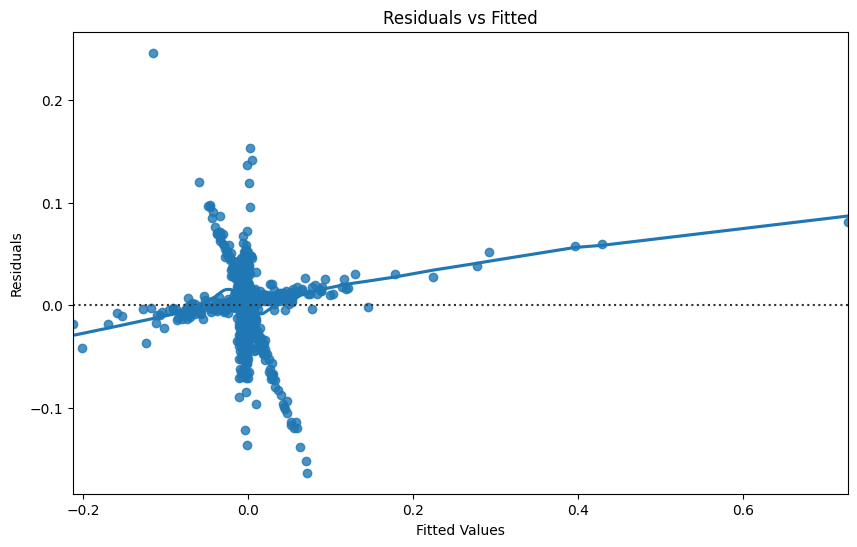

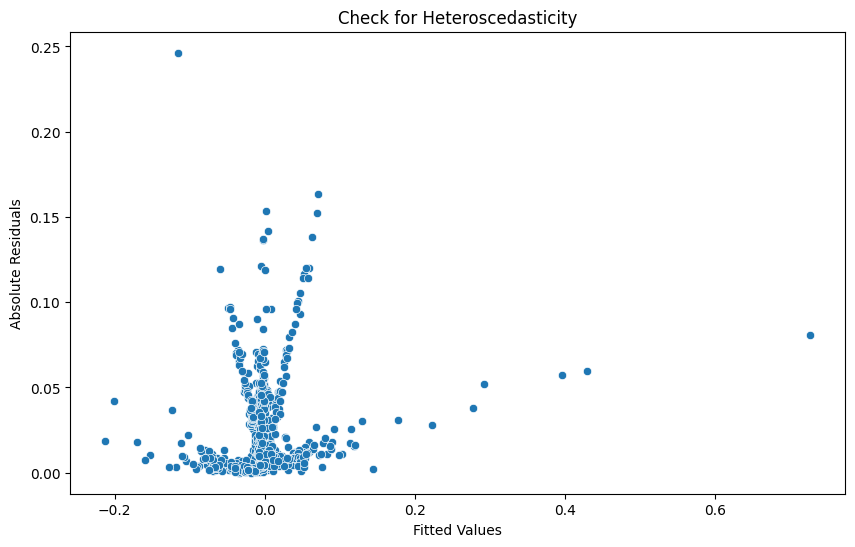

Results and plots have been saved to the output directory.
OCEAN_USDT
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 714 entries, 0 to 713
Data columns (total 27 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Timestamp           714 non-null    object 
 1   Open                714 non-null    float64
 2   High                714 non-null    float64
 3   Low                 714 non-null    float64
 4   Close               714 non-null    float64
 5   Volume              714 non-null    float64
 6   Bid Price           714 non-null    float64
 7   Ask Price           714 non-null    float64
 8   Bid Depth           714 non-null    float64
 9   Ask Depth           714 non-null    float64
 10  Bid-Ask Spread      714 non-null    float64
 11  return              714 non-null    float64
 12  Market_Cap          714 non-null    float64
 13  Momentum            714 non-null    float64
 14  Volatility          714 non-null    

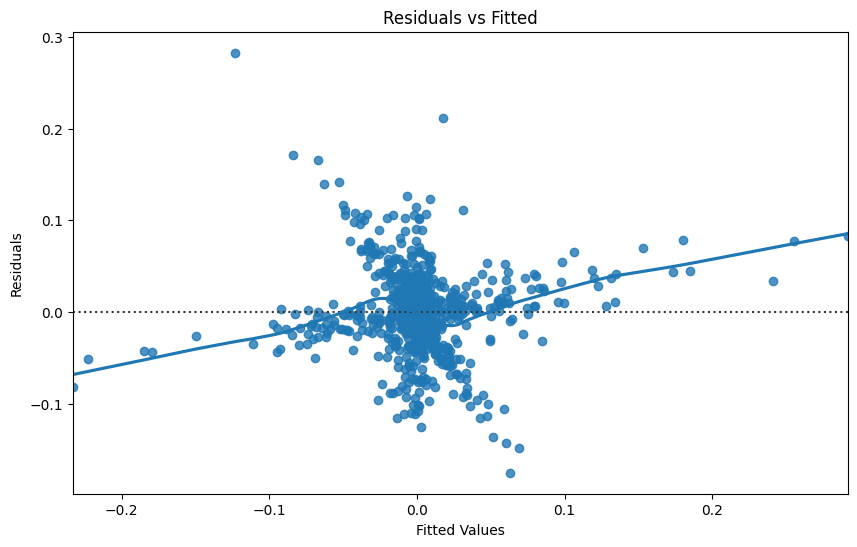

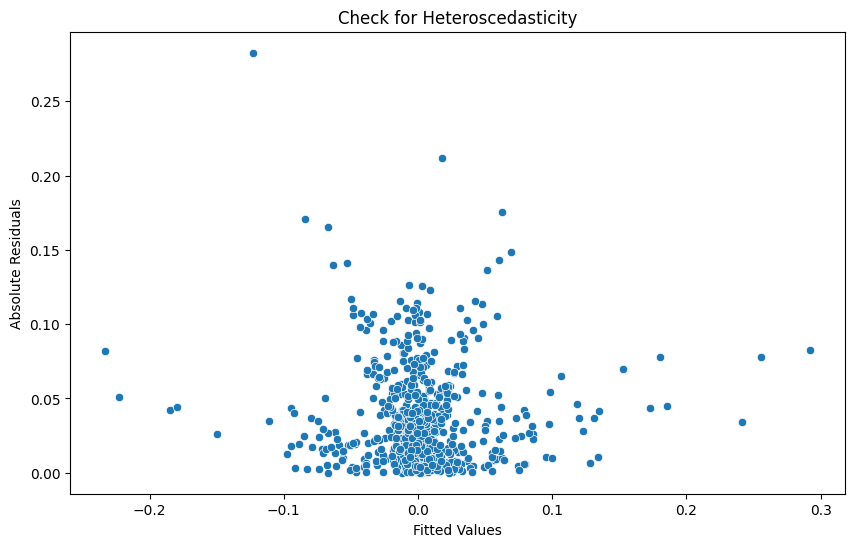

Results and plots have been saved to the output directory.


In [35]:
path = 'AI tokens/'

dff = pd.read_csv('economic/day-DFF.csv')
inf = pd.read_csv('economic/day-T10YIE.csv')
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    print(f"{YELLOW_BOLD}{name}{RESET}")

    df = pd.read_csv(path + full_name)
    df.fillna(0, inplace=True)
    df['T10YIE'] = df['T10YIE'].replace('.', '0')
    df['T10YIE'] = df['T10YIE'].astype(float)
    print(df.info())
    
    X = df[['Market_Cap', 'Momentum', 'Volatility', 'Liquidity', 
             'amihud_illiquidity', 'size_factor', 'NVT', 'HML', 'DFF', 'T10YIE']]
    y = df['return']
    
    X = sm.add_constant(X)
    
    model = sm.OLS(y, X).fit()
    
    # with open(os.path.join(output_dir, f"model_summary.txt"), 'a') as f:
    #     f.write('\n'+name)
    #     f.write(str(model.summary()))
    print(model.summary())
    # Residuals vs Fitted plot
    plt.figure(figsize=(10, 6))
    sns.residplot(x=model.fittedvalues, y=model.resid, lowess=True)
    plt.xlabel('Fitted Values')
    plt.ylabel('Residuals')
    plt.title('Residuals vs Fitted')
    plt.show()
    plt.close()   
    
    # Check for Heteroscedasticity plot
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x=model.fittedvalues, y=abs(model.resid))
    plt.xlabel('Fitted Values')
    plt.ylabel('Absolute Residuals')
    plt.title('Check for Heteroscedasticity')
    plt.show()
    plt.close()  
    print("Results and plots have been saved to the output directory.")

#### factor modelling

1INCH_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.463
Model:                            OLS   Adj. R-squared:                  0.457
Method:                 Least Squares   F-statistic:                     67.58
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           3.18e-89
Time:                        23:29:16   Log-Likelihood:                 1396.4
No. Observations:                 714   AIC:                            -2773.
Df Residuals:                     704   BIC:                            -2727.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.

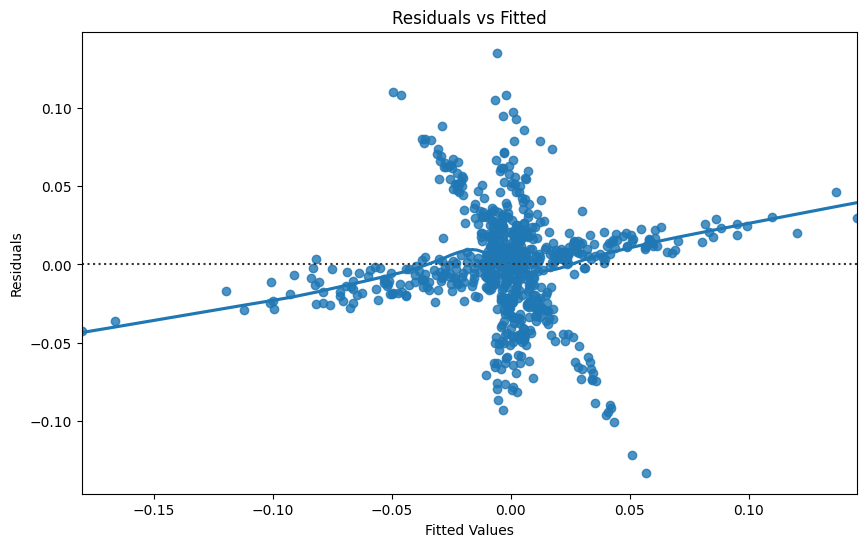

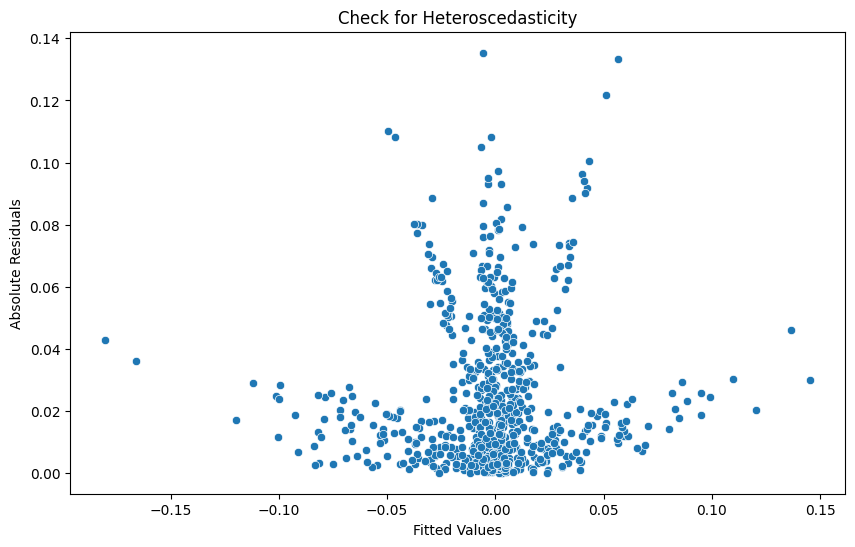

AAVE_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.469
Model:                            OLS   Adj. R-squared:                  0.462
Method:                 Least Squares   F-statistic:                     69.12
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           8.17e-91
Time:                        23:29:17   Log-Likelihood:                 1282.0
No. Observations:                 714   AIC:                            -2544.
Df Residuals:                     704   BIC:                            -2498.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

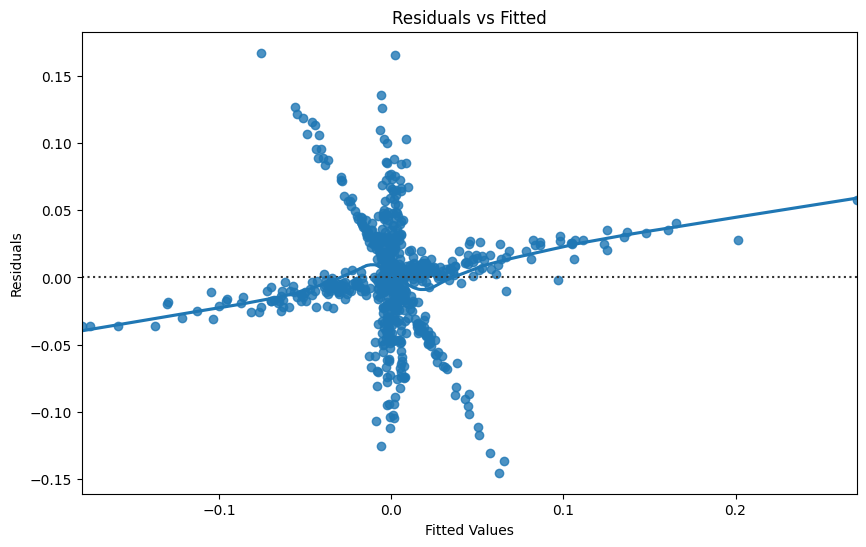

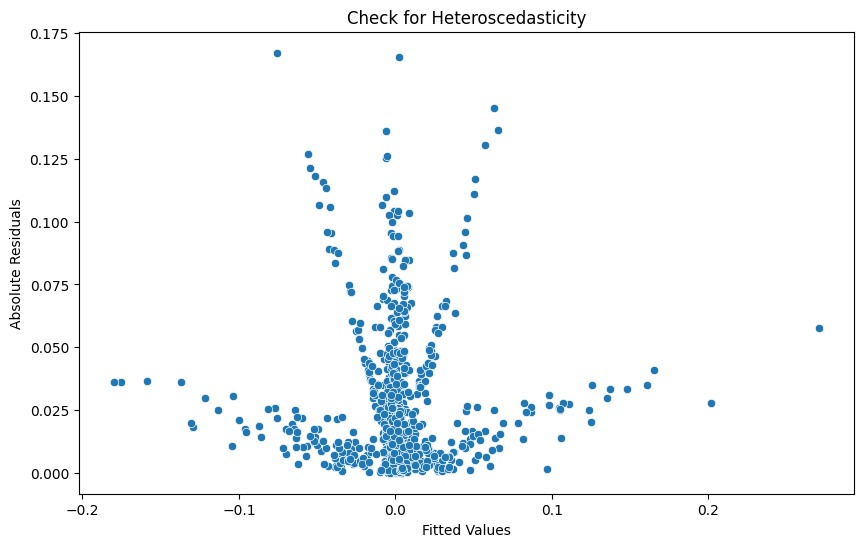

ADA_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.606
Model:                            OLS   Adj. R-squared:                  0.601
Method:                 Least Squares   F-statistic:                     120.3
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          5.31e-136
Time:                        23:29:18   Log-Likelihood:                 1523.9
No. Observations:                 714   AIC:                            -3028.
Df Residuals:                     704   BIC:                            -2982.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

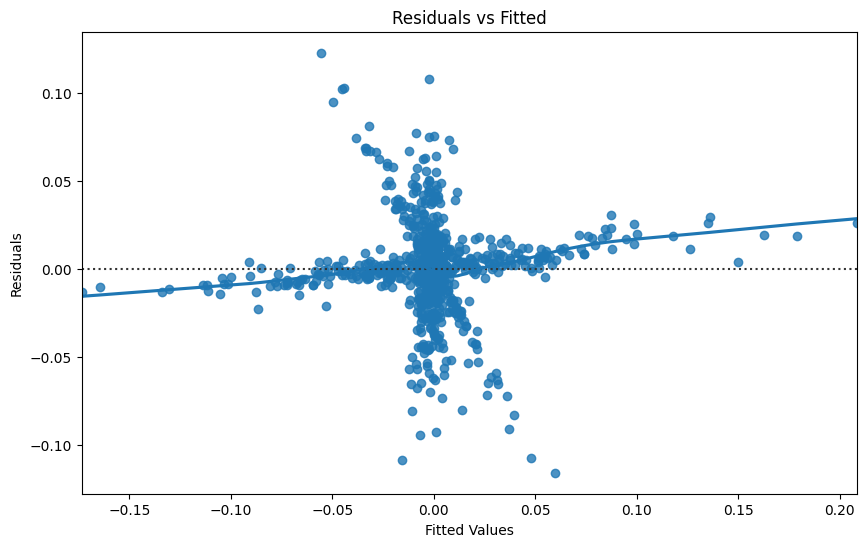

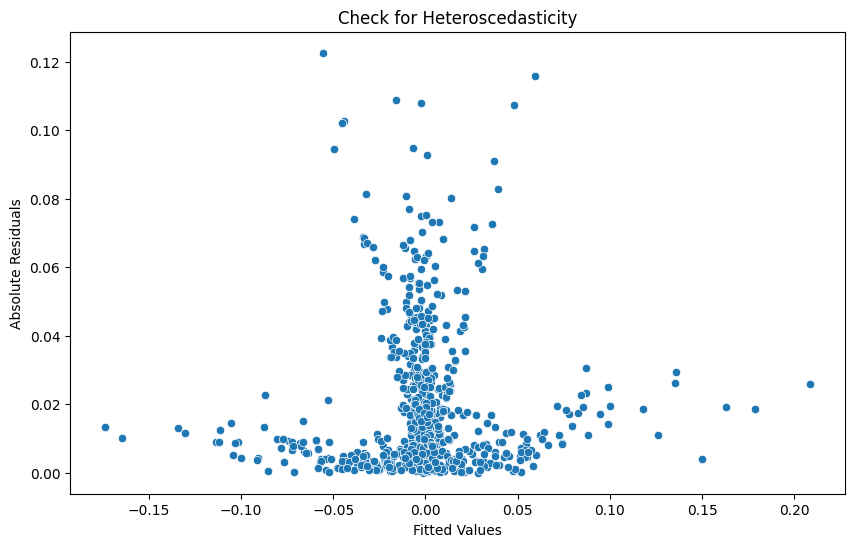

AKRO_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.663
Model:                            OLS   Adj. R-squared:                  0.659
Method:                 Least Squares   F-statistic:                     173.3
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          6.93e-161
Time:                        23:29:18   Log-Likelihood:                 1266.6
No. Observations:                 714   AIC:                            -2515.
Df Residuals:                     705   BIC:                            -2474.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap         -5.661e

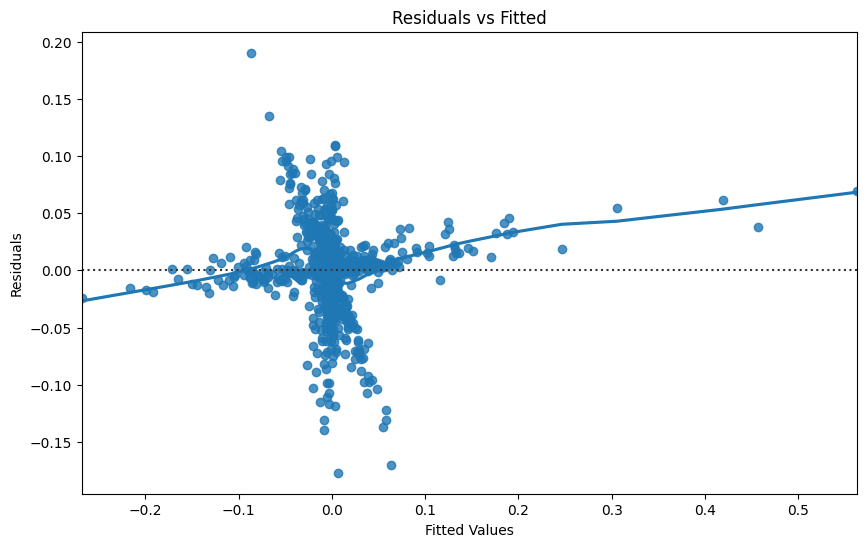

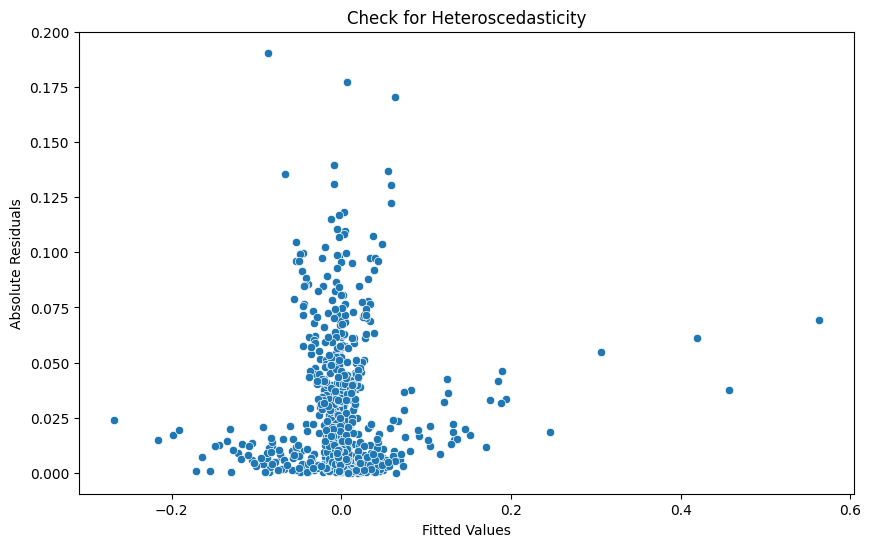

ALGO_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.425
Model:                            OLS   Adj. R-squared:                  0.418
Method:                 Least Squares   F-statistic:                     57.86
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           8.19e-79
Time:                        23:29:19   Log-Likelihood:                 1339.0
No. Observations:                 714   AIC:                            -2658.
Df Residuals:                     704   BIC:                            -2612.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

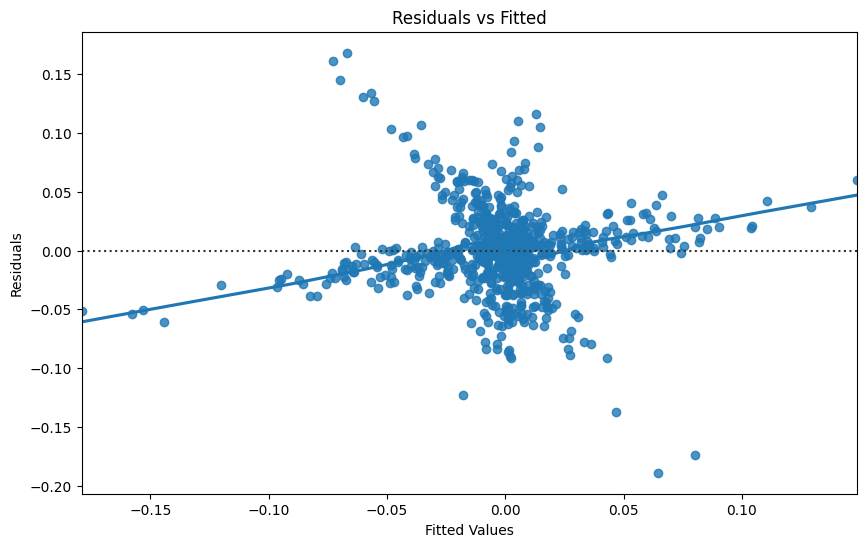

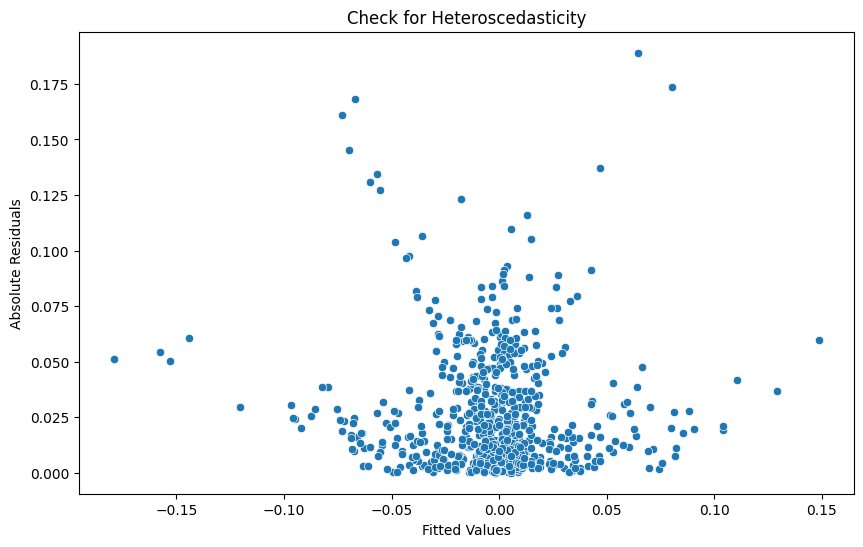

ALICE_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.494
Model:                            OLS   Adj. R-squared:                  0.487
Method:                 Least Squares   F-statistic:                     76.32
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           4.96e-98
Time:                        23:29:20   Log-Likelihood:                 1231.2
No. Observations:                 714   AIC:                            -2442.
Df Residuals:                     704   BIC:                            -2397.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.

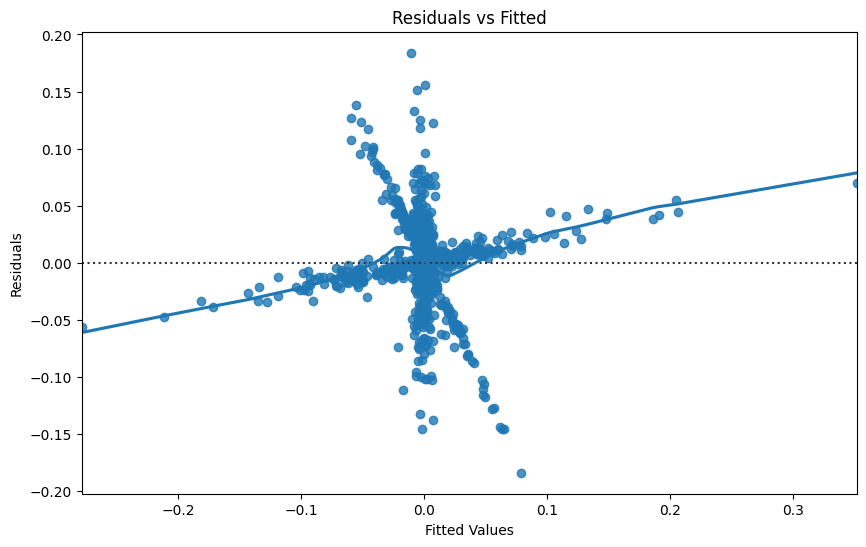

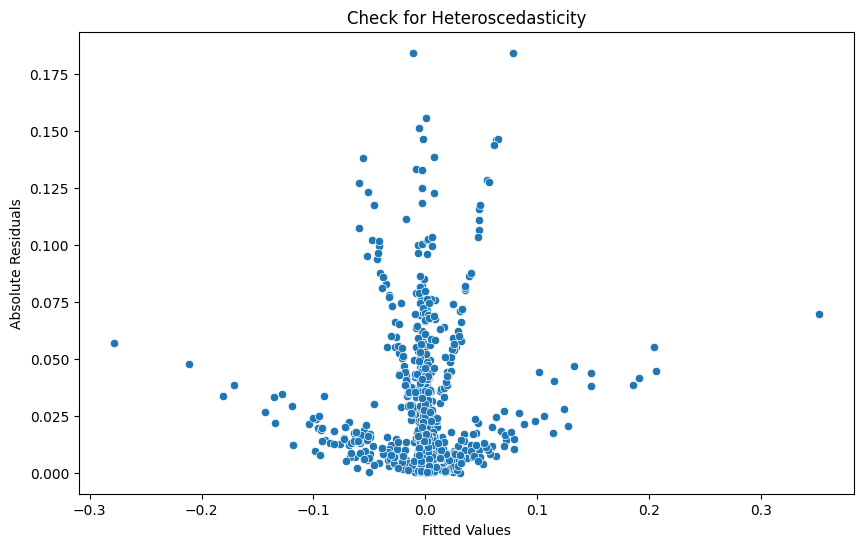

ALPHA_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.444
Model:                            OLS   Adj. R-squared:                  0.437
Method:                 Least Squares   F-statistic:                     62.55
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           6.30e-84
Time:                        23:29:21   Log-Likelihood:                 1254.2
No. Observations:                 714   AIC:                            -2488.
Df Residuals:                     704   BIC:                            -2443.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.

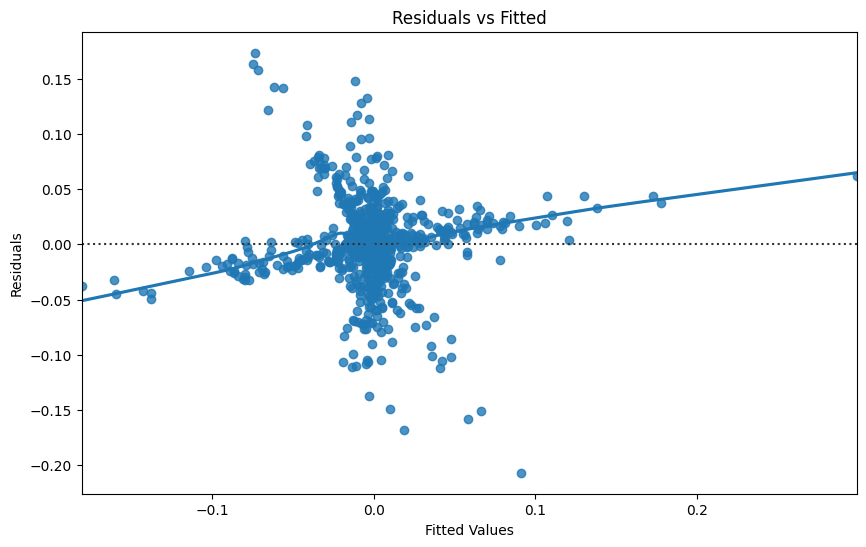

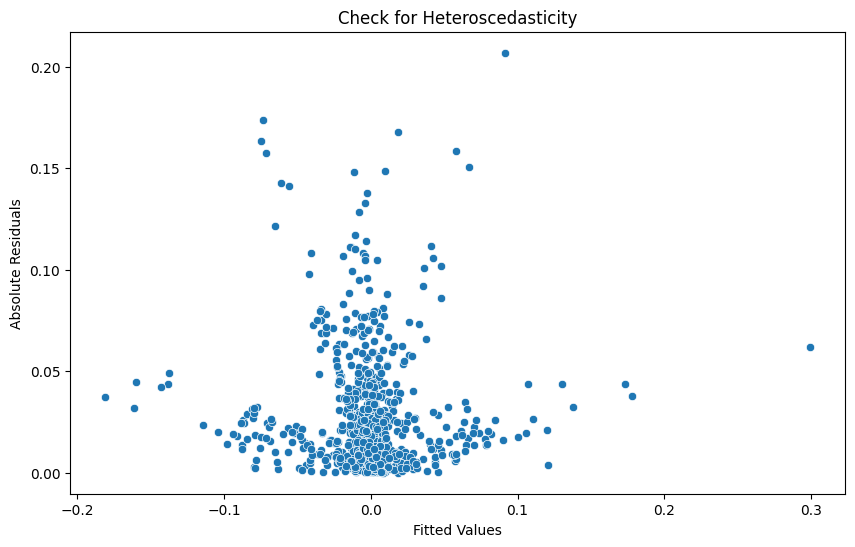

ARDR_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.469
Model:                            OLS   Adj. R-squared:                  0.463
Method:                 Least Squares   F-statistic:                     77.90
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           8.47e-92
Time:                        23:29:22   Log-Likelihood:                 1411.8
No. Observations:                 714   AIC:                            -2806.
Df Residuals:                     705   BIC:                            -2764.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          3.504e

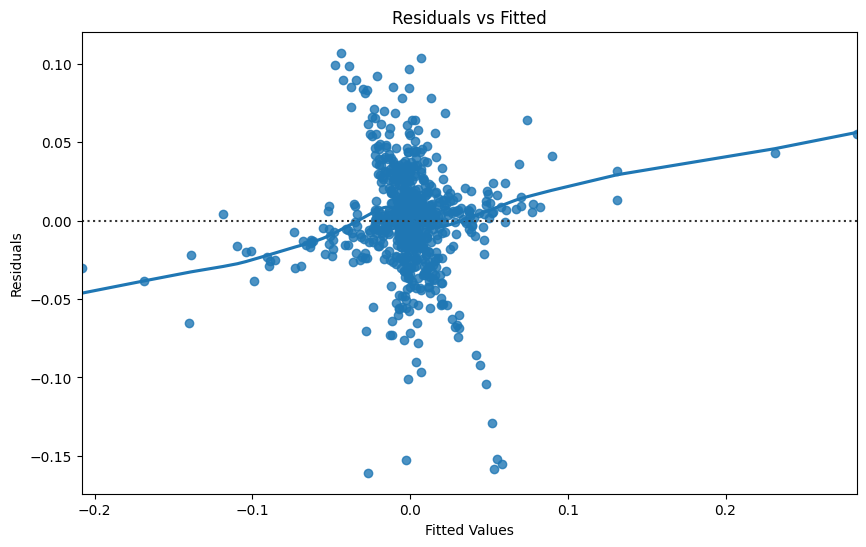

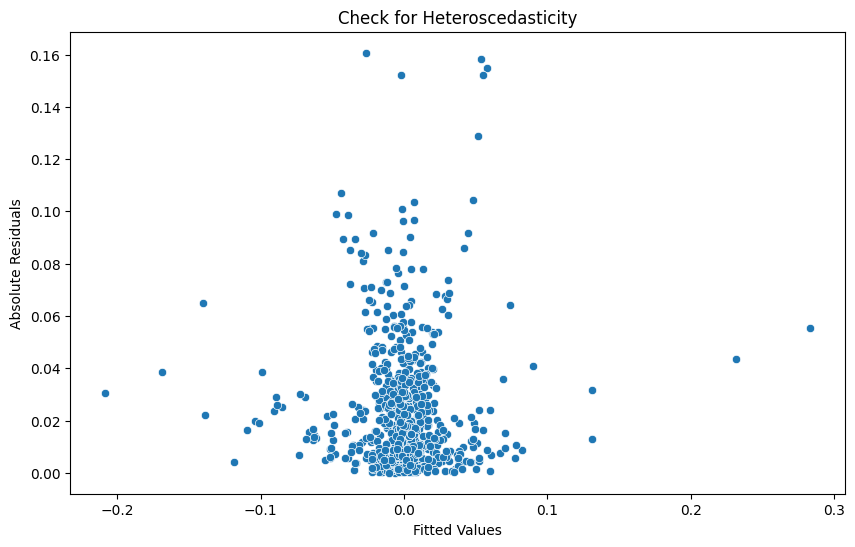

ARPA_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.530
Model:                            OLS   Adj. R-squared:                  0.525
Method:                 Least Squares   F-statistic:                     99.49
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          2.34e-110
Time:                        23:29:23   Log-Likelihood:                 1233.6
No. Observations:                 714   AIC:                            -2449.
Df Residuals:                     705   BIC:                            -2408.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap         -2.858e

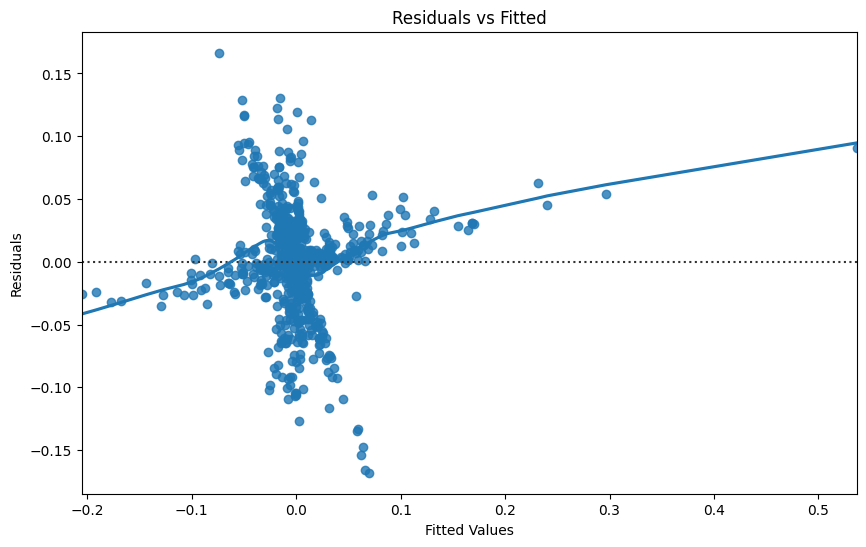

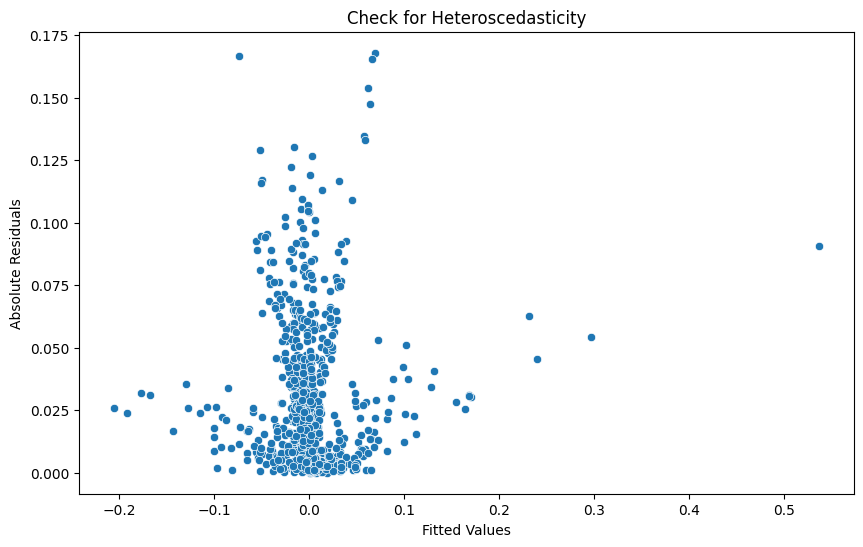

AR_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.488
Model:                            OLS   Adj. R-squared:                  0.481
Method:                 Least Squares   F-statistic:                     74.55
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           2.74e-96
Time:                        23:29:24   Log-Likelihood:                 1176.7
No. Observations:                 714   AIC:                            -2333.
Df Residuals:                     704   BIC:                            -2288.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.029

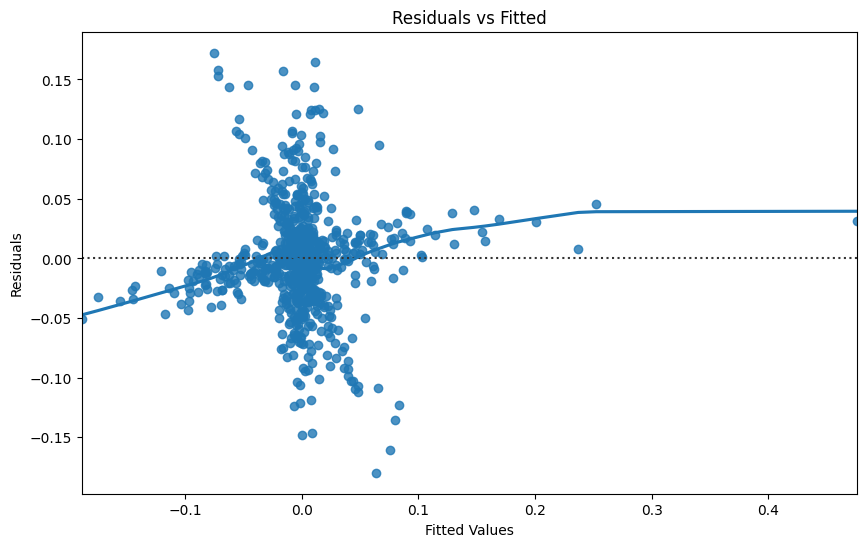

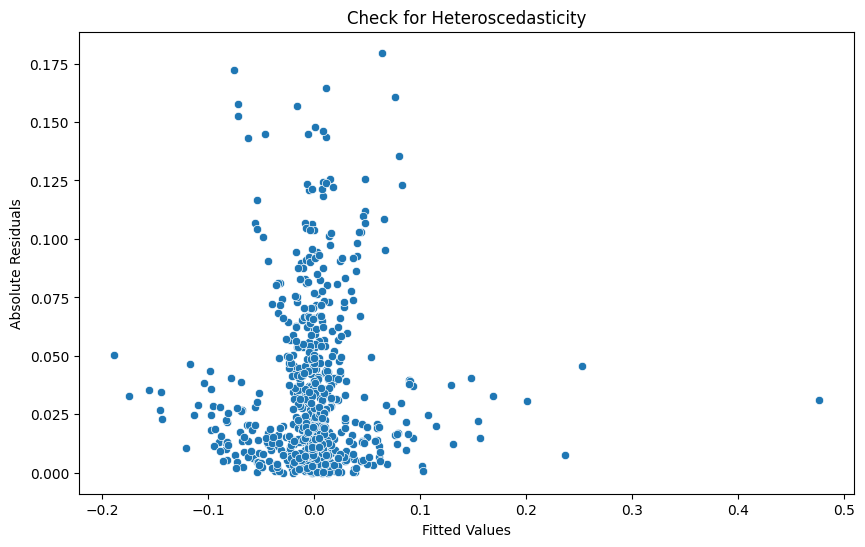

ATOM_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.506
Model:                            OLS   Adj. R-squared:                  0.499
Method:                 Least Squares   F-statistic:                     79.97
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.46e-101
Time:                        23:29:24   Log-Likelihood:                 1381.8
No. Observations:                 714   AIC:                            -2744.
Df Residuals:                     704   BIC:                            -2698.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.0

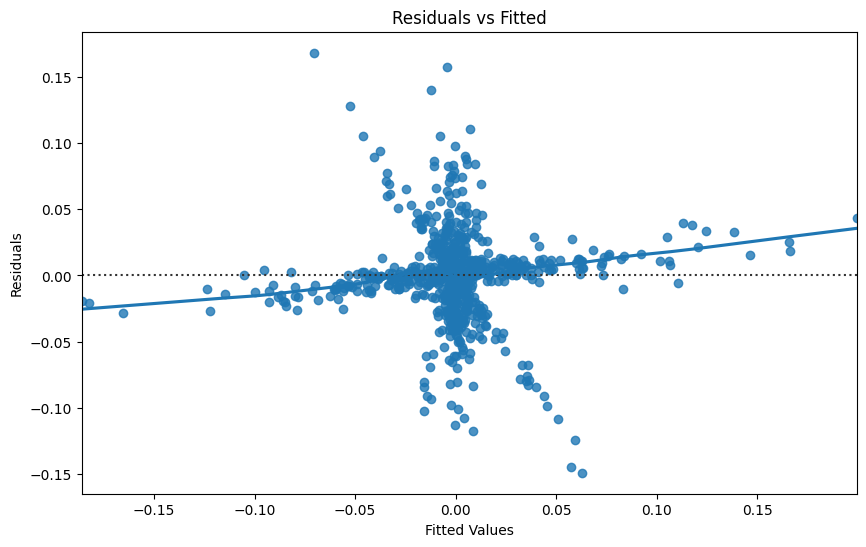

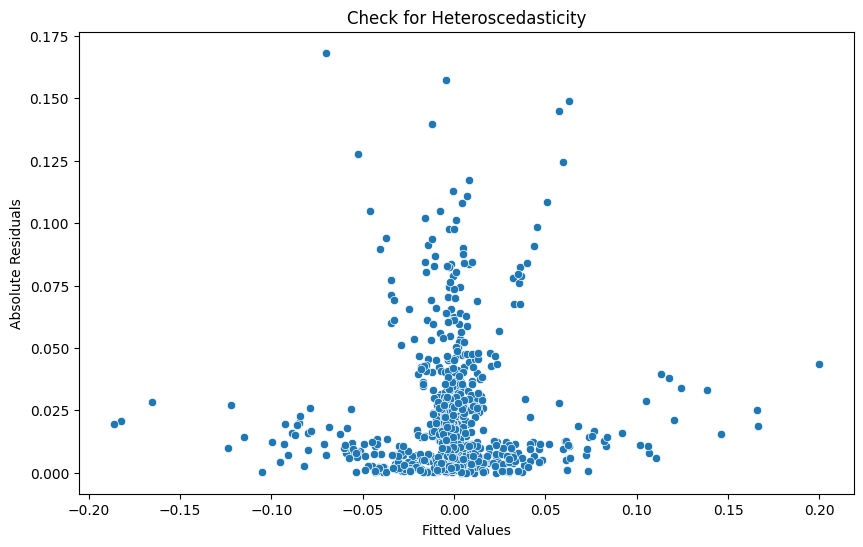

AUCTION_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.500
Model:                            OLS   Adj. R-squared:                  0.494
Method:                 Least Squares   F-statistic:                     88.02
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          8.84e-101
Time:                        23:29:25   Log-Likelihood:                 1114.5
No. Observations:                 714   AIC:                            -2211.
Df Residuals:                     705   BIC:                            -2170.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          1.0

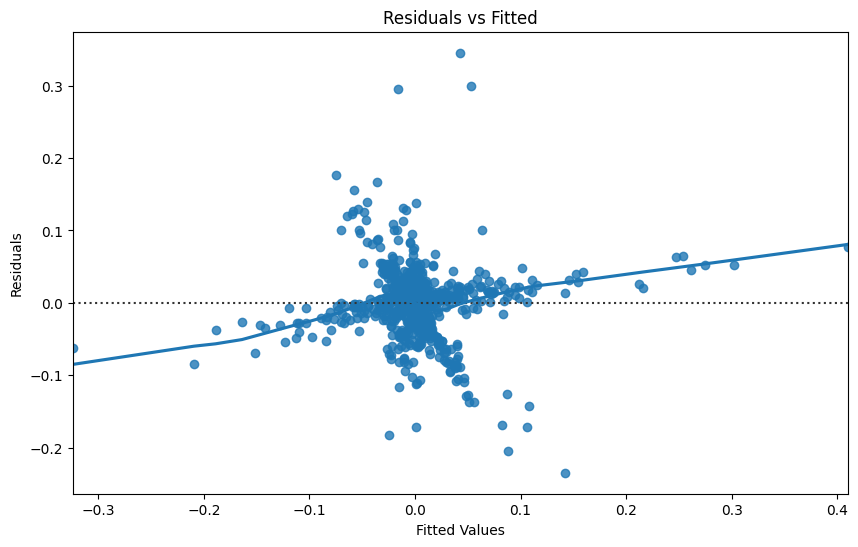

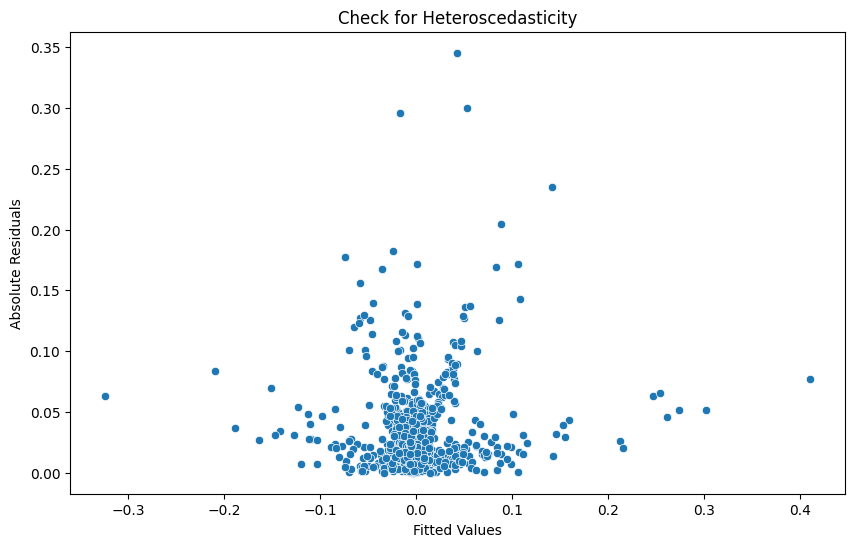

AUDIO_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.485
Model:                            OLS   Adj. R-squared:                  0.479
Method:                 Least Squares   F-statistic:                     73.75
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           1.72e-95
Time:                        23:29:26   Log-Likelihood:                 1248.3
No. Observations:                 714   AIC:                            -2477.
Df Residuals:                     704   BIC:                            -2431.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.

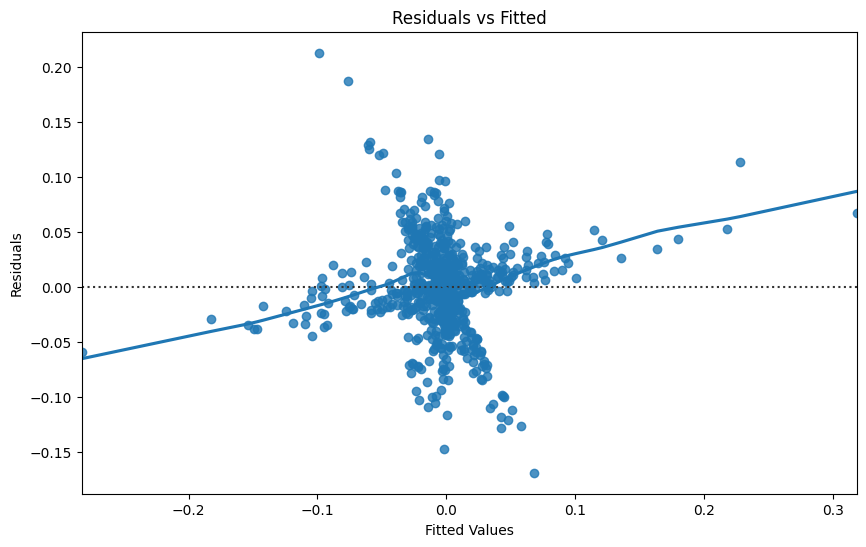

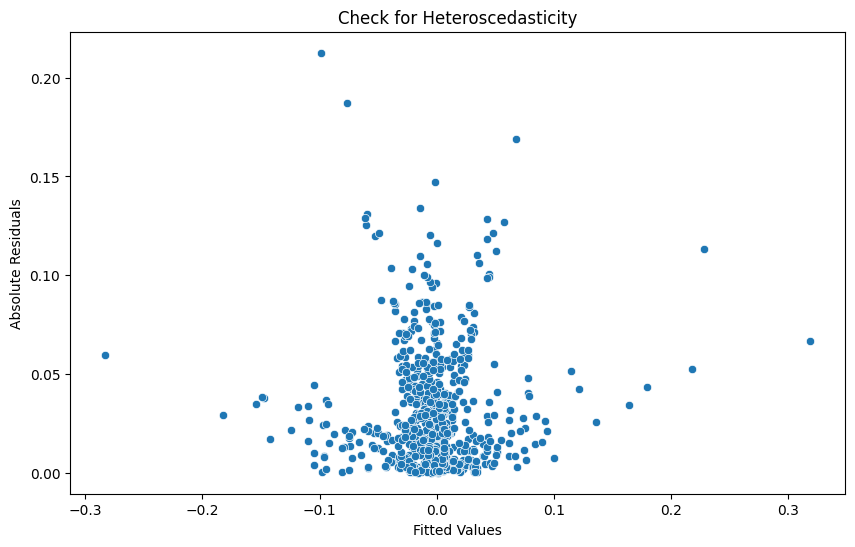

AVAX_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.438
Model:                            OLS   Adj. R-squared:                  0.431
Method:                 Least Squares   F-statistic:                     60.92
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           3.65e-82
Time:                        23:29:27   Log-Likelihood:                 1272.7
No. Observations:                 714   AIC:                            -2525.
Df Residuals:                     704   BIC:                            -2480.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

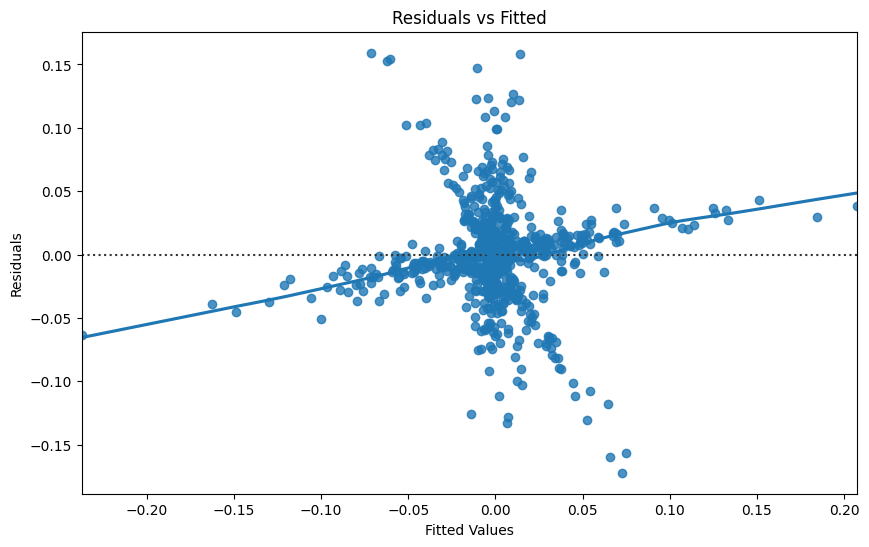

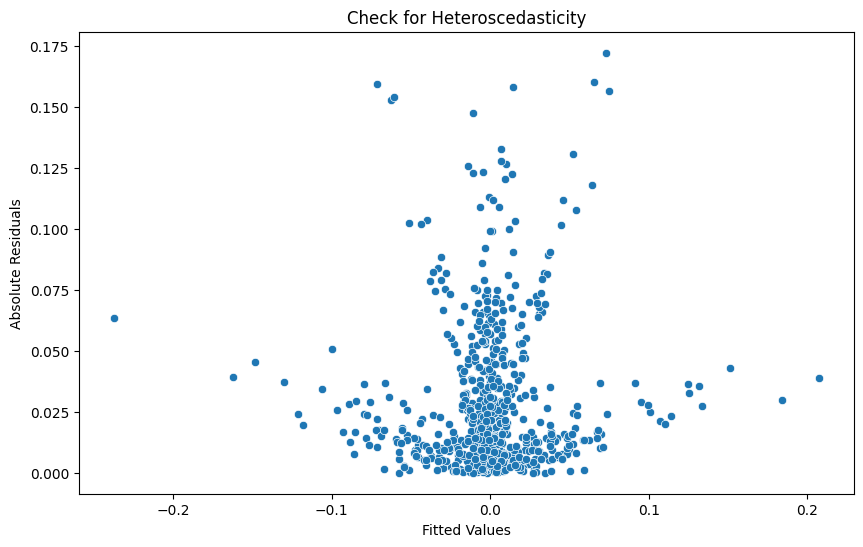

AXS_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.516
Model:                            OLS   Adj. R-squared:                  0.510
Method:                 Least Squares   F-statistic:                     83.33
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          9.61e-105
Time:                        23:29:28   Log-Likelihood:                 1357.6
No. Observations:                 714   AIC:                            -2695.
Df Residuals:                     704   BIC:                            -2649.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

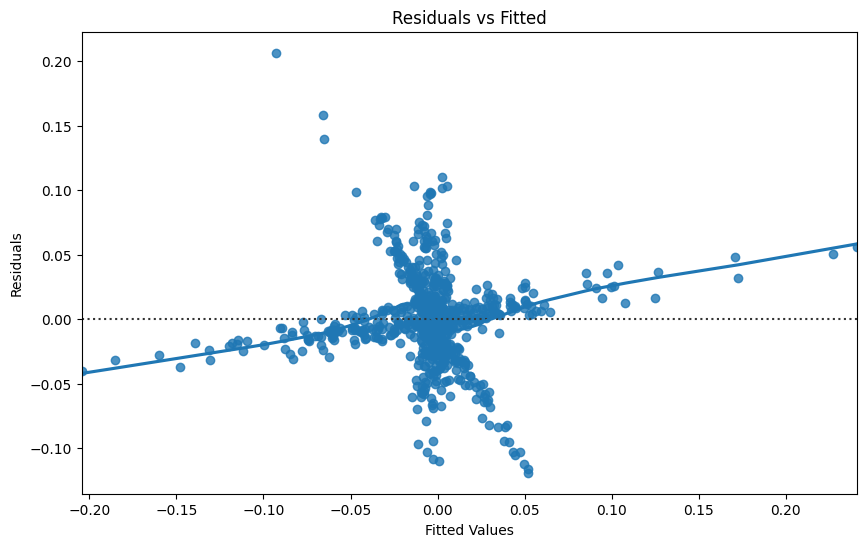

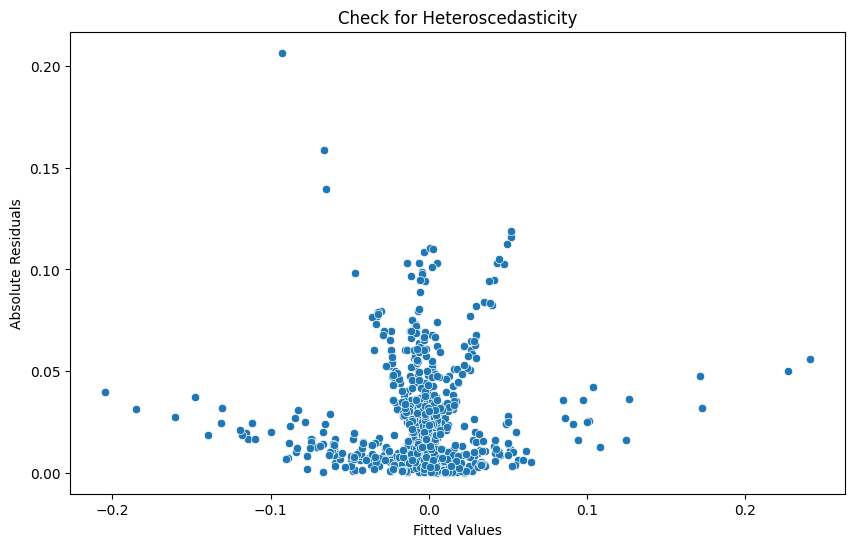

BADGER_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.567
Model:                            OLS   Adj. R-squared:                  0.562
Method:                 Least Squares   F-statistic:                     115.5
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          7.88e-123
Time:                        23:29:29   Log-Likelihood:                 1244.7
No. Observations:                 714   AIC:                            -2471.
Df Residuals:                     705   BIC:                            -2430.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          3.92

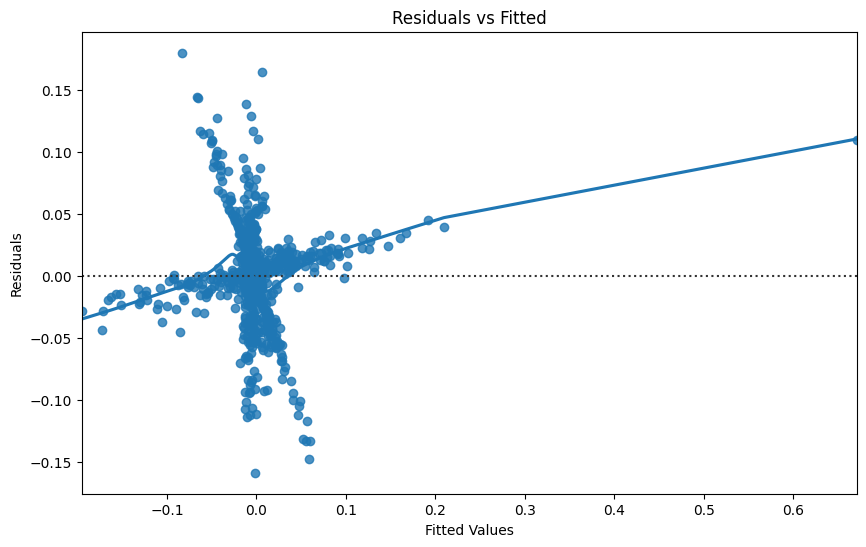

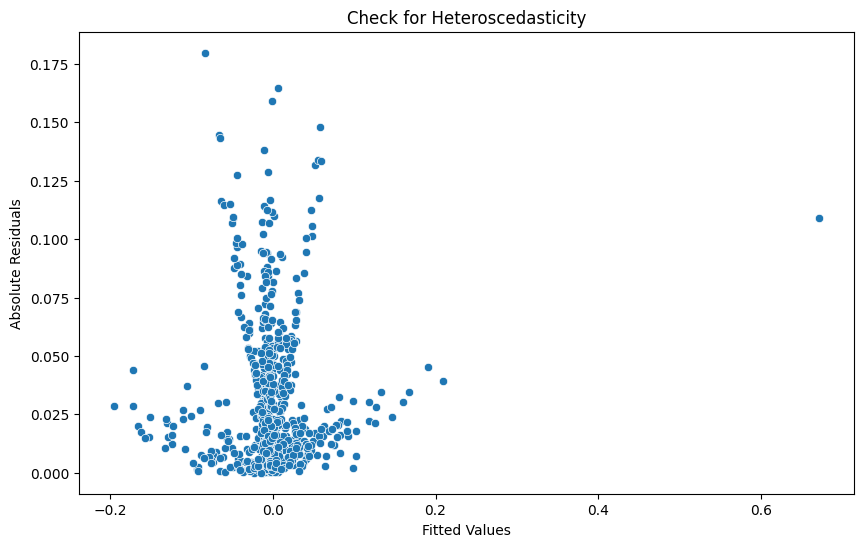

BAL_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.377
Model:                            OLS   Adj. R-squared:                  0.369
Method:                 Least Squares   F-statistic:                     47.30
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           1.21e-66
Time:                        23:29:29   Log-Likelihood:                 1328.9
No. Observations:                 714   AIC:                            -2638.
Df Residuals:                     704   BIC:                            -2592.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.05

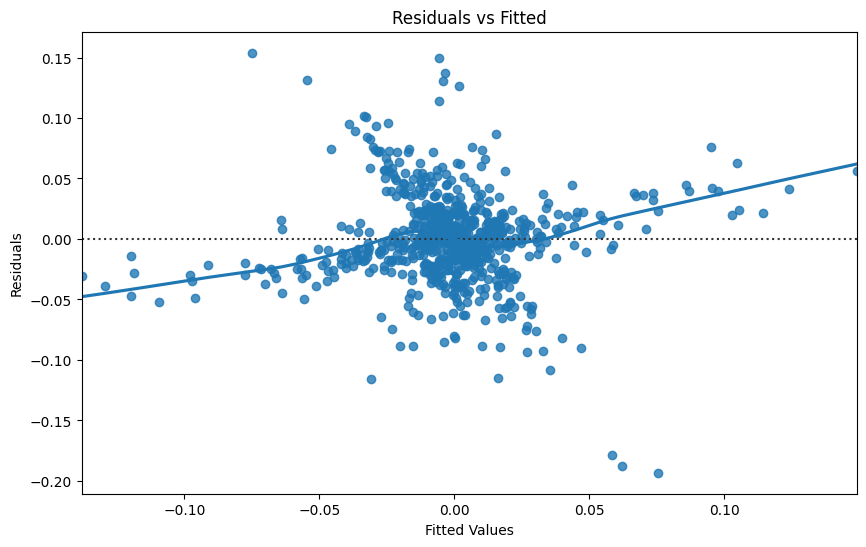

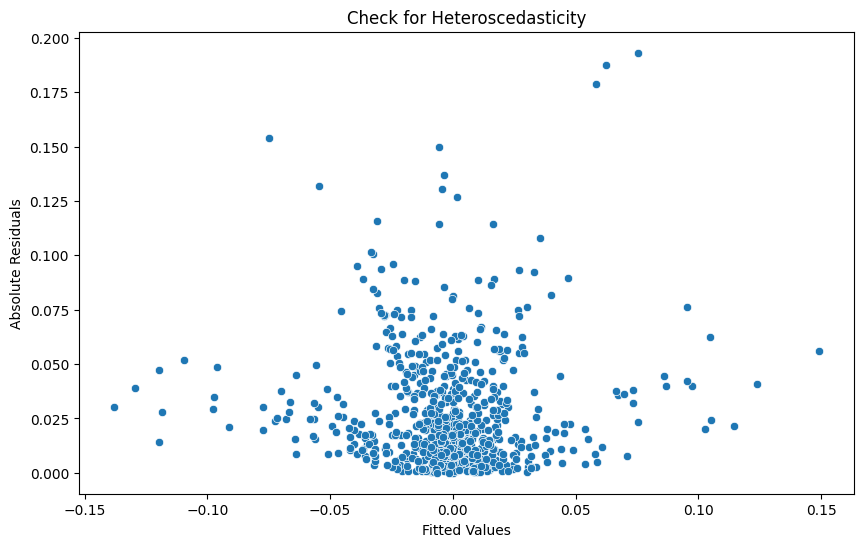

BAND_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.640
Model:                            OLS   Adj. R-squared:                  0.635
Method:                 Least Squares   F-statistic:                     139.0
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.05e-149
Time:                        23:29:30   Log-Likelihood:                 1188.0
No. Observations:                 714   AIC:                            -2356.
Df Residuals:                     704   BIC:                            -2310.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.0

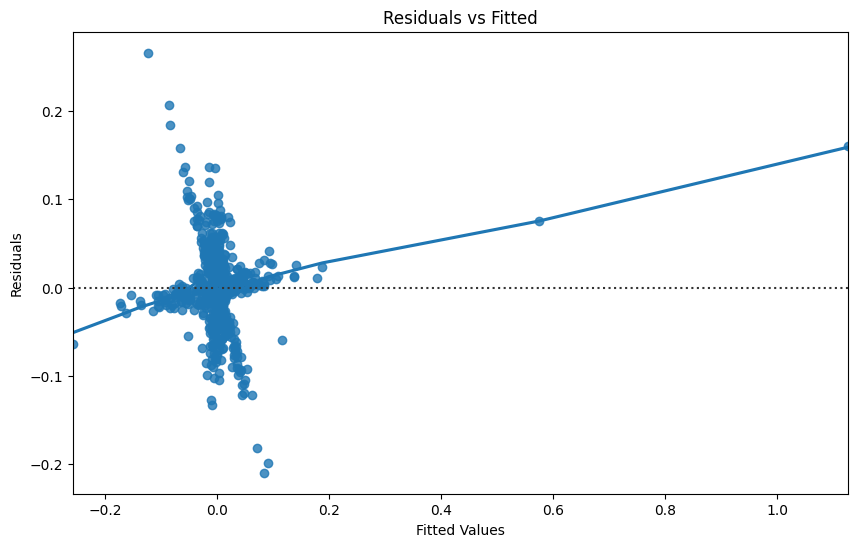

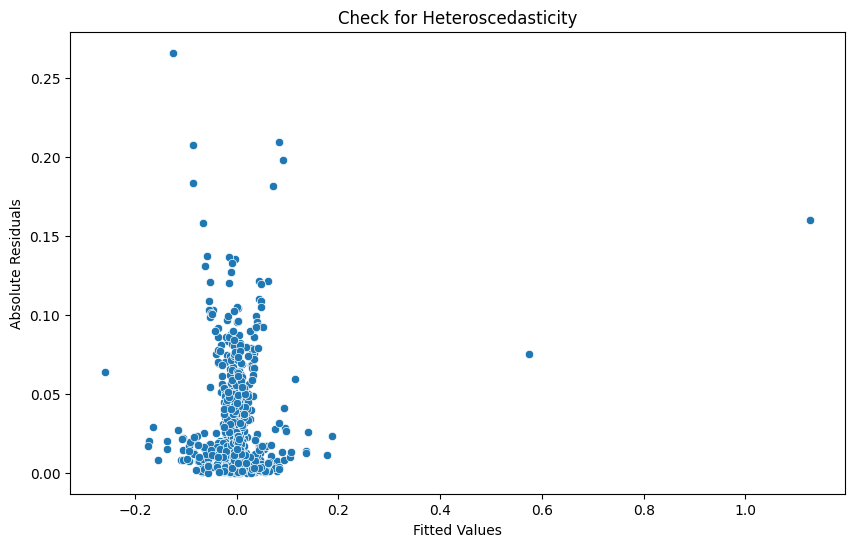

BAT_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.365
Model:                            OLS   Adj. R-squared:                  0.357
Method:                 Least Squares   F-statistic:                     45.02
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           6.85e-64
Time:                        23:29:31   Log-Likelihood:                 1312.9
No. Observations:                 714   AIC:                            -2606.
Df Residuals:                     704   BIC:                            -2560.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.00

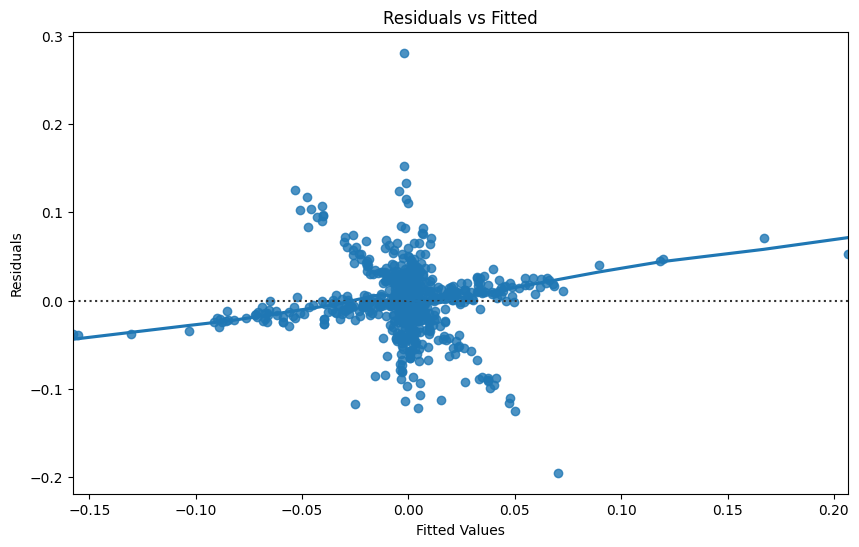

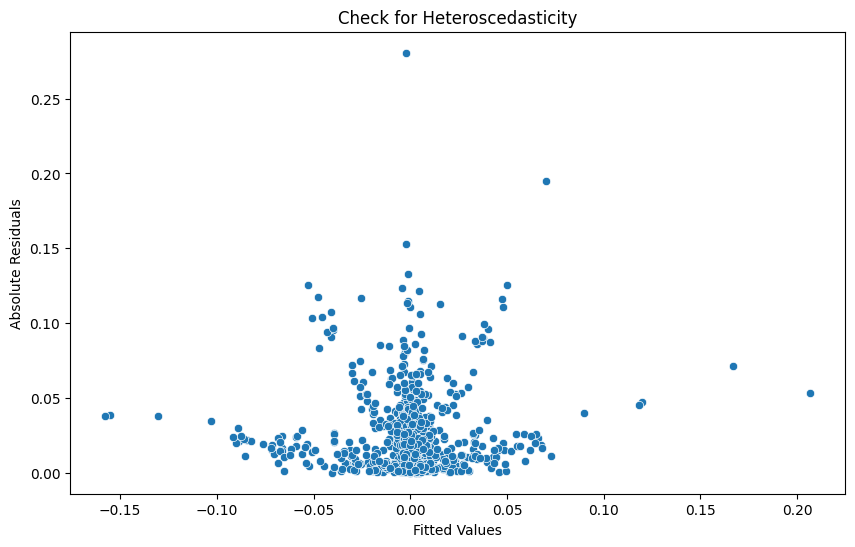

BCH_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.627
Model:                            OLS   Adj. R-squared:                  0.622
Method:                 Least Squares   F-statistic:                     131.4
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          3.02e-144
Time:                        23:29:32   Log-Likelihood:                 1516.1
No. Observations:                 714   AIC:                            -3012.
Df Residuals:                     704   BIC:                            -2966.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

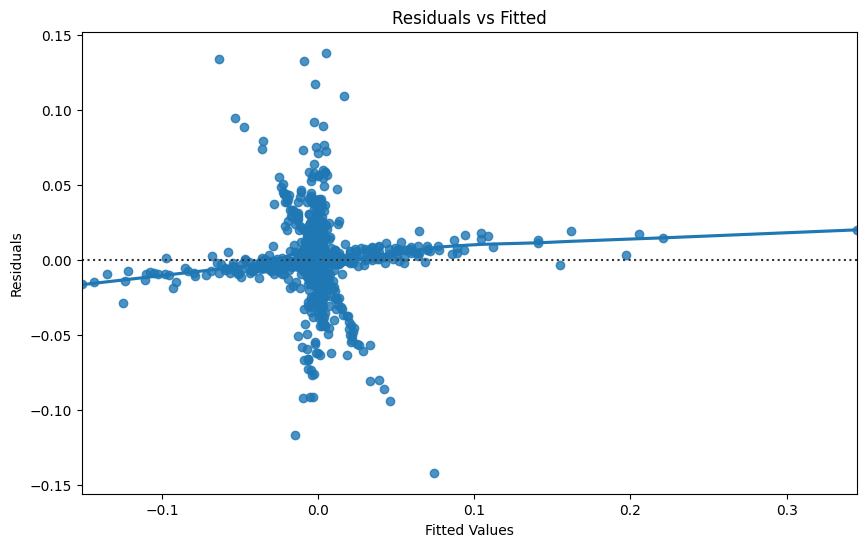

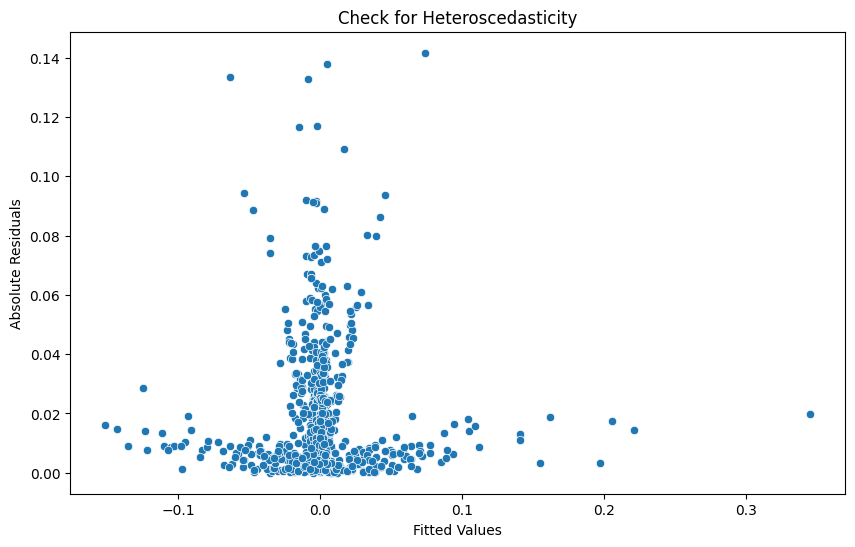

BLZ_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.394
Model:                            OLS   Adj. R-squared:                  0.387
Method:                 Least Squares   F-statistic:                     57.24
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           1.09e-71
Time:                        23:29:33   Log-Likelihood:                 1072.9
No. Observations:                 714   AIC:                            -2128.
Df Residuals:                     705   BIC:                            -2087.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          3.557e-

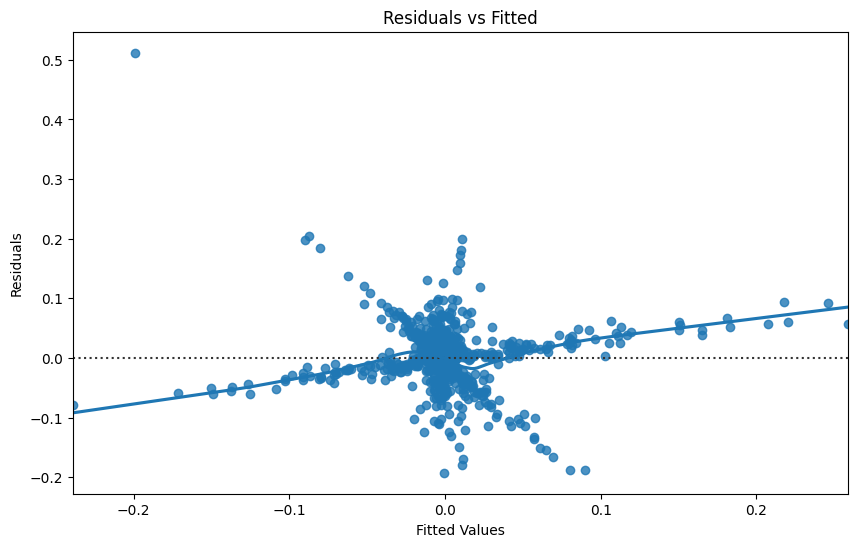

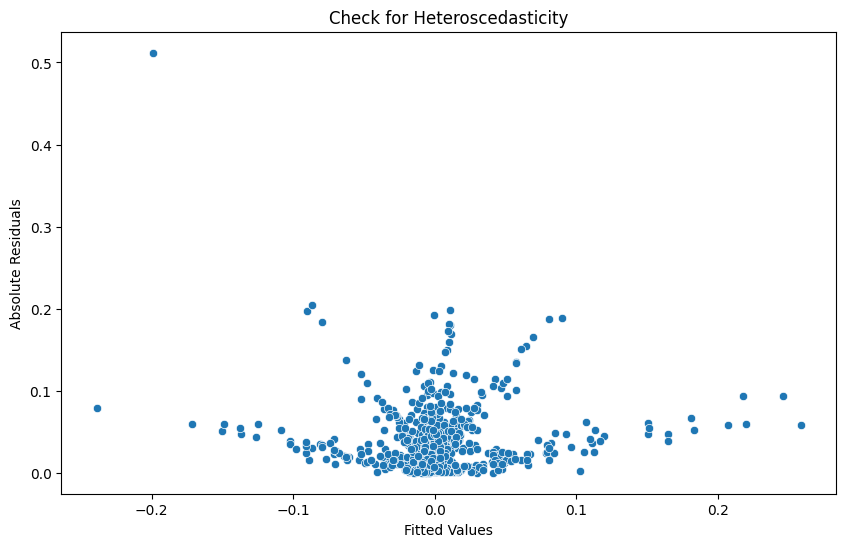

BNB_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.570
Model:                            OLS   Adj. R-squared:                  0.565
Method:                 Least Squares   F-statistic:                     116.9
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          8.08e-124
Time:                        23:29:34   Log-Likelihood:                 1685.3
No. Observations:                 714   AIC:                            -3353.
Df Residuals:                     705   BIC:                            -3311.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap         -3.116e-

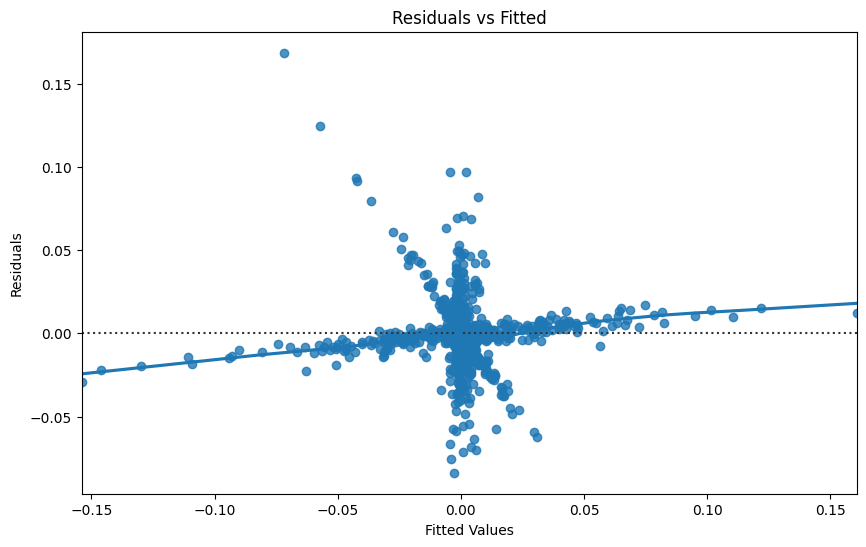

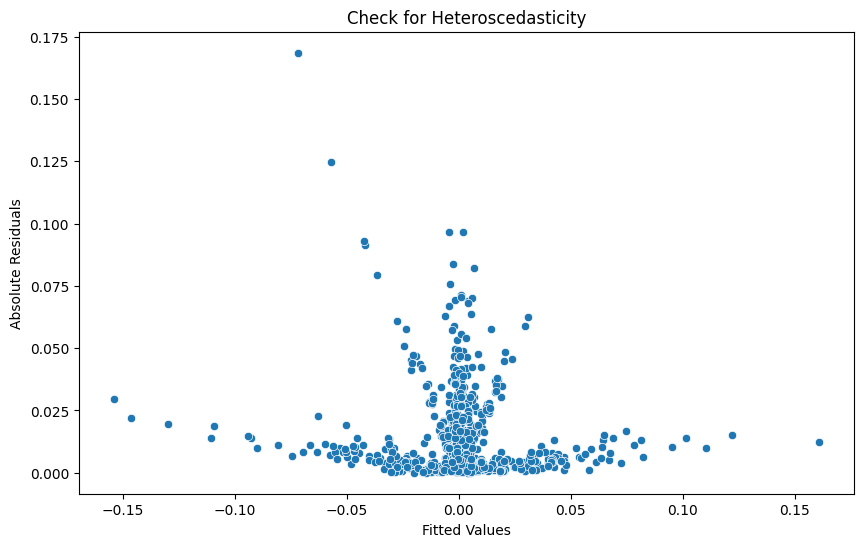

BTC_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.724
Model:                            OLS   Adj. R-squared:                  0.721
Method:                 Least Squares   F-statistic:                     231.7
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.33e-191
Time:                        23:29:35   Log-Likelihood:                 1905.5
No. Observations:                 714   AIC:                            -3793.
Df Residuals:                     705   BIC:                            -3752.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          4.564e-

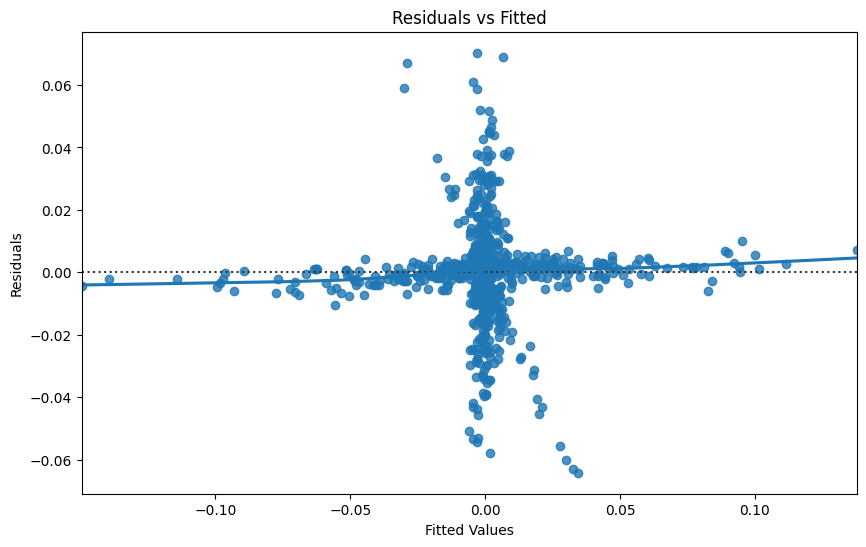

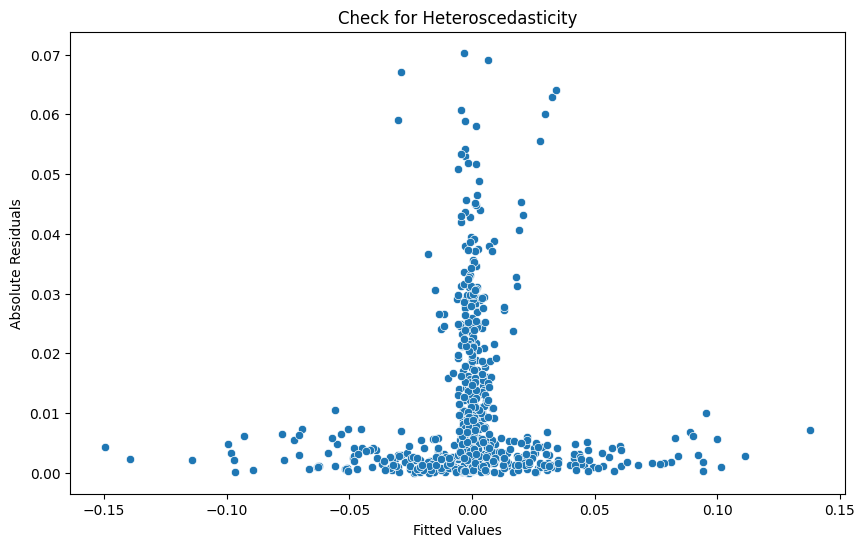

C98_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.473
Model:                            OLS   Adj. R-squared:                  0.466
Method:                 Least Squares   F-statistic:                     70.15
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           7.24e-92
Time:                        23:29:36   Log-Likelihood:                 1227.6
No. Observations:                 714   AIC:                            -2435.
Df Residuals:                     704   BIC:                            -2389.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

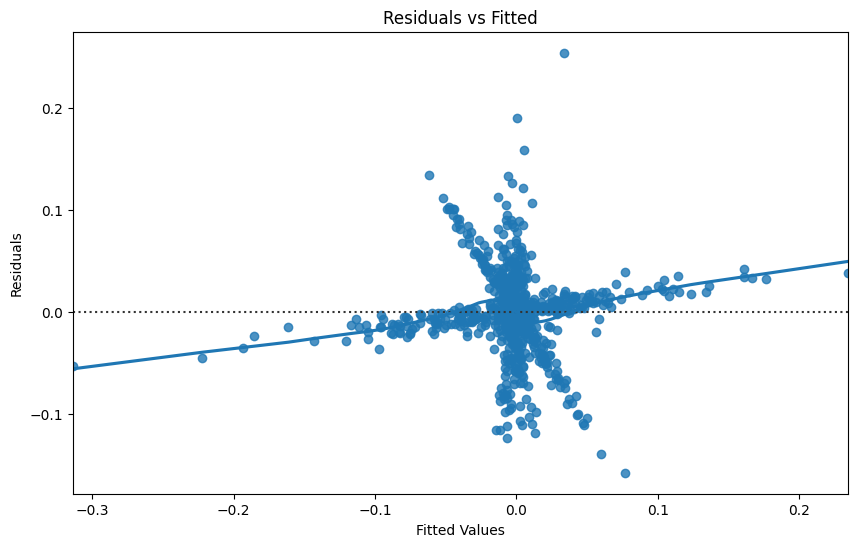

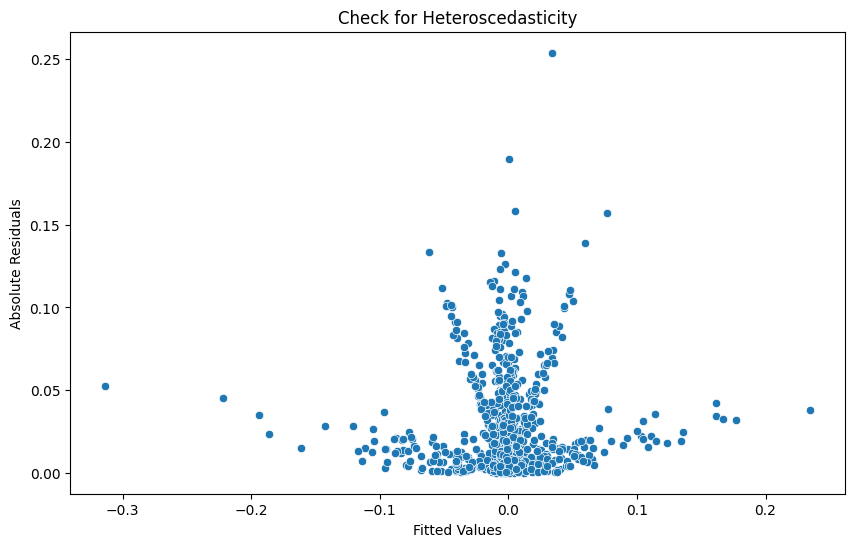

CELR_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.405
Model:                            OLS   Adj. R-squared:                  0.398
Method:                 Least Squares   F-statistic:                     60.01
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           1.53e-74
Time:                        23:29:36   Log-Likelihood:                 1192.4
No. Observations:                 714   AIC:                            -2367.
Df Residuals:                     705   BIC:                            -2326.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap         -1.759e

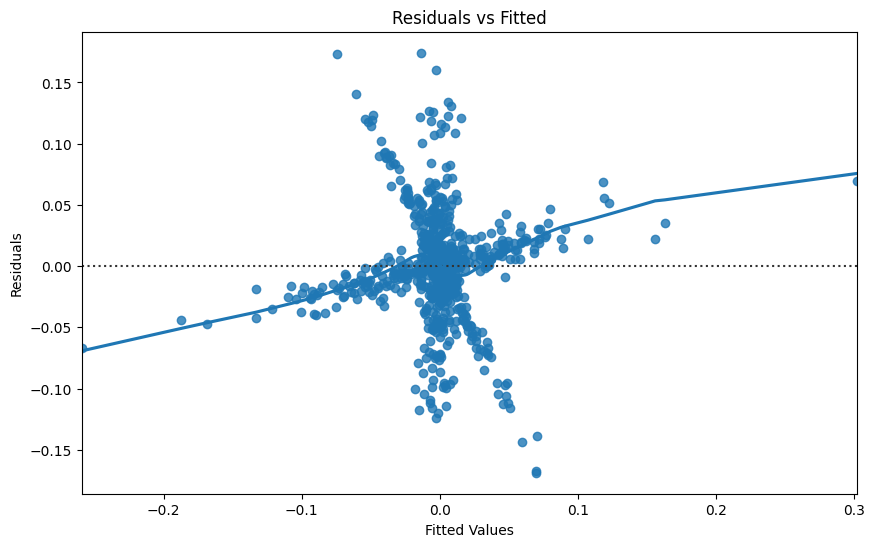

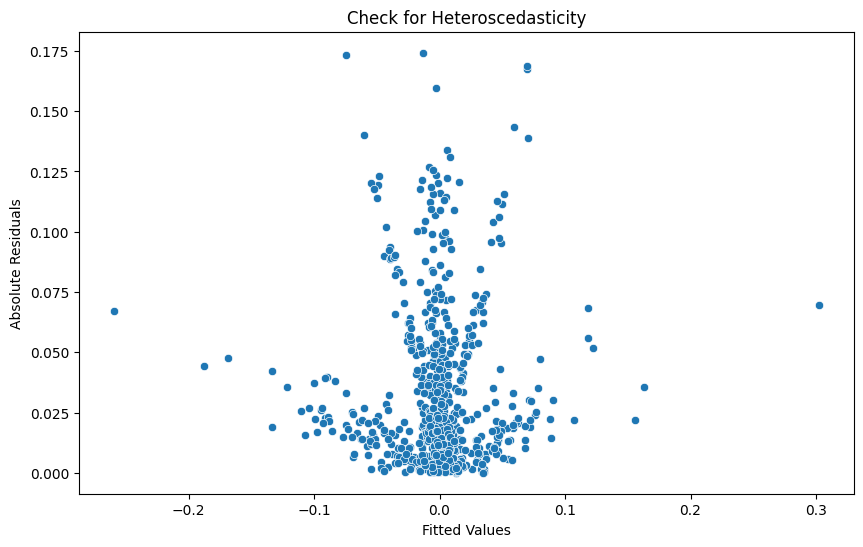

CHZ_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.490
Model:                            OLS   Adj. R-squared:                  0.483
Method:                 Least Squares   F-statistic:                     75.12
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           7.57e-97
Time:                        23:29:37   Log-Likelihood:                 1301.8
No. Observations:                 714   AIC:                            -2584.
Df Residuals:                     704   BIC:                            -2538.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.00

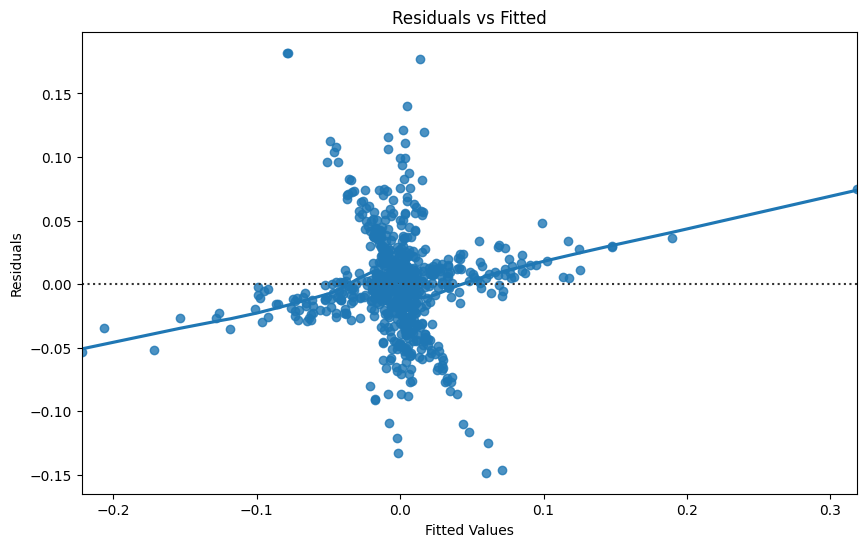

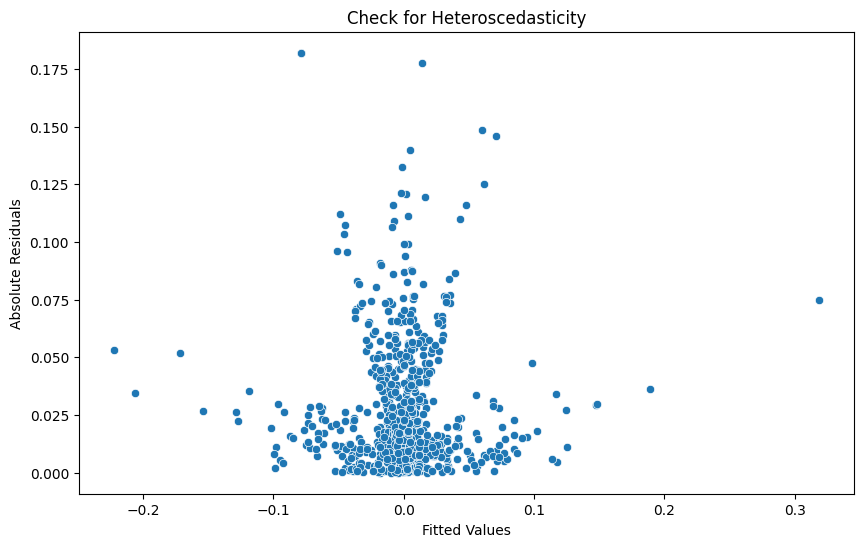

COTI_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.495
Model:                            OLS   Adj. R-squared:                  0.489
Method:                 Least Squares   F-statistic:                     86.33
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           2.58e-99
Time:                        23:29:39   Log-Likelihood:                 1247.8
No. Observations:                 714   AIC:                            -2478.
Df Residuals:                     705   BIC:                            -2436.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap         -1.316e

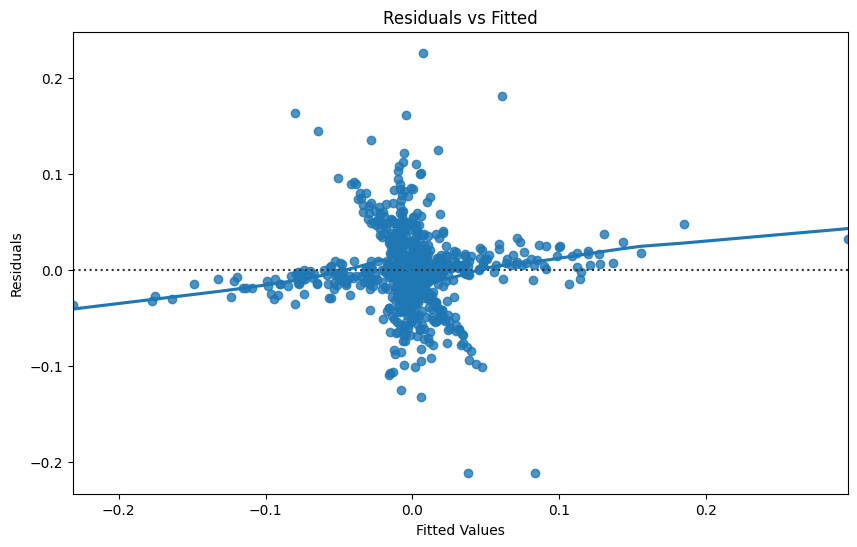

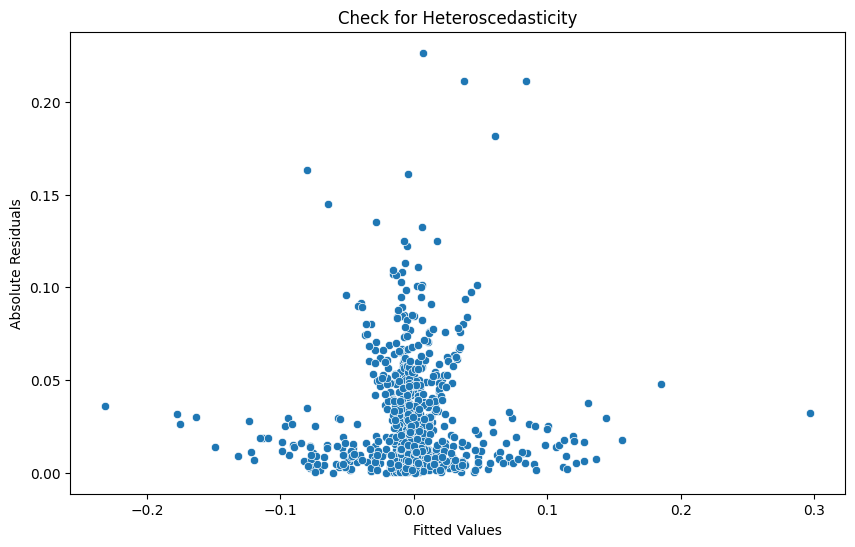

CRV_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.529
Model:                            OLS   Adj. R-squared:                  0.523
Method:                 Least Squares   F-statistic:                     87.76
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          7.67e-109
Time:                        23:29:39   Log-Likelihood:                 1238.7
No. Observations:                 714   AIC:                            -2457.
Df Residuals:                     704   BIC:                            -2412.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.01

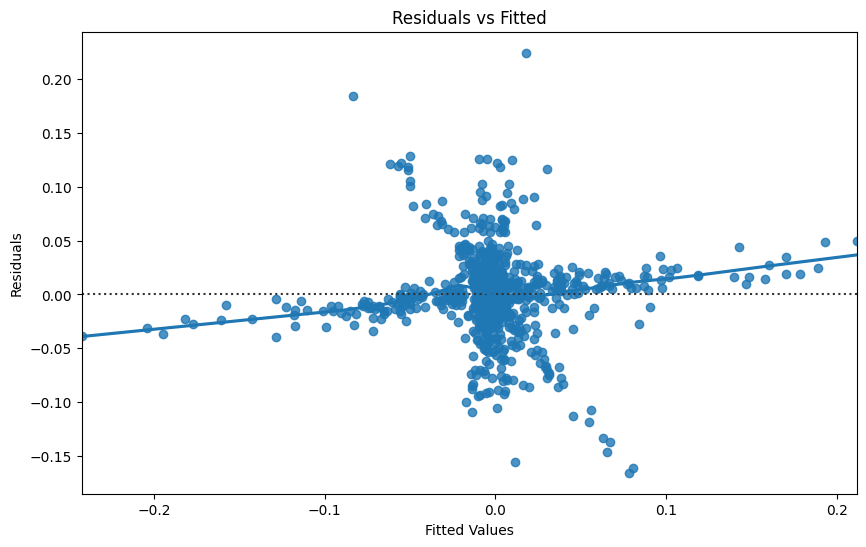

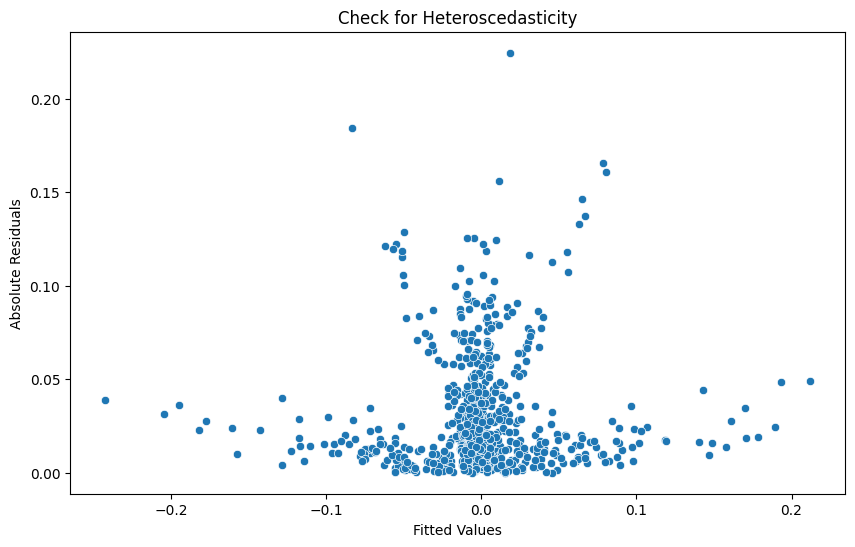

CTSI_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.458
Model:                            OLS   Adj. R-squared:                  0.451
Method:                 Least Squares   F-statistic:                     66.19
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           8.78e-88
Time:                        23:29:40   Log-Likelihood:                 1226.9
No. Observations:                 714   AIC:                            -2434.
Df Residuals:                     704   BIC:                            -2388.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.1

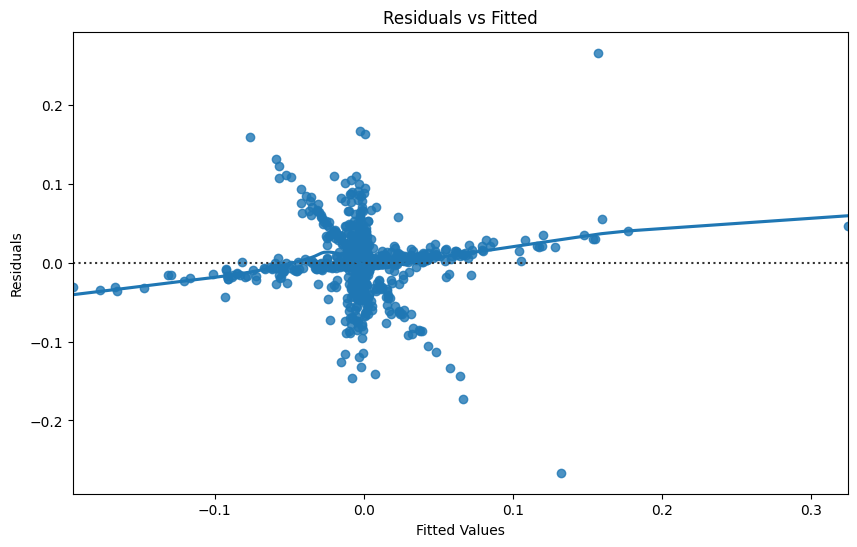

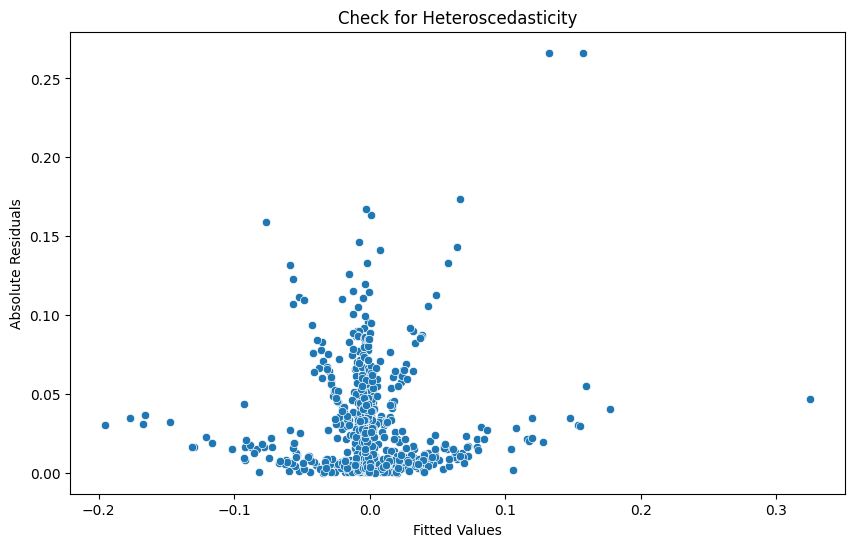

CTXC_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.797
Model:                            OLS   Adj. R-squared:                  0.795
Method:                 Least Squares   F-statistic:                     346.6
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.72e-238
Time:                        23:29:42   Log-Likelihood:                 1169.9
No. Observations:                 714   AIC:                            -2322.
Df Residuals:                     705   BIC:                            -2281.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          5.478e

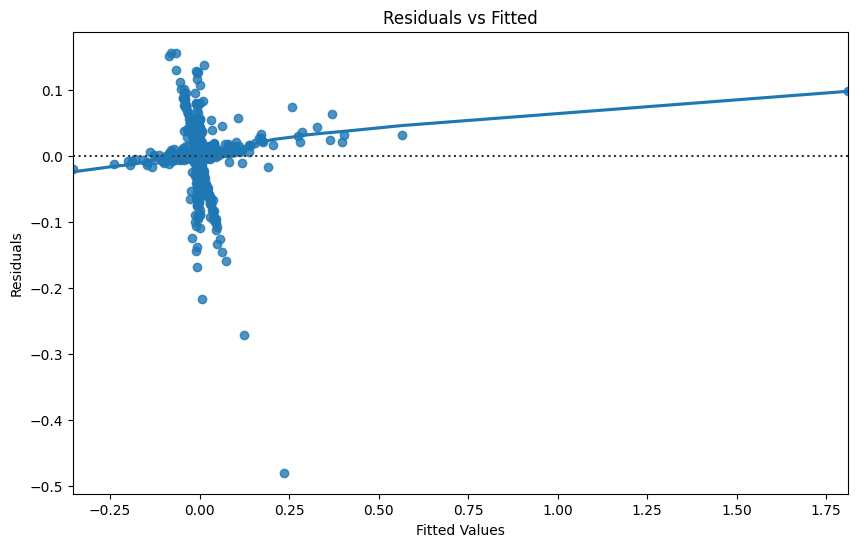

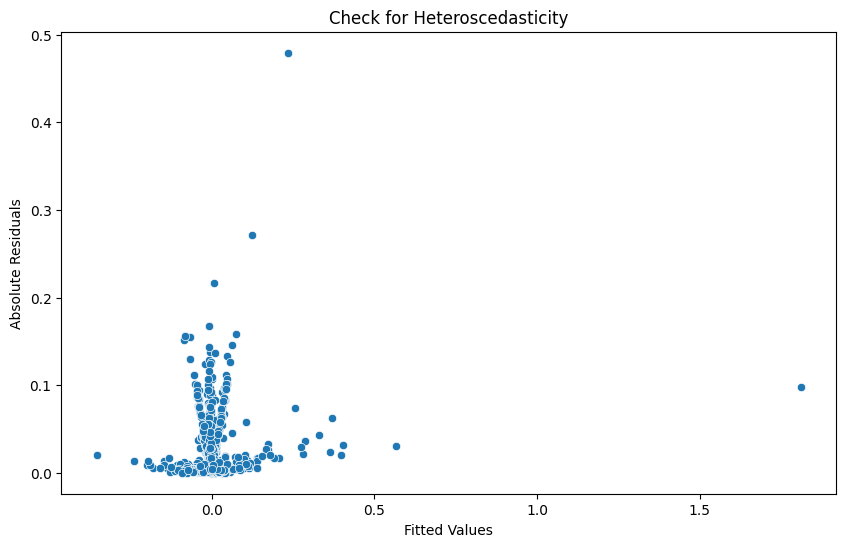

CVC_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.448
Model:                            OLS   Adj. R-squared:                  0.442
Method:                 Least Squares   F-statistic:                     71.74
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           4.19e-86
Time:                        23:29:43   Log-Likelihood:                 1226.6
No. Observations:                 715   AIC:                            -2435.
Df Residuals:                     706   BIC:                            -2394.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          6.345e-

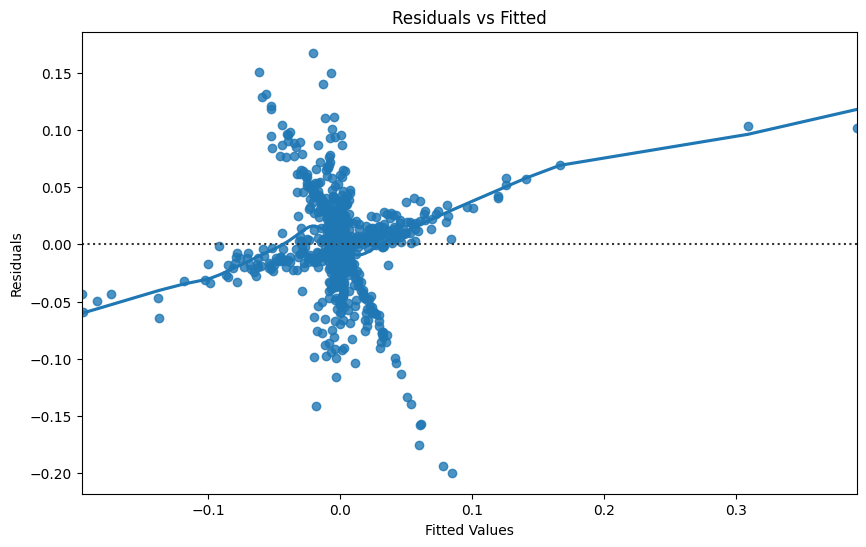

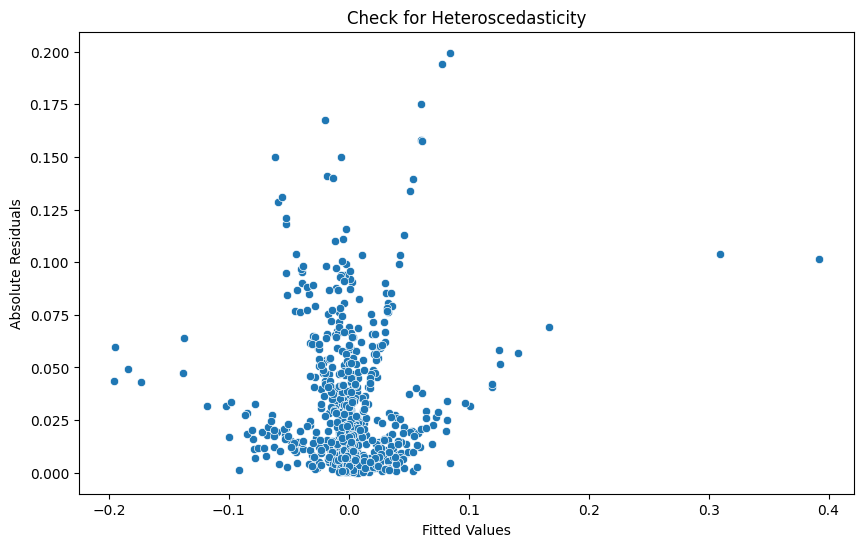

DASH_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.556
Model:                            OLS   Adj. R-squared:                  0.550
Method:                 Least Squares   F-statistic:                     97.86
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          8.54e-118
Time:                        23:29:44   Log-Likelihood:                 1507.4
No. Observations:                 714   AIC:                            -2995.
Df Residuals:                     704   BIC:                            -2949.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

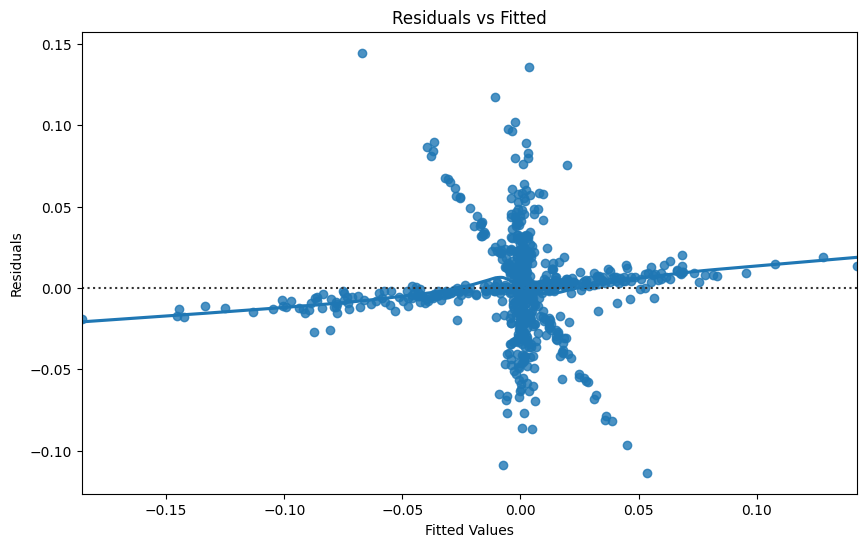

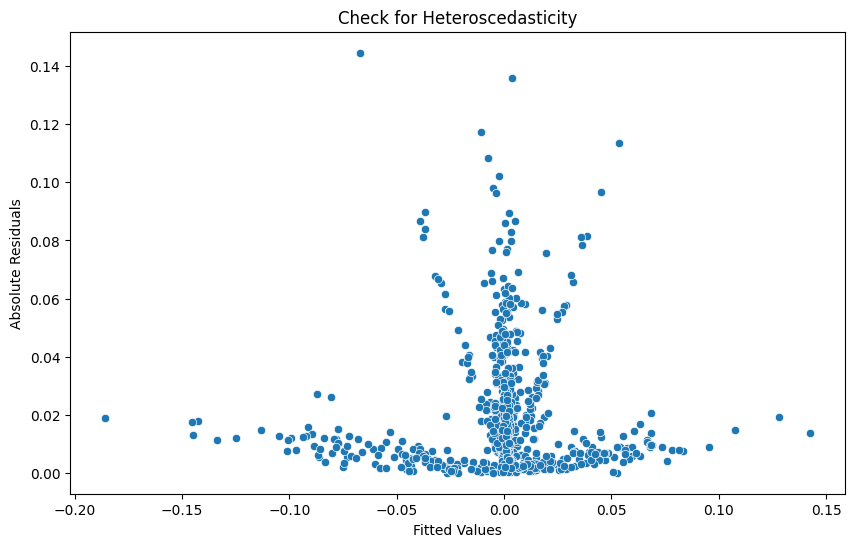

DCR_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.660
Model:                            OLS   Adj. R-squared:                  0.656
Method:                 Least Squares   F-statistic:                     151.8
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          2.03e-158
Time:                        23:29:45   Log-Likelihood:                 1384.1
No. Observations:                 714   AIC:                            -2748.
Df Residuals:                     704   BIC:                            -2703.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.00

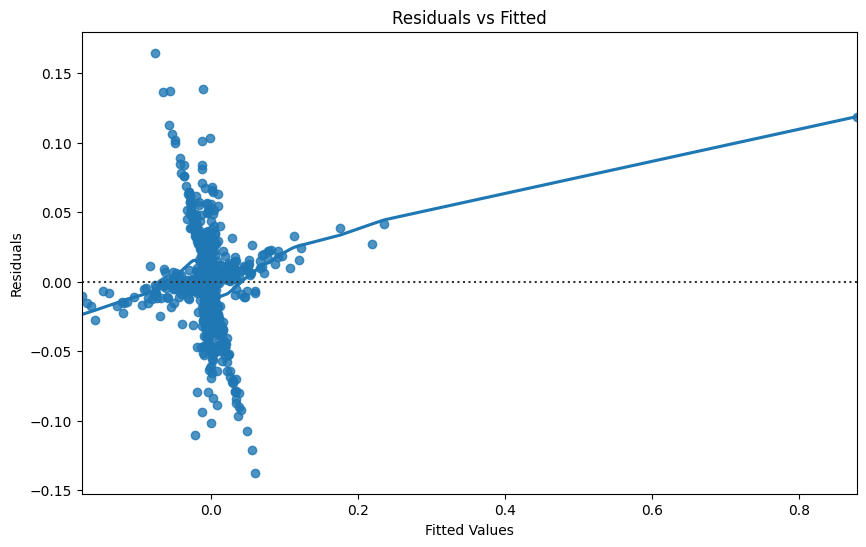

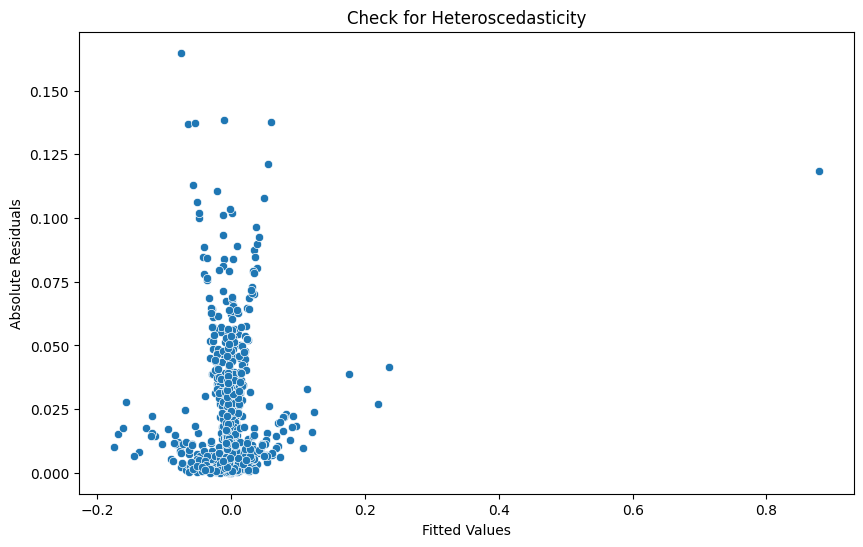

DENT_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.477
Model:                            OLS   Adj. R-squared:                  0.471
Method:                 Least Squares   F-statistic:                     80.44
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           4.21e-94
Time:                        23:29:46   Log-Likelihood:                 1340.7
No. Observations:                 714   AIC:                            -2663.
Df Residuals:                     705   BIC:                            -2622.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap         -1.268e

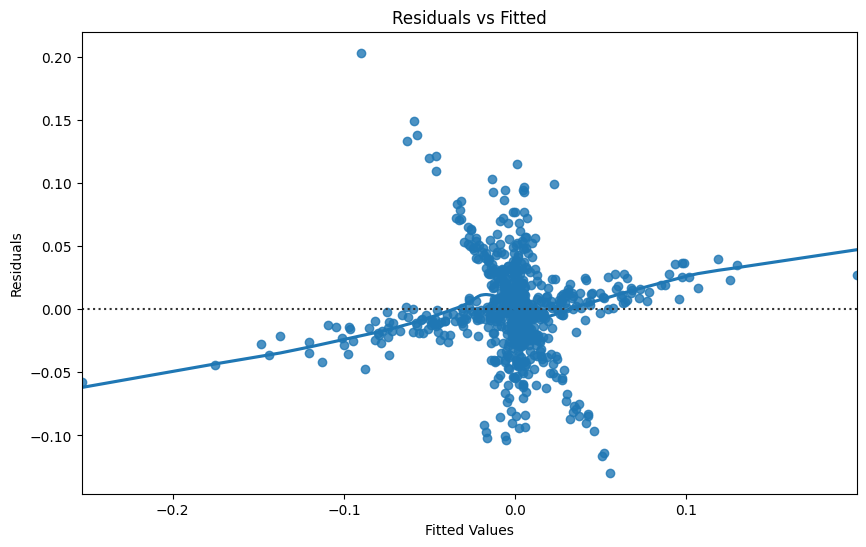

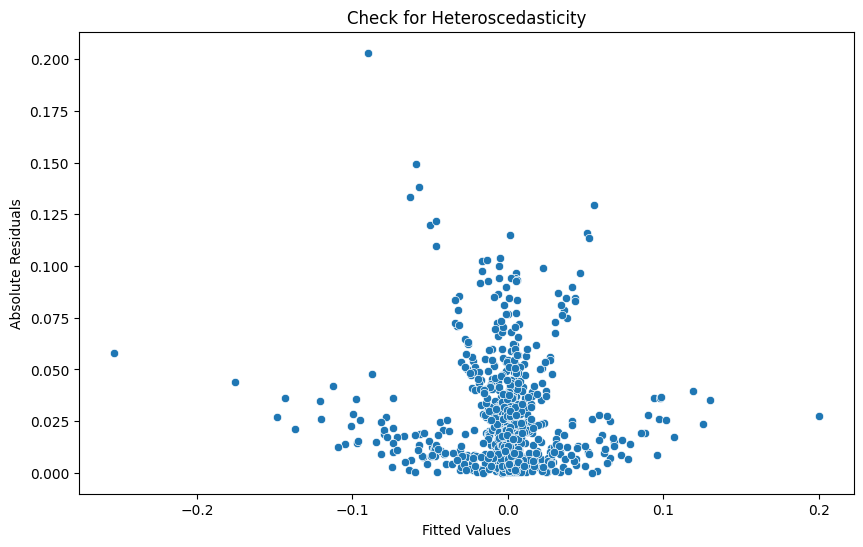

DEXE_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.598
Model:                            OLS   Adj. R-squared:                  0.594
Method:                 Least Squares   F-statistic:                     131.2
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          4.43e-134
Time:                        23:29:47   Log-Likelihood:                 1352.4
No. Observations:                 714   AIC:                            -2687.
Df Residuals:                     705   BIC:                            -2646.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          6.324e

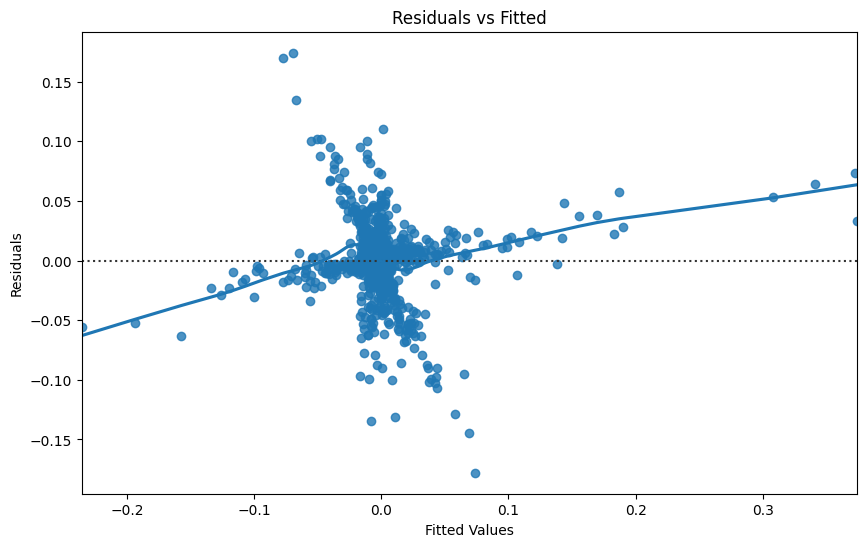

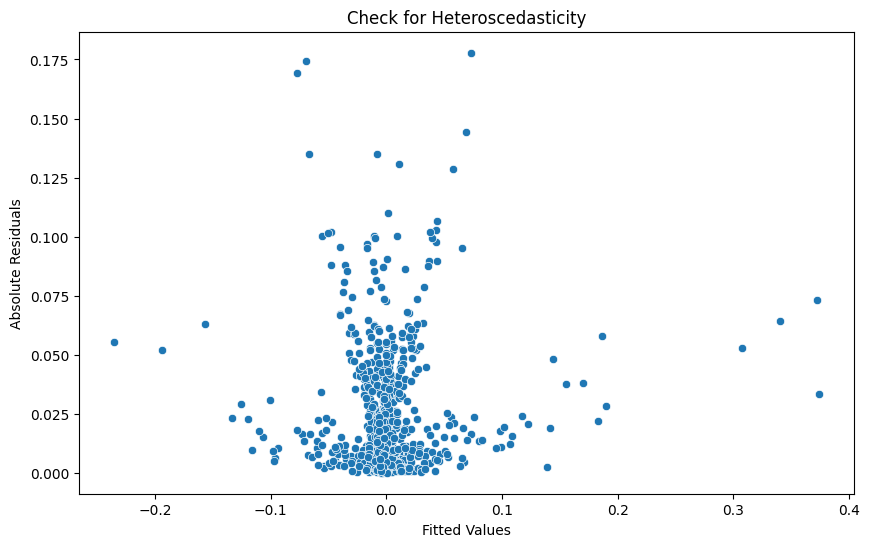

DGB_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.404
Model:                            OLS   Adj. R-squared:                  0.397
Method:                 Least Squares   F-statistic:                     53.05
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           2.17e-73
Time:                        23:29:48   Log-Likelihood:                 1310.0
No. Observations:                 714   AIC:                            -2600.
Df Residuals:                     704   BIC:                            -2554.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.06

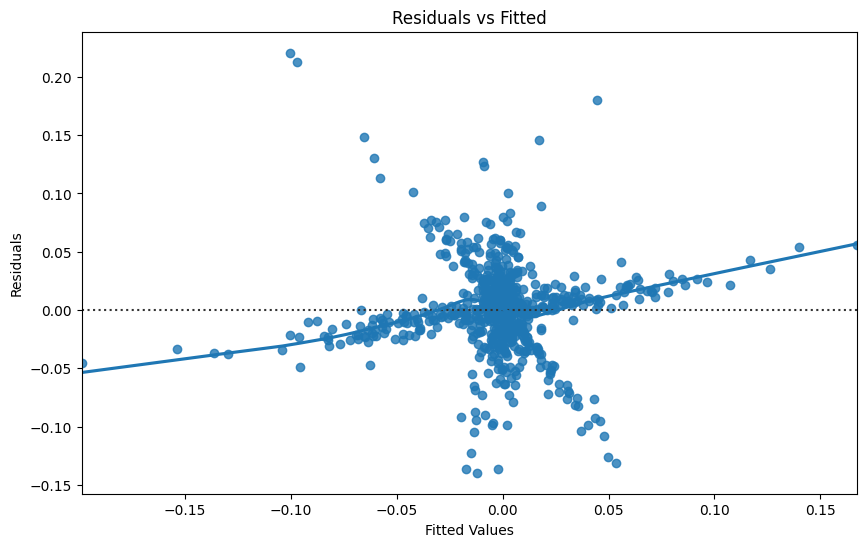

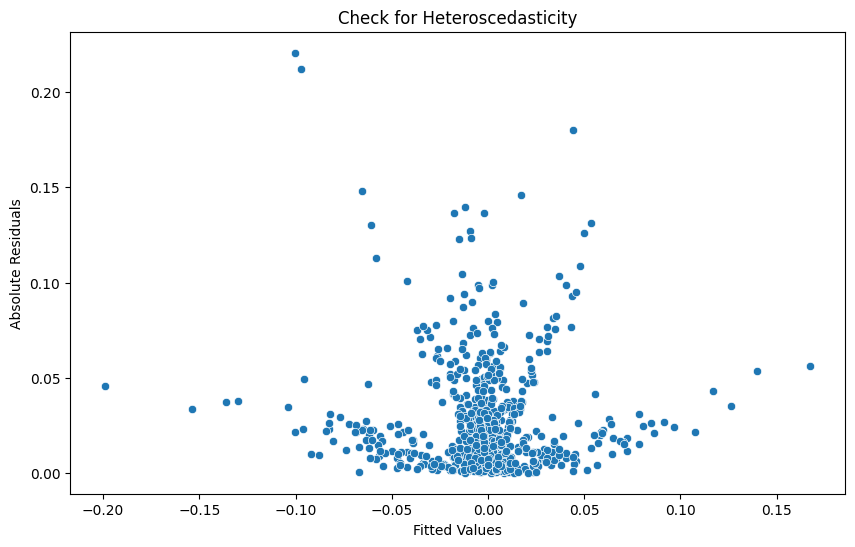

DODO_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.484
Model:                            OLS   Adj. R-squared:                  0.477
Method:                 Least Squares   F-statistic:                     73.30
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           4.86e-95
Time:                        23:29:49   Log-Likelihood:                 1253.6
No. Observations:                 714   AIC:                            -2487.
Df Residuals:                     704   BIC:                            -2442.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

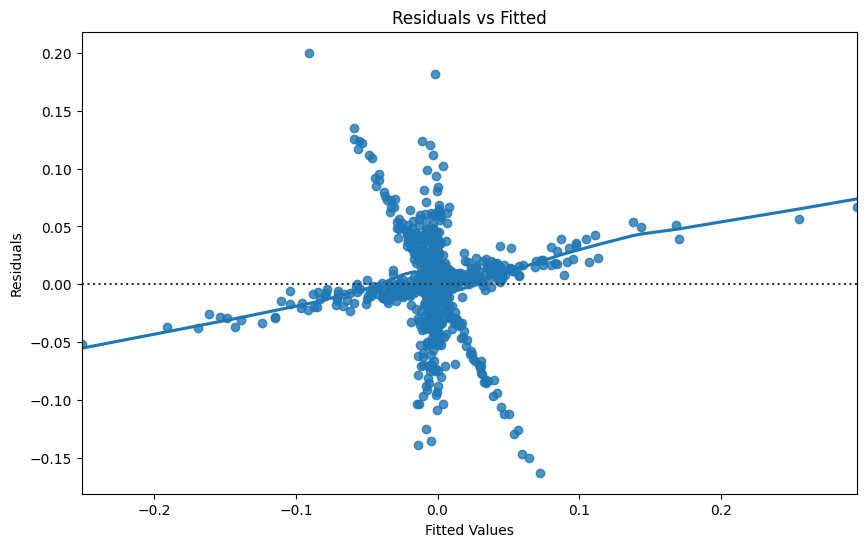

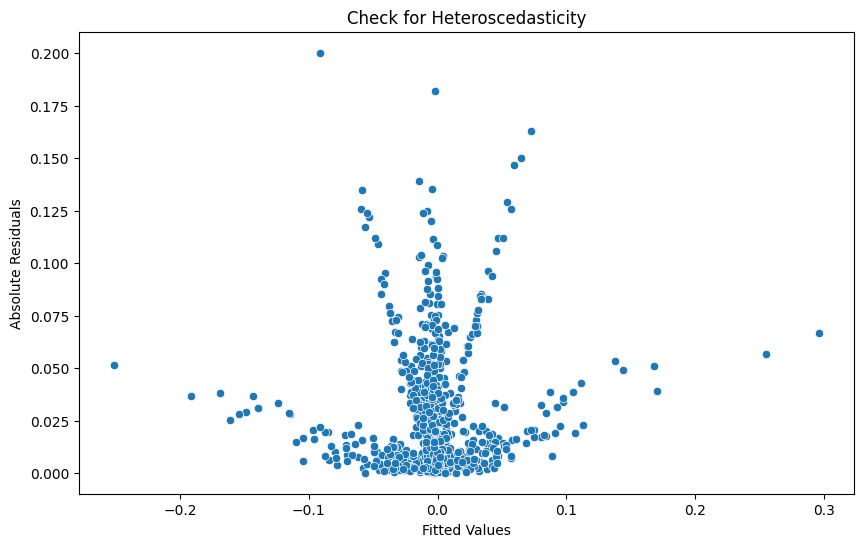

DOGE_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.615
Model:                            OLS   Adj. R-squared:                  0.610
Method:                 Least Squares   F-statistic:                     125.0
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.51e-139
Time:                        23:29:51   Log-Likelihood:                 1487.3
No. Observations:                 714   AIC:                            -2955.
Df Residuals:                     704   BIC:                            -2909.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

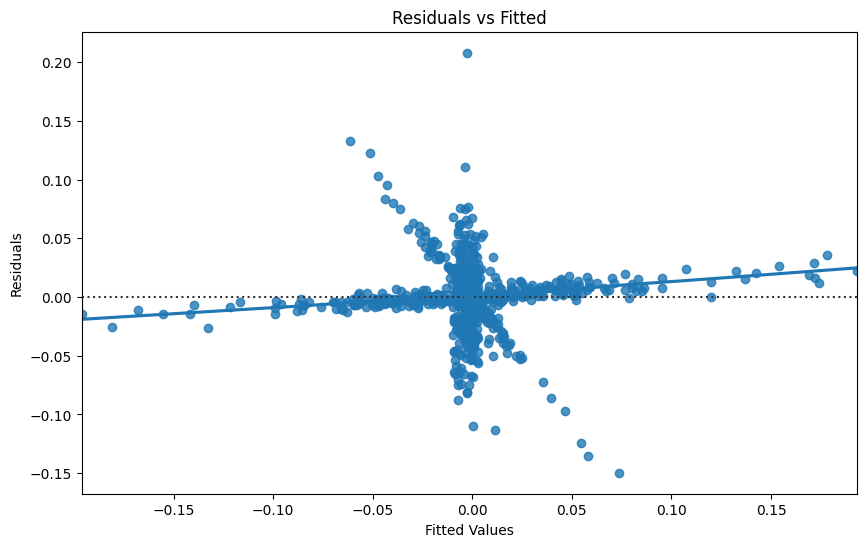

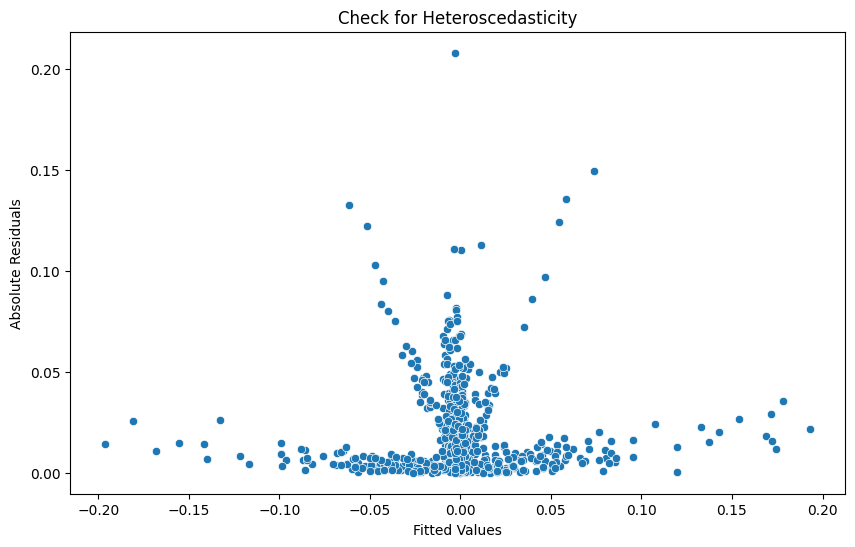

DOT_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.495
Model:                            OLS   Adj. R-squared:                  0.488
Method:                 Least Squares   F-statistic:                     76.63
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           2.46e-98
Time:                        23:29:52   Log-Likelihood:                 1444.7
No. Observations:                 714   AIC:                            -2869.
Df Residuals:                     704   BIC:                            -2824.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.01

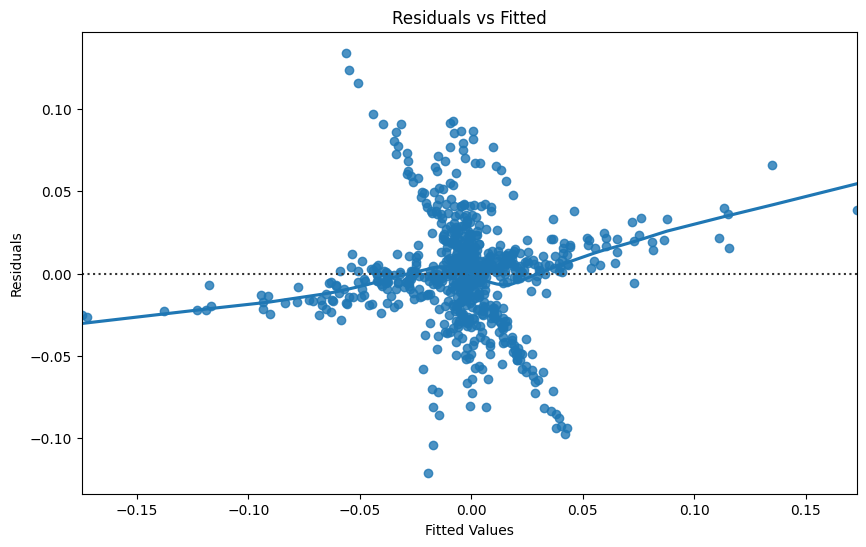

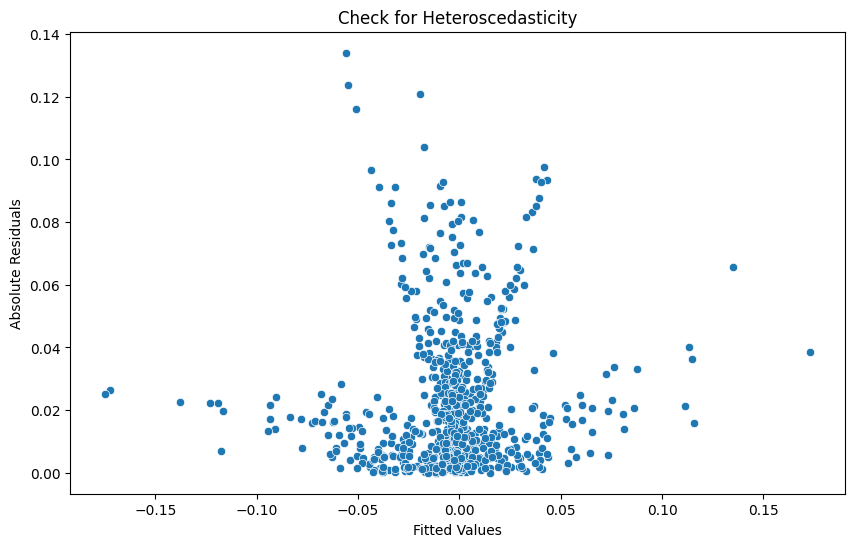

DUSK_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.459
Model:                            OLS   Adj. R-squared:                  0.453
Method:                 Least Squares   F-statistic:                     74.84
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           5.53e-89
Time:                        23:29:52   Log-Likelihood:                 1090.1
No. Observations:                 714   AIC:                            -2162.
Df Residuals:                     705   BIC:                            -2121.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          5.108e

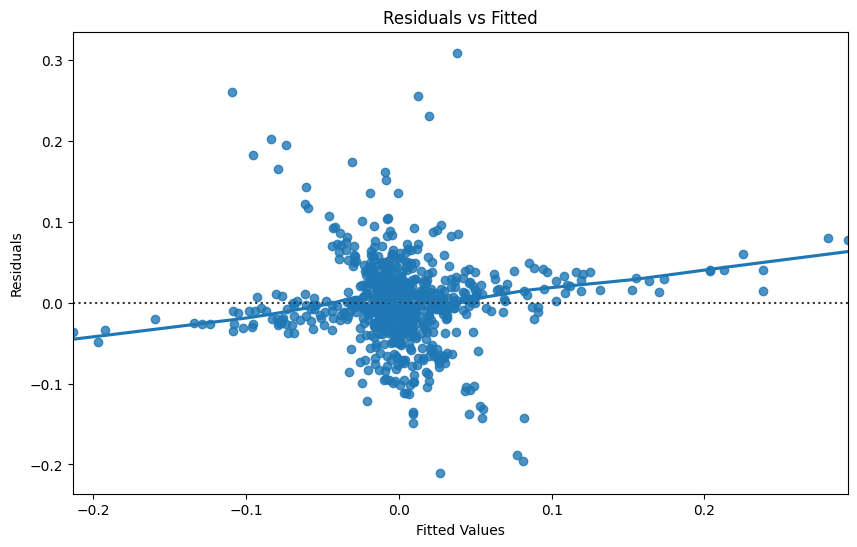

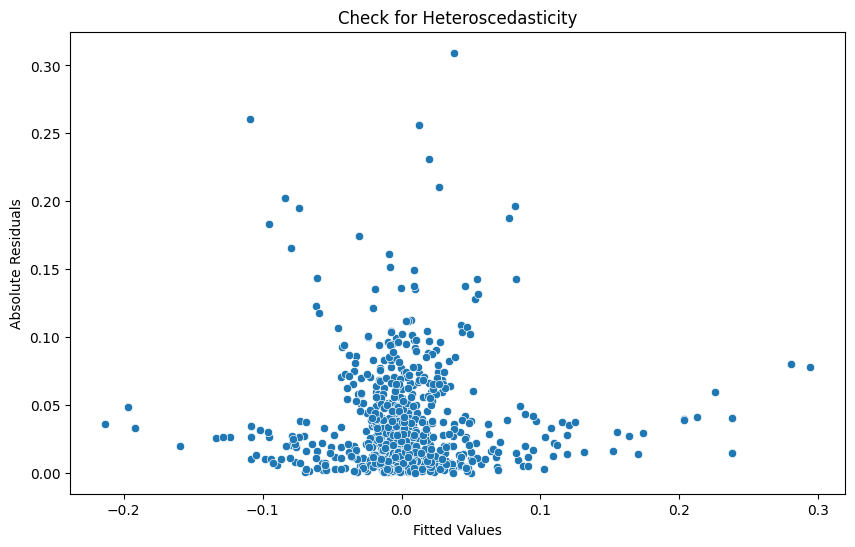

DYDX_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.471
Model:                            OLS   Adj. R-squared:                  0.465
Method:                 Least Squares   F-statistic:                     69.75
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           1.83e-91
Time:                        23:29:53   Log-Likelihood:                 1192.9
No. Observations:                 714   AIC:                            -2366.
Df Residuals:                     704   BIC:                            -2320.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

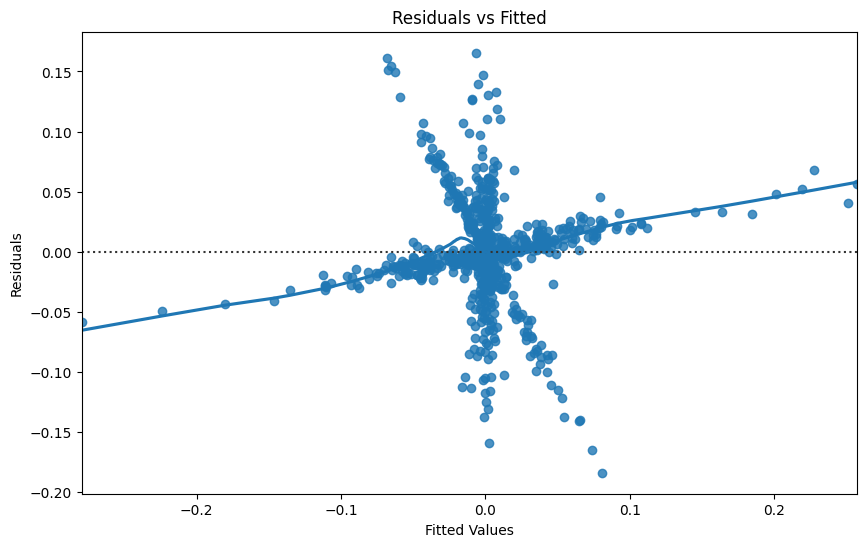

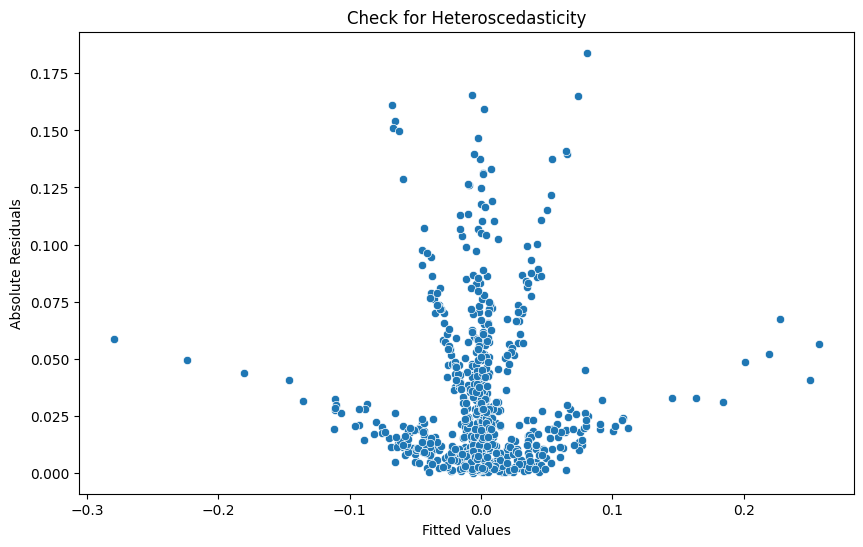

EGLD_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.493
Model:                            OLS   Adj. R-squared:                  0.486
Method:                 Least Squares   F-statistic:                     76.04
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           9.32e-98
Time:                        23:29:54   Log-Likelihood:                 1438.8
No. Observations:                 714   AIC:                            -2858.
Df Residuals:                     704   BIC:                            -2812.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

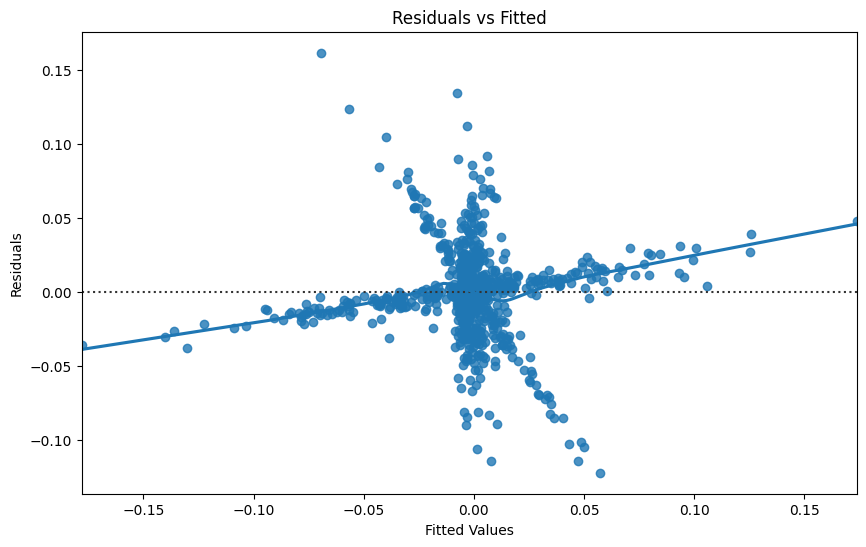

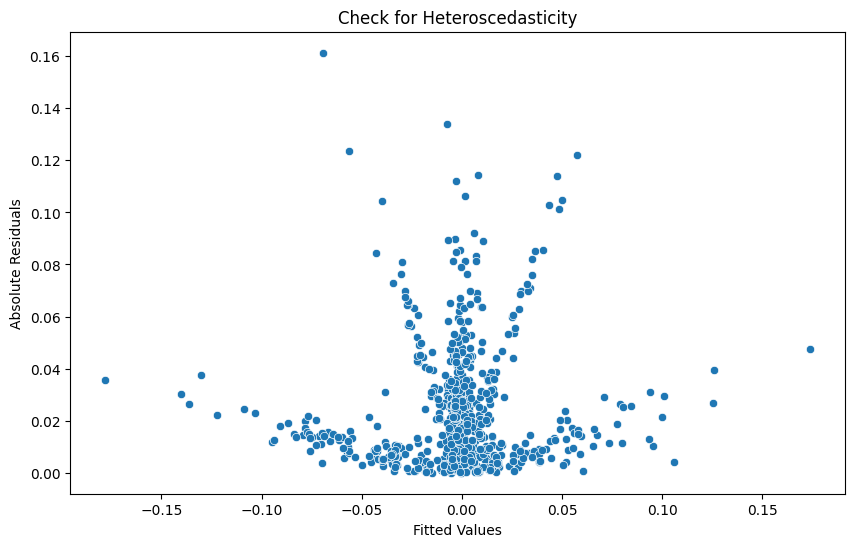

ENJ_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.472
Model:                            OLS   Adj. R-squared:                  0.466
Method:                 Least Squares   F-statistic:                     70.03
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           9.58e-92
Time:                        23:29:55   Log-Likelihood:                 1320.4
No. Observations:                 714   AIC:                            -2621.
Df Residuals:                     704   BIC:                            -2575.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.00

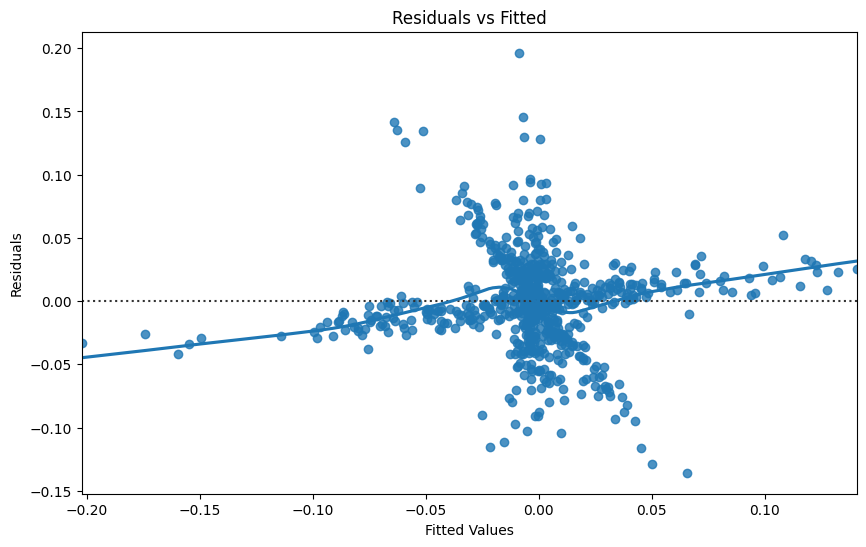

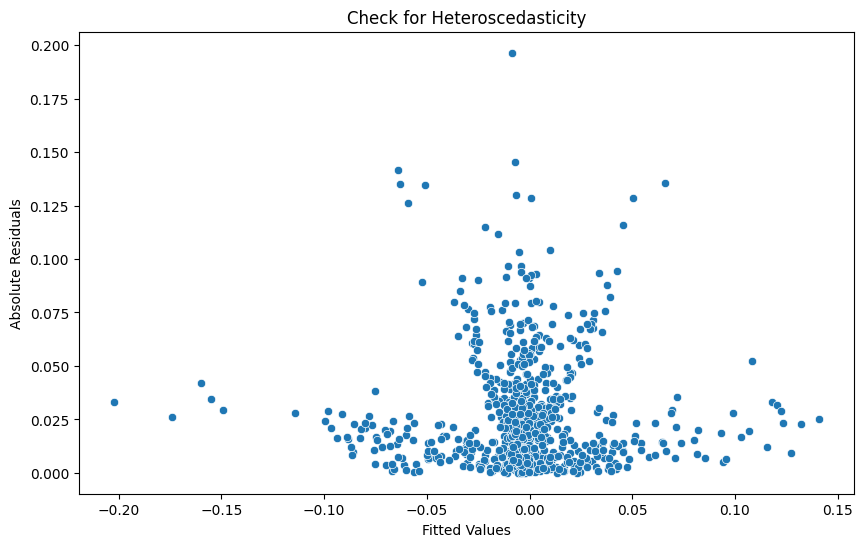

EOS_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.505
Model:                            OLS   Adj. R-squared:                  0.498
Method:                 Least Squares   F-statistic:                     79.73
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          2.48e-101
Time:                        23:29:56   Log-Likelihood:                 1466.7
No. Observations:                 714   AIC:                            -2913.
Df Residuals:                     704   BIC:                            -2868.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

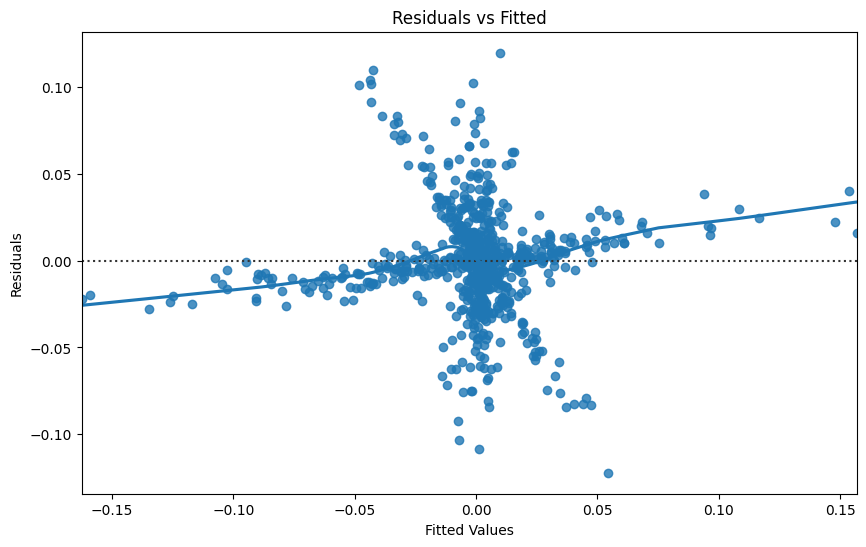

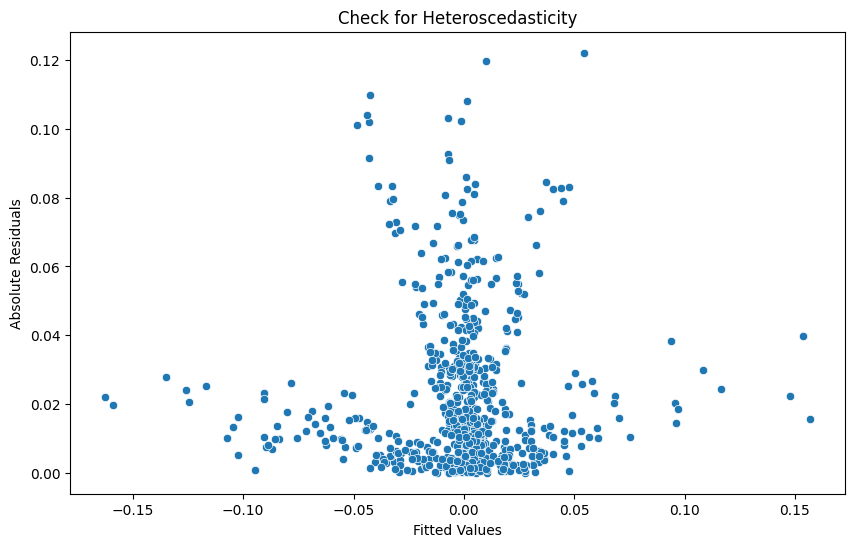

ETC_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.587
Model:                            OLS   Adj. R-squared:                  0.582
Method:                 Least Squares   F-statistic:                     125.0
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          8.84e-130
Time:                        23:29:57   Log-Likelihood:                 1426.9
No. Observations:                 714   AIC:                            -2836.
Df Residuals:                     705   BIC:                            -2795.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

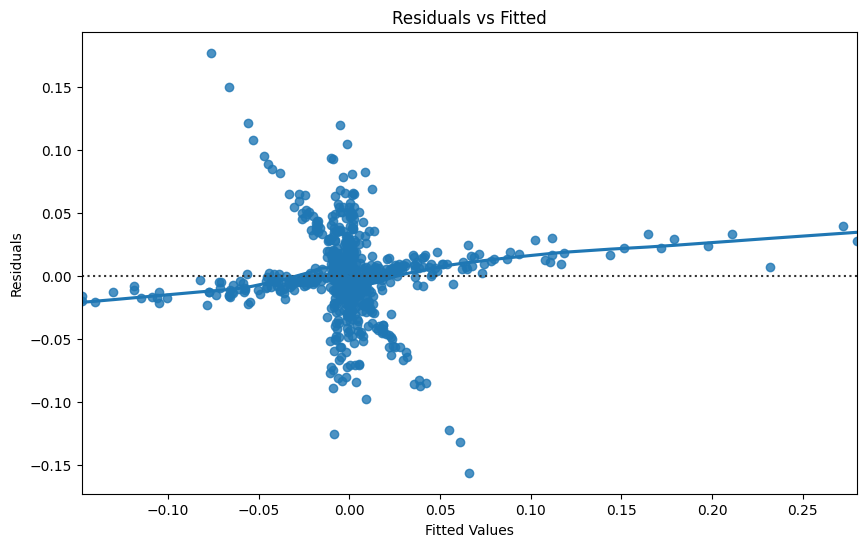

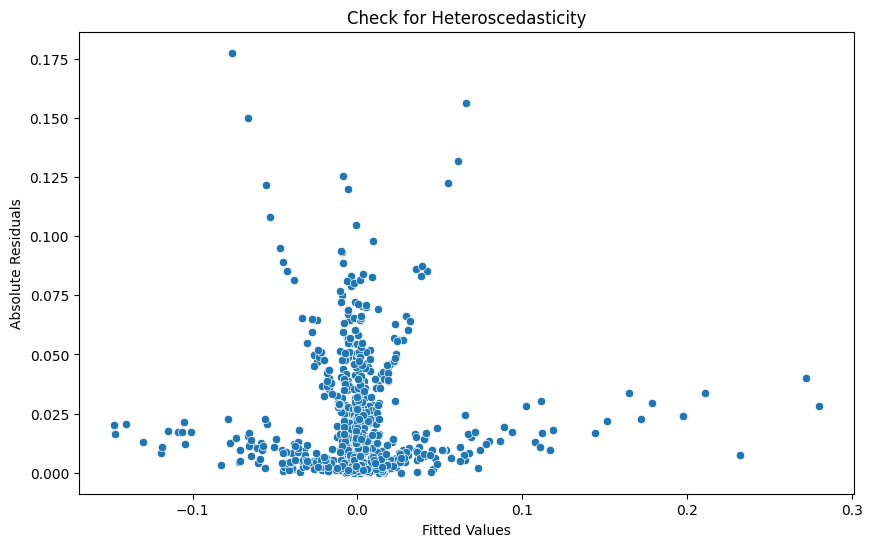

ETH_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.611
Model:                            OLS   Adj. R-squared:                  0.607
Method:                 Least Squares   F-statistic:                     138.5
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          4.56e-139
Time:                        23:29:58   Log-Likelihood:                 1637.8
No. Observations:                 714   AIC:                            -3258.
Df Residuals:                     705   BIC:                            -3217.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap         -1.147e-

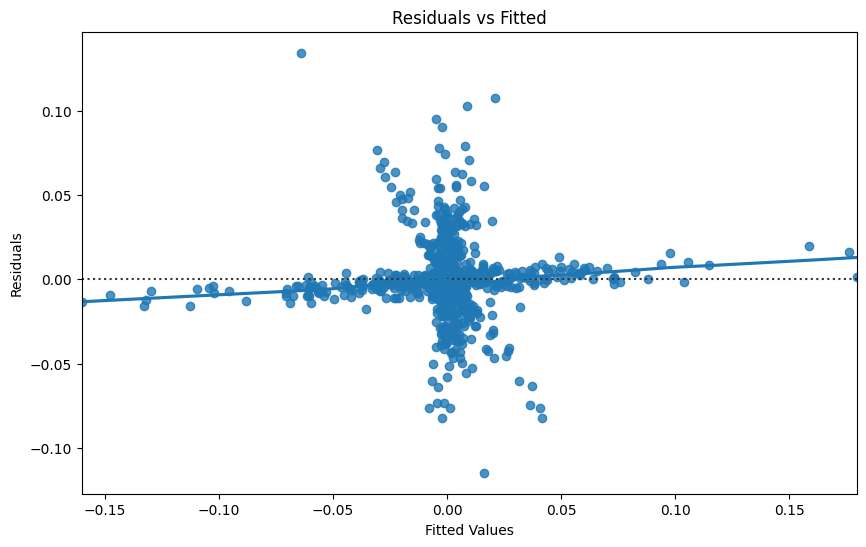

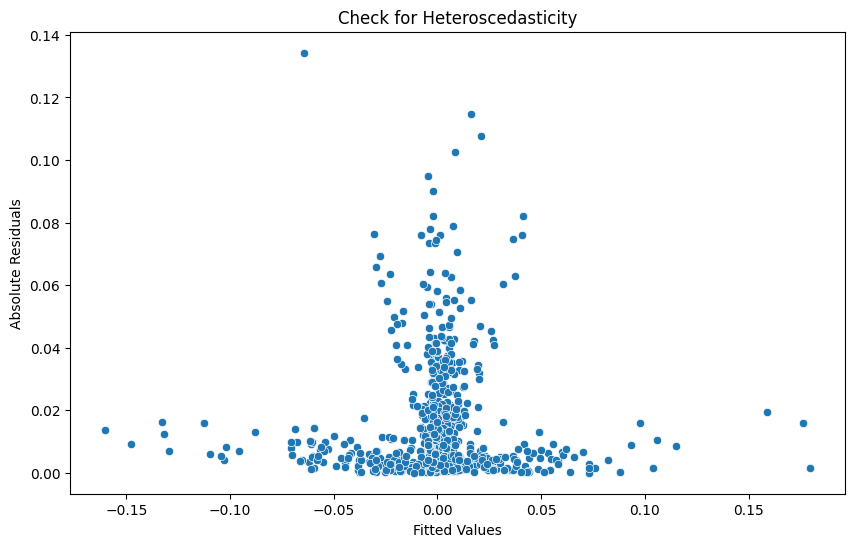

FET_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.475
Model:                            OLS   Adj. R-squared:                  0.469
Method:                 Least Squares   F-statistic:                     70.90
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           1.25e-92
Time:                        23:30:00   Log-Likelihood:                 1122.7
No. Observations:                 714   AIC:                            -2225.
Df Residuals:                     704   BIC:                            -2180.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.01

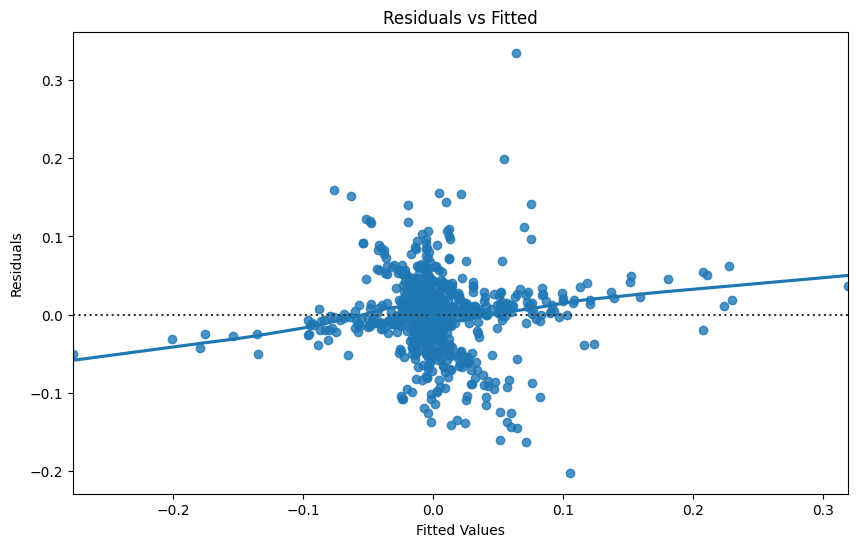

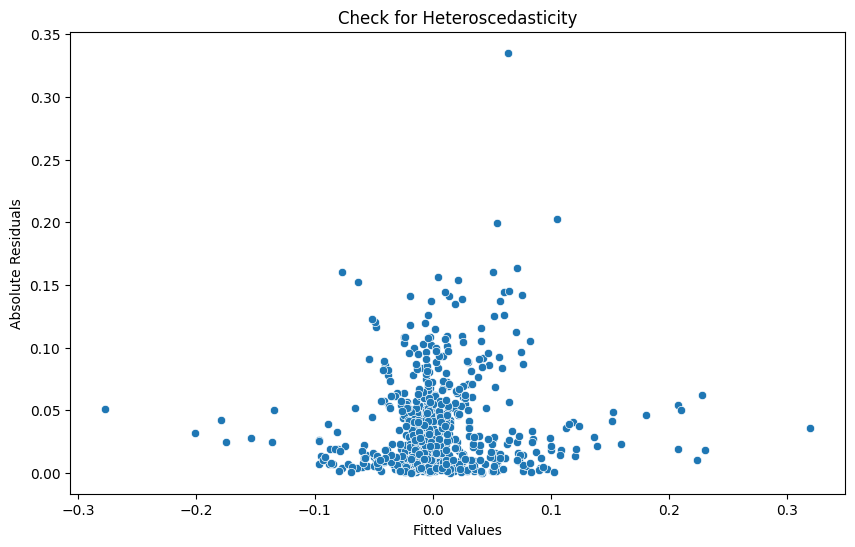

FIL_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.507
Model:                            OLS   Adj. R-squared:                  0.501
Method:                 Least Squares   F-statistic:                     80.45
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          5.04e-102
Time:                        23:30:00   Log-Likelihood:                 1357.1
No. Observations:                 714   AIC:                            -2694.
Df Residuals:                     704   BIC:                            -2648.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

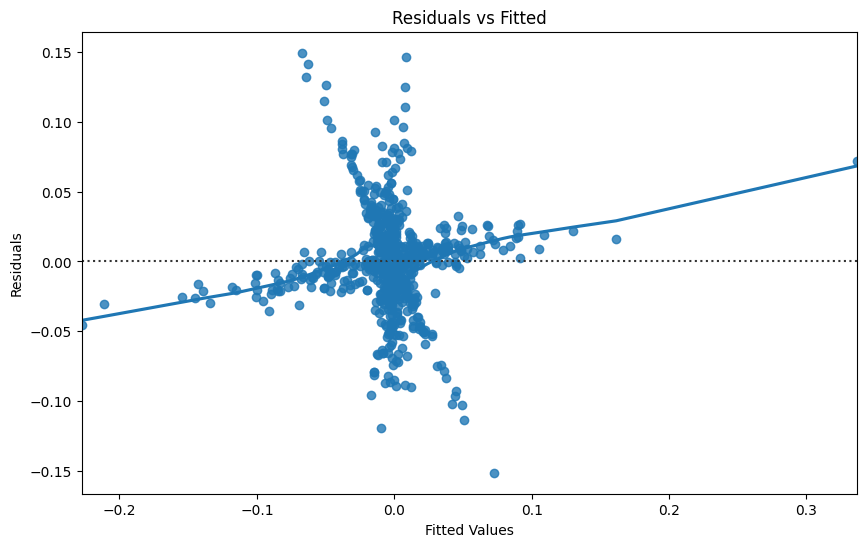

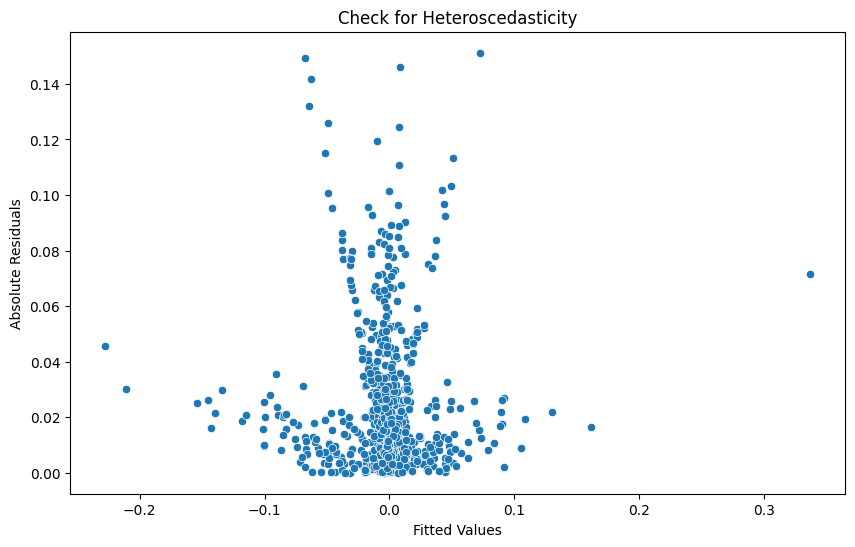

FLM_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.600
Model:                            OLS   Adj. R-squared:                  0.595
Method:                 Least Squares   F-statistic:                     132.1
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          9.66e-135
Time:                        23:30:02   Log-Likelihood:                 1234.1
No. Observations:                 714   AIC:                            -2450.
Df Residuals:                     705   BIC:                            -2409.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap         -2.329e-

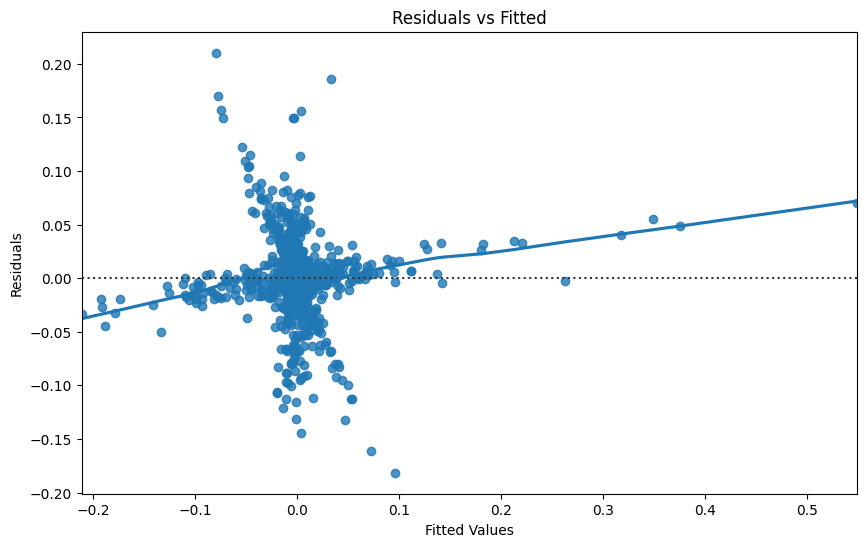

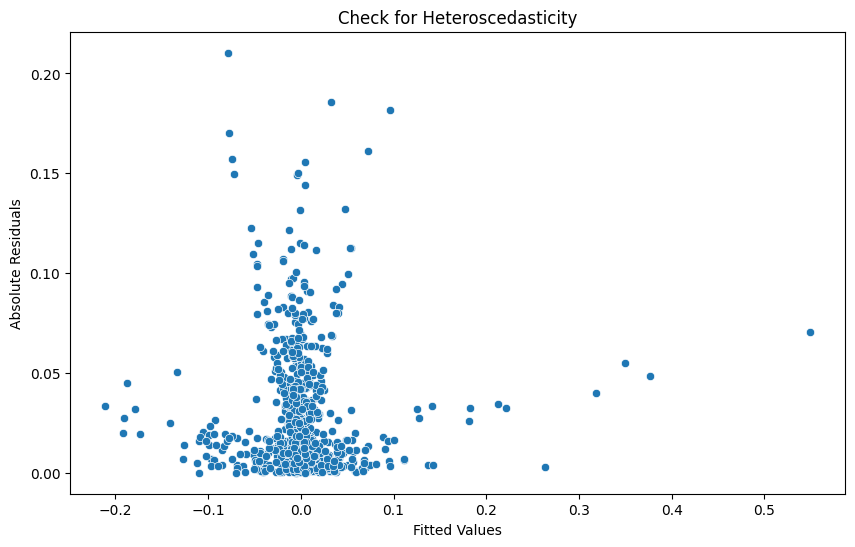

FLOW_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.489
Model:                            OLS   Adj. R-squared:                  0.483
Method:                 Least Squares   F-statistic:                     74.89
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           1.27e-96
Time:                        23:30:03   Log-Likelihood:                 1332.9
No. Observations:                 714   AIC:                            -2646.
Df Residuals:                     704   BIC:                            -2600.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

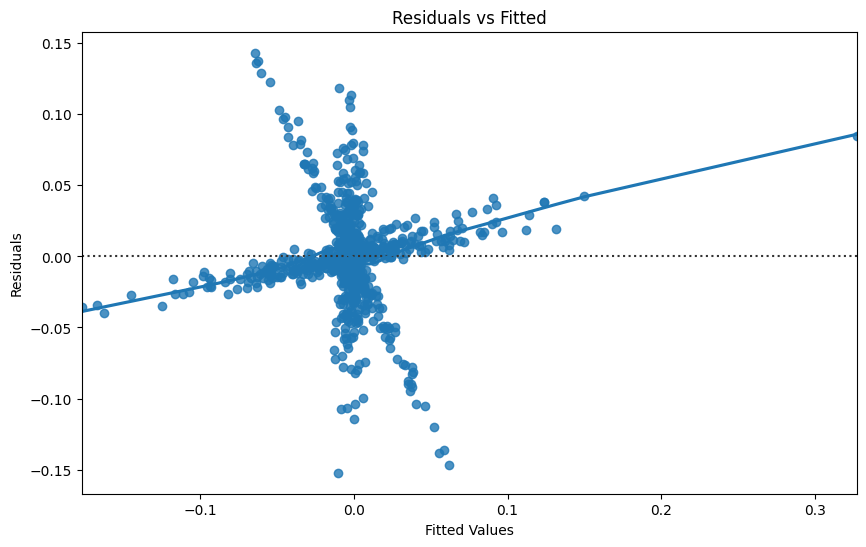

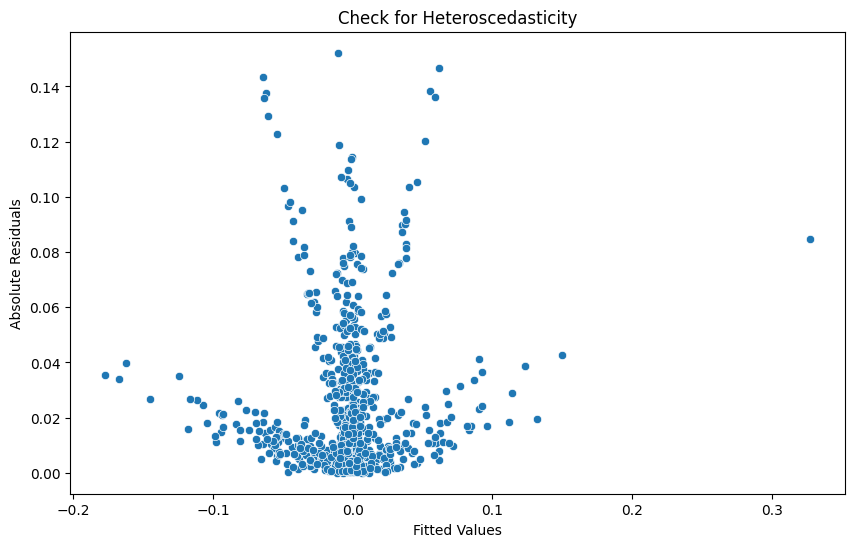

FTM_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.536
Model:                            OLS   Adj. R-squared:                  0.530
Method:                 Least Squares   F-statistic:                     90.33
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          3.56e-111
Time:                        23:30:04   Log-Likelihood:                 1228.5
No. Observations:                 714   AIC:                            -2437.
Df Residuals:                     704   BIC:                            -2391.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.01

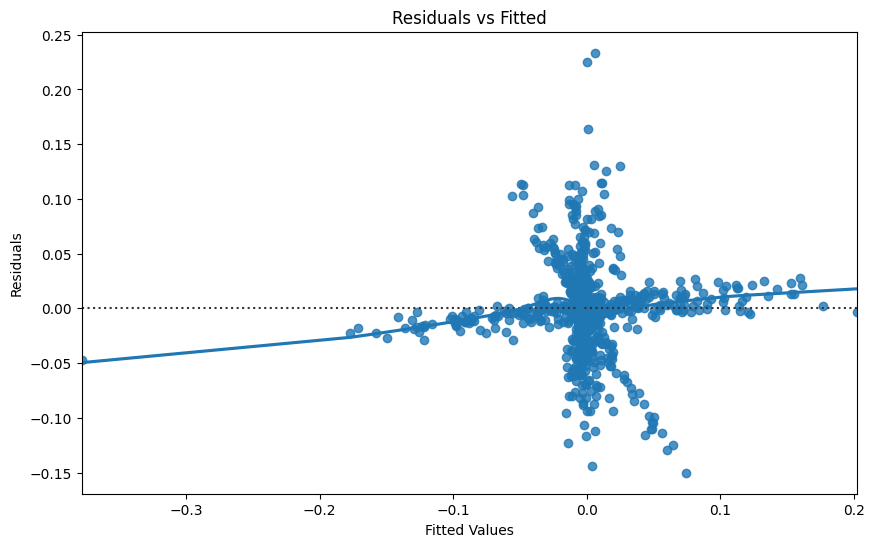

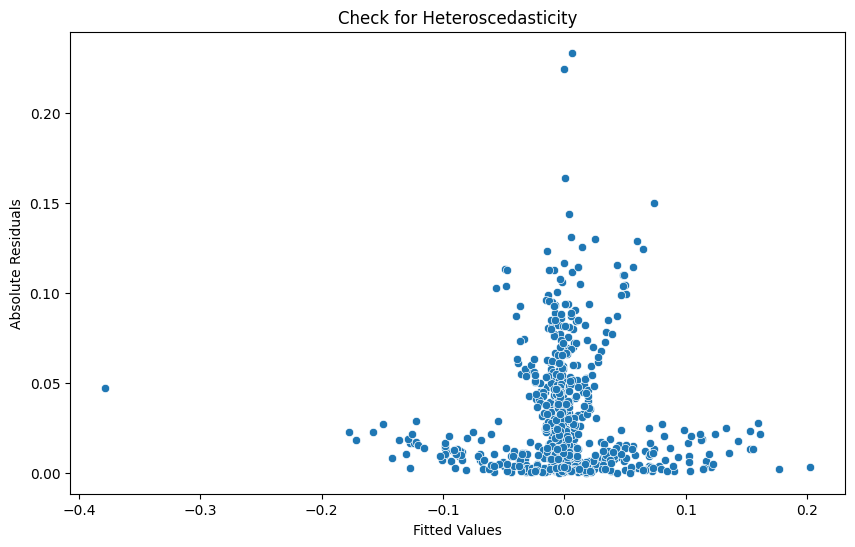

FUN_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.710
Model:                            OLS   Adj. R-squared:                  0.706
Method:                 Least Squares   F-statistic:                     215.5
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.08e-183
Time:                        23:30:05   Log-Likelihood:                 1483.8
No. Observations:                 714   AIC:                            -2950.
Df Residuals:                     705   BIC:                            -2908.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          -1.96e-

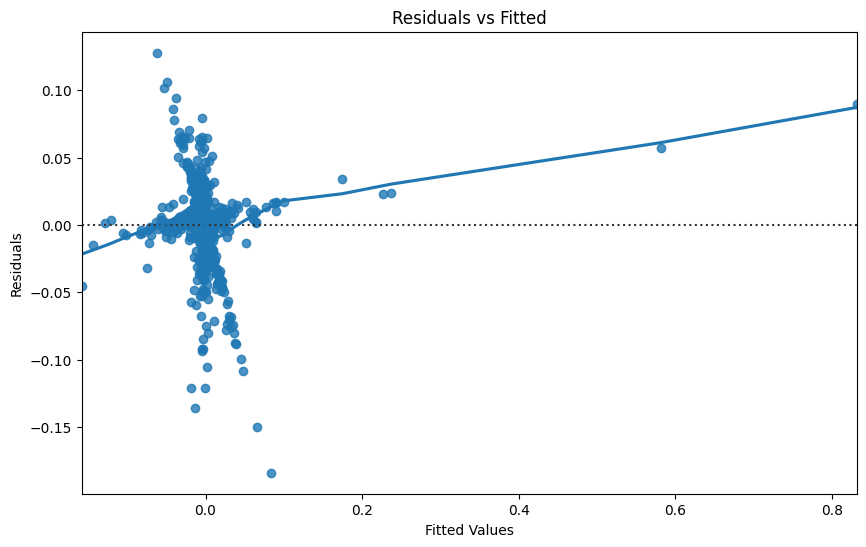

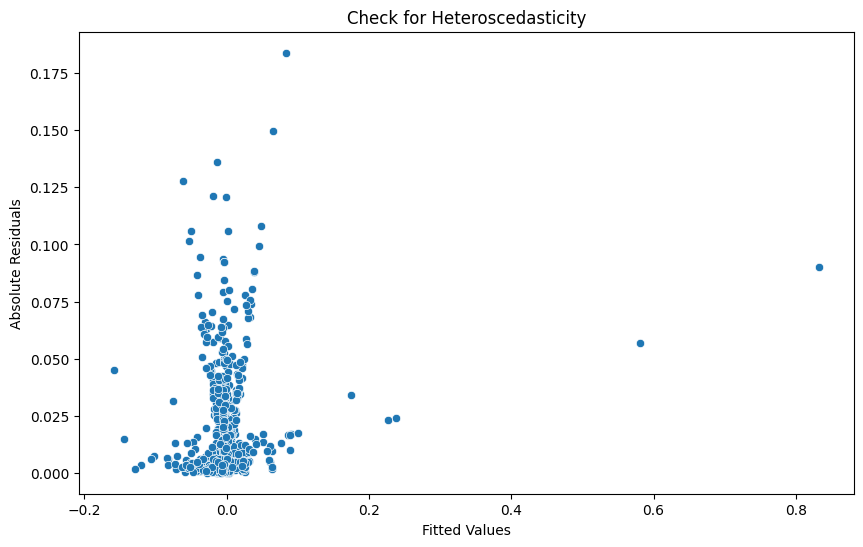

GALA_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.352
Model:                            OLS   Adj. R-squared:                  0.344
Method:                 Least Squares   F-statistic:                     42.58
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           6.87e-61
Time:                        23:30:06   Log-Likelihood:                 961.68
No. Observations:                 714   AIC:                            -1903.
Df Residuals:                     704   BIC:                            -1858.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

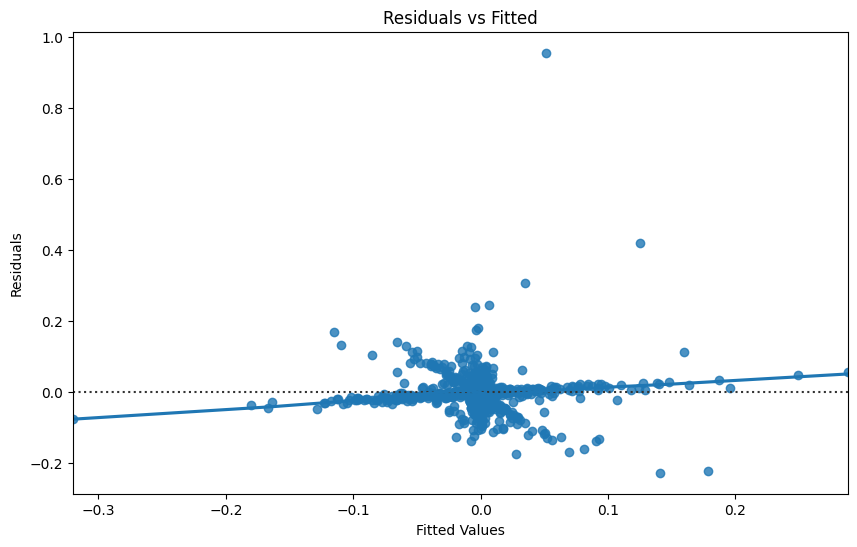

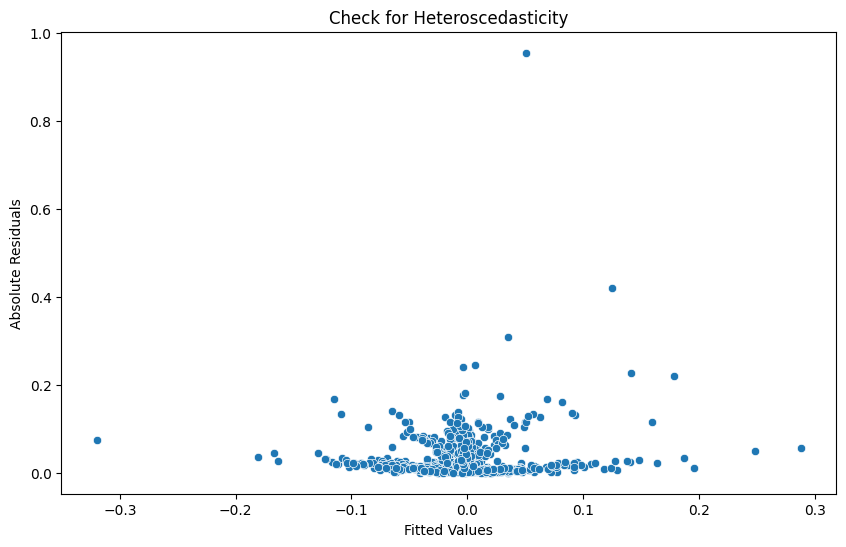

GNO_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.530
Model:                            OLS   Adj. R-squared:                  0.524
Method:                 Least Squares   F-statistic:                     79.36
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          2.36e-108
Time:                        23:30:07   Log-Likelihood:                 1457.0
No. Observations:                 714   AIC:                            -2892.
Df Residuals:                     703   BIC:                            -2842.
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.00

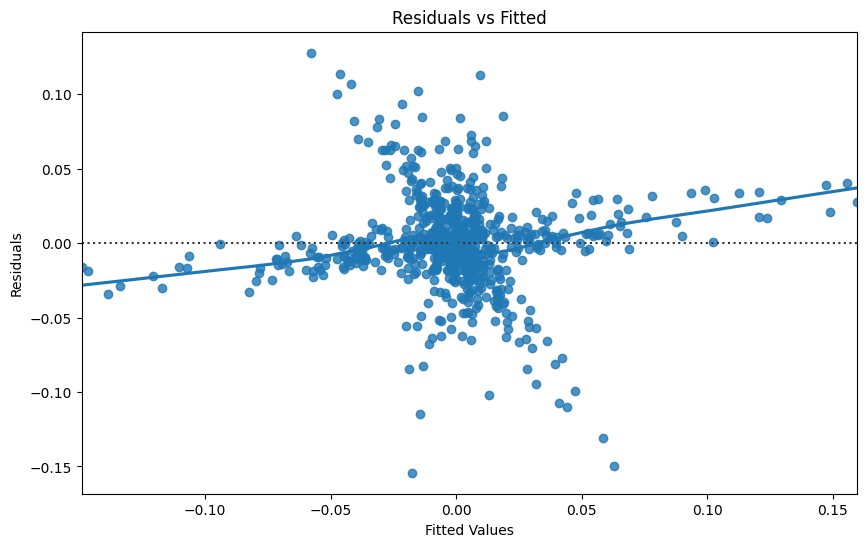

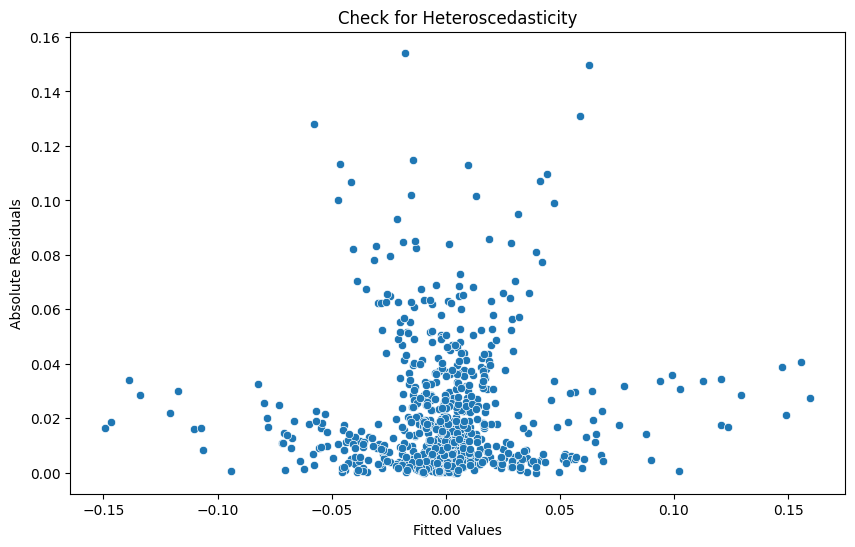

GRT_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.521
Model:                            OLS   Adj. R-squared:                  0.515
Method:                 Least Squares   F-statistic:                     85.07
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          2.28e-106
Time:                        23:30:08   Log-Likelihood:                 1228.4
No. Observations:                 714   AIC:                            -2437.
Df Residuals:                     704   BIC:                            -2391.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.01

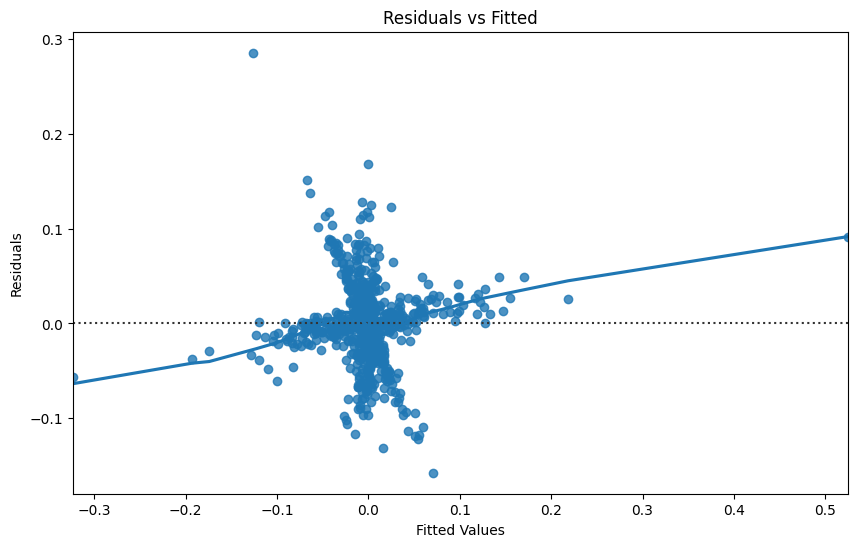

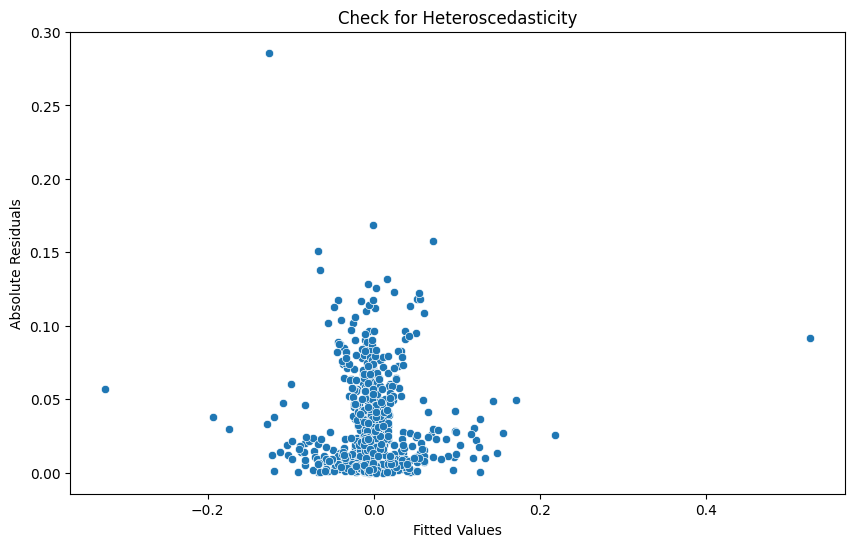

HIVE_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.543
Model:                            OLS   Adj. R-squared:                  0.537
Method:                 Least Squares   F-statistic:                     92.81
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          2.17e-113
Time:                        23:30:09   Log-Likelihood:                 1251.7
No. Observations:                 714   AIC:                            -2483.
Df Residuals:                     704   BIC:                            -2438.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.0

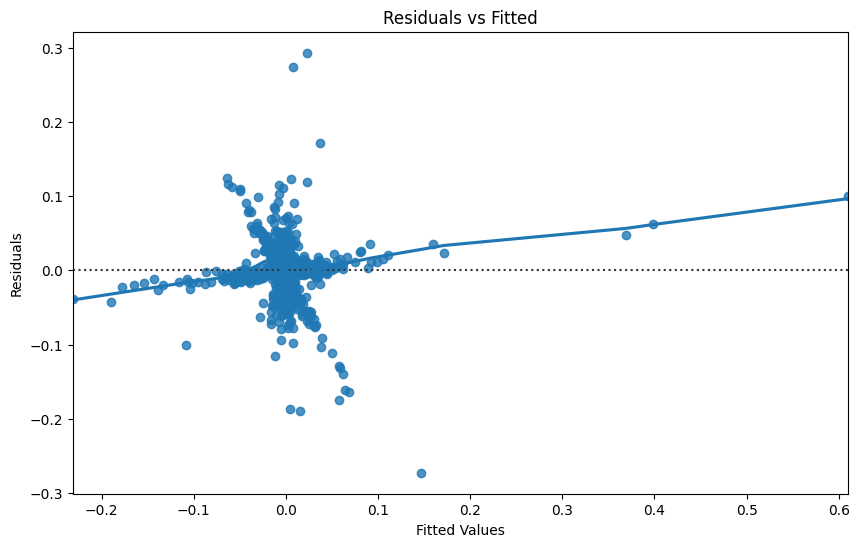

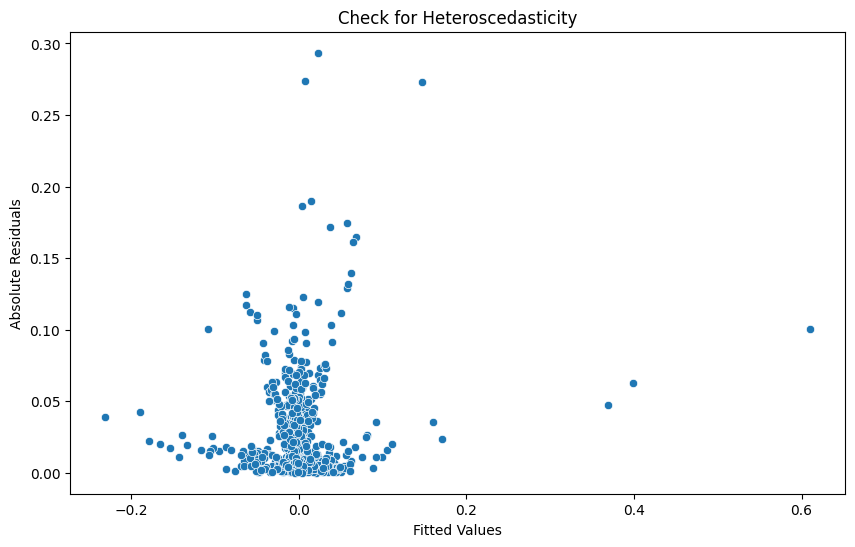

ICP_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.418
Model:                            OLS   Adj. R-squared:                  0.411
Method:                 Least Squares   F-statistic:                     56.29
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           4.67e-77
Time:                        23:30:10   Log-Likelihood:                 1281.7
No. Observations:                 714   AIC:                            -2543.
Df Residuals:                     704   BIC:                            -2498.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.02

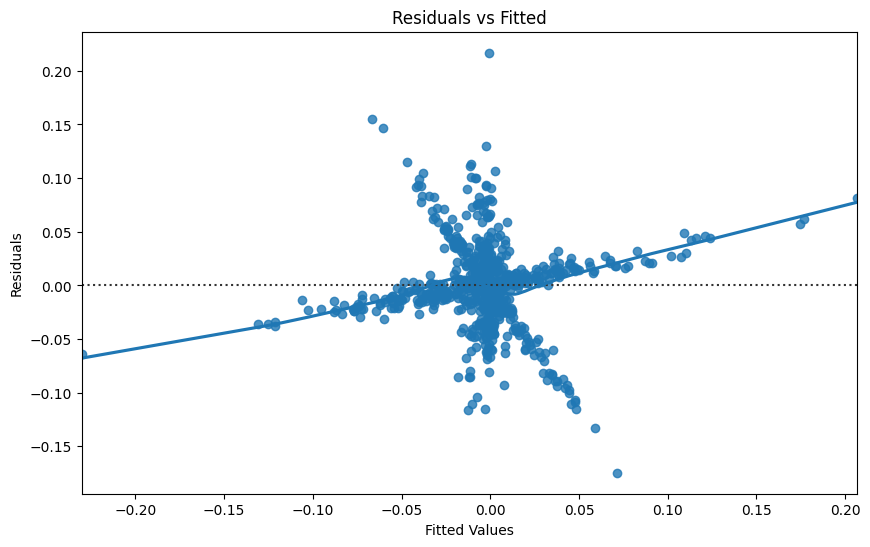

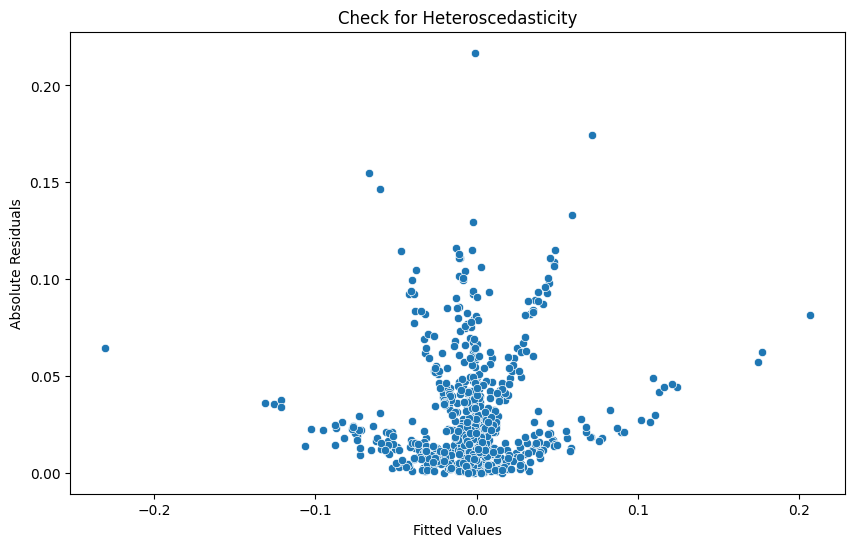

ICX_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.483
Model:                            OLS   Adj. R-squared:                  0.476
Method:                 Least Squares   F-statistic:                     73.09
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           7.77e-95
Time:                        23:30:12   Log-Likelihood:                 1299.4
No. Observations:                 714   AIC:                            -2579.
Df Residuals:                     704   BIC:                            -2533.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.02

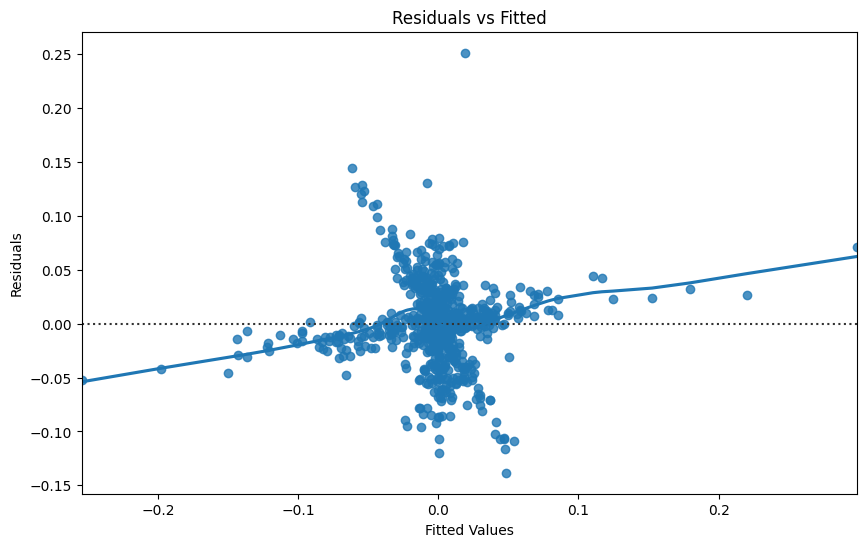

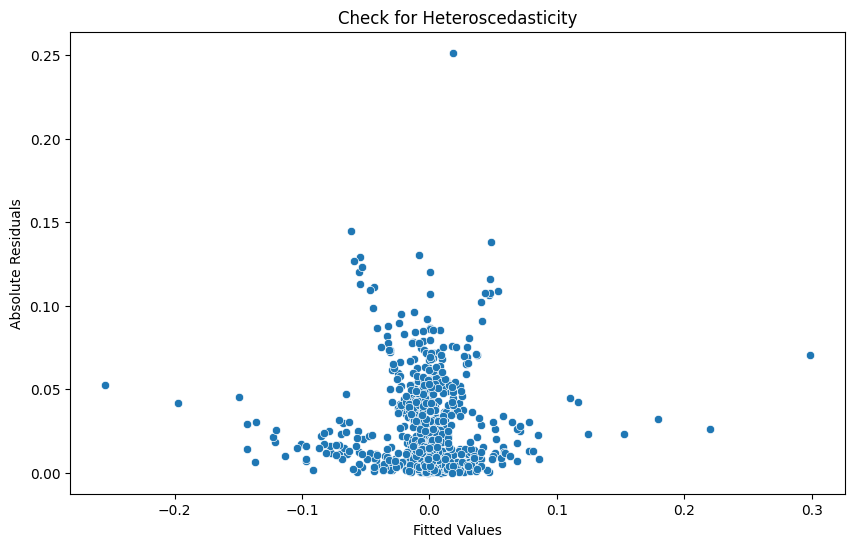

ILV_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.396
Model:                            OLS   Adj. R-squared:                  0.388
Method:                 Least Squares   F-statistic:                     51.26
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           2.55e-71
Time:                        23:30:13   Log-Likelihood:                 1247.5
No. Observations:                 714   AIC:                            -2475.
Df Residuals:                     704   BIC:                            -2429.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

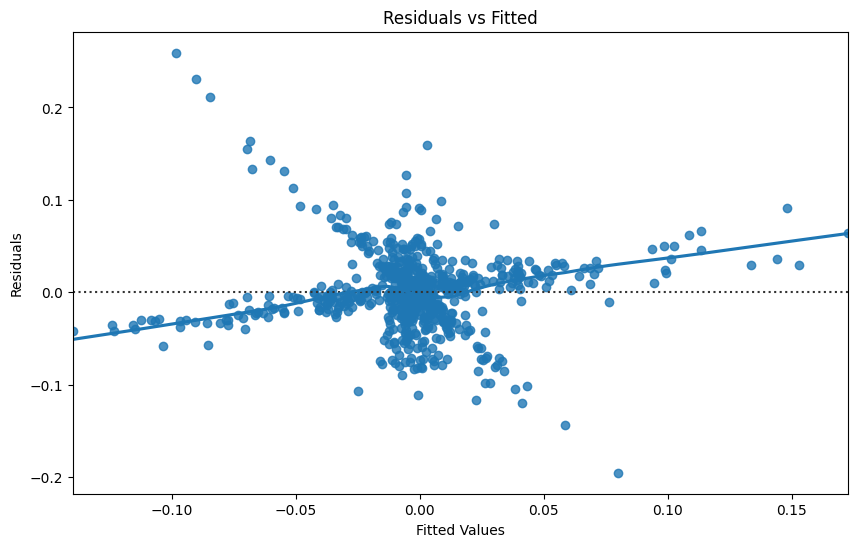

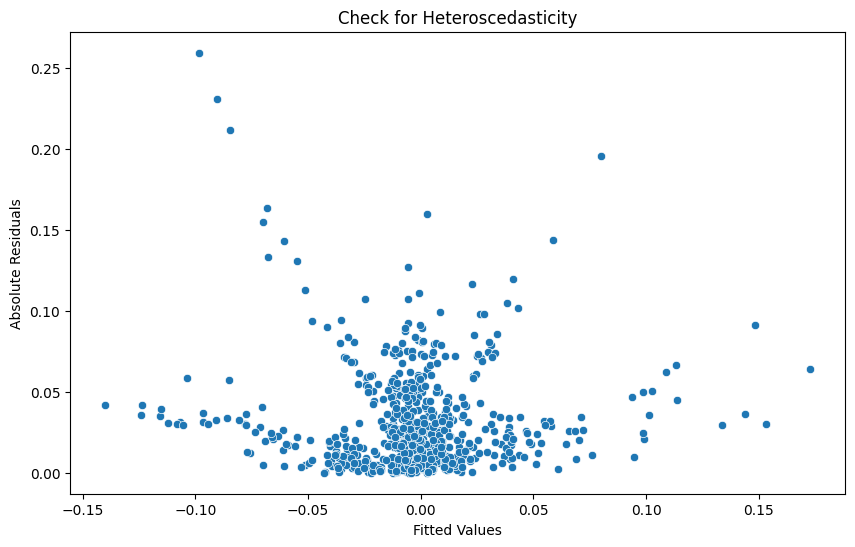

INJ_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.472
Model:                            OLS   Adj. R-squared:                  0.465
Method:                 Least Squares   F-statistic:                     69.89
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           1.34e-91
Time:                        23:30:14   Log-Likelihood:                 1154.4
No. Observations:                 714   AIC:                            -2289.
Df Residuals:                     704   BIC:                            -2243.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.01

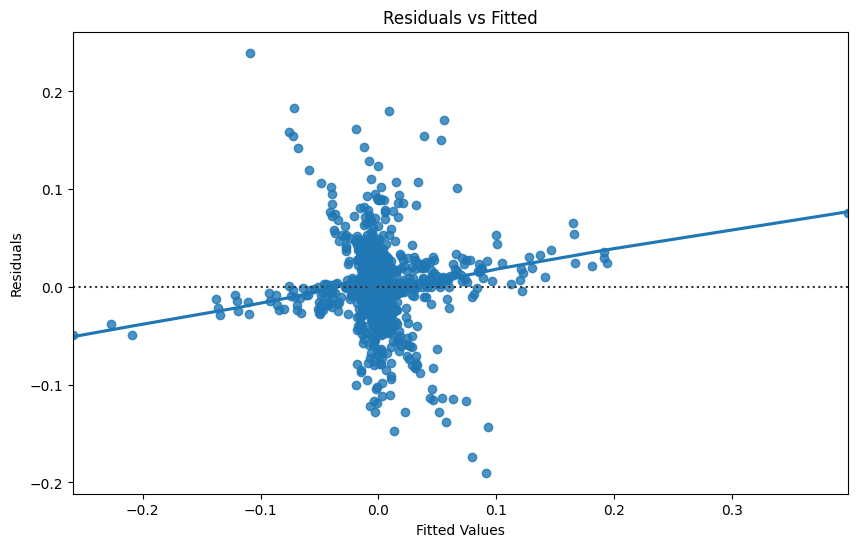

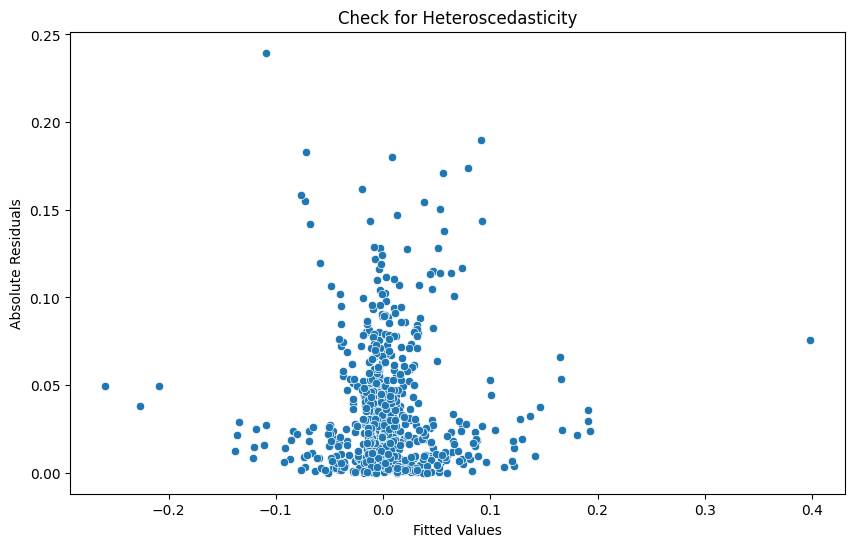

IOTA_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.462
Model:                            OLS   Adj. R-squared:                  0.455
Method:                 Least Squares   F-statistic:                     67.13
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           9.27e-89
Time:                        23:30:15   Log-Likelihood:                 1376.8
No. Observations:                 714   AIC:                            -2734.
Df Residuals:                     704   BIC:                            -2688.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

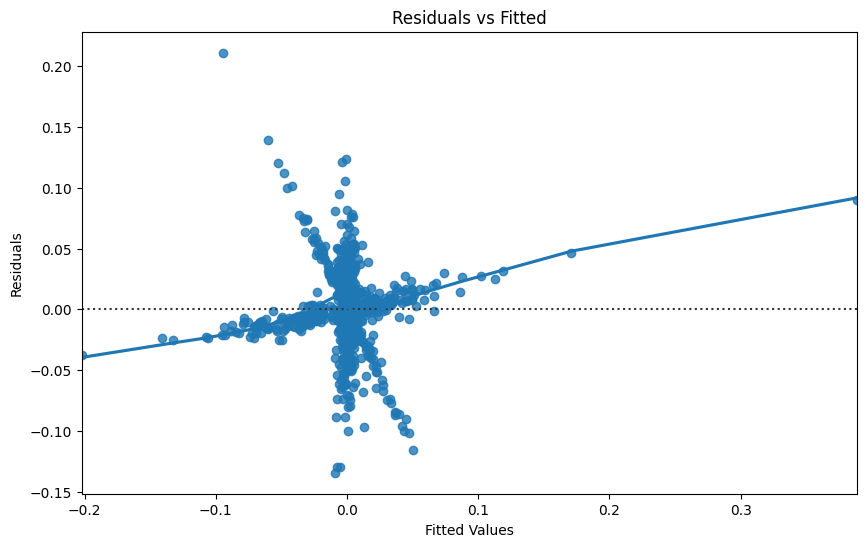

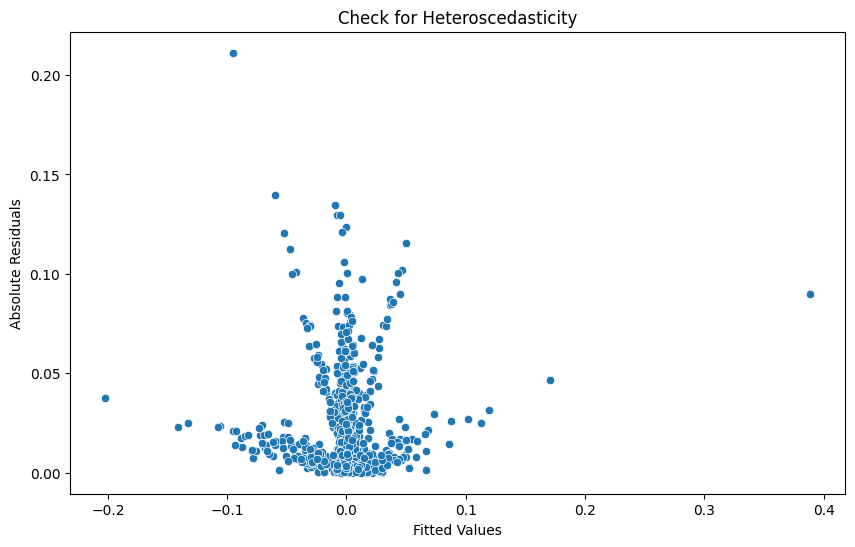

IOTX_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.344
Model:                            OLS   Adj. R-squared:                  0.335
Method:                 Least Squares   F-statistic:                     40.99
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           6.76e-59
Time:                        23:30:16   Log-Likelihood:                 969.73
No. Observations:                 714   AIC:                            -1919.
Df Residuals:                     704   BIC:                            -1874.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.0

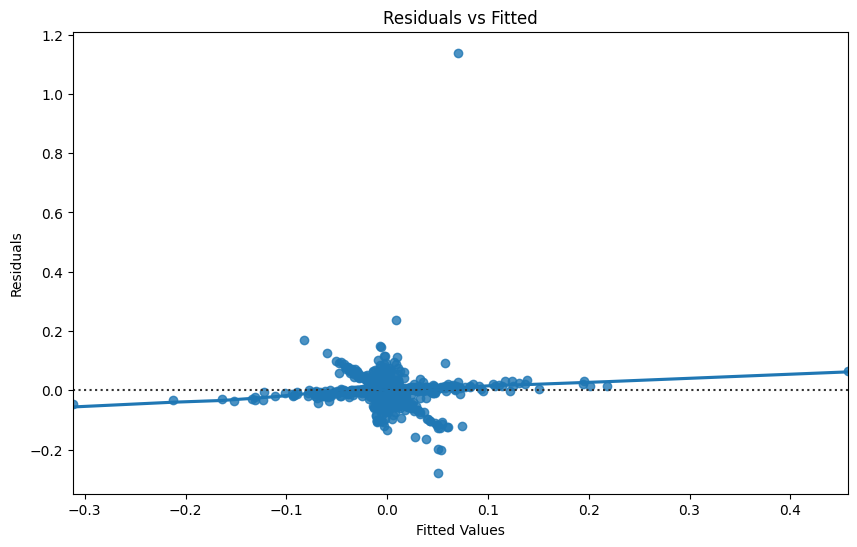

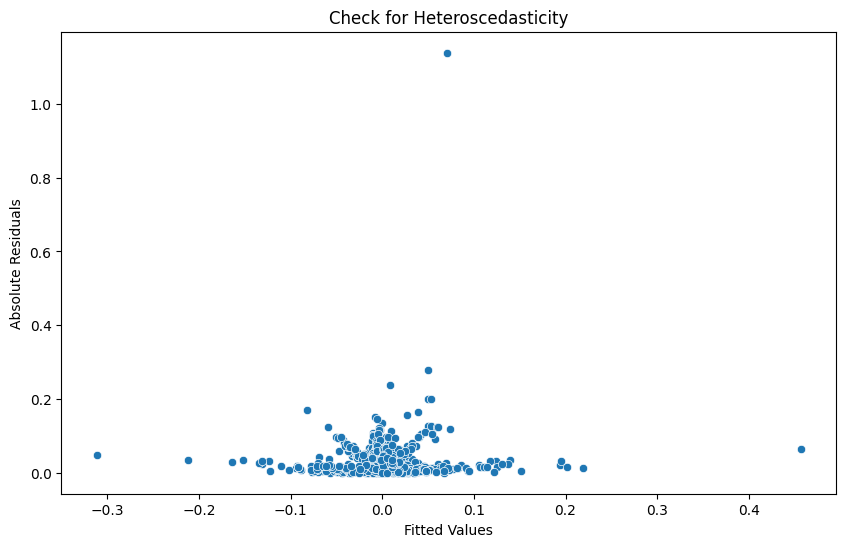

JST_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.463
Model:                            OLS   Adj. R-squared:                  0.456
Method:                 Least Squares   F-statistic:                     75.85
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           6.40e-90
Time:                        23:30:17   Log-Likelihood:                 1411.4
No. Observations:                 714   AIC:                            -2805.
Df Residuals:                     705   BIC:                            -2764.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap         -5.665e-

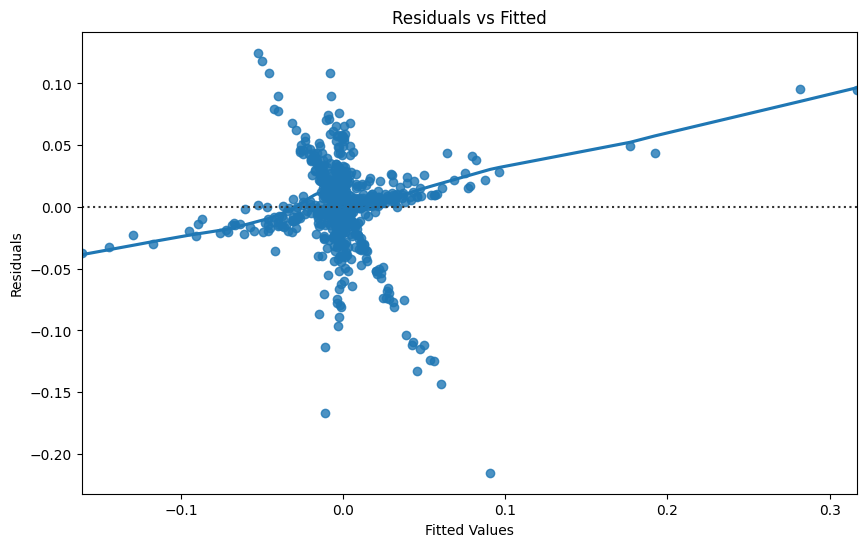

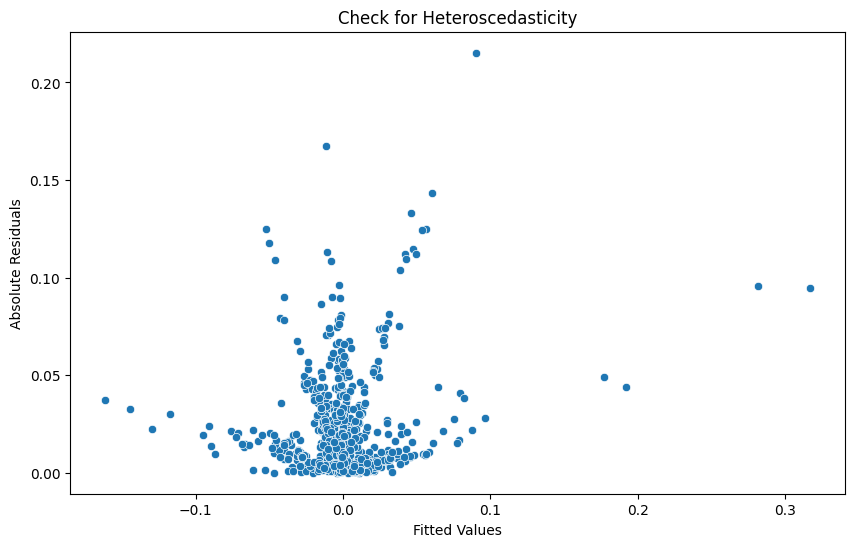

KAVA_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.390
Model:                            OLS   Adj. R-squared:                  0.382
Method:                 Least Squares   F-statistic:                     49.93
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           9.11e-70
Time:                        23:30:18   Log-Likelihood:                 1281.4
No. Observations:                 714   AIC:                            -2543.
Df Residuals:                     704   BIC:                            -2497.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

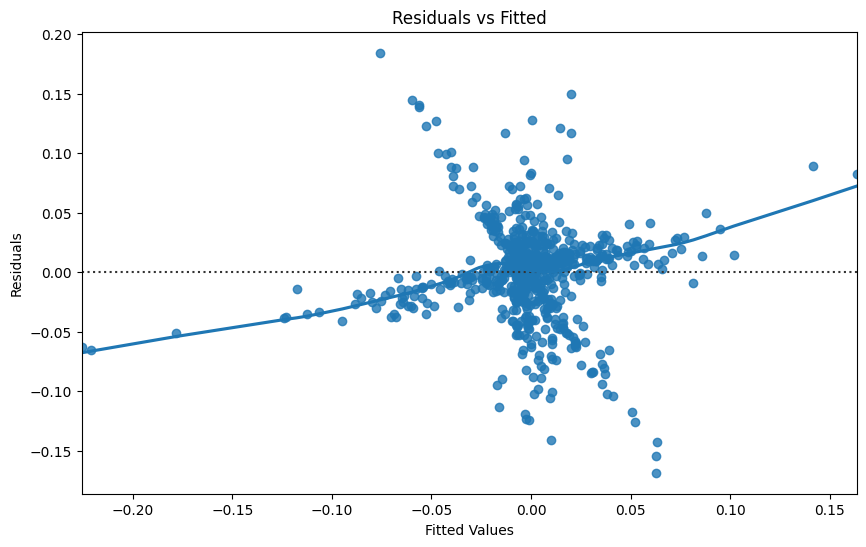

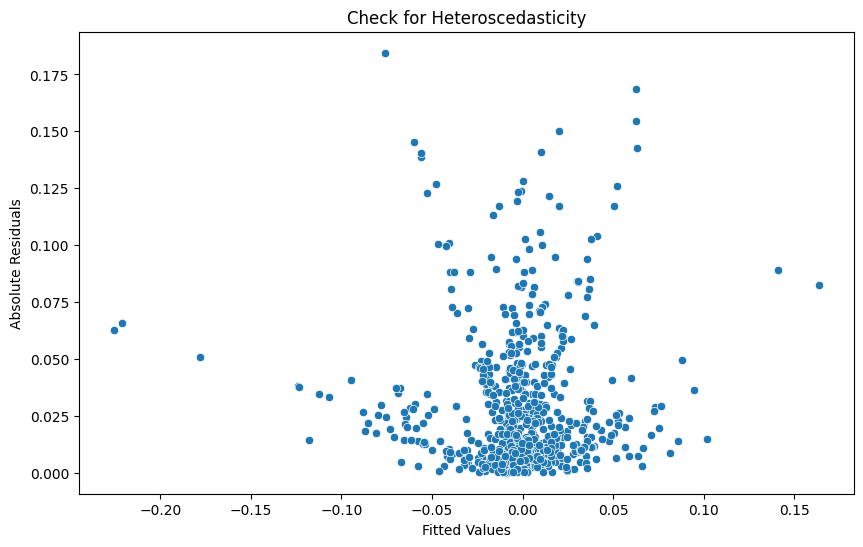

KMD_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.646
Model:                            OLS   Adj. R-squared:                  0.642
Method:                 Least Squares   F-statistic:                     160.6
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          2.92e-153
Time:                        23:30:19   Log-Likelihood:                 1319.3
No. Observations:                 714   AIC:                            -2621.
Df Residuals:                     705   BIC:                            -2579.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          2.784e-

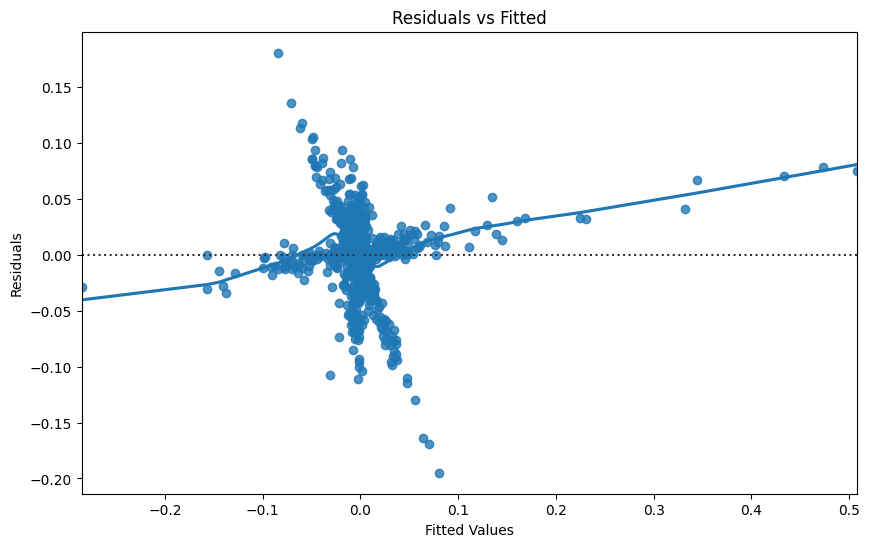

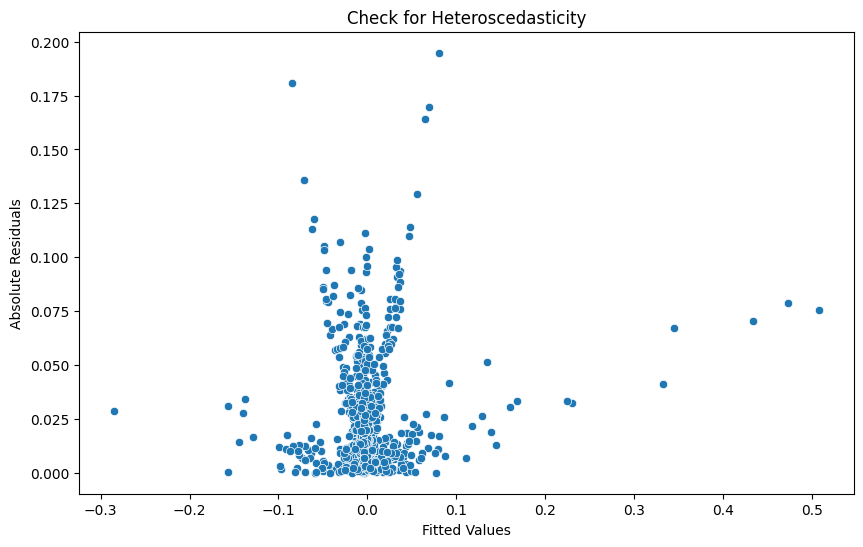

KNC_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.452
Model:                            OLS   Adj. R-squared:                  0.445
Method:                 Least Squares   F-statistic:                     72.60
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           6.94e-87
Time:                        23:30:20   Log-Likelihood:                 1236.1
No. Observations:                 714   AIC:                            -2454.
Df Residuals:                     705   BIC:                            -2413.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          9.916e-

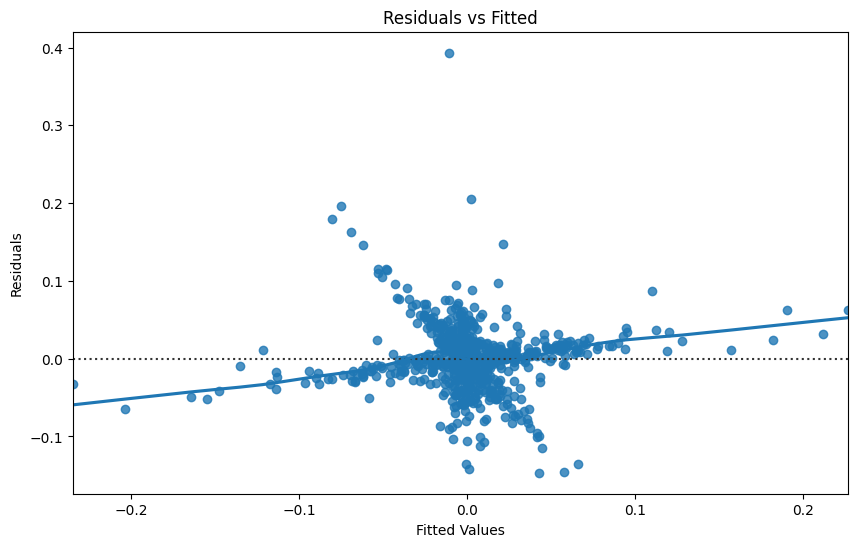

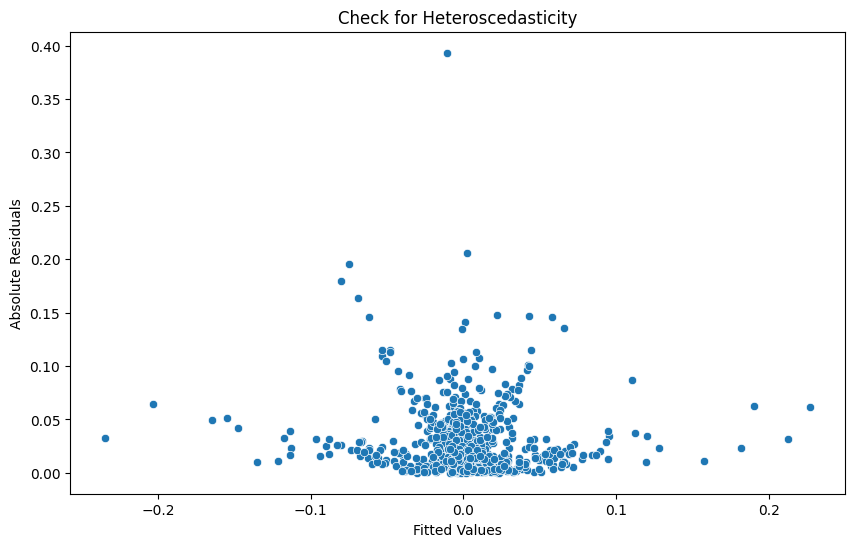

KSM_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.371
Model:                            OLS   Adj. R-squared:                  0.363
Method:                 Least Squares   F-statistic:                     46.16
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           2.86e-65
Time:                        23:30:21   Log-Likelihood:                 1310.8
No. Observations:                 714   AIC:                            -2602.
Df Residuals:                     704   BIC:                            -2556.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.01

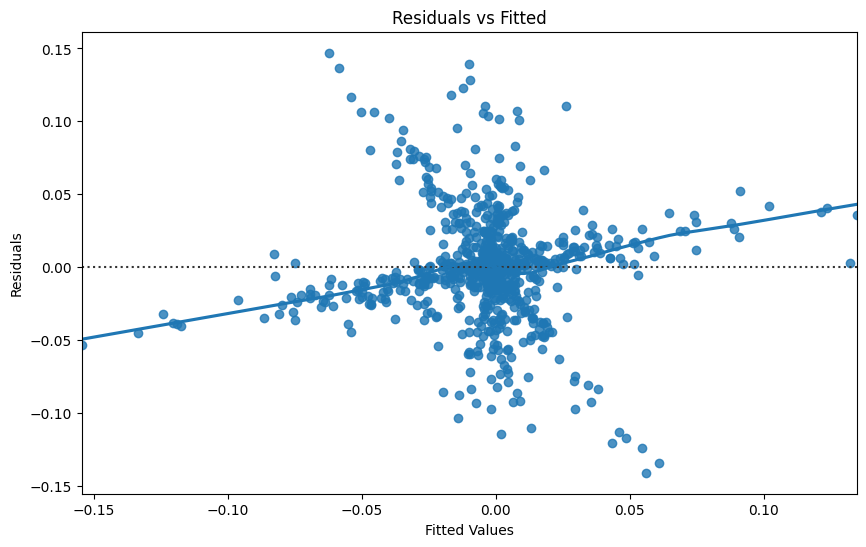

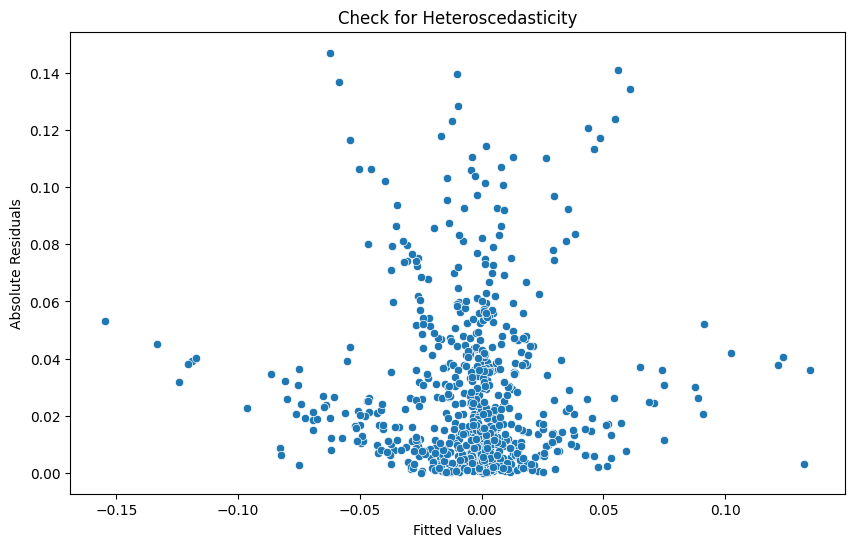

LINK_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.487
Model:                            OLS   Adj. R-squared:                  0.480
Method:                 Least Squares   F-statistic:                     74.20
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           6.07e-96
Time:                        23:30:22   Log-Likelihood:                 1401.3
No. Observations:                 714   AIC:                            -2783.
Df Residuals:                     704   BIC:                            -2737.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

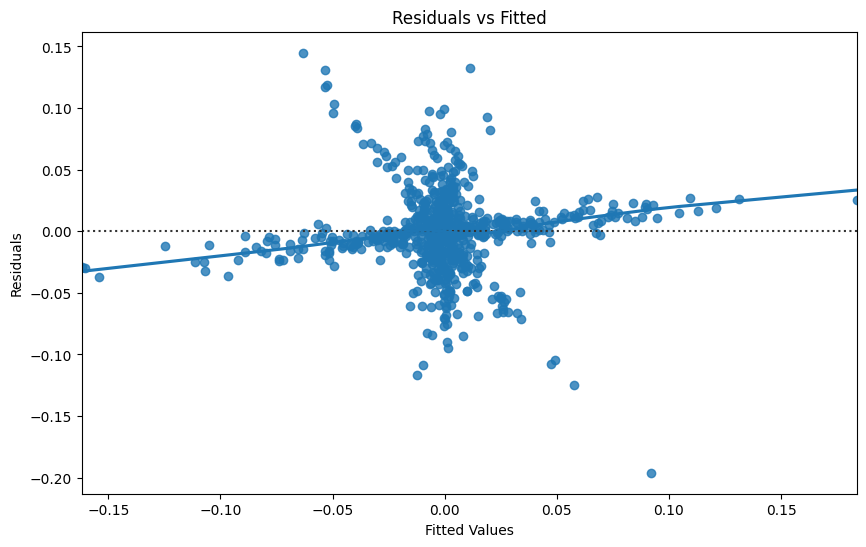

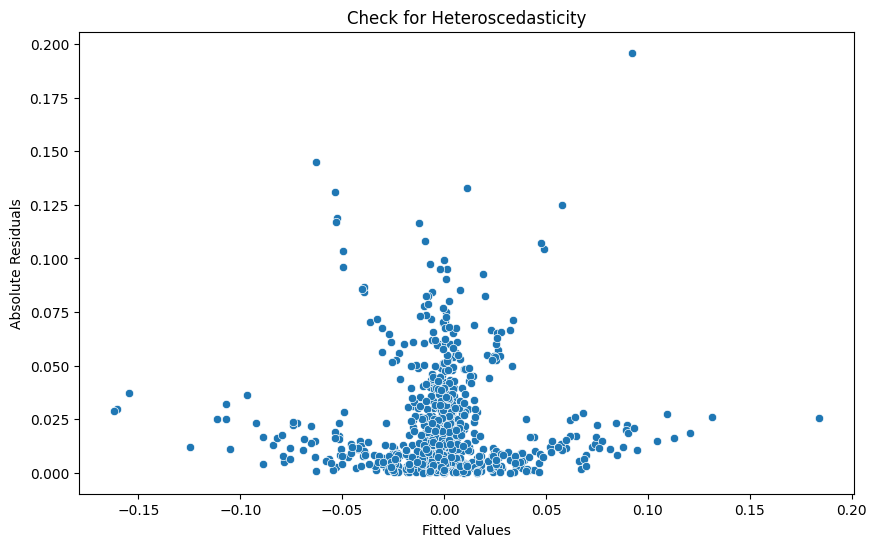

LRC_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.476
Model:                            OLS   Adj. R-squared:                  0.469
Method:                 Least Squares   F-statistic:                     71.07
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           8.49e-93
Time:                        23:30:23   Log-Likelihood:                 1190.8
No. Observations:                 714   AIC:                            -2362.
Df Residuals:                     704   BIC:                            -2316.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

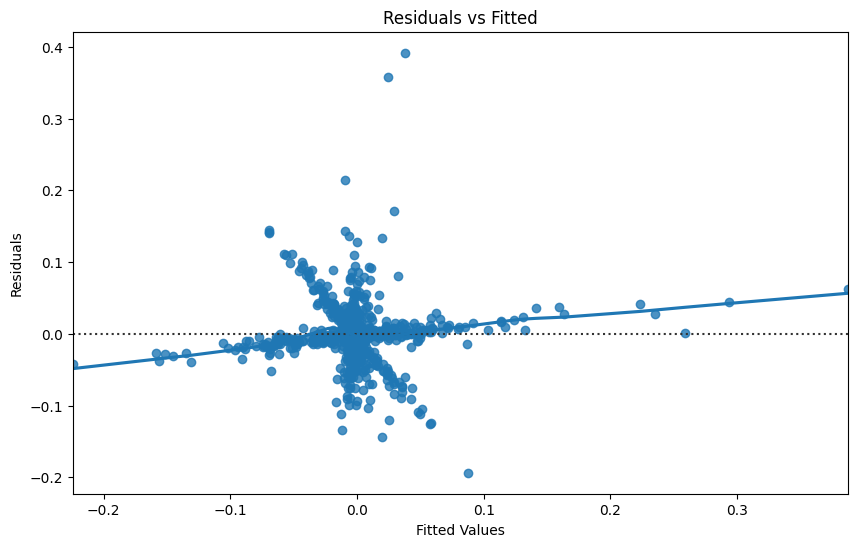

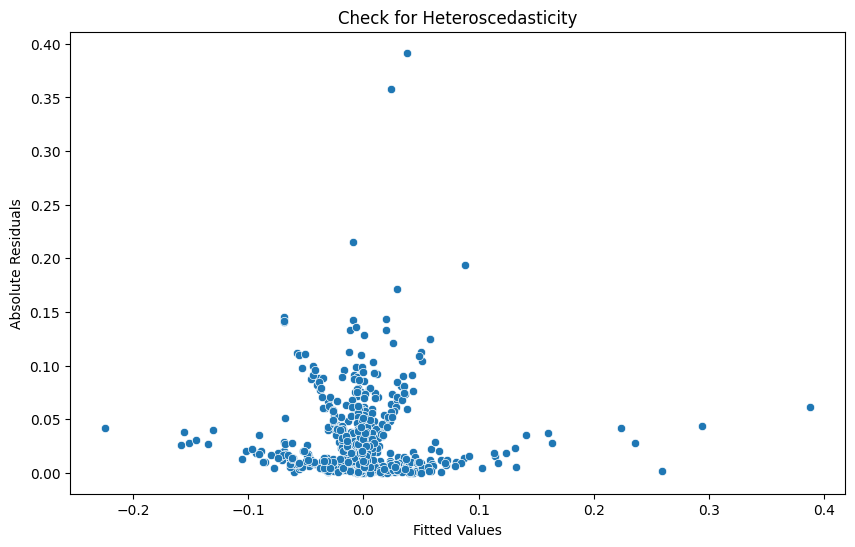

LSK_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.564
Model:                            OLS   Adj. R-squared:                  0.559
Method:                 Least Squares   F-statistic:                     113.9
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.25e-121
Time:                        23:30:24   Log-Likelihood:                 1357.8
No. Observations:                 714   AIC:                            -2698.
Df Residuals:                     705   BIC:                            -2656.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          1.703e-

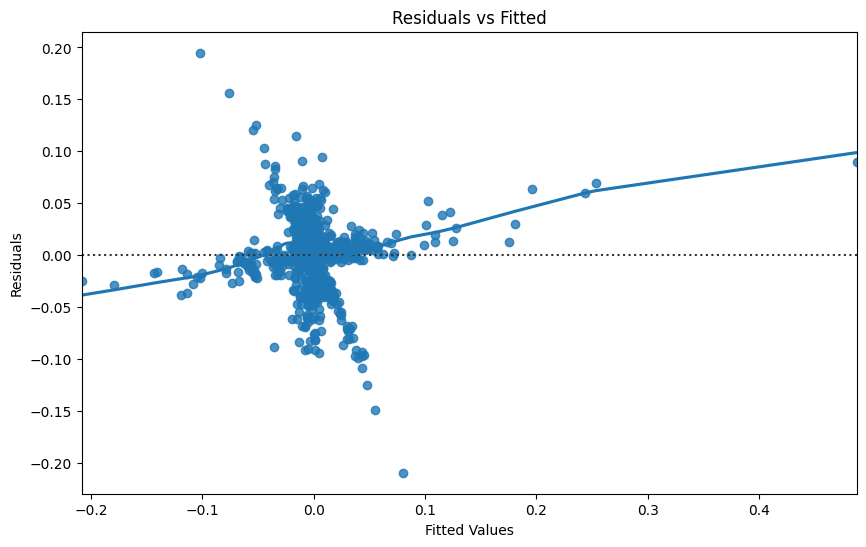

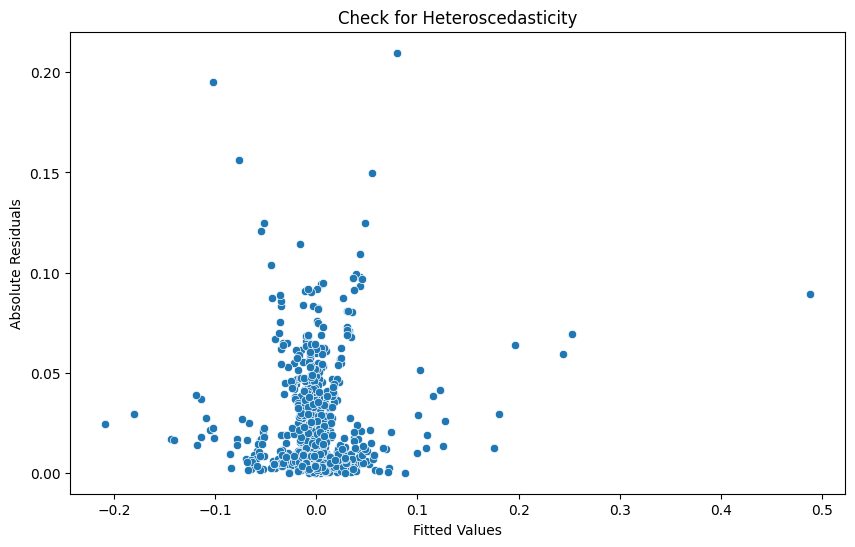

LTC_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.620
Model:                            OLS   Adj. R-squared:                  0.615
Method:                 Least Squares   F-statistic:                     127.5
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.99e-141
Time:                        23:30:25   Log-Likelihood:                 1561.4
No. Observations:                 714   AIC:                            -3103.
Df Residuals:                     704   BIC:                            -3057.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

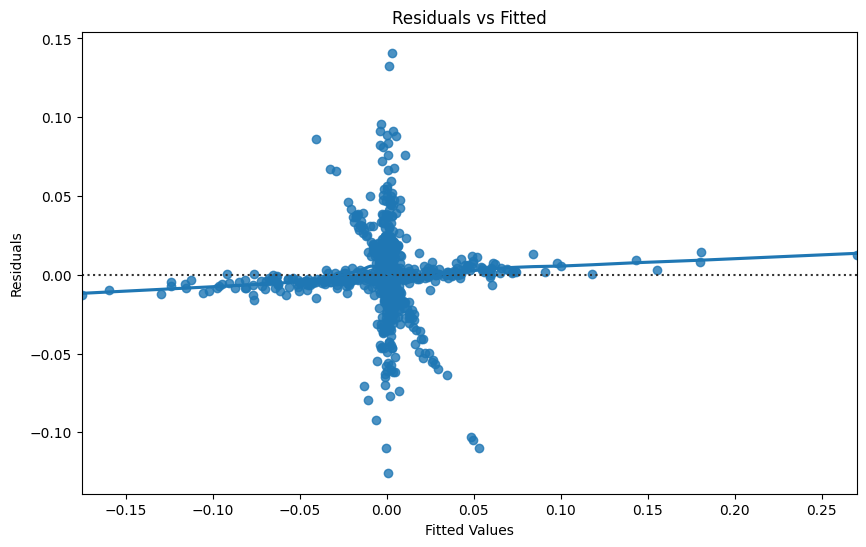

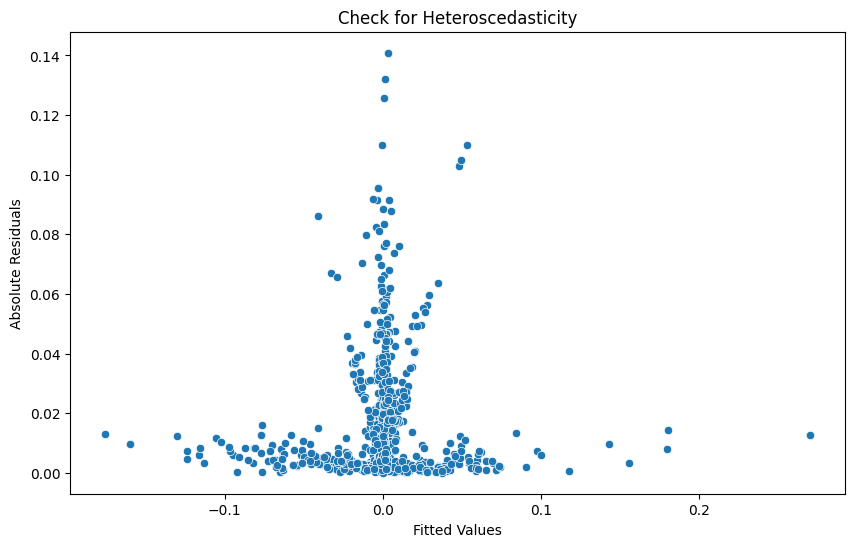

LTO_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.379
Model:                            OLS   Adj. R-squared:                  0.372
Method:                 Least Squares   F-statistic:                     53.80
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           4.57e-68
Time:                        23:30:27   Log-Likelihood:                 1204.0
No. Observations:                 714   AIC:                            -2390.
Df Residuals:                     705   BIC:                            -2349.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          2.569e-

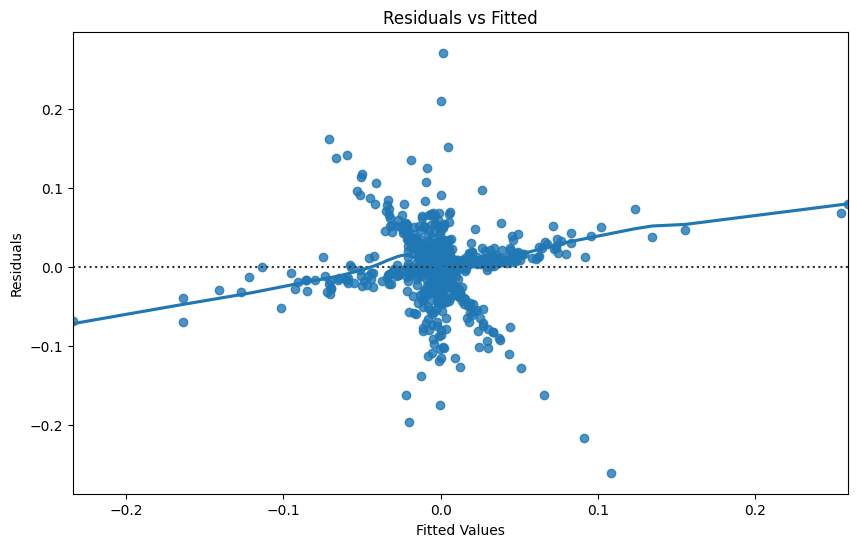

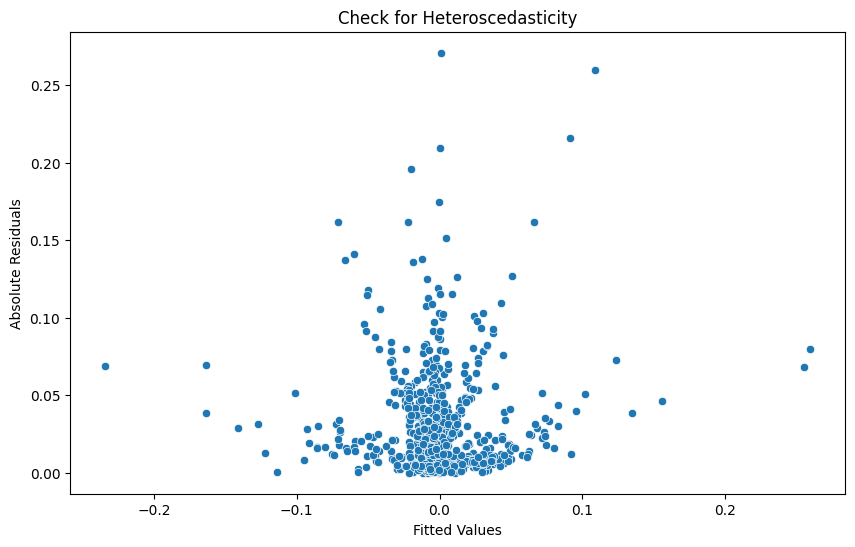

MATIC_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.534
Model:                            OLS   Adj. R-squared:                  0.528
Method:                 Least Squares   F-statistic:                     89.76
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.18e-110
Time:                        23:30:28   Log-Likelihood:                 1338.5
No. Observations:                 714   AIC:                            -2657.
Df Residuals:                     704   BIC:                            -2611.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.

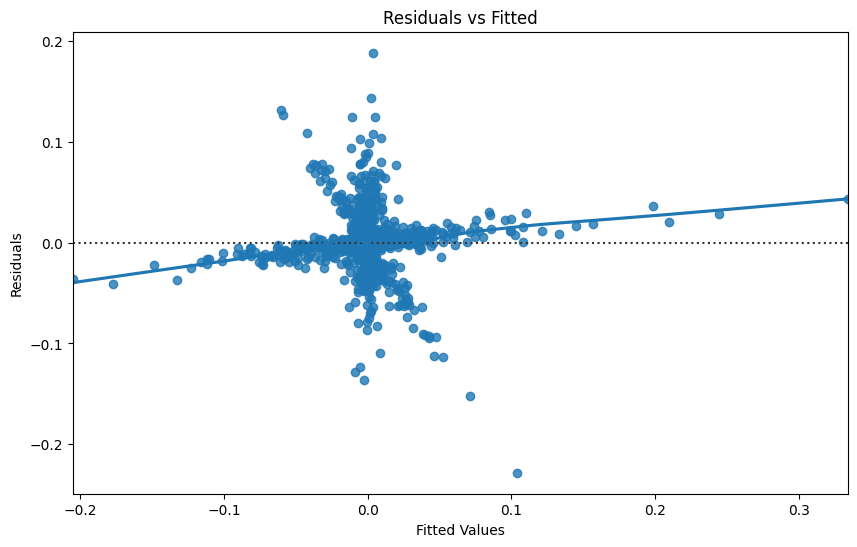

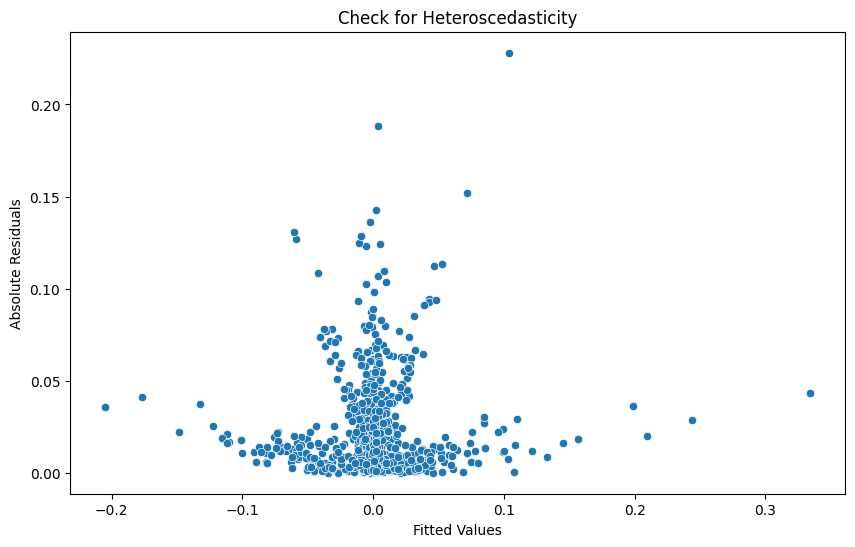

MINA_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.493
Model:                            OLS   Adj. R-squared:                  0.487
Method:                 Least Squares   F-statistic:                     76.09
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           8.29e-98
Time:                        23:30:29   Log-Likelihood:                 1241.6
No. Observations:                 714   AIC:                            -2463.
Df Residuals:                     704   BIC:                            -2418.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

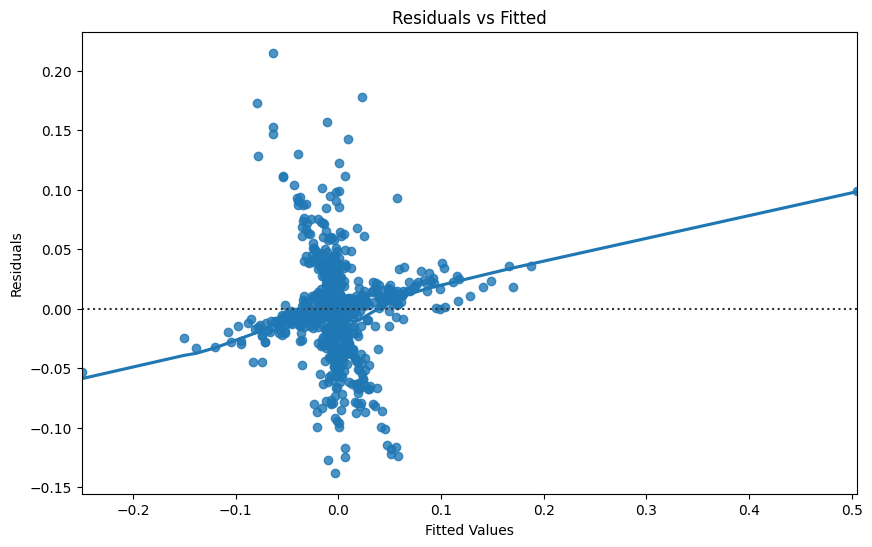

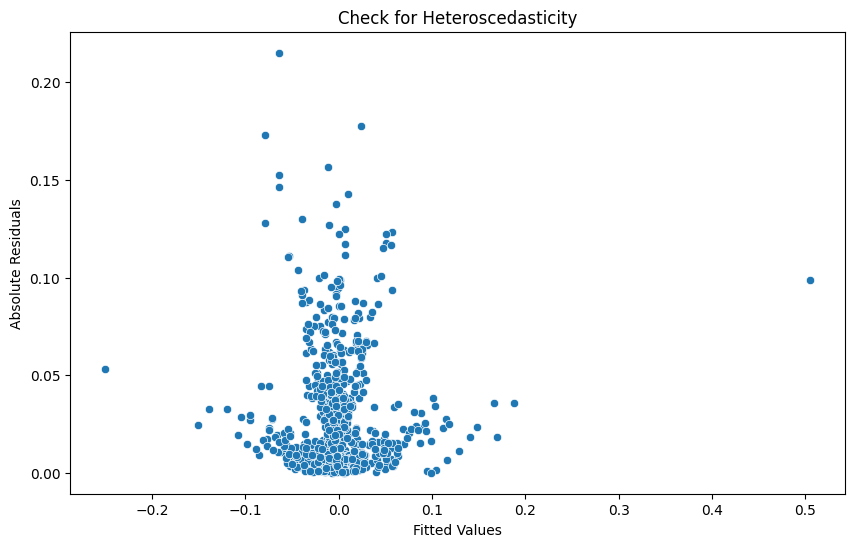

MKR_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.417
Model:                            OLS   Adj. R-squared:                  0.410
Method:                 Least Squares   F-statistic:                     56.02
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           9.33e-77
Time:                        23:30:30   Log-Likelihood:                 1354.4
No. Observations:                 714   AIC:                            -2689.
Df Residuals:                     704   BIC:                            -2643.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const               5.923e-

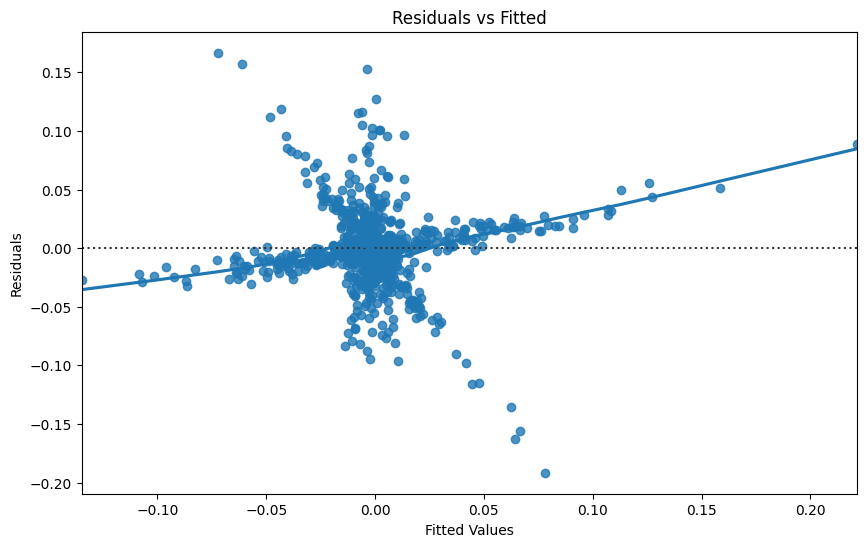

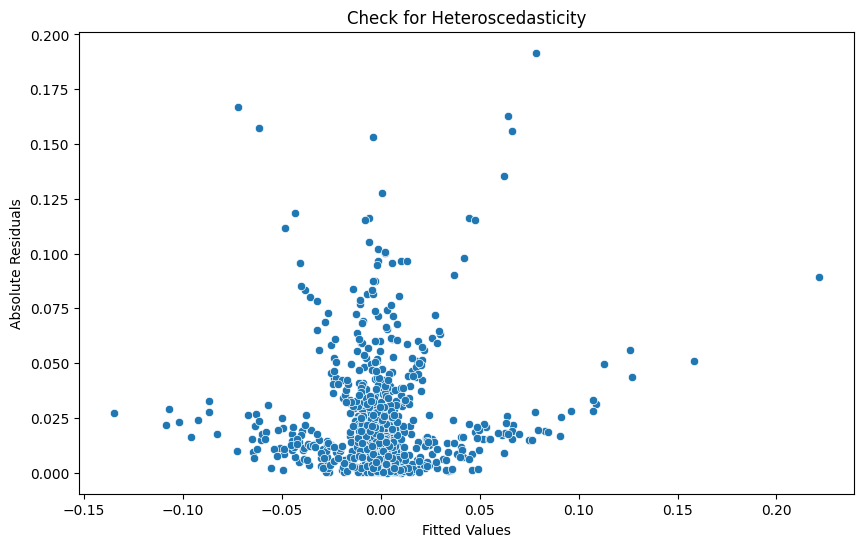

MLN_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.542
Model:                            OLS   Adj. R-squared:                  0.536
Method:                 Least Squares   F-statistic:                     92.63
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          3.18e-113
Time:                        23:30:31   Log-Likelihood:                 1382.3
No. Observations:                 714   AIC:                            -2745.
Df Residuals:                     704   BIC:                            -2699.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          6.794e-

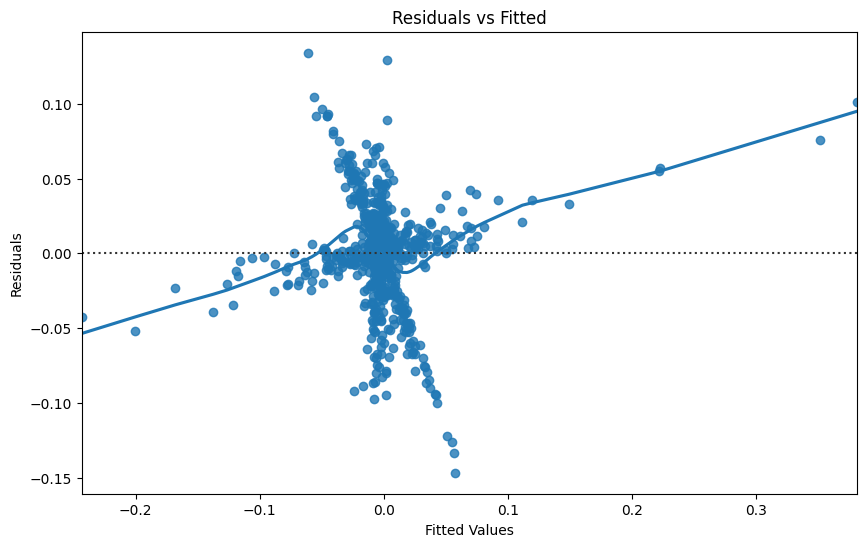

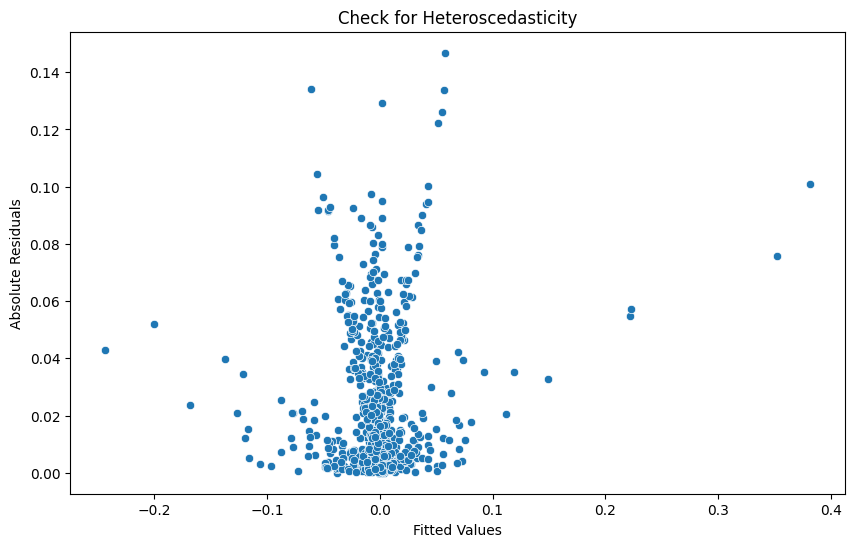

MTL_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.503
Model:                            OLS   Adj. R-squared:                  0.498
Method:                 Least Squares   F-statistic:                     89.30
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          7.12e-102
Time:                        23:30:32   Log-Likelihood:                 1282.0
No. Observations:                 714   AIC:                            -2546.
Df Residuals:                     705   BIC:                            -2505.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          4.171e-

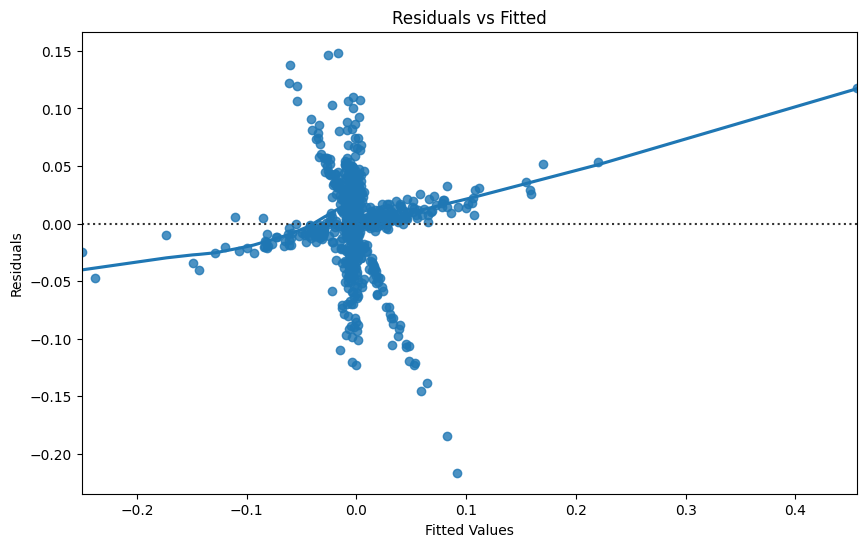

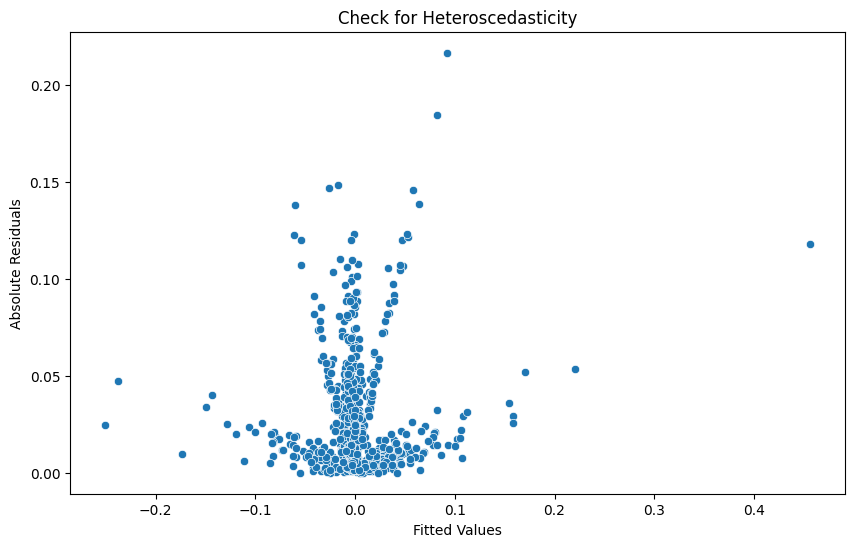

NEO_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.532
Model:                            OLS   Adj. R-squared:                  0.526
Method:                 Least Squares   F-statistic:                     88.93
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          6.58e-110
Time:                        23:30:34   Log-Likelihood:                 1365.7
No. Observations:                 714   AIC:                            -2711.
Df Residuals:                     704   BIC:                            -2666.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.03

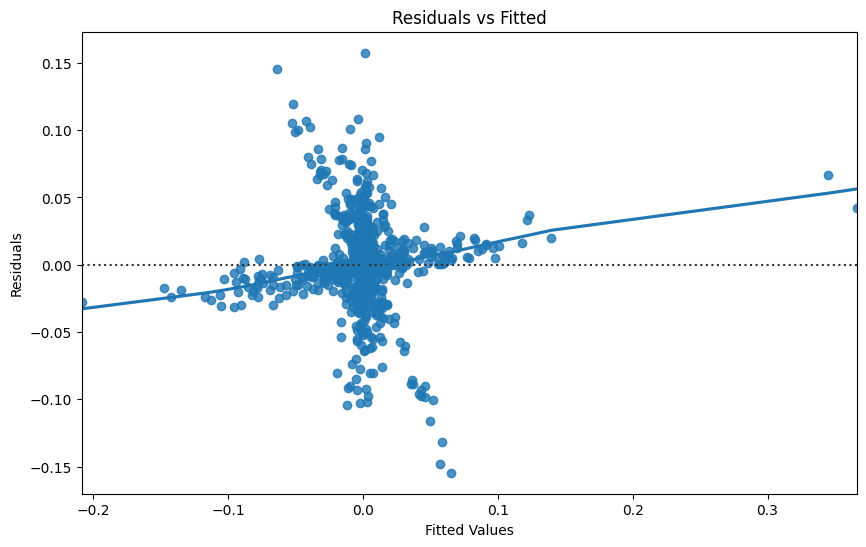

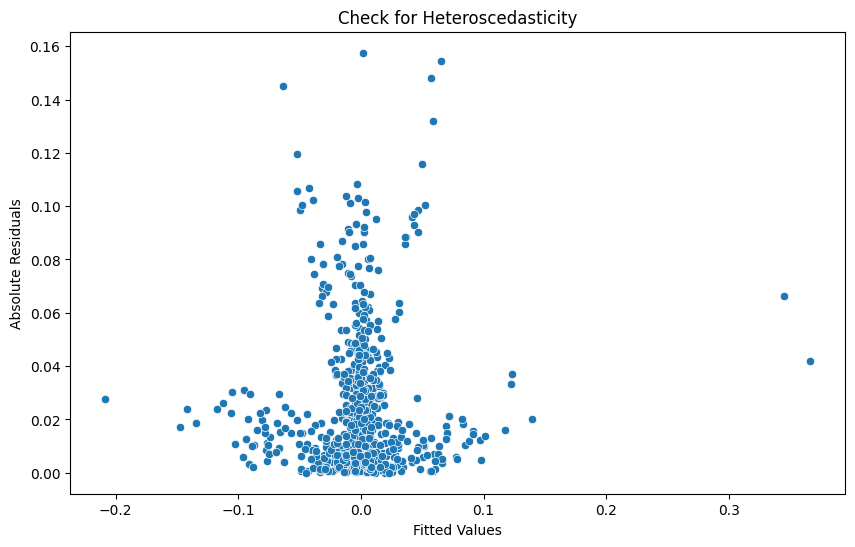

NMR_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.671
Model:                            OLS   Adj. R-squared:                  0.667
Method:                 Least Squares   F-statistic:                     159.7
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.51e-163
Time:                        23:30:35   Log-Likelihood:                 1335.7
No. Observations:                 714   AIC:                            -2651.
Df Residuals:                     704   BIC:                            -2606.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          2.327e-

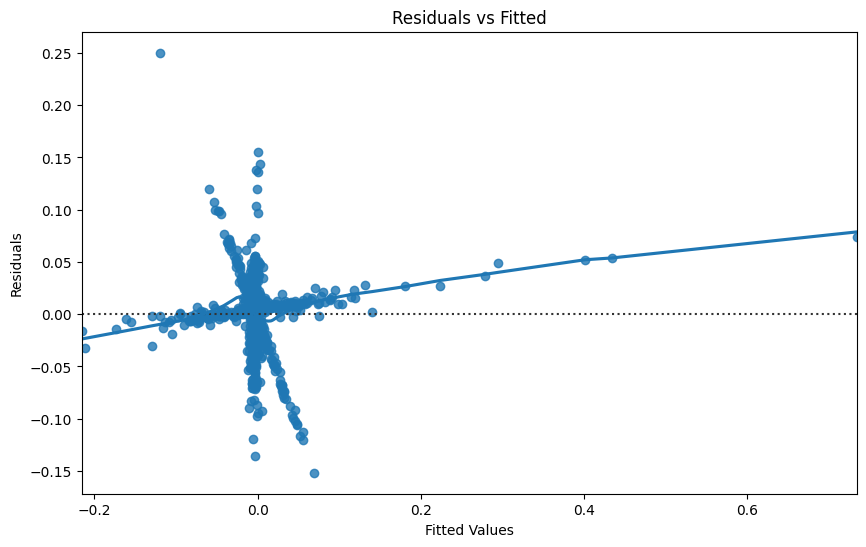

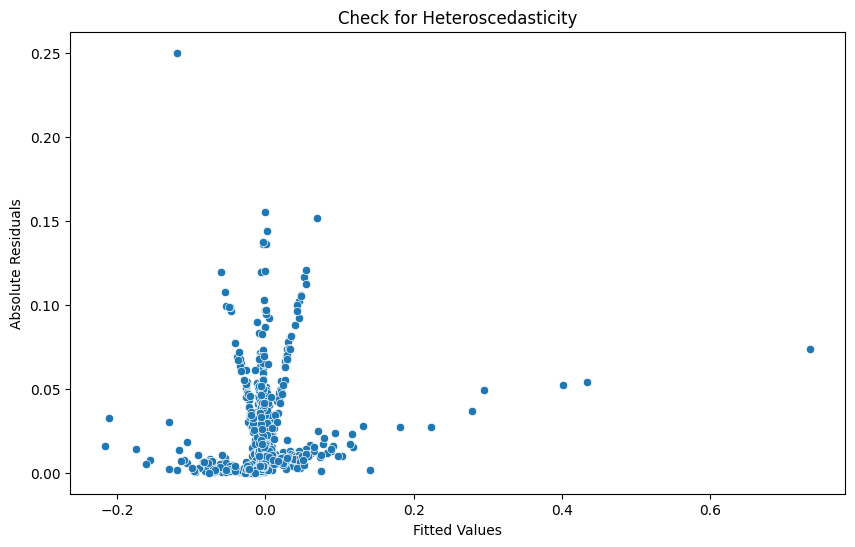

NULS_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.737
Model:                            OLS   Adj. R-squared:                  0.734
Method:                 Least Squares   F-statistic:                     246.9
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.11e-198
Time:                        23:30:36   Log-Likelihood:                 1327.0
No. Observations:                 714   AIC:                            -2636.
Df Residuals:                     705   BIC:                            -2595.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          1.735e

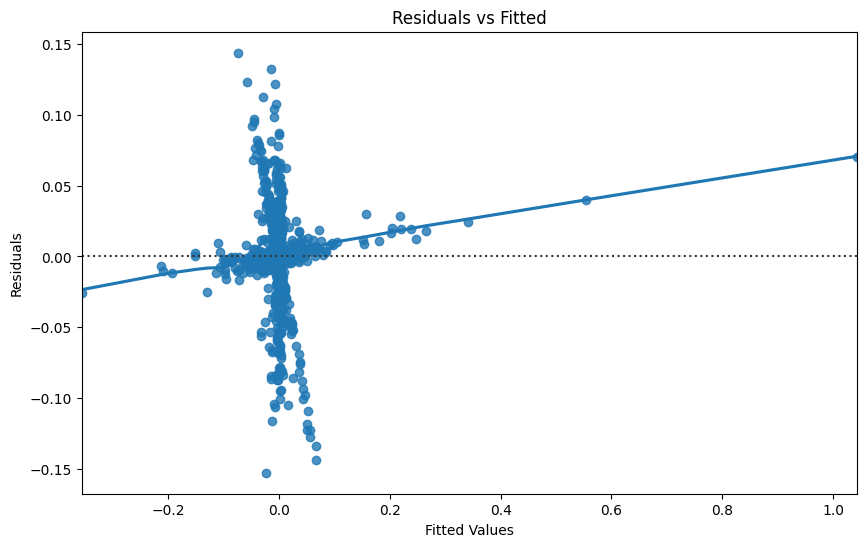

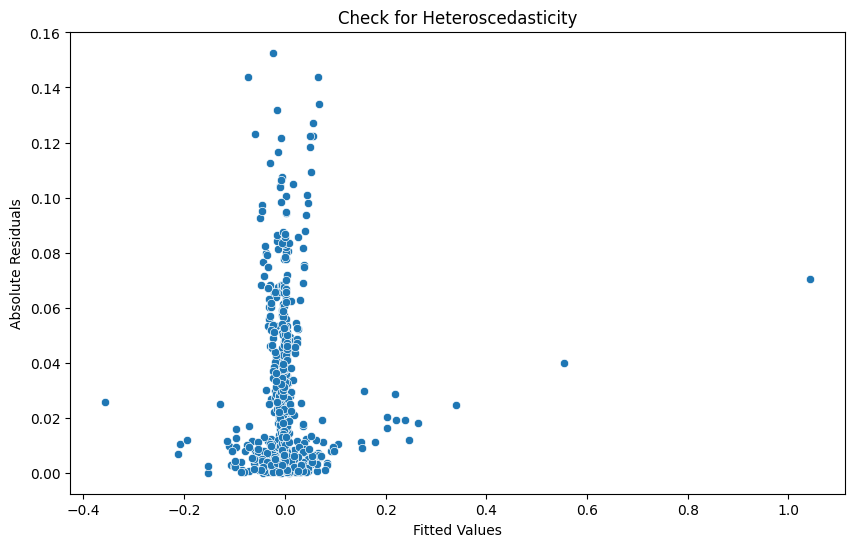

OGN_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.599
Model:                            OLS   Adj. R-squared:                  0.595
Method:                 Least Squares   F-statistic:                     131.8
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.60e-134
Time:                        23:30:37   Log-Likelihood:                 1271.1
No. Observations:                 714   AIC:                            -2524.
Df Residuals:                     705   BIC:                            -2483.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap         -1.995e-

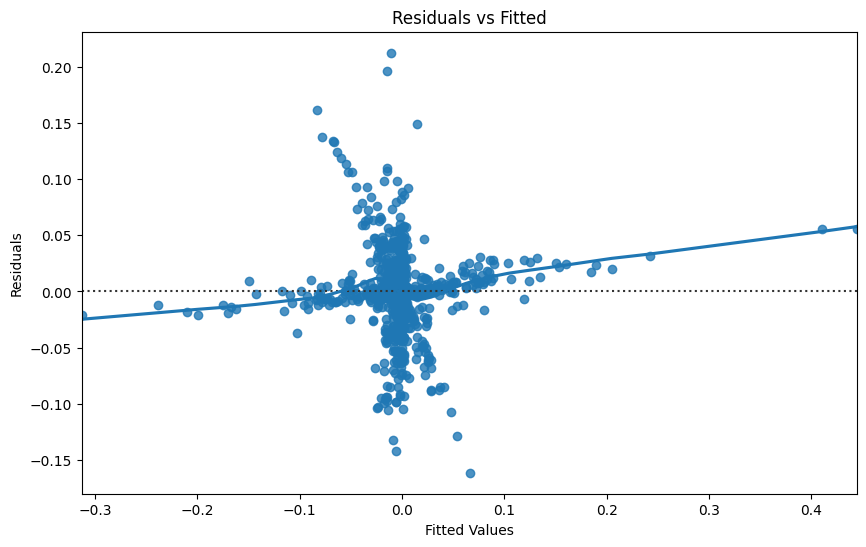

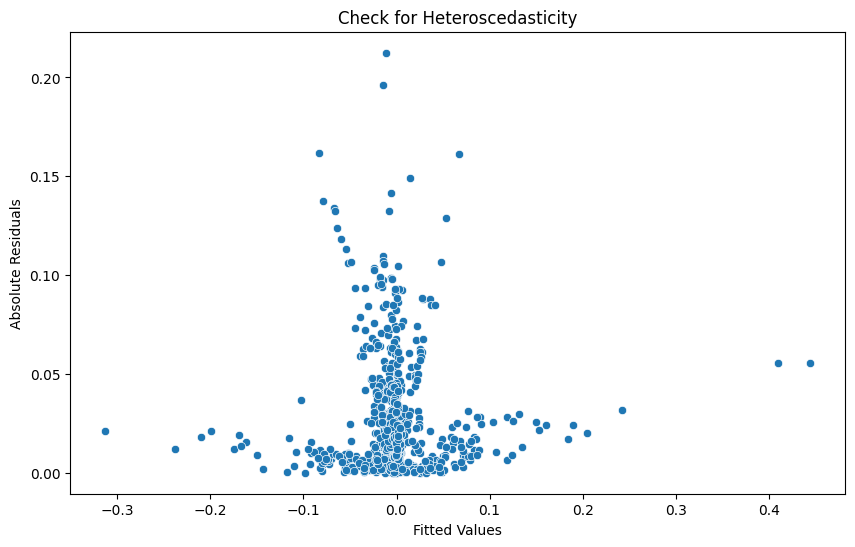

ONE_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.454
Model:                            OLS   Adj. R-squared:                  0.447
Method:                 Least Squares   F-statistic:                     65.11
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           1.21e-86
Time:                        23:30:38   Log-Likelihood:                 1256.2
No. Observations:                 714   AIC:                            -2492.
Df Residuals:                     704   BIC:                            -2447.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.02

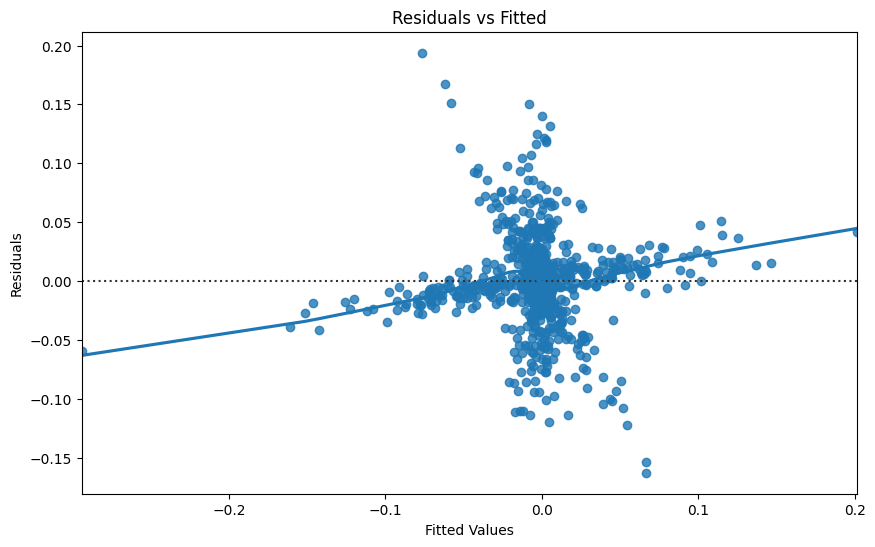

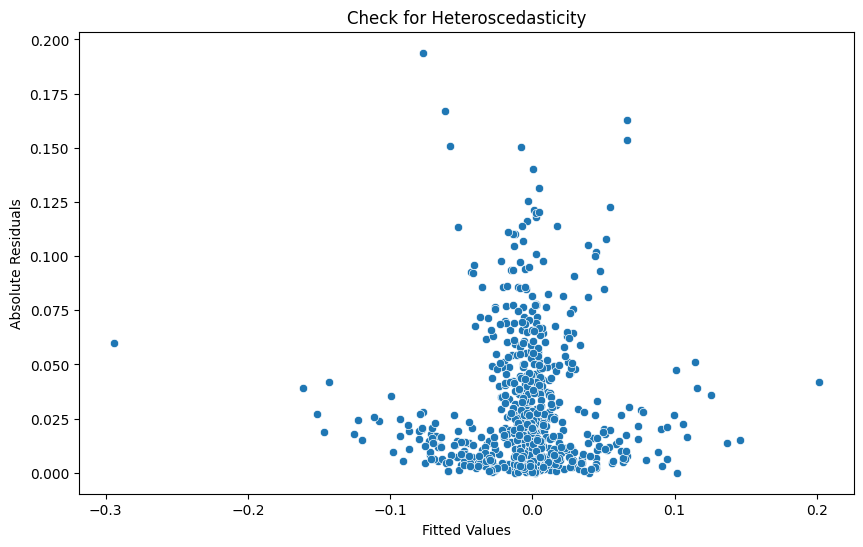

PAXG_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.513
Model:                            OLS   Adj. R-squared:                  0.508
Method:                 Least Squares   F-statistic:                     92.97
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          5.47e-105
Time:                        23:30:39   Log-Likelihood:                 2656.8
No. Observations:                 714   AIC:                            -5296.
Df Residuals:                     705   BIC:                            -5254.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          5.914e

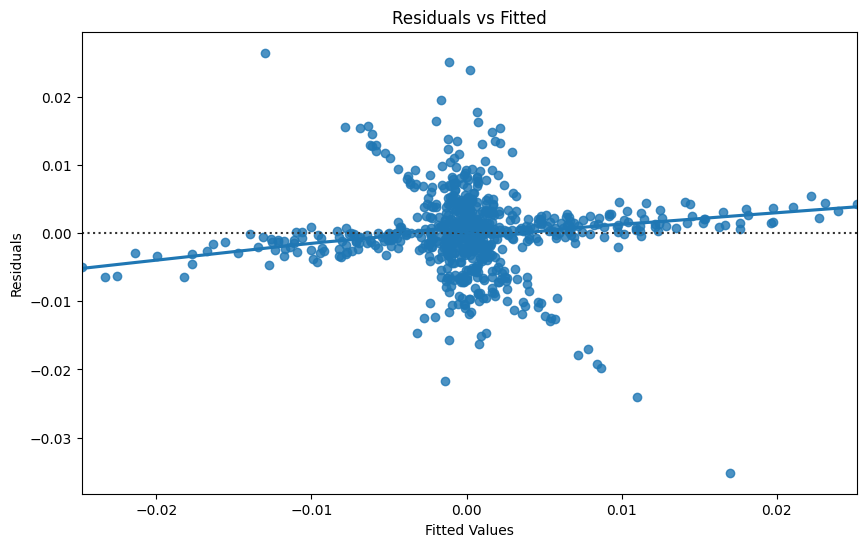

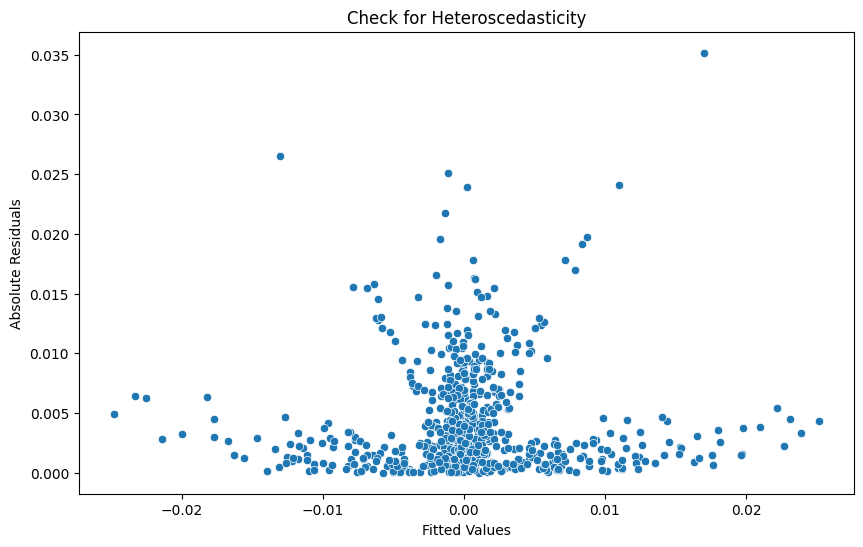

PHA_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.677
Model:                            OLS   Adj. R-squared:                  0.674
Method:                 Least Squares   F-statistic:                     184.9
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.71e-167
Time:                        23:30:40   Log-Likelihood:                 1279.4
No. Observations:                 714   AIC:                            -2541.
Df Residuals:                     705   BIC:                            -2500.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          1.391e-

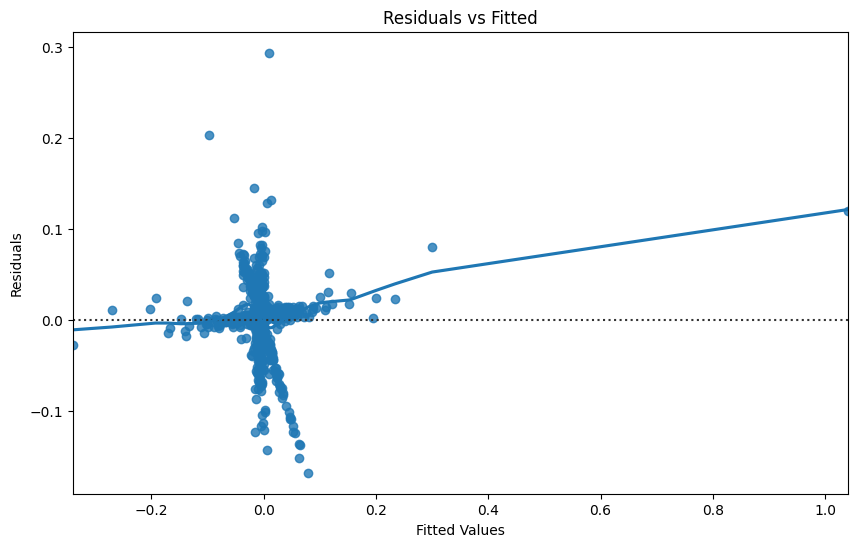

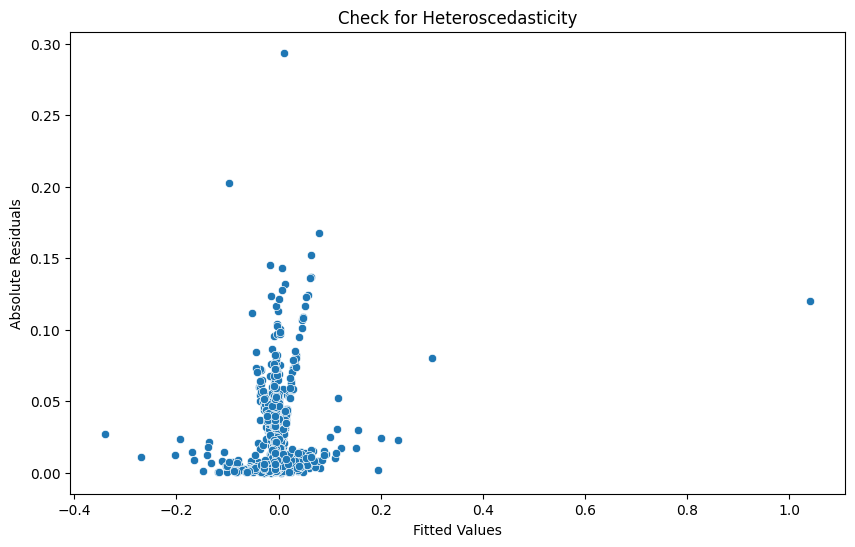

PSG_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.699
Model:                            OLS   Adj. R-squared:                  0.695
Method:                 Least Squares   F-statistic:                     204.2
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          6.74e-178
Time:                        23:30:42   Log-Likelihood:                 1580.0
No. Observations:                 714   AIC:                            -3142.
Df Residuals:                     705   BIC:                            -3101.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          4.688e-

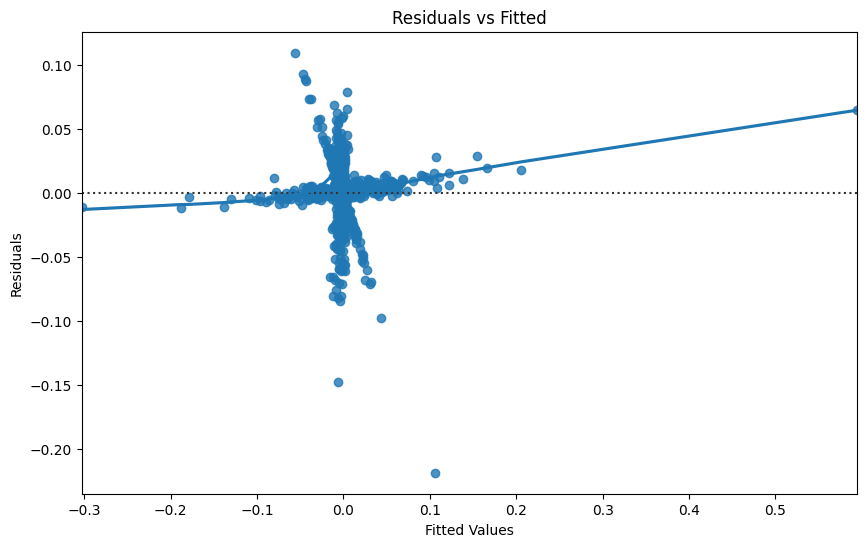

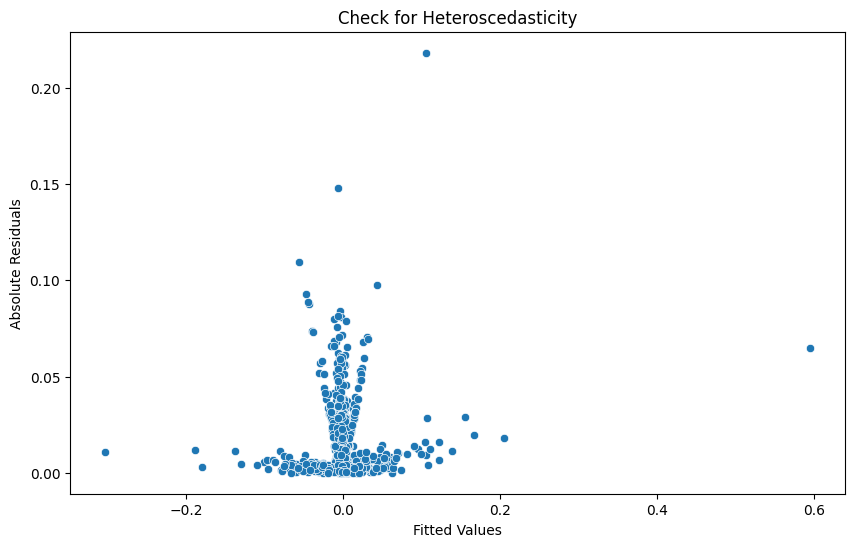

QNT_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.419
Model:                            OLS   Adj. R-squared:                  0.411
Method:                 Least Squares   F-statistic:                     56.37
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           3.80e-77
Time:                        23:30:43   Log-Likelihood:                 1408.5
No. Observations:                 714   AIC:                            -2797.
Df Residuals:                     704   BIC:                            -2751.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

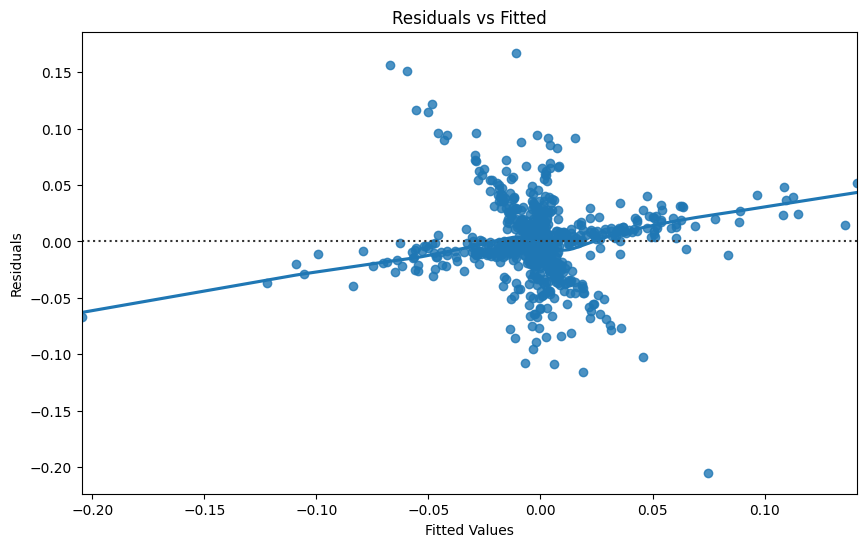

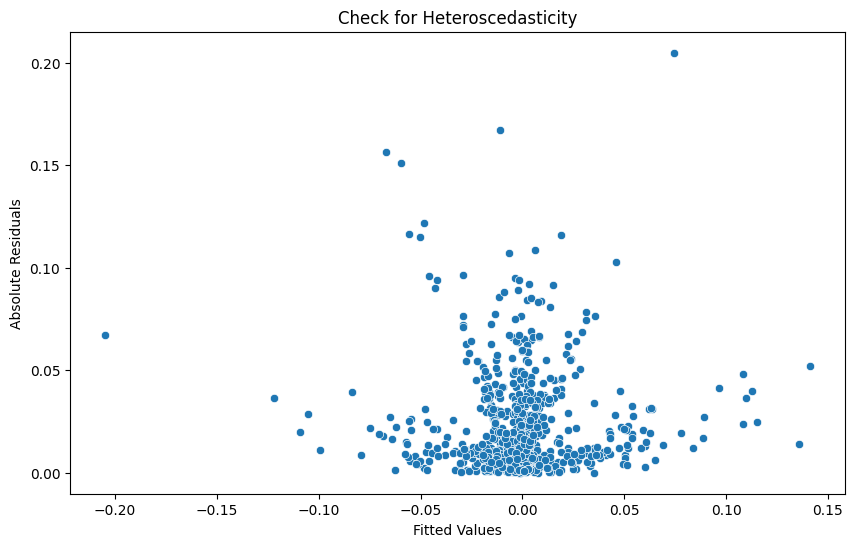

QTUM_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.408
Model:                            OLS   Adj. R-squared:                  0.401
Method:                 Least Squares   F-statistic:                     53.97
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           1.95e-74
Time:                        23:30:44   Log-Likelihood:                 1357.3
No. Observations:                 714   AIC:                            -2695.
Df Residuals:                     704   BIC:                            -2649.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

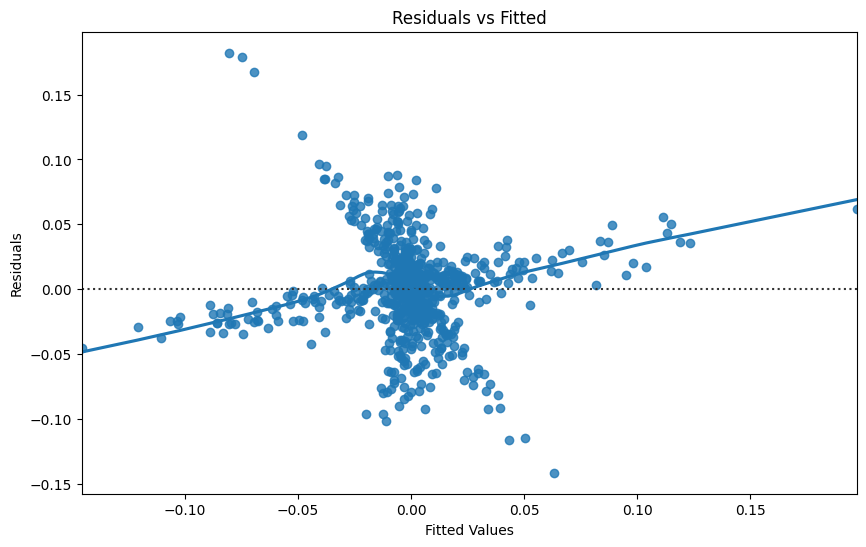

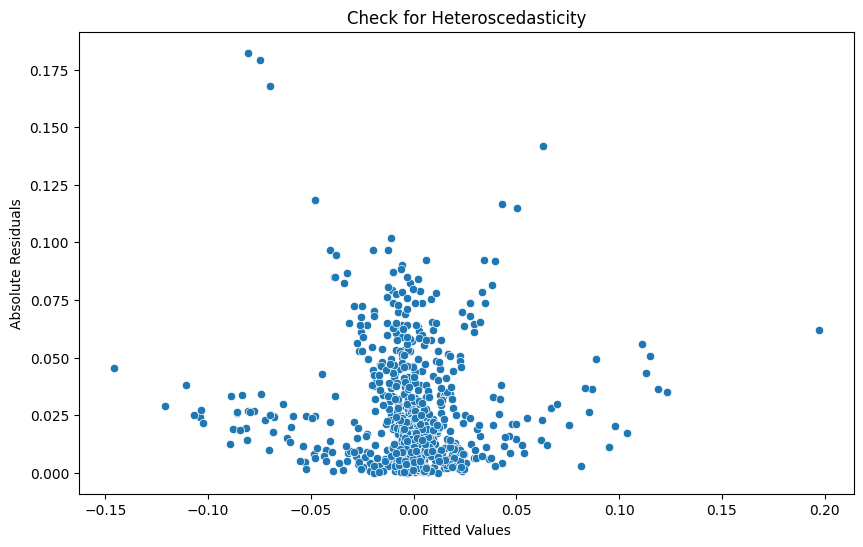

QUICK_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.711
Model:                            OLS   Adj. R-squared:                  0.707
Method:                 Least Squares   F-statistic:                     192.0
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          6.33e-183
Time:                        23:30:45   Log-Likelihood:                 1289.2
No. Observations:                 714   AIC:                            -2558.
Df Residuals:                     704   BIC:                            -2513.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          5.359

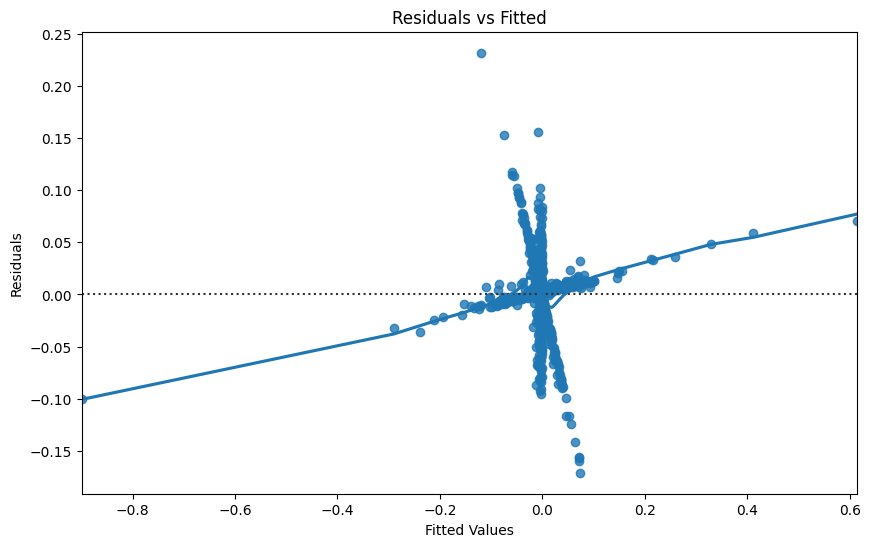

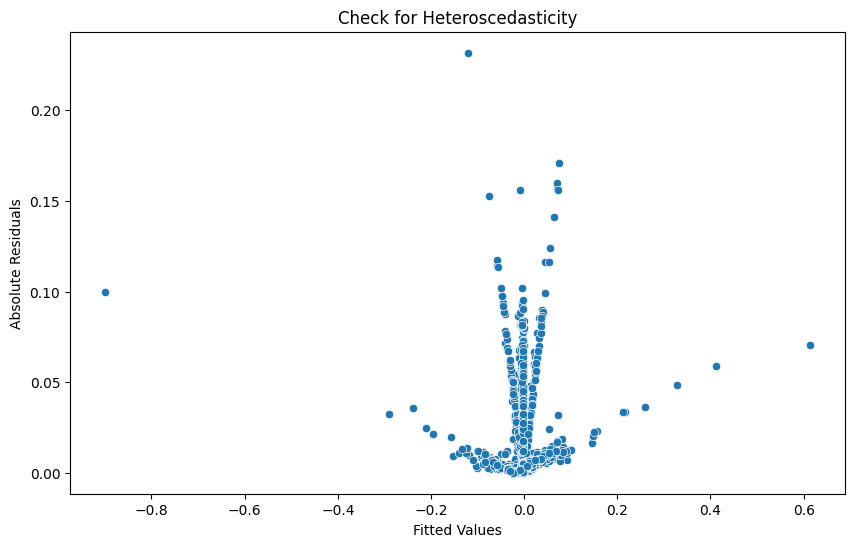

RAD_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.954
Model:                            OLS   Adj. R-squared:                  0.953
Method:                 Least Squares   F-statistic:                     2075.
Date:                Mon, 26 Aug 2024   Prob (F-statistic):               0.00
Time:                        23:30:46   Log-Likelihood:                 2025.7
No. Observations:                 714   AIC:                            -4035.
Df Residuals:                     706   BIC:                            -3999.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.01

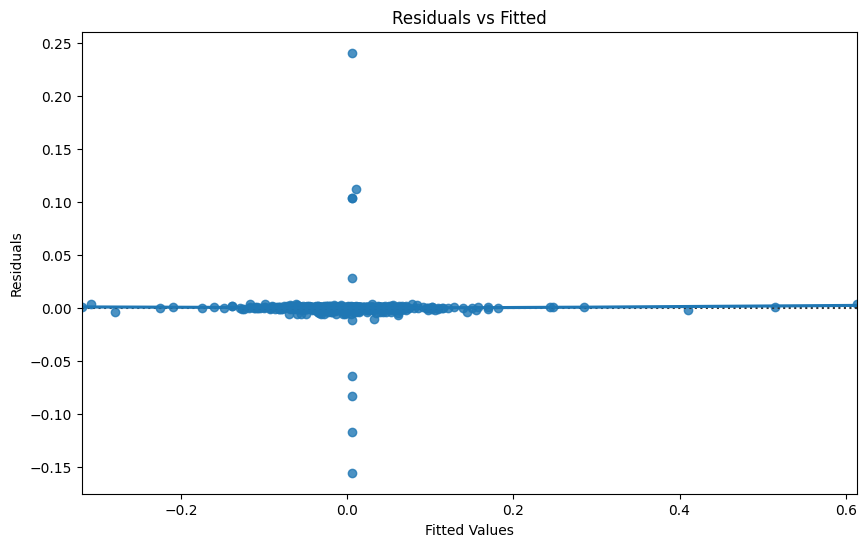

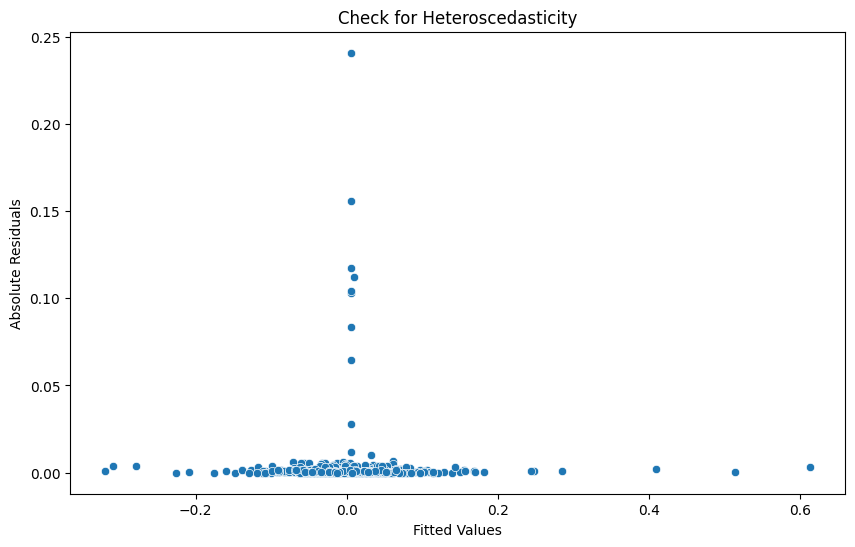

RAY_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.558
Model:                            OLS   Adj. R-squared:                  0.552
Method:                 Least Squares   F-statistic:                     98.76
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.42e-118
Time:                        23:30:47   Log-Likelihood:                 1153.3
No. Observations:                 714   AIC:                            -2287.
Df Residuals:                     704   BIC:                            -2241.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.03

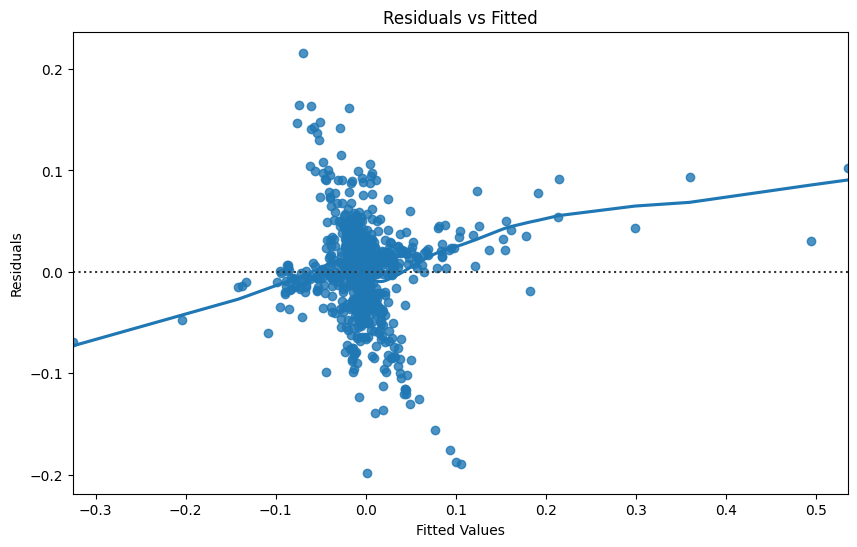

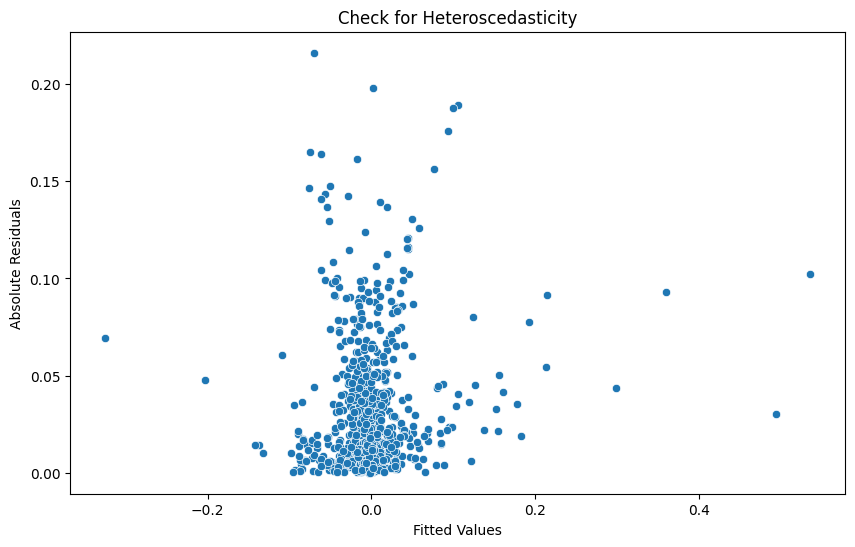

REEF_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.580
Model:                            OLS   Adj. R-squared:                  0.575
Method:                 Least Squares   F-statistic:                     121.5
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          2.98e-127
Time:                        23:30:49   Log-Likelihood:                 1329.8
No. Observations:                 714   AIC:                            -2642.
Df Residuals:                     705   BIC:                            -2600.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap         -2.405e

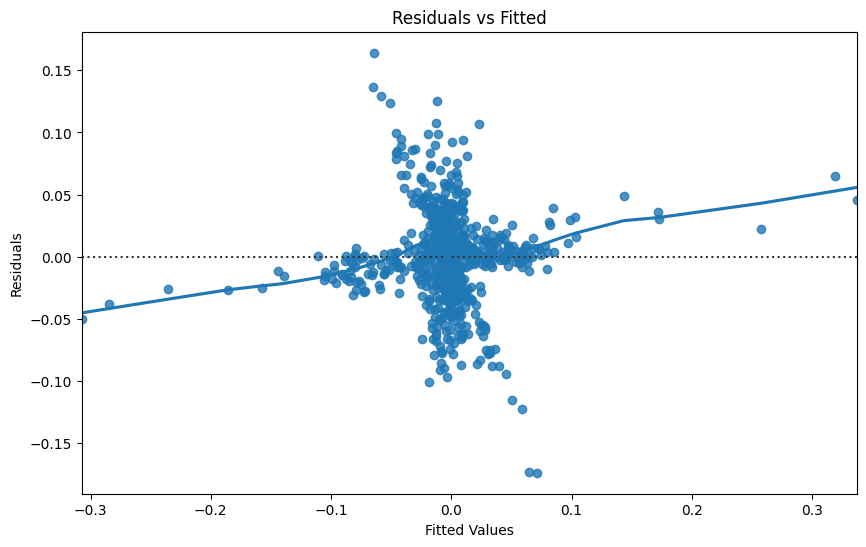

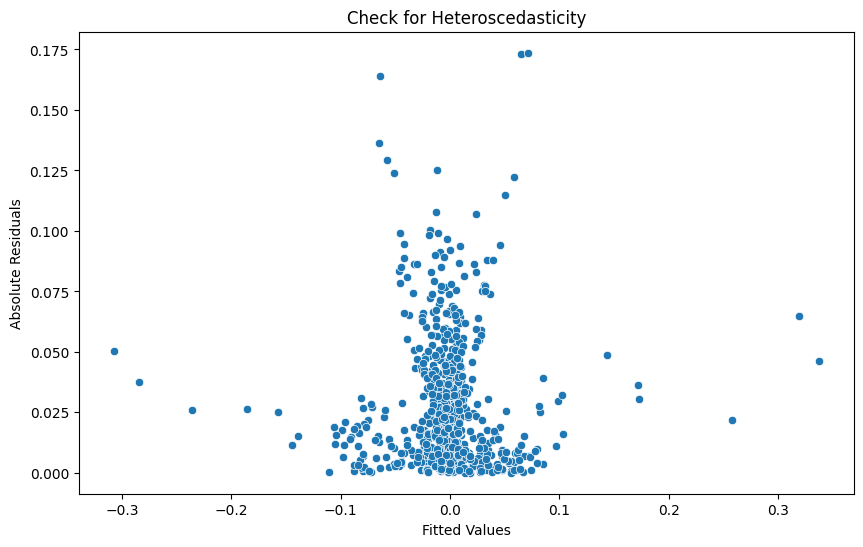

REQ_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.910
Model:                            OLS   Adj. R-squared:                  0.909
Method:                 Least Squares   F-statistic:                     896.5
Date:                Mon, 26 Aug 2024   Prob (F-statistic):               0.00
Time:                        23:30:50   Log-Likelihood:                 1356.9
No. Observations:                 714   AIC:                            -2696.
Df Residuals:                     705   BIC:                            -2655.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap         -5.783e-

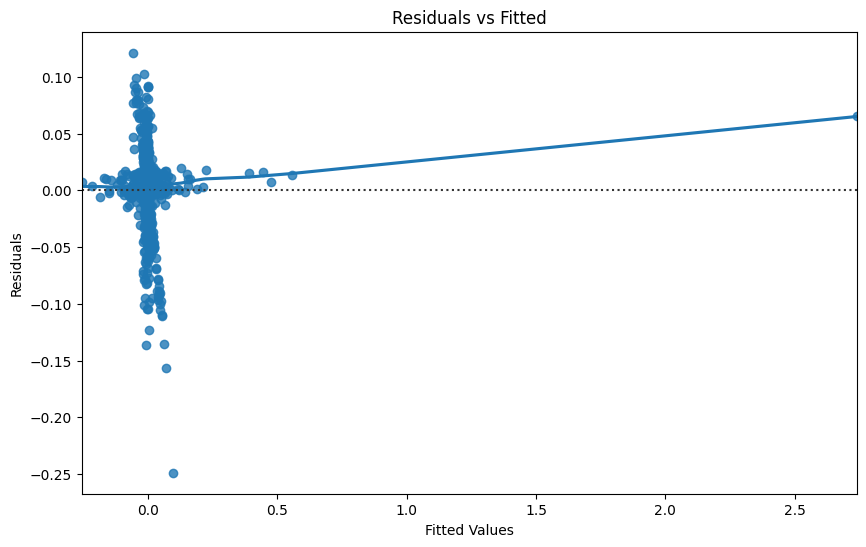

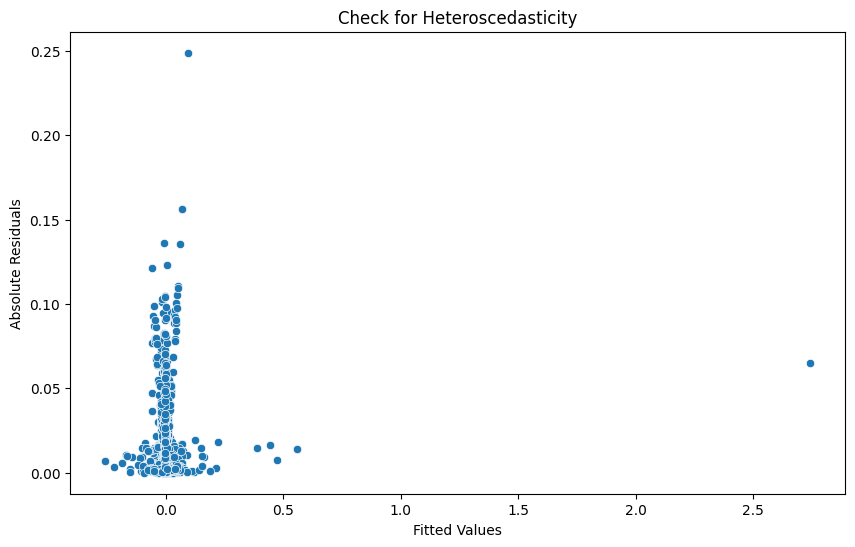

RLC_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.489
Model:                            OLS   Adj. R-squared:                  0.483
Method:                 Least Squares   F-statistic:                     84.35
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           1.40e-97
Time:                        23:30:51   Log-Likelihood:                 1236.6
No. Observations:                 714   AIC:                            -2455.
Df Residuals:                     705   BIC:                            -2414.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap         -1.293e-

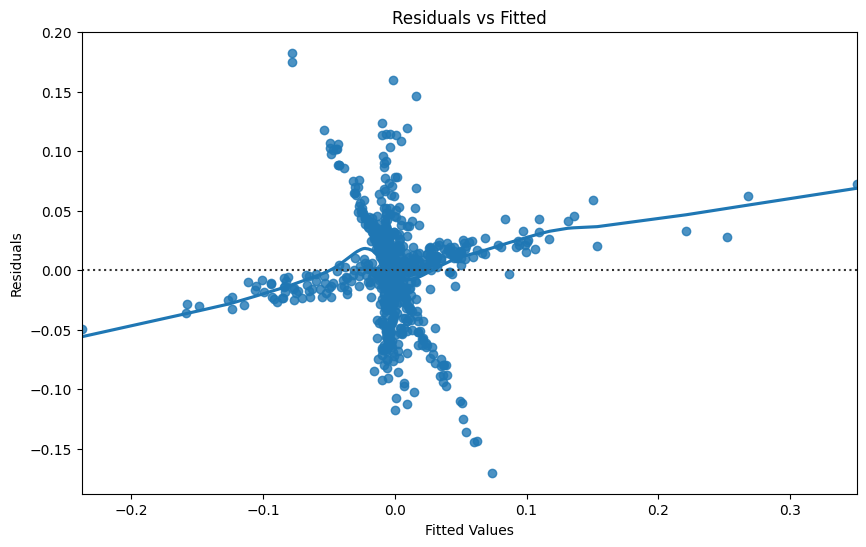

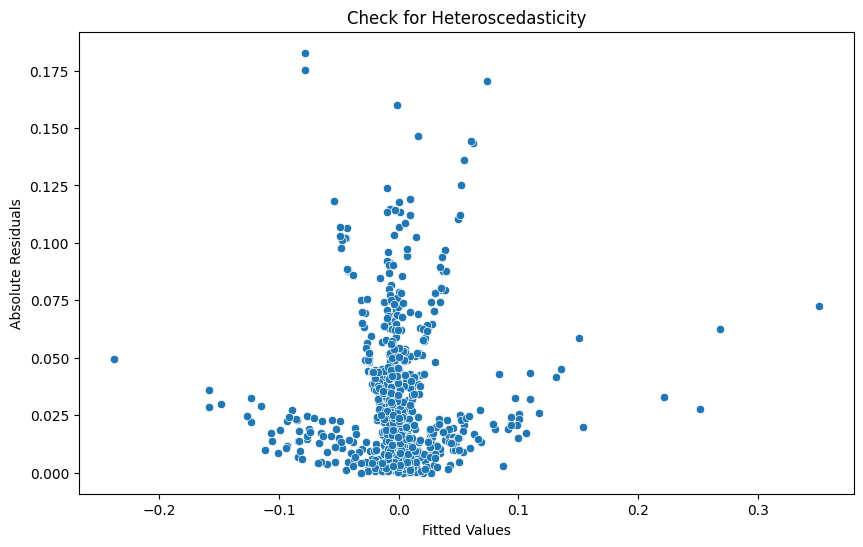

ROSE_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.944
Model:                            OLS   Adj. R-squared:                  0.944
Method:                 Least Squares   F-statistic:                     2004.
Date:                Mon, 26 Aug 2024   Prob (F-statistic):               0.00
Time:                        23:30:52   Log-Likelihood:                 2021.6
No. Observations:                 714   AIC:                            -4029.
Df Residuals:                     707   BIC:                            -3997.
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

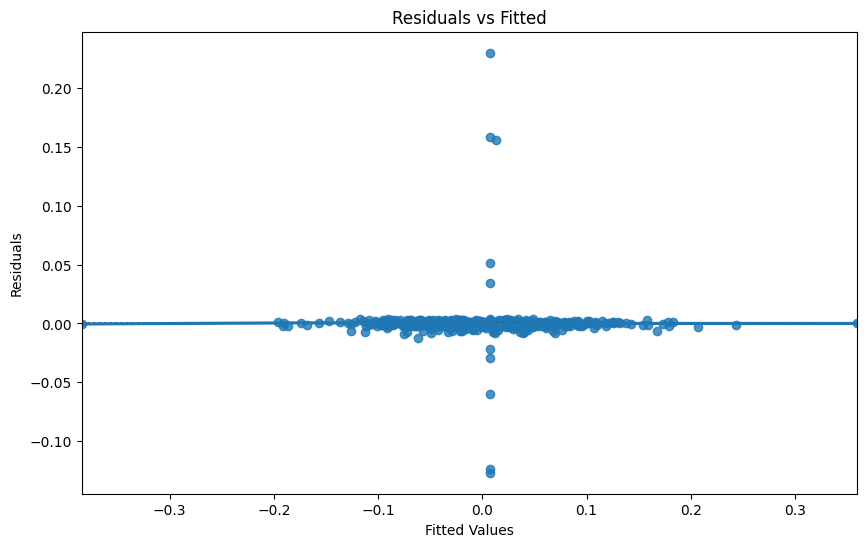

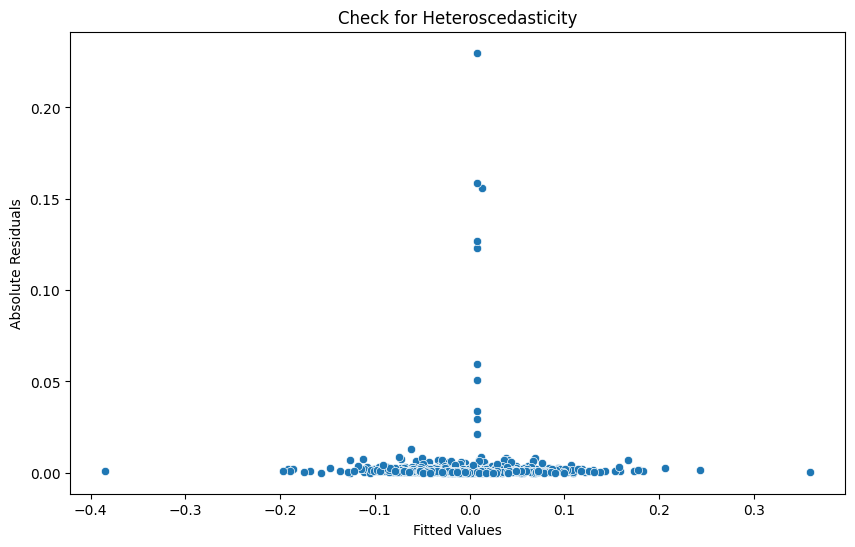

RUNE_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.531
Model:                            OLS   Adj. R-squared:                  0.525
Method:                 Least Squares   F-statistic:                     88.41
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.94e-109
Time:                        23:30:53   Log-Likelihood:                 1185.6
No. Observations:                 714   AIC:                            -2351.
Df Residuals:                     704   BIC:                            -2305.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

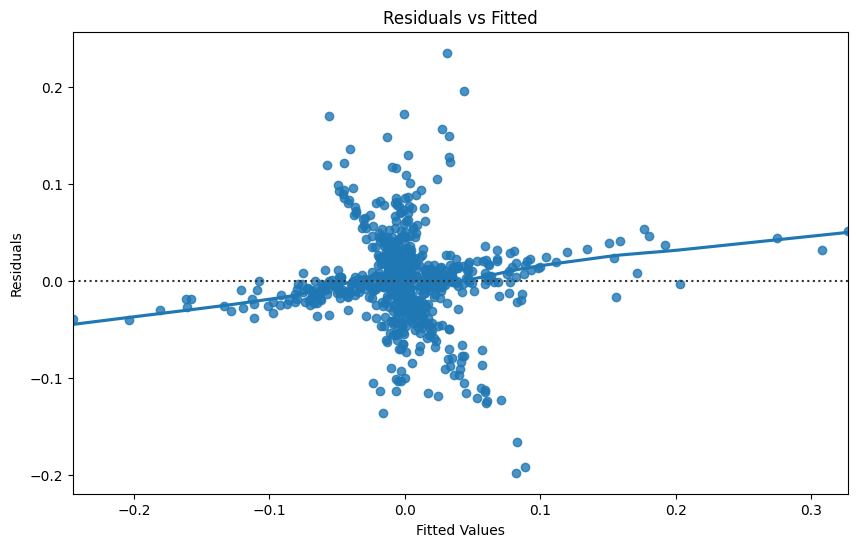

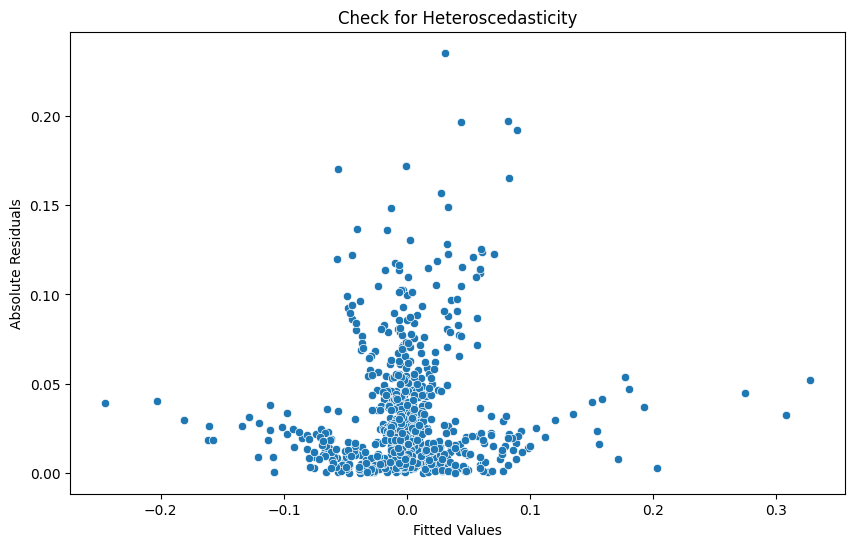

RVN_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.612
Model:                            OLS   Adj. R-squared:                  0.607
Method:                 Least Squares   F-statistic:                     123.5
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.84e-138
Time:                        23:30:54   Log-Likelihood:                 1339.2
No. Observations:                 714   AIC:                            -2658.
Df Residuals:                     704   BIC:                            -2613.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.01

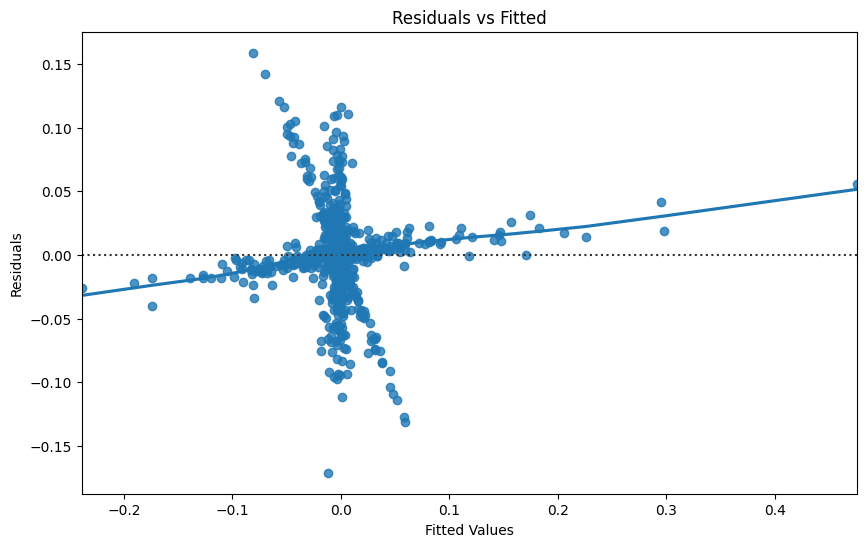

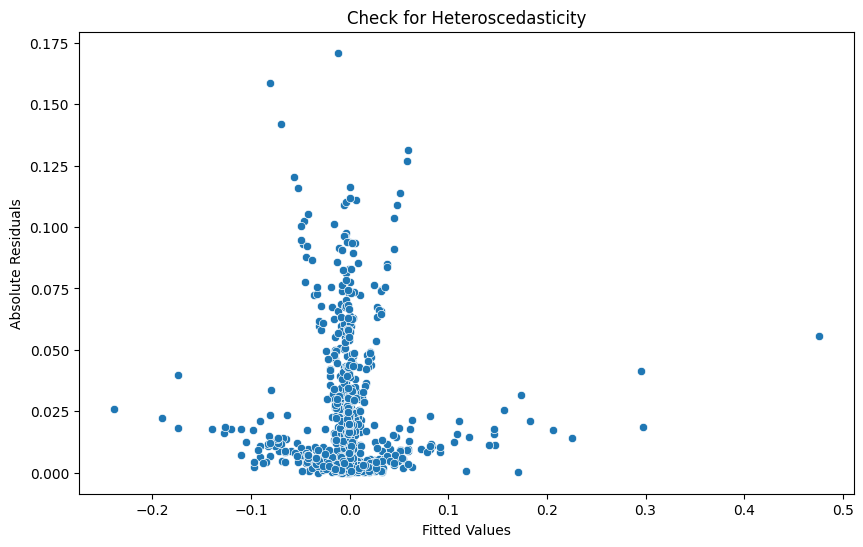

SAND_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.402
Model:                            OLS   Adj. R-squared:                  0.395
Method:                 Least Squares   F-statistic:                     52.69
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           5.68e-73
Time:                        23:30:56   Log-Likelihood:                 1242.3
No. Observations:                 714   AIC:                            -2465.
Df Residuals:                     704   BIC:                            -2419.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

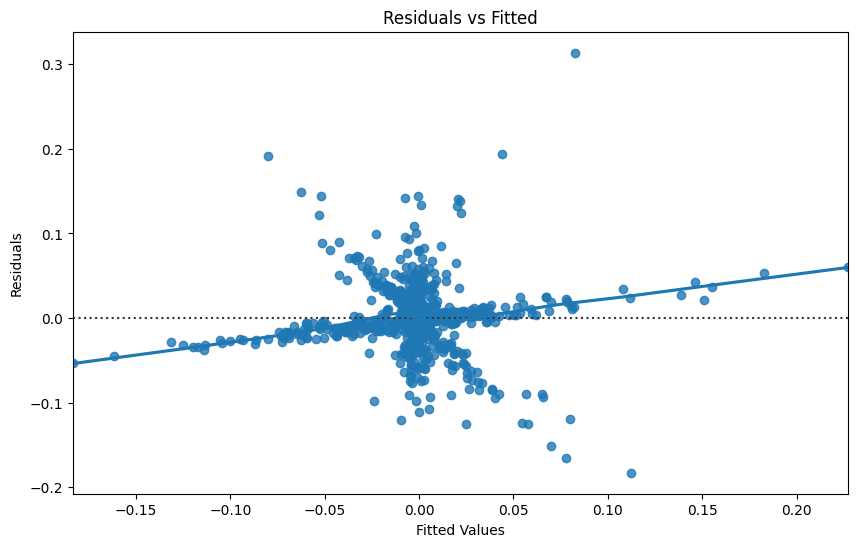

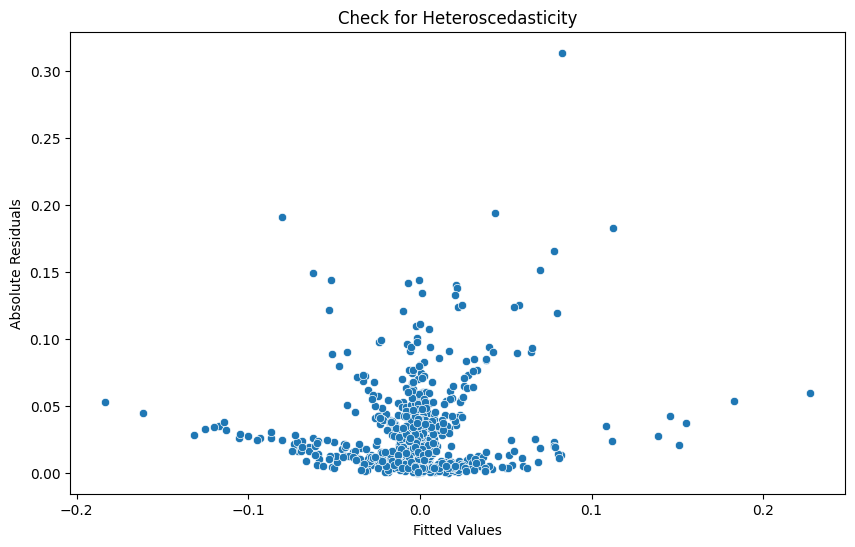

SHIB_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.615
Model:                            OLS   Adj. R-squared:                  0.611
Method:                 Least Squares   F-statistic:                     161.3
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          8.14e-142
Time:                        23:30:57   Log-Likelihood:                 1412.9
No. Observations:                 714   AIC:                            -2810.
Df Residuals:                     706   BIC:                            -2773.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0

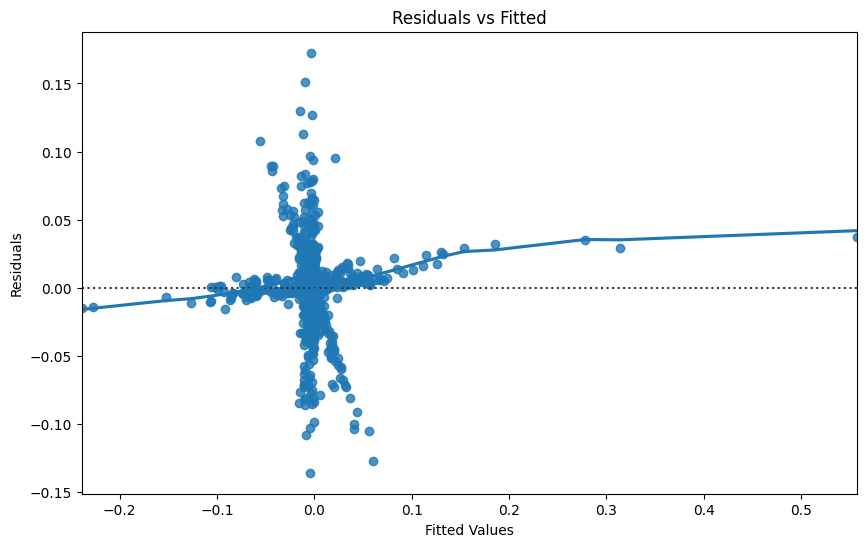

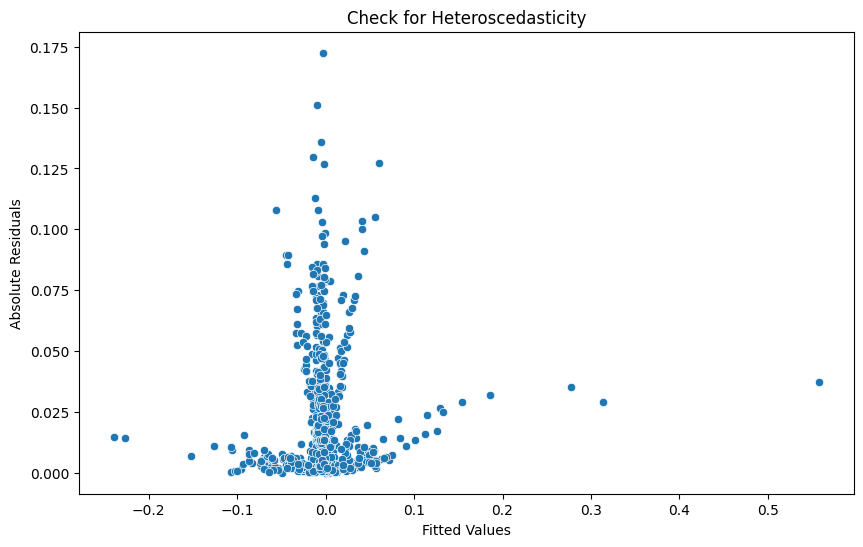

SKL_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.557
Model:                            OLS   Adj. R-squared:                  0.551
Method:                 Least Squares   F-statistic:                     98.33
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          3.34e-118
Time:                        23:30:58   Log-Likelihood:                 1229.3
No. Observations:                 714   AIC:                            -2439.
Df Residuals:                     704   BIC:                            -2393.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.00

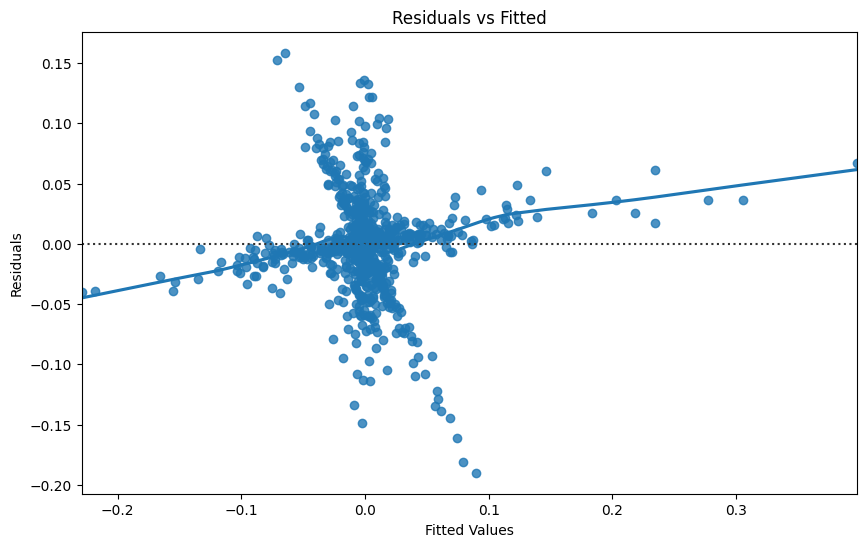

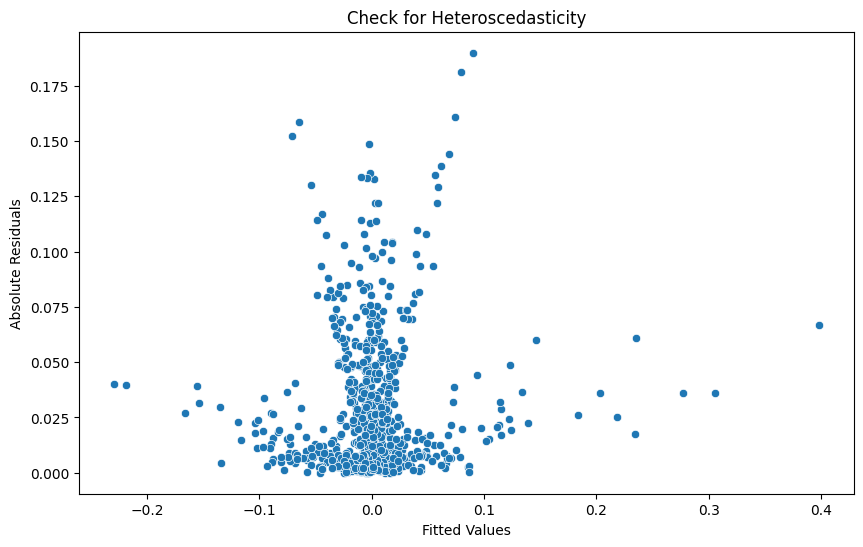

SLP_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.579
Model:                            OLS   Adj. R-squared:                  0.574
Method:                 Least Squares   F-statistic:                     107.8
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          4.07e-126
Time:                        23:31:00   Log-Likelihood:                 1288.1
No. Observations:                 714   AIC:                            -2556.
Df Residuals:                     704   BIC:                            -2511.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.01

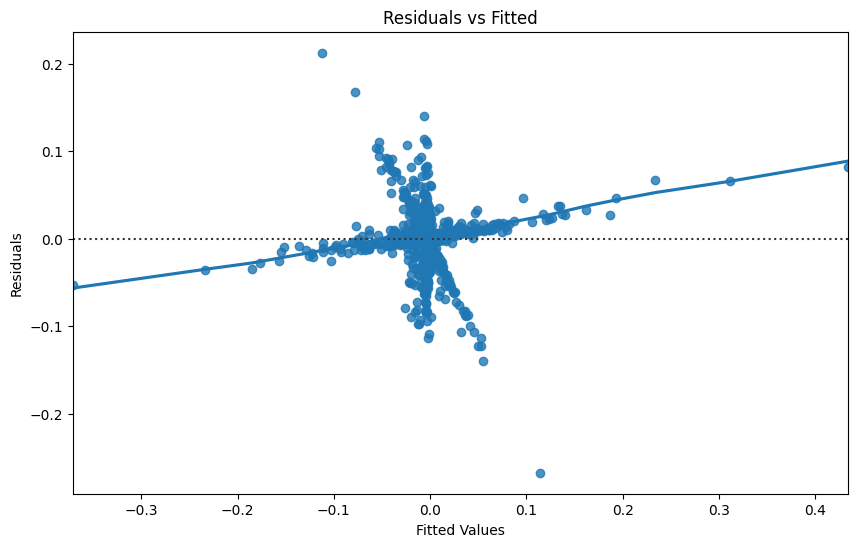

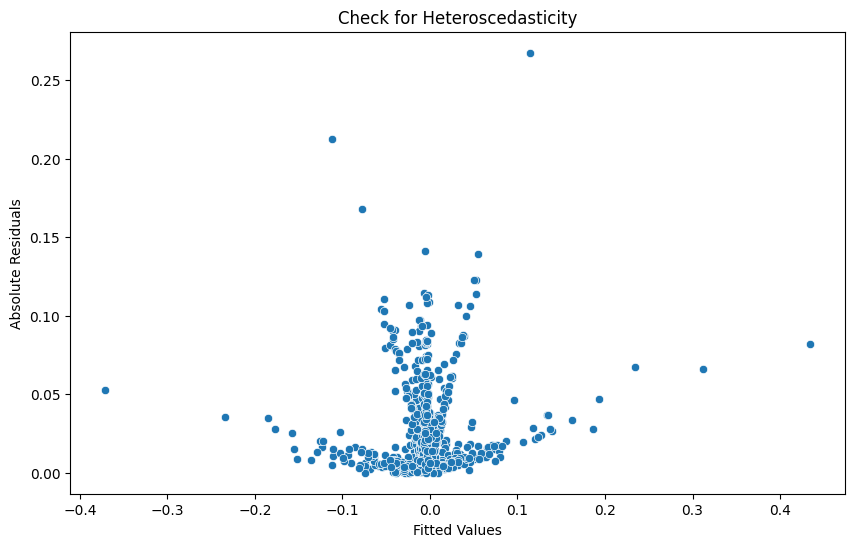

SOL_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.546
Model:                            OLS   Adj. R-squared:                  0.540
Method:                 Least Squares   F-statistic:                     93.97
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          2.06e-114
Time:                        23:31:01   Log-Likelihood:                 1300.8
No. Observations:                 714   AIC:                            -2582.
Df Residuals:                     704   BIC:                            -2536.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

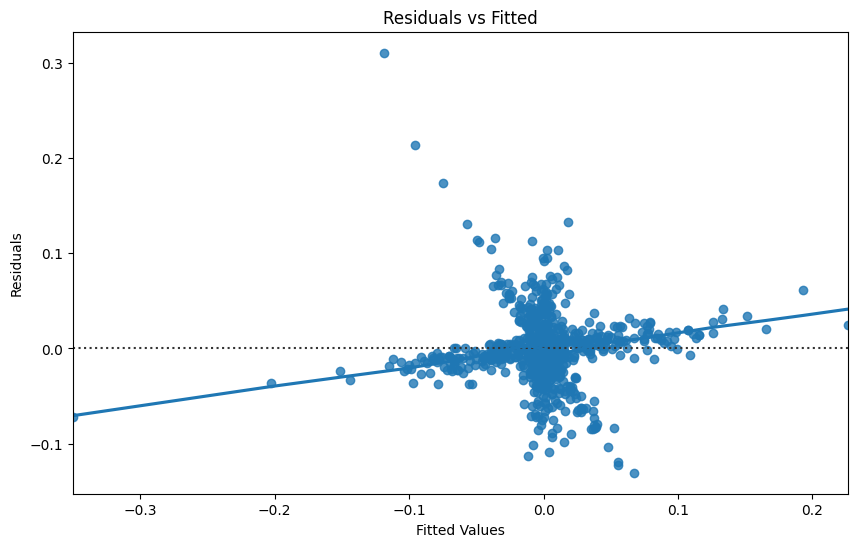

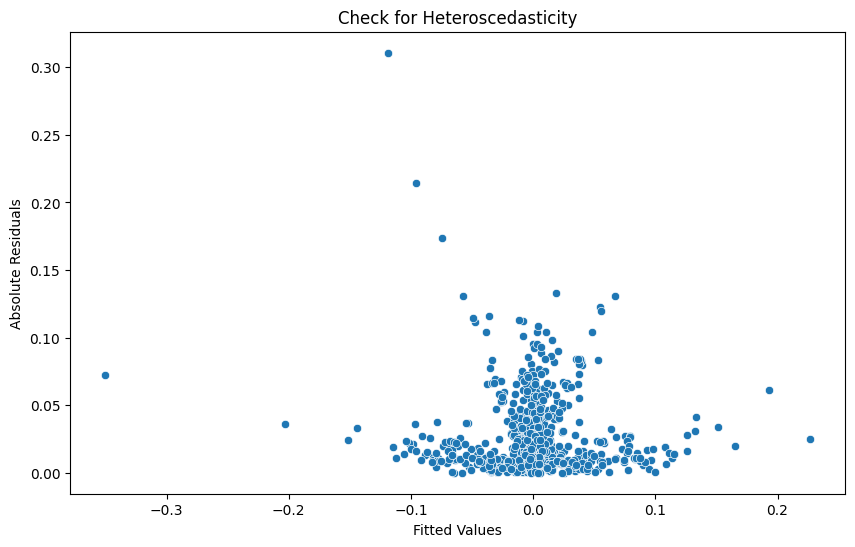

STORJ_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.465
Model:                            OLS   Adj. R-squared:                  0.459
Method:                 Least Squares   F-statistic:                     76.48
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           1.68e-90
Time:                        23:31:03   Log-Likelihood:                 1151.7
No. Observations:                 714   AIC:                            -2285.
Df Residuals:                     705   BIC:                            -2244.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          1.129

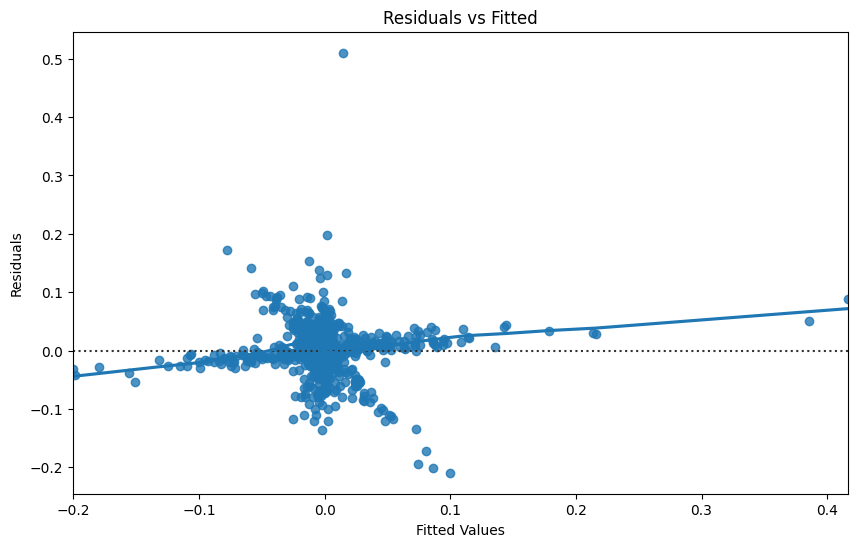

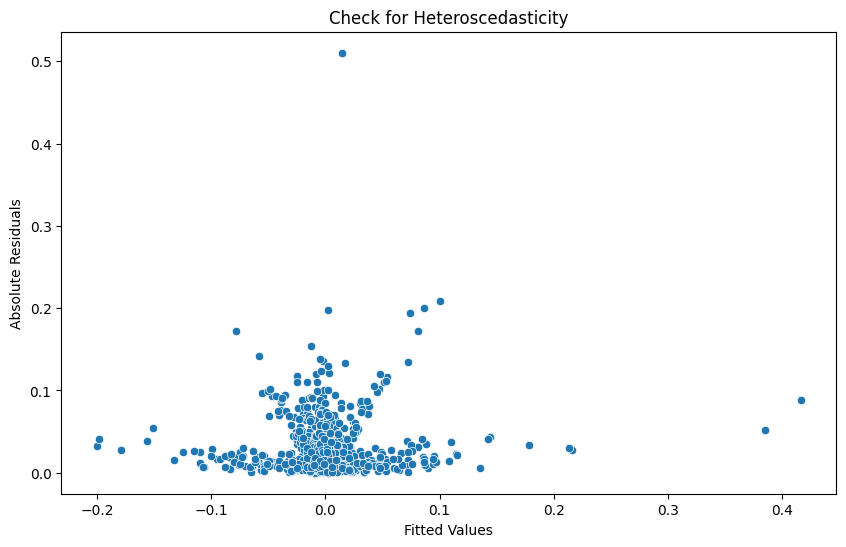

STX_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.551
Model:                            OLS   Adj. R-squared:                  0.546
Method:                 Least Squares   F-statistic:                     108.0
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          4.07e-117
Time:                        23:31:04   Log-Likelihood:                 1227.7
No. Observations:                 714   AIC:                            -2437.
Df Residuals:                     705   BIC:                            -2396.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          3.995e-

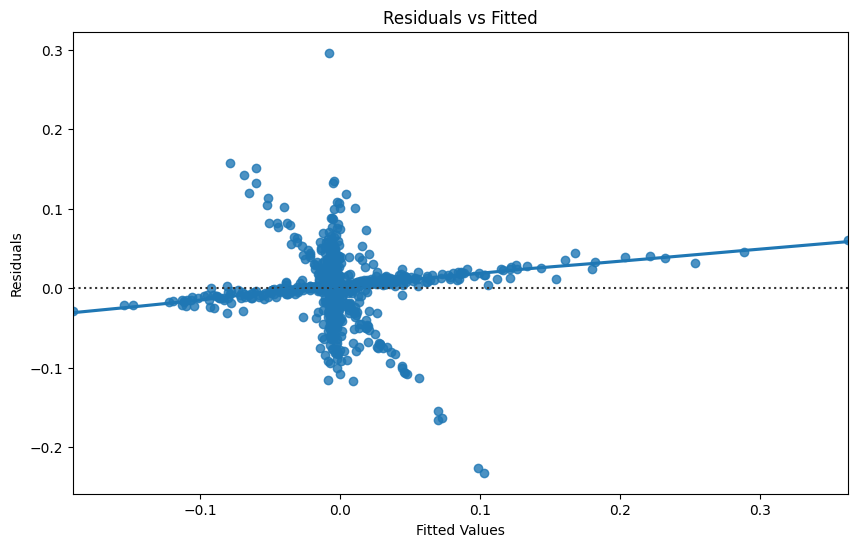

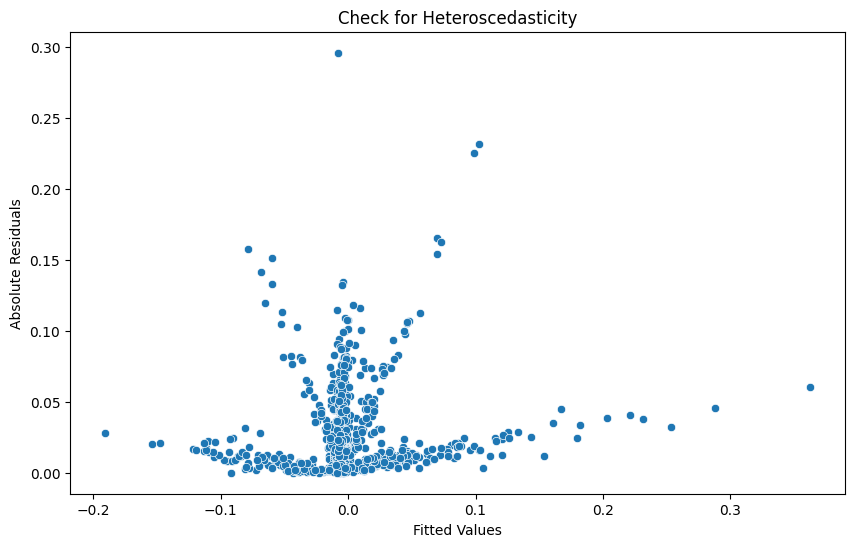

SUSHI_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.511
Model:                            OLS   Adj. R-squared:                  0.505
Method:                 Least Squares   F-statistic:                     81.82
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          2.53e-103
Time:                        23:31:06   Log-Likelihood:                 1225.7
No. Observations:                 714   AIC:                            -2431.
Df Residuals:                     704   BIC:                            -2386.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.

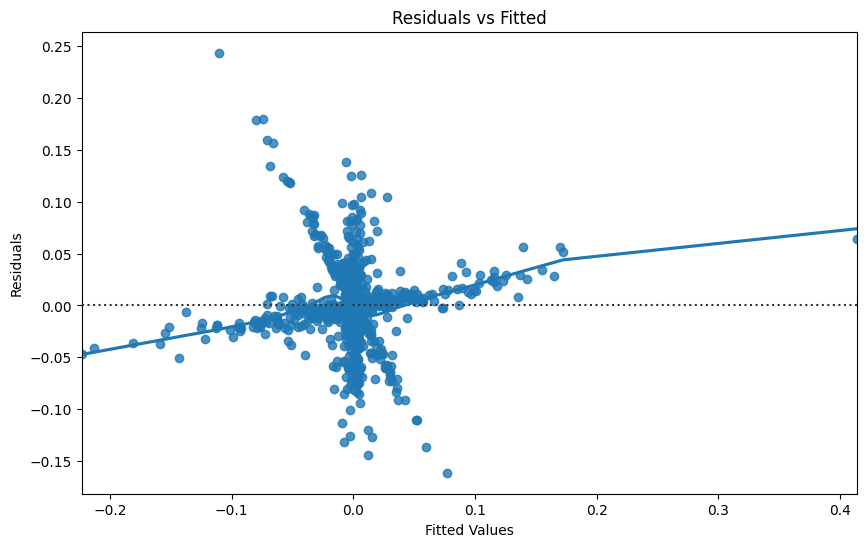

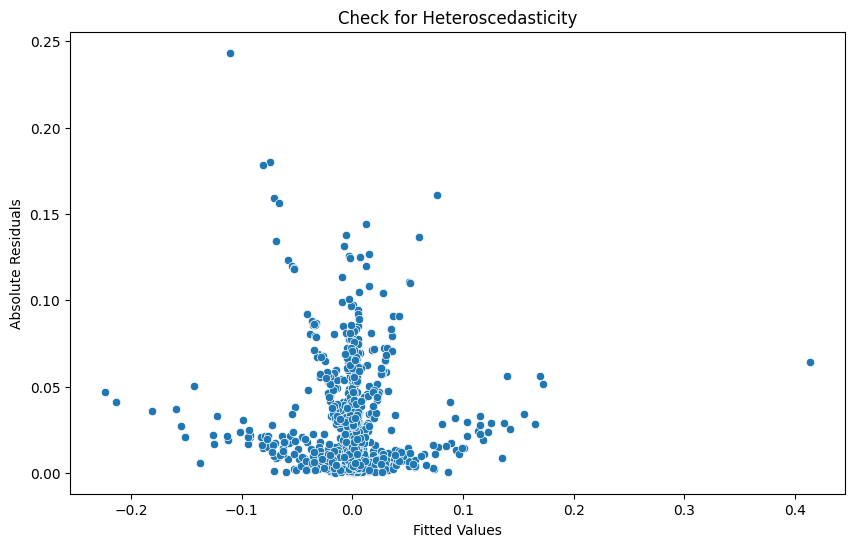

SXP_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.607
Model:                            OLS   Adj. R-squared:                  0.602
Method:                 Least Squares   F-statistic:                     120.7
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          2.55e-136
Time:                        23:31:07   Log-Likelihood:                 1327.9
No. Observations:                 714   AIC:                            -2636.
Df Residuals:                     704   BIC:                            -2590.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

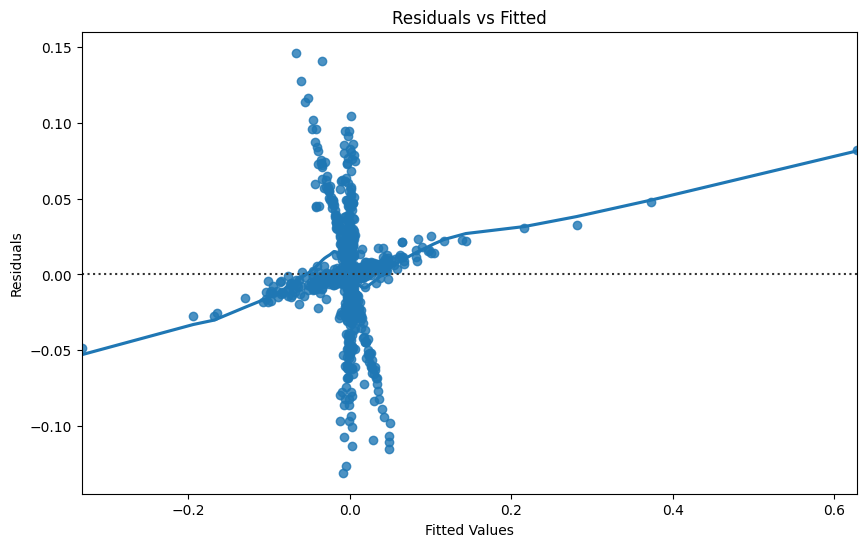

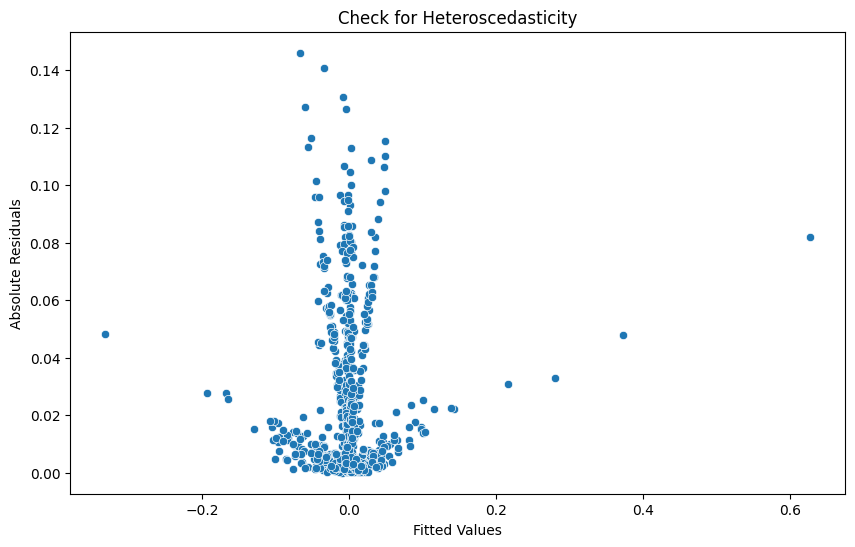

SYS_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.471
Model:                            OLS   Adj. R-squared:                  0.465
Method:                 Least Squares   F-statistic:                     78.39
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           2.98e-92
Time:                        23:31:08   Log-Likelihood:                 1273.1
No. Observations:                 714   AIC:                            -2528.
Df Residuals:                     705   BIC:                            -2487.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          6.037e-

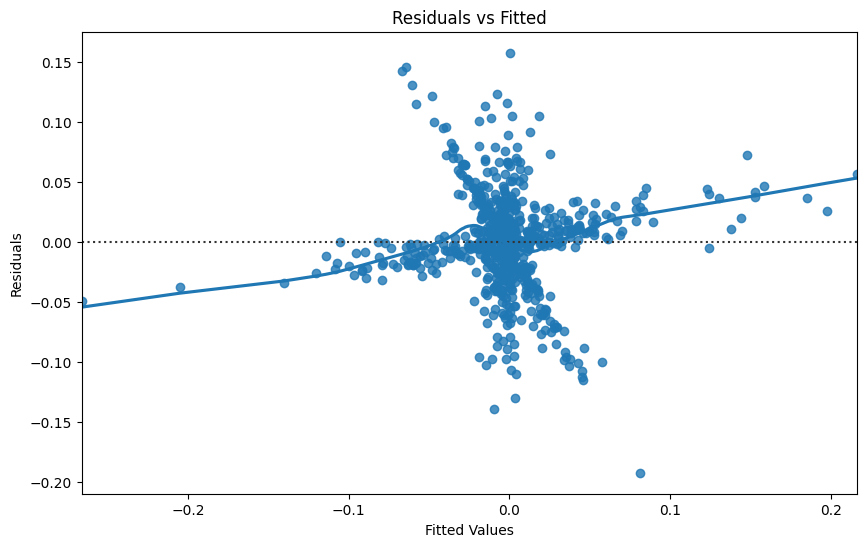

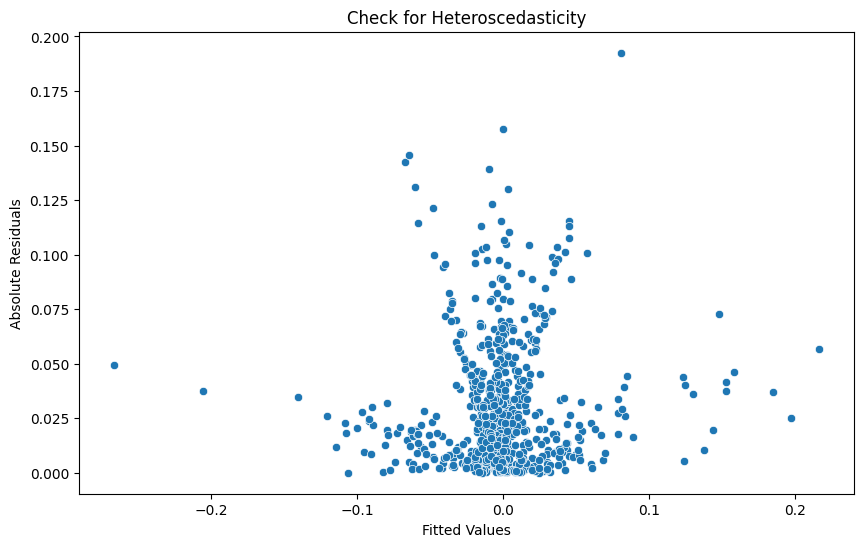

TFUEL_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.477
Model:                            OLS   Adj. R-squared:                  0.471
Method:                 Least Squares   F-statistic:                     71.46
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           3.37e-93
Time:                        23:31:10   Log-Likelihood:                 1330.4
No. Observations:                 714   AIC:                            -2641.
Df Residuals:                     704   BIC:                            -2595.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.

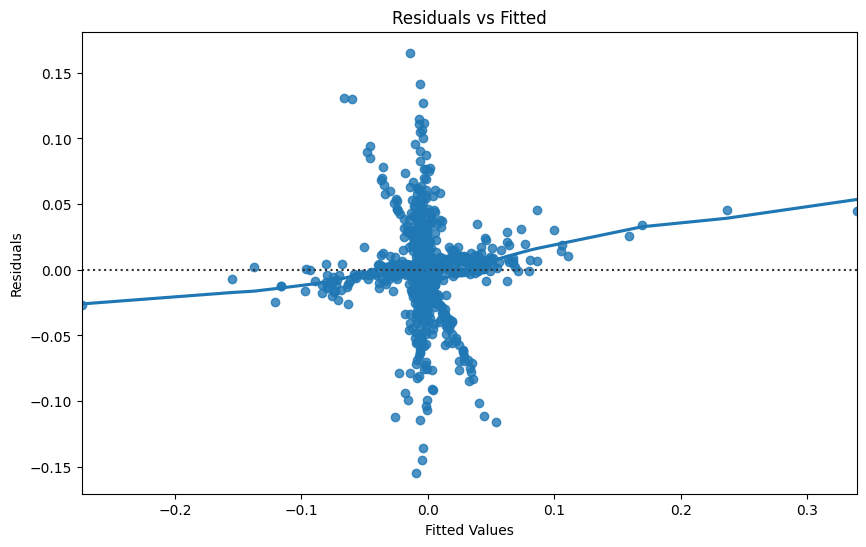

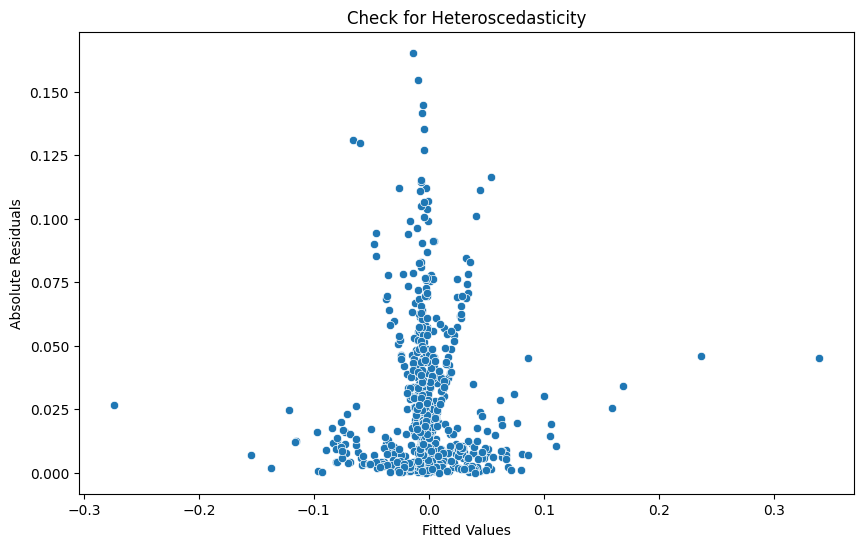

TLM_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.414
Model:                            OLS   Adj. R-squared:                  0.406
Method:                 Least Squares   F-statistic:                     55.23
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           7.28e-76
Time:                        23:31:11   Log-Likelihood:                 1237.3
No. Observations:                 714   AIC:                            -2455.
Df Residuals:                     704   BIC:                            -2409.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

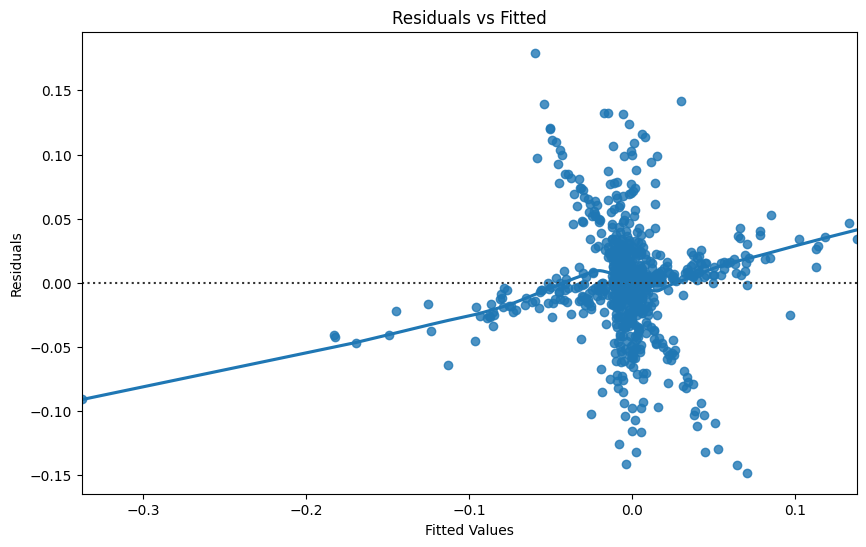

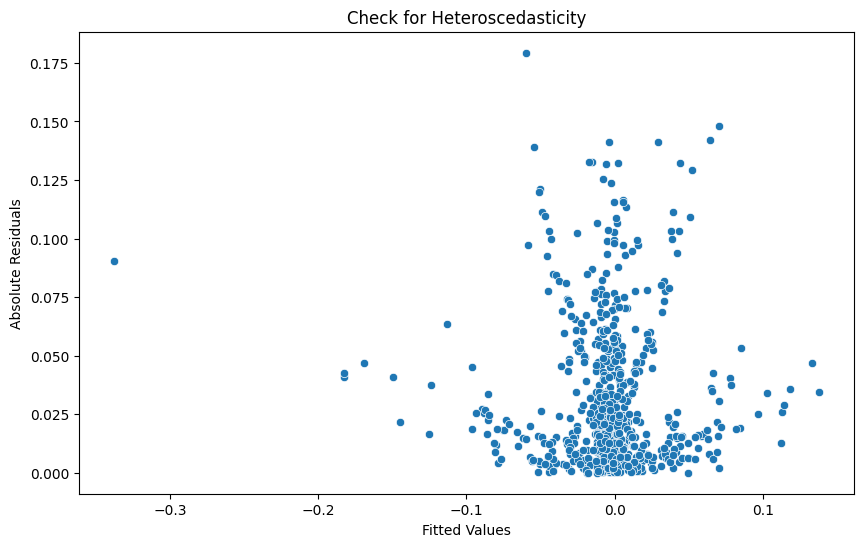

TRB_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.549
Model:                            OLS   Adj. R-squared:                  0.544
Method:                 Least Squares   F-statistic:                     107.2
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.80e-116
Time:                        23:31:12   Log-Likelihood:                 1041.1
No. Observations:                 714   AIC:                            -2064.
Df Residuals:                     705   BIC:                            -2023.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap         -1.581e-

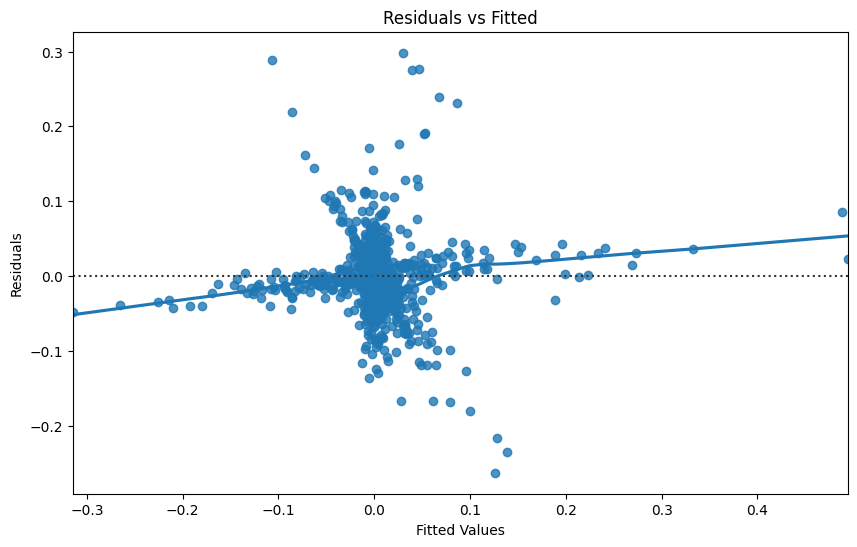

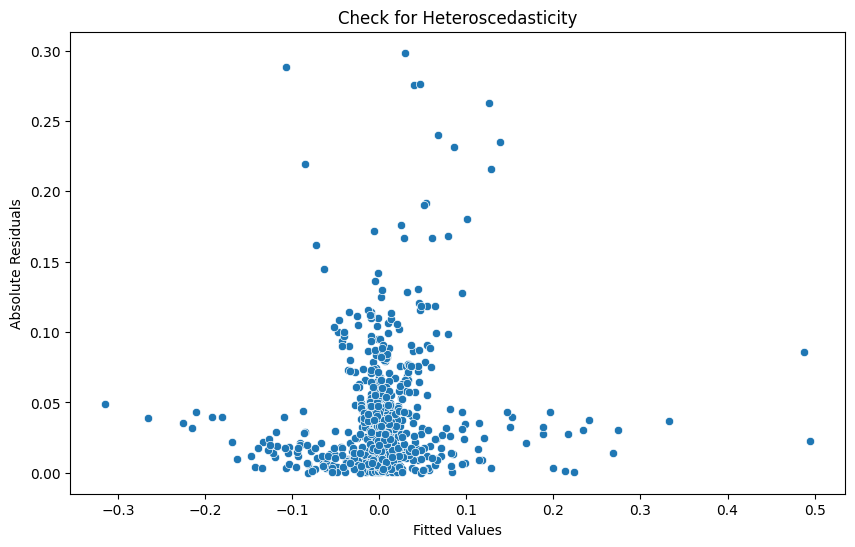

TRU_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.557
Model:                            OLS   Adj. R-squared:                  0.552
Method:                 Least Squares   F-statistic:                     111.0
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          1.99e-119
Time:                        23:31:14   Log-Likelihood:                 1147.2
No. Observations:                 714   AIC:                            -2276.
Df Residuals:                     705   BIC:                            -2235.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          -2.94e-

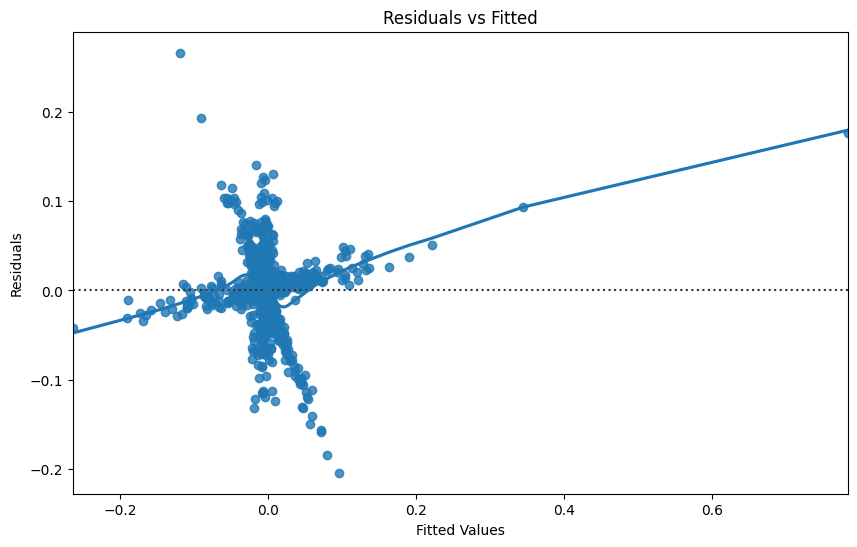

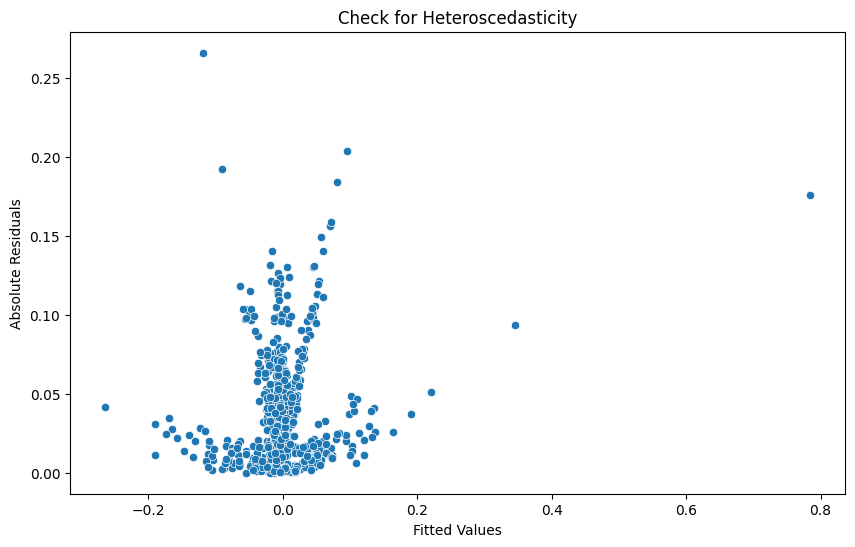

TRX_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.568
Model:                            OLS   Adj. R-squared:                  0.563
Method:                 Least Squares   F-statistic:                     103.0
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          3.61e-122
Time:                        23:31:15   Log-Likelihood:                 1775.2
No. Observations:                 714   AIC:                            -3530.
Df Residuals:                     704   BIC:                            -3485.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

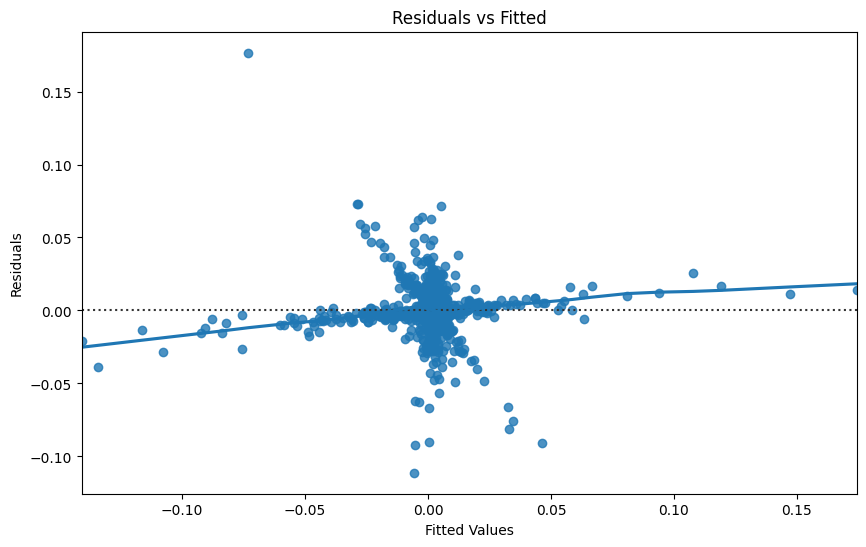

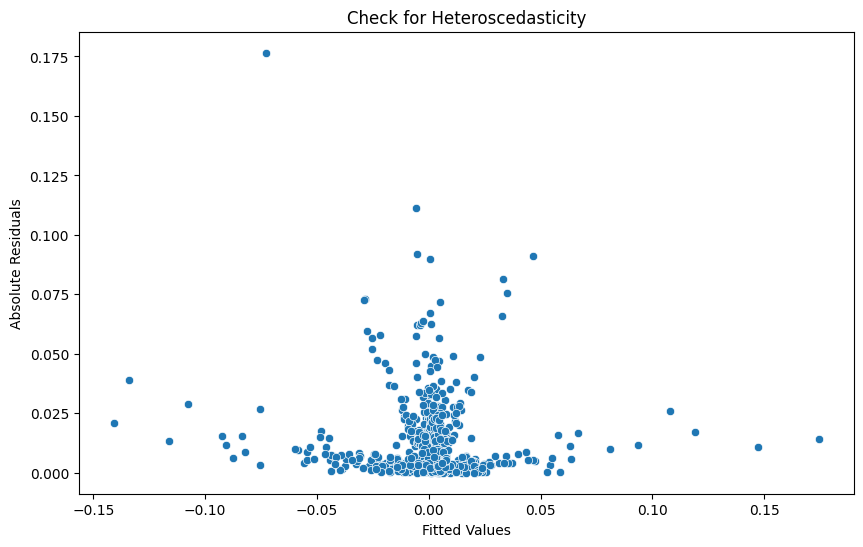

UMA_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.703
Model:                            OLS   Adj. R-squared:                  0.700
Method:                 Least Squares   F-statistic:                     185.6
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          3.02e-179
Time:                        23:31:16   Log-Likelihood:                 1273.9
No. Observations:                 714   AIC:                            -2528.
Df Residuals:                     704   BIC:                            -2482.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.03

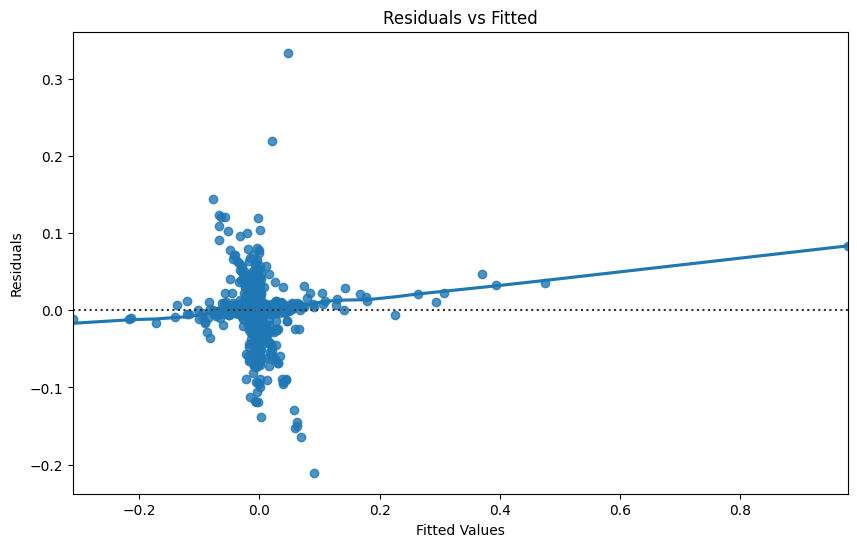

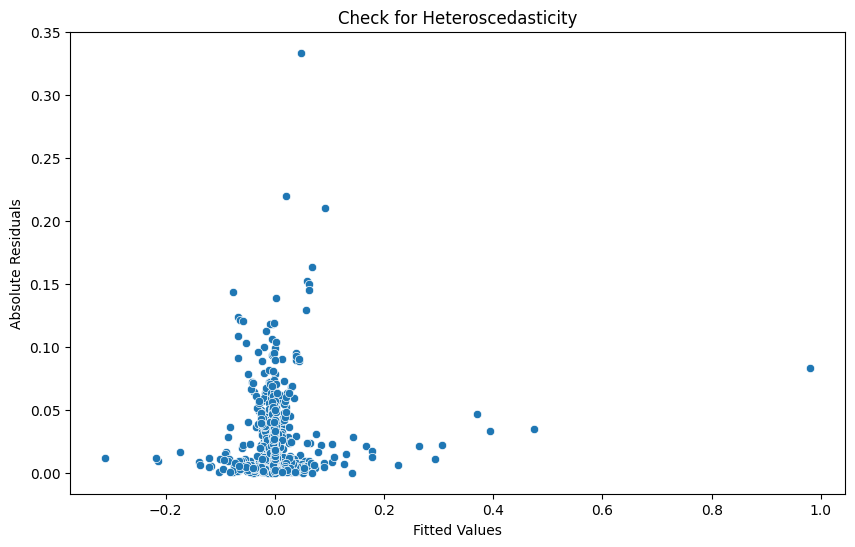

UNI_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.545
Model:                            OLS   Adj. R-squared:                  0.539
Method:                 Least Squares   F-statistic:                     93.61
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          4.30e-114
Time:                        23:31:18   Log-Likelihood:                 1329.8
No. Observations:                 714   AIC:                            -2640.
Df Residuals:                     704   BIC:                            -2594.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

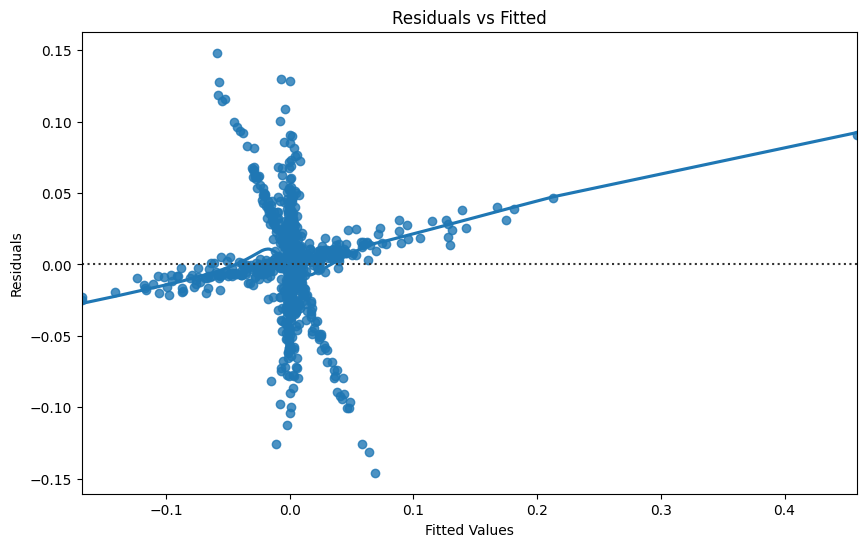

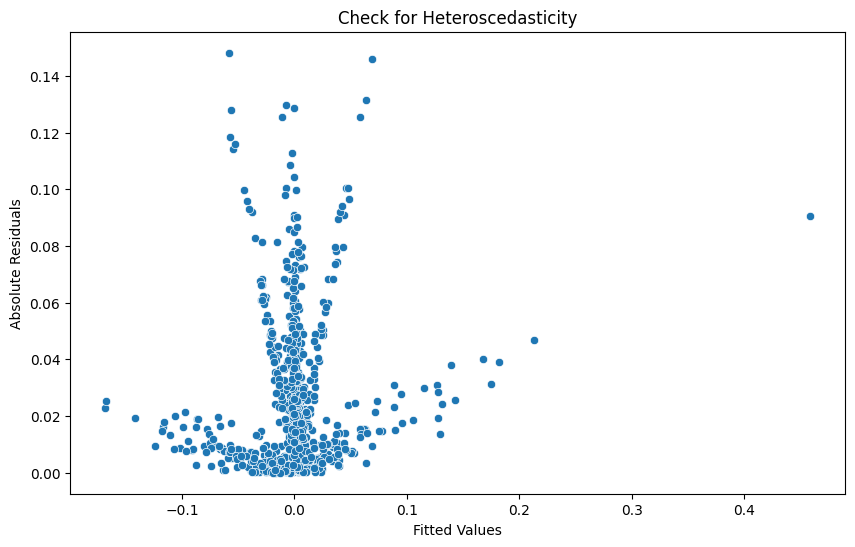

VET_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.539
Model:                            OLS   Adj. R-squared:                  0.533
Method:                 Least Squares   F-statistic:                     91.30
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          4.79e-112
Time:                        23:31:19   Log-Likelihood:                 1442.6
No. Observations:                 714   AIC:                            -2865.
Df Residuals:                     704   BIC:                            -2819.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.02

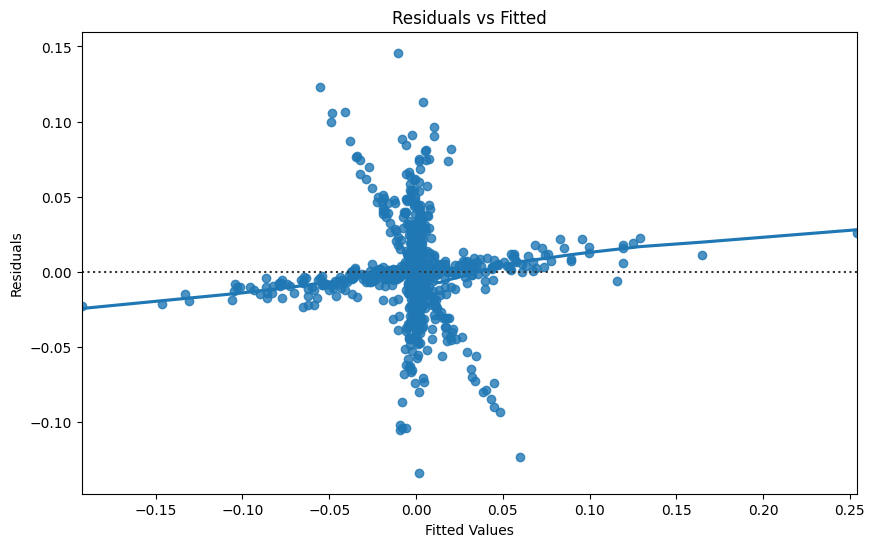

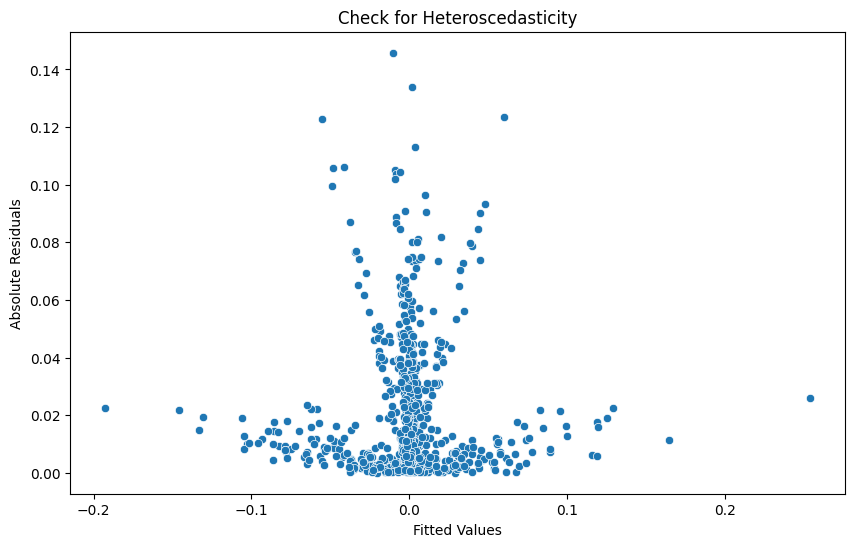

WAXP_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.499
Model:                            OLS   Adj. R-squared:                  0.493
Method:                 Least Squares   F-statistic:                     77.95
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           1.29e-99
Time:                        23:31:20   Log-Likelihood:                 1330.2
No. Observations:                 714   AIC:                            -2640.
Df Residuals:                     704   BIC:                            -2595.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.0

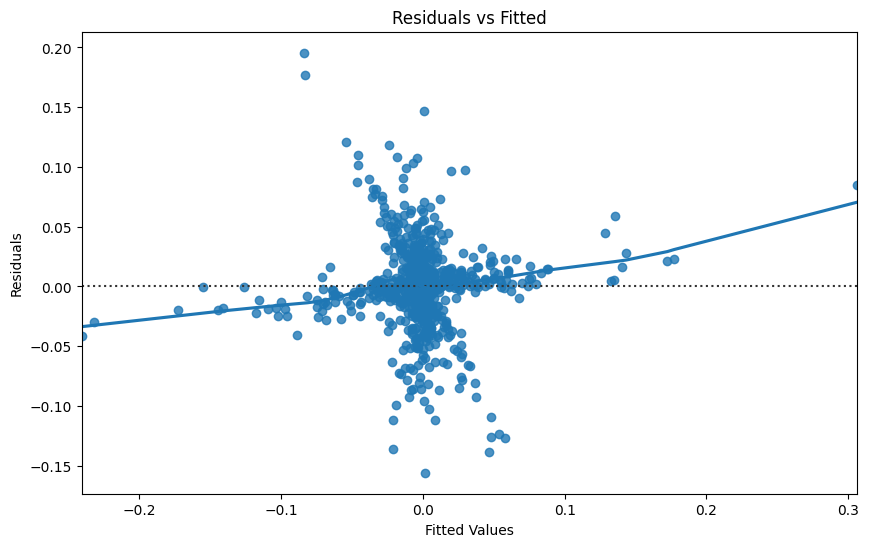

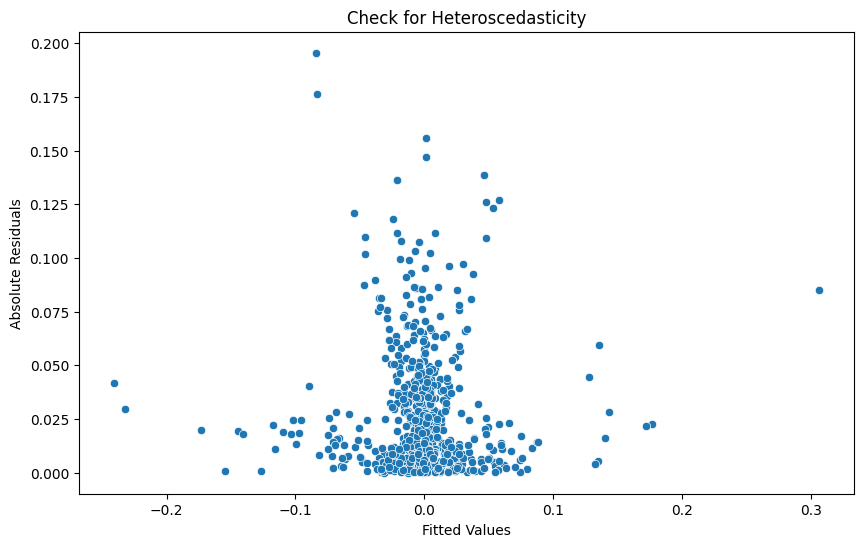

XLM_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.651
Model:                            OLS   Adj. R-squared:                  0.646
Method:                 Least Squares   F-statistic:                     145.7
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          2.71e-154
Time:                        23:31:21   Log-Likelihood:                 1586.8
No. Observations:                 714   AIC:                            -3154.
Df Residuals:                     704   BIC:                            -3108.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

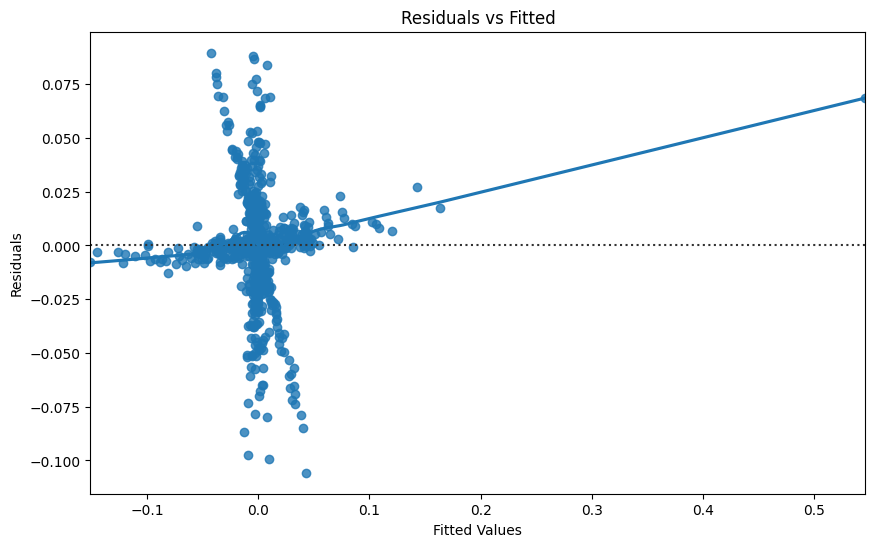

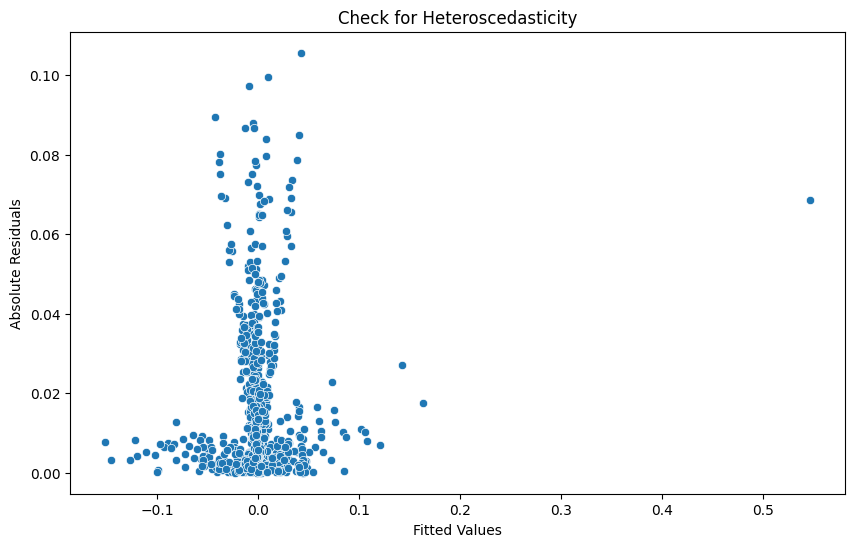

XRP_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.794
Model:                            OLS   Adj. R-squared:                  0.792
Method:                 Least Squares   F-statistic:                     340.5
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          2.48e-236
Time:                        23:31:23   Log-Likelihood:                 1700.4
No. Observations:                 714   AIC:                            -3383.
Df Residuals:                     705   BIC:                            -3342.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          -6.24e-

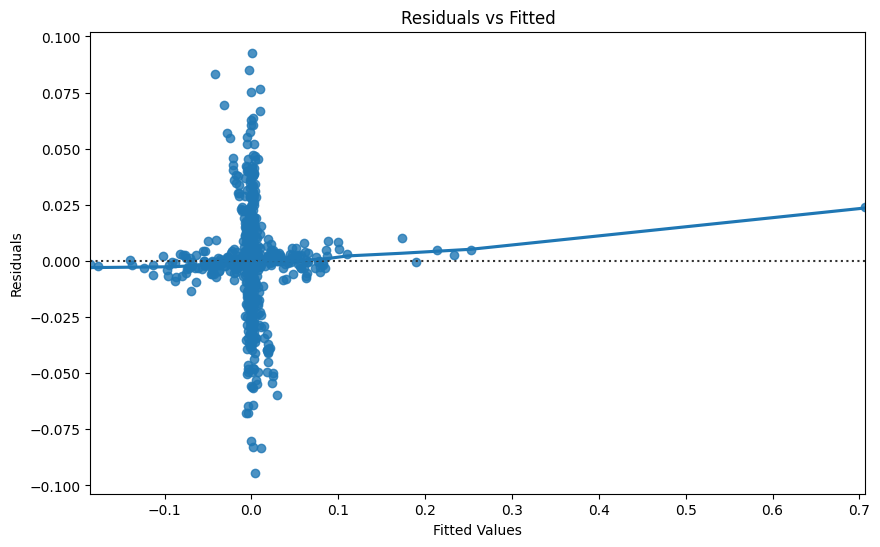

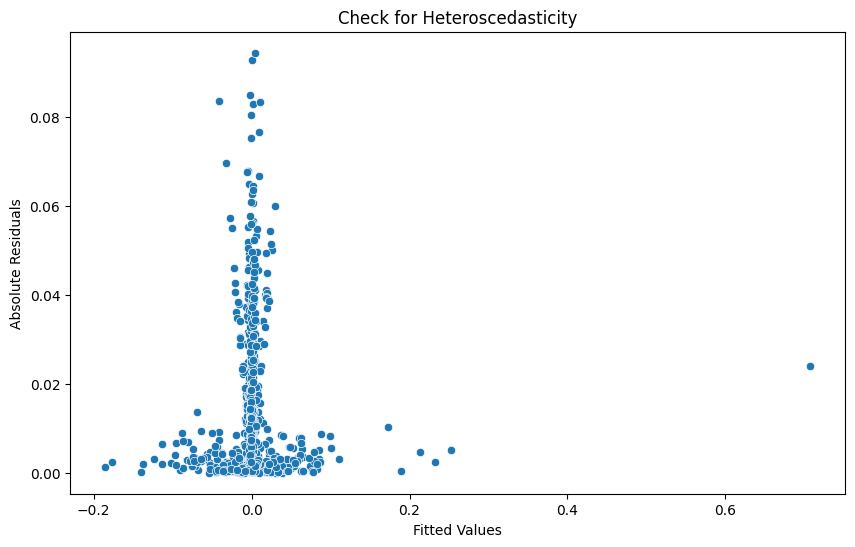

XTZ_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.450
Model:                            OLS   Adj. R-squared:                  0.443
Method:                 Least Squares   F-statistic:                     64.08
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           1.47e-85
Time:                        23:31:24   Log-Likelihood:                 1376.9
No. Observations:                 714   AIC:                            -2734.
Df Residuals:                     704   BIC:                            -2688.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

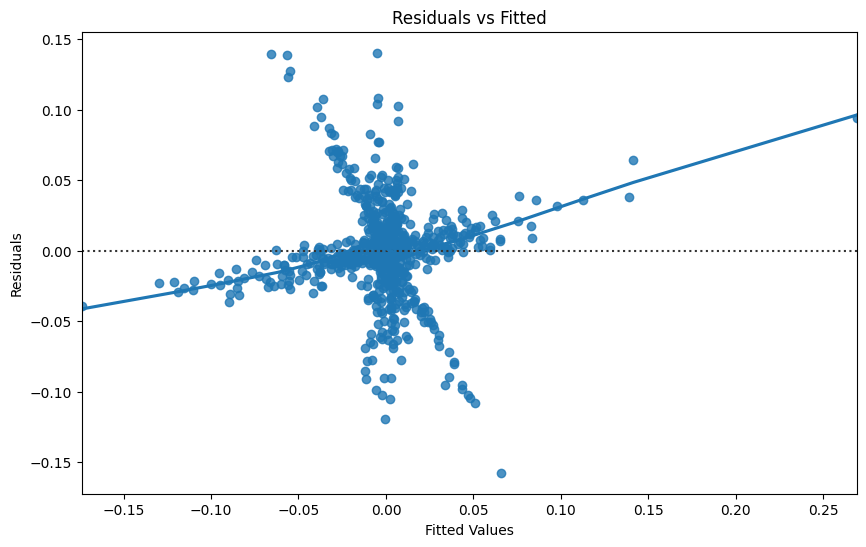

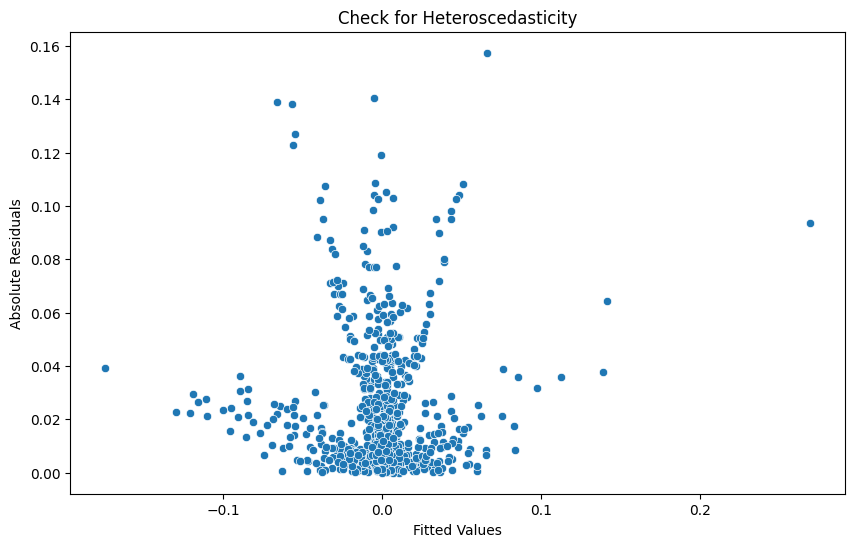

XVG_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.668
Model:                            OLS   Adj. R-squared:                  0.664
Method:                 Least Squares   F-statistic:                     177.1
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          4.60e-163
Time:                        23:31:25   Log-Likelihood:                 1252.7
No. Observations:                 714   AIC:                            -2487.
Df Residuals:                     705   BIC:                            -2446.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap          5.482e-

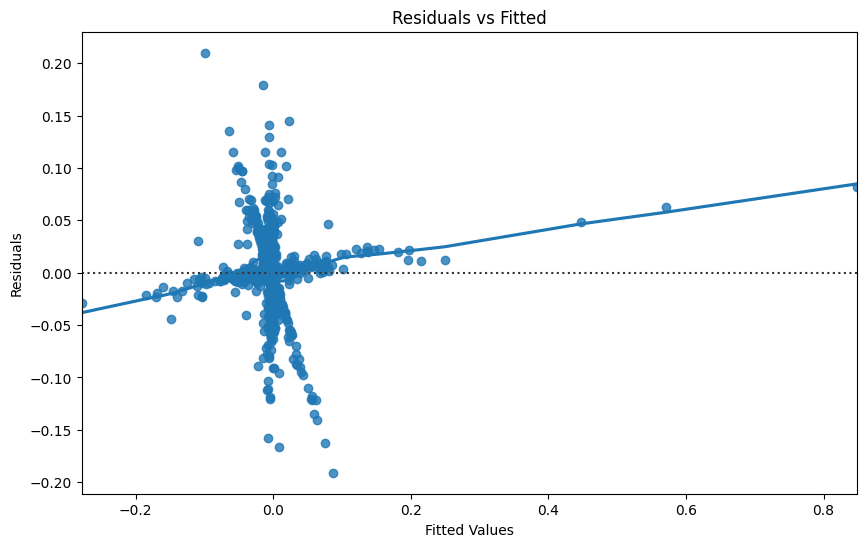

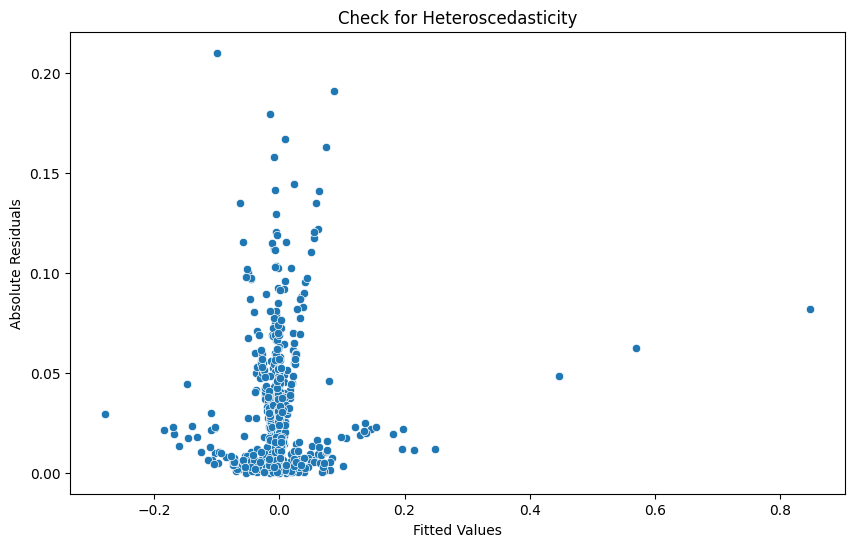

XVS_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.621
Model:                            OLS   Adj. R-squared:                  0.617
Method:                 Least Squares   F-statistic:                     144.5
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          4.42e-143
Time:                        23:31:27   Log-Likelihood:                 1328.7
No. Observations:                 714   AIC:                            -2639.
Df Residuals:                     705   BIC:                            -2598.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Market_Cap         -2.331e-

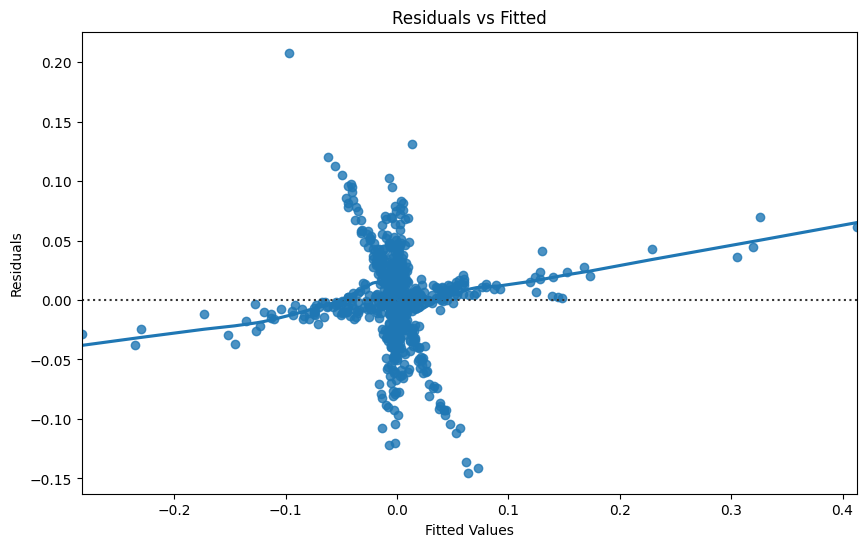

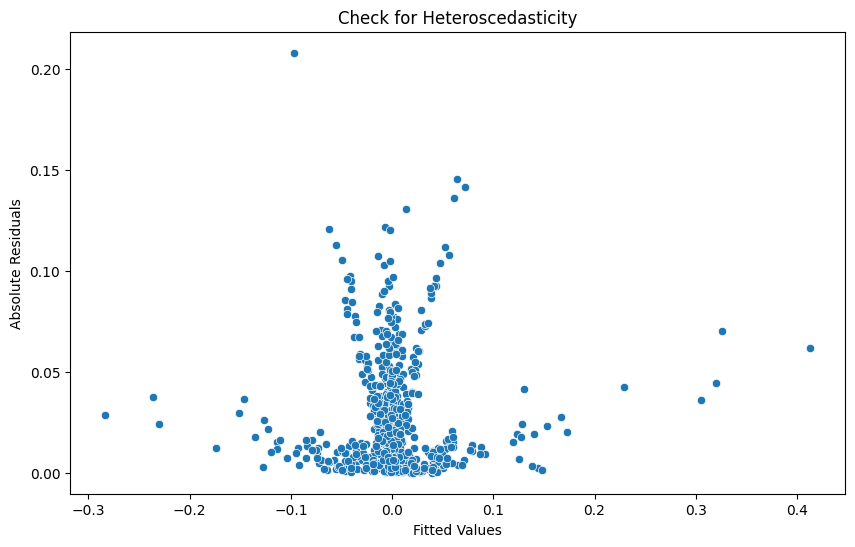

YFI_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.603
Model:                            OLS   Adj. R-squared:                  0.598
Method:                 Least Squares   F-statistic:                     106.9
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          6.65e-134
Time:                        23:31:28   Log-Likelihood:                 1426.6
No. Observations:                 714   AIC:                            -2831.
Df Residuals:                     703   BIC:                            -2781.
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.01

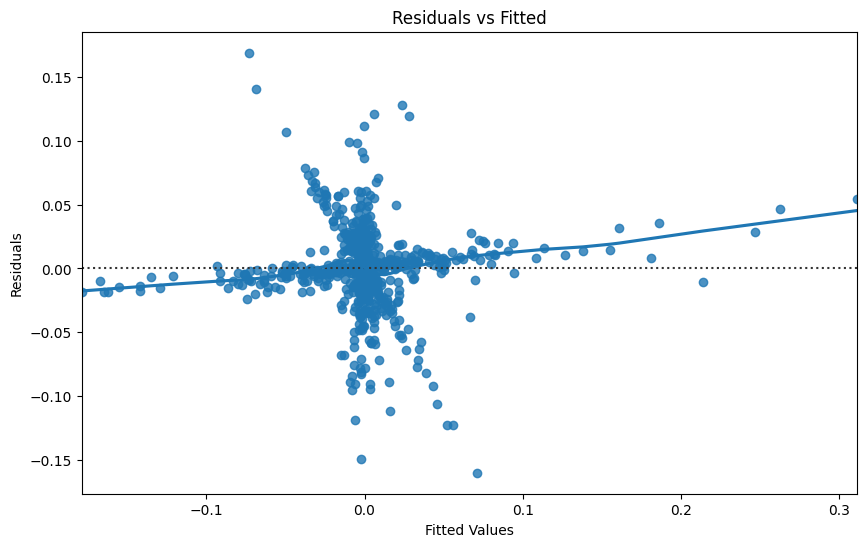

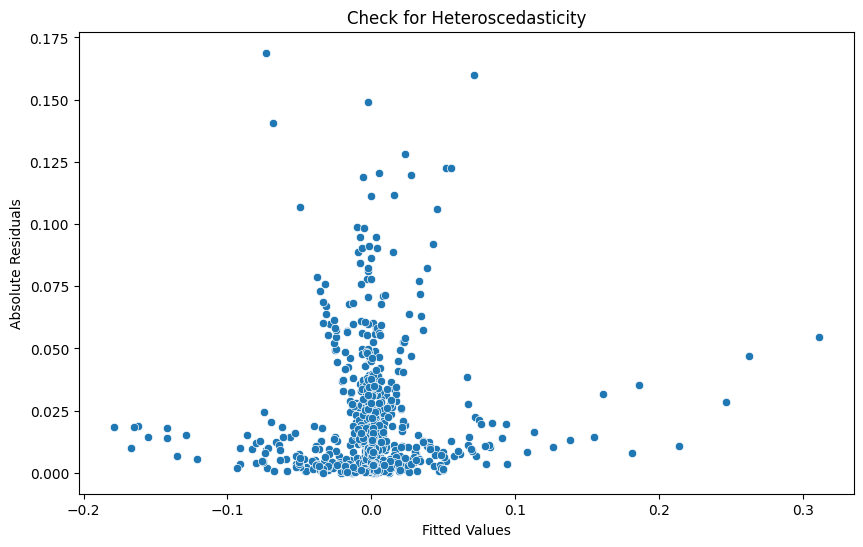

YGG_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.507
Model:                            OLS   Adj. R-squared:                  0.500
Method:                 Least Squares   F-statistic:                     80.38
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          5.94e-102
Time:                        23:31:29   Log-Likelihood:                 1111.7
No. Observations:                 714   AIC:                            -2203.
Df Residuals:                     704   BIC:                            -2158.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.01

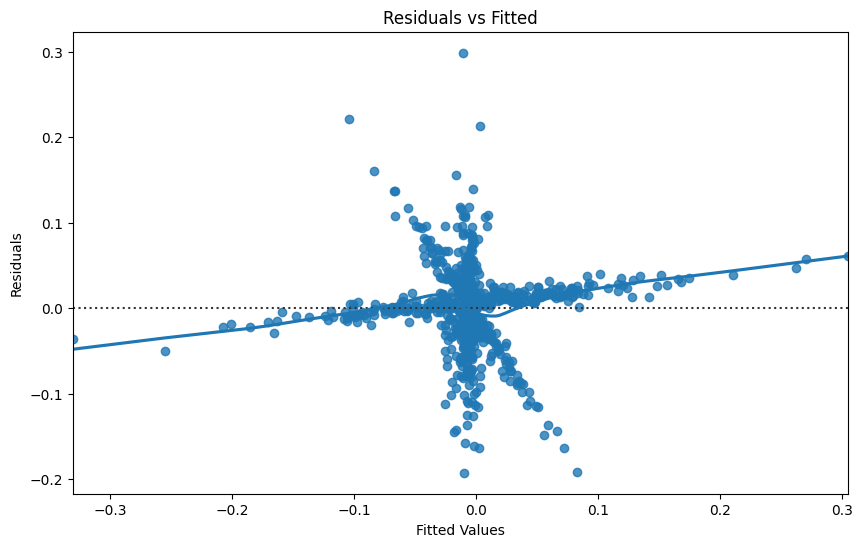

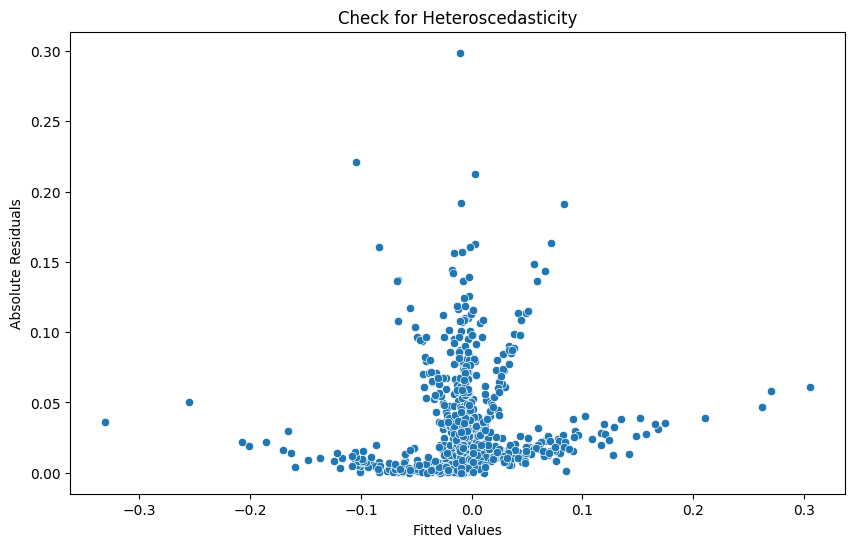

ZEC_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.400
Model:                            OLS   Adj. R-squared:                  0.393
Method:                 Least Squares   F-statistic:                     52.23
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           1.92e-72
Time:                        23:31:31   Log-Likelihood:                 1315.6
No. Observations:                 714   AIC:                            -2611.
Df Residuals:                     704   BIC:                            -2565.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.00

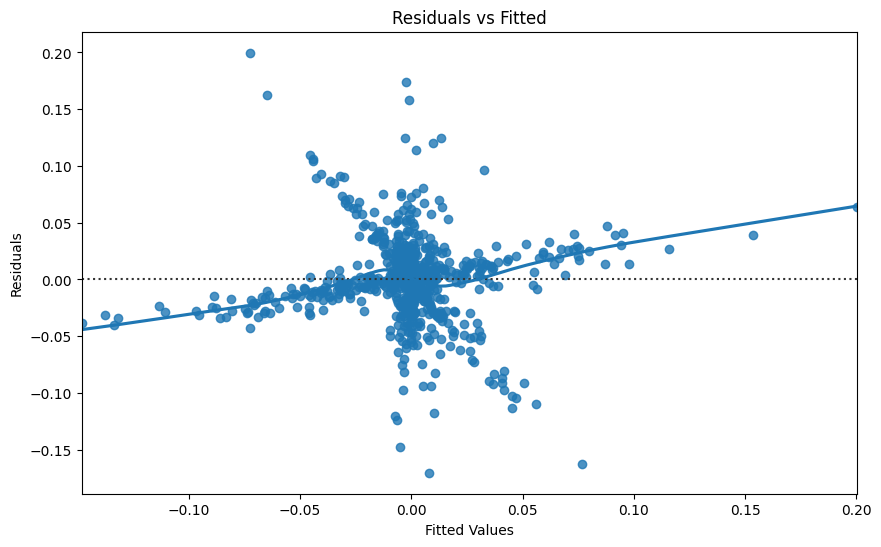

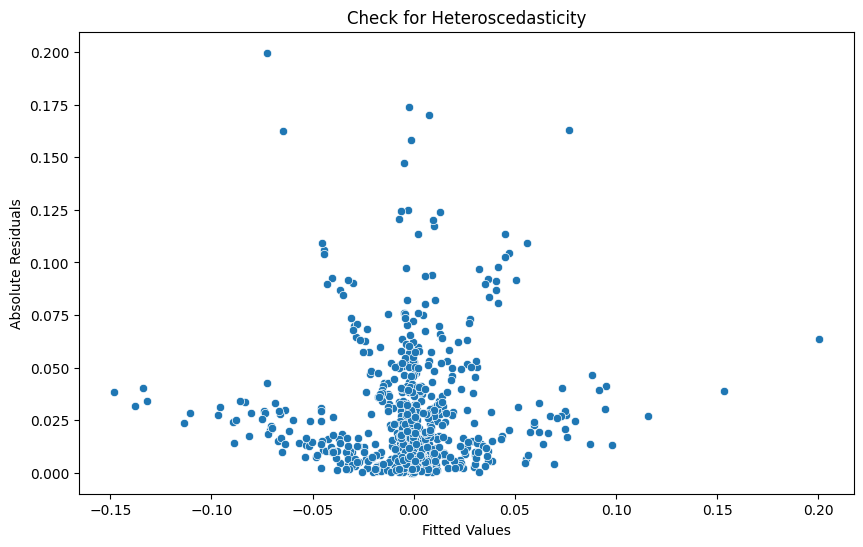

ZEN_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.418
Model:                            OLS   Adj. R-squared:                  0.410
Method:                 Least Squares   F-statistic:                     56.16
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           6.43e-77
Time:                        23:31:33   Log-Likelihood:                 1230.5
No. Observations:                 714   AIC:                            -2441.
Df Residuals:                     704   BIC:                            -2395.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.01

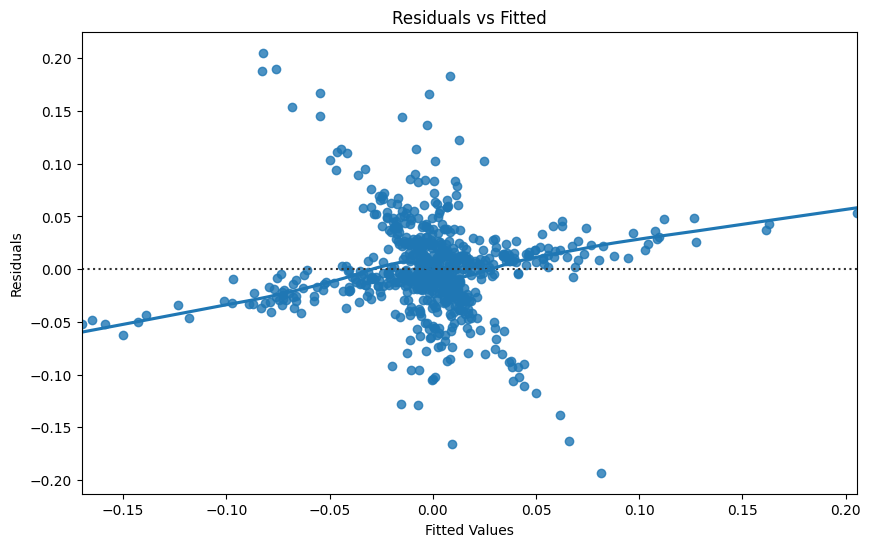

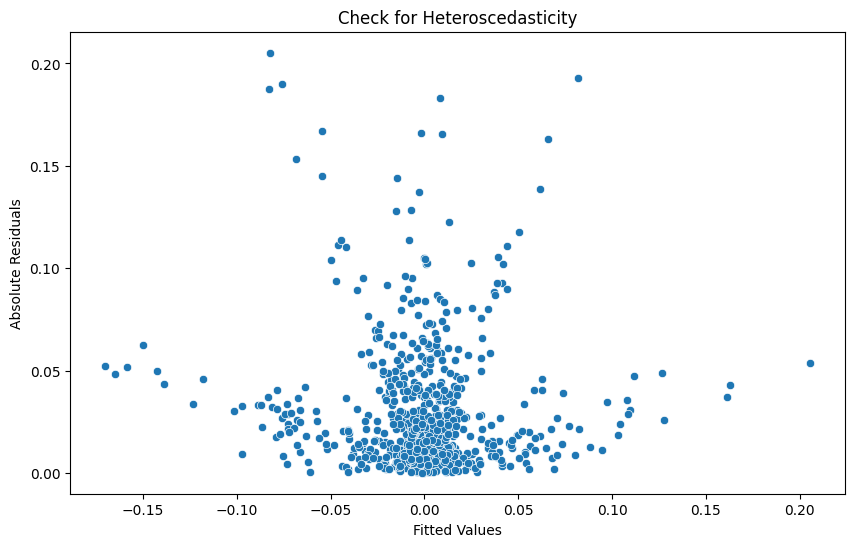

ZIL_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.609
Model:                            OLS   Adj. R-squared:                  0.604
Method:                 Least Squares   F-statistic:                     121.7
Date:                Mon, 26 Aug 2024   Prob (F-statistic):          4.36e-137
Time:                        23:31:34   Log-Likelihood:                 1358.0
No. Observations:                 714   AIC:                            -2696.
Df Residuals:                     704   BIC:                            -2650.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.02

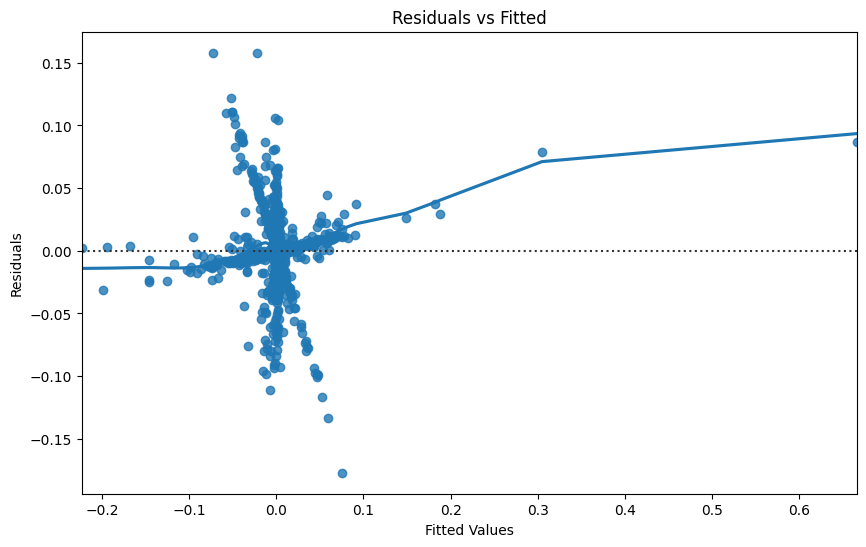

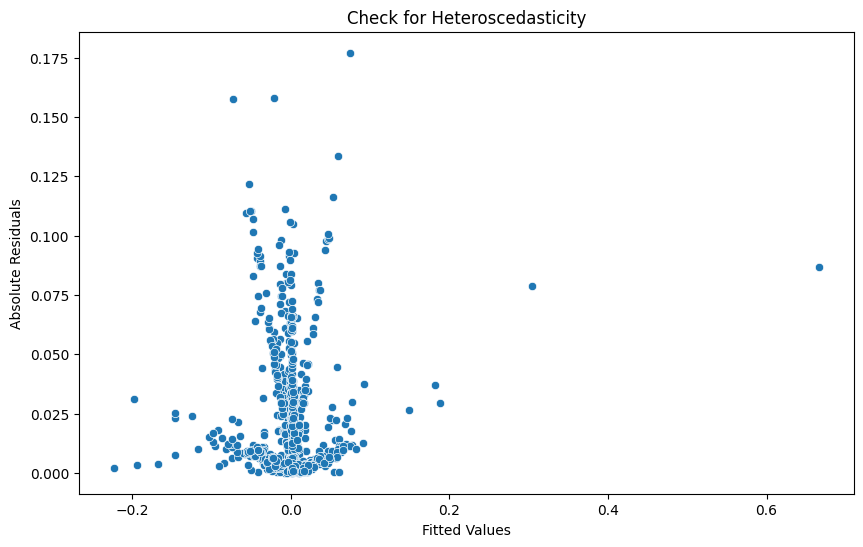

ZRX_USDT
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.476
Model:                            OLS   Adj. R-squared:                  0.469
Method:                 Least Squares   F-statistic:                     71.10
Date:                Mon, 26 Aug 2024   Prob (F-statistic):           7.80e-93
Time:                        23:31:35   Log-Likelihood:                 1238.2
No. Observations:                 714   AIC:                            -2456.
Df Residuals:                     704   BIC:                            -2411.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.02

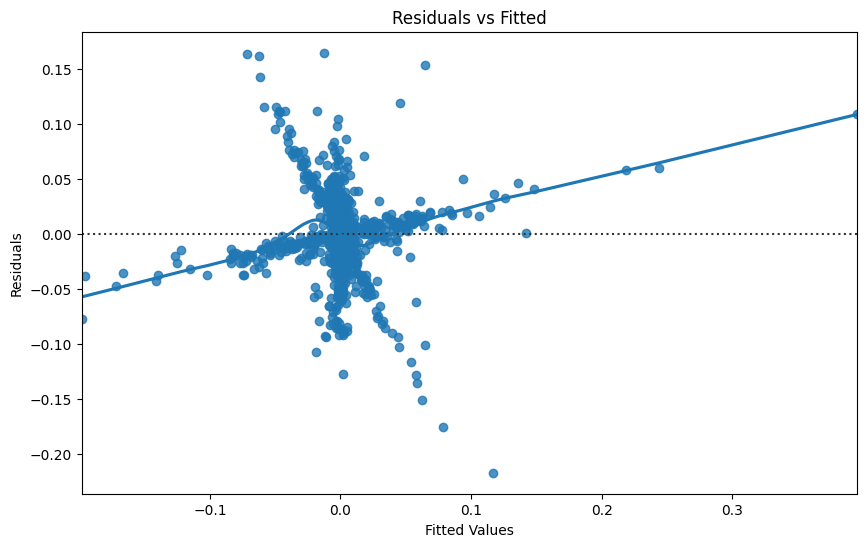

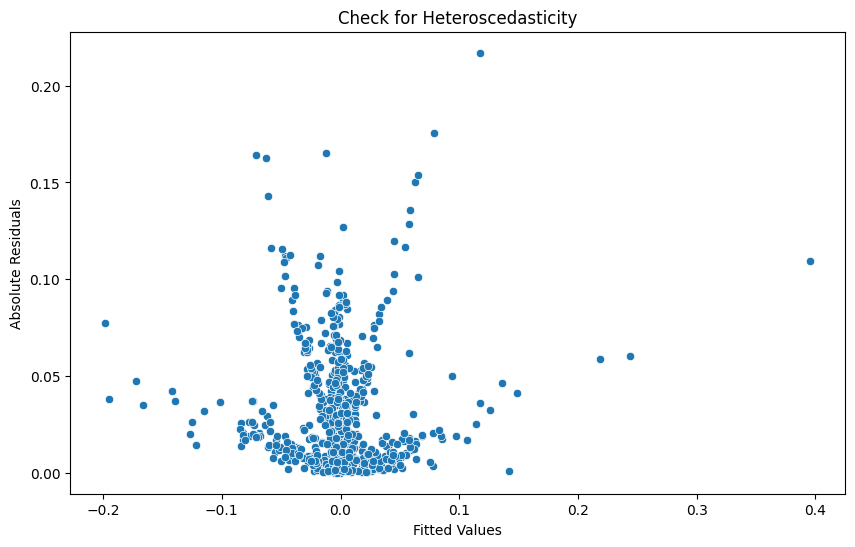

Results and plots have been saved to the output directory.


In [76]:
import os
import pandas as pd
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt

YELLOW_BOLD = "\033[1;33m"
RESET = "\033[0m"

# output_dir = 'econo/output/'
# os.makedirs(output_dir, exist_ok=True)  

path = 'econo/'
for full_name in os.listdir(path):
    name = full_name.split(".")[0]
    print(f"{YELLOW_BOLD}{name}{RESET}")
    
    df = pd.read_csv(path + full_name)
    df['T10YIE'] = df['T10YIE'].replace('.', '0')
    df['T10YIE'] = df['T10YIE'].astype(float)
    
    X = df[['Market_Cap', 'Momentum', 'Volatility', 'Liquidity', 
             'amihud_illiquidity', 
            #  'Market_Factor',
               'size_factor', 
             'NVT', 'HML', 'DFF', 'T10YIE']]
    y = df['return']
    
    X = sm.add_constant(X)
    
    model = sm.OLS(y, X).fit()
    
    # with open(os.path.join(output_dir, f"model_summary.txt"), 'a') as f:
    #     f.write('\n'+name)
    #     f.write(str(model.summary()))
    print(model.summary())
    # Residuals vs Fitted plot
    plt.figure(figsize=(10, 6))
    sns.residplot(x=model.fittedvalues, y=model.resid, lowess=True)
    plt.xlabel('Fitted Values')
    plt.ylabel('Residuals')
    plt.title('Residuals vs Fitted')
    plt.show()
    plt.close()   
    
    # Check for Heteroscedasticity plot
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x=model.fittedvalues, y=abs(model.resid))
    plt.xlabel('Fitted Values')
    plt.ylabel('Absolute Residuals')
    plt.title('Check for Heteroscedasticity')
    plt.show()
    plt.close()  
print("Results and plots have been saved to the output directory.")

unnormalized econo combined 

In [17]:
combined_df[['Market_Cap', 'Momentum', 'Volatility', 'Liquidity', 
            'amihud_illiquidity', 'Bid Price', 'Ask Price', 'Bid Depth', 'Ask Depth',
            'Bid-Ask Spread',
            # 'Market_Factor', 
            'T10YIE','DFF', 'size_factor', 'NVT', 'HML', ]].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 89965 entries, 0 to 89964
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Market_Cap          89965 non-null  float64
 1   Momentum            89965 non-null  float64
 2   Volatility          89965 non-null  float64
 3   Liquidity           89965 non-null  float64
 4   amihud_illiquidity  89965 non-null  float64
 5   Bid Price           89965 non-null  float64
 6   Ask Price           89965 non-null  float64
 7   Bid Depth           89965 non-null  float64
 8   Ask Depth           89965 non-null  float64
 9   Bid-Ask Spread      89965 non-null  float64
 10  T10YIE              89965 non-null  object 
 11  DFF                 89965 non-null  float64
 12  size_factor         89965 non-null  int64  
 13  NVT                 89965 non-null  float64
 14  HML                 89965 non-null  float64
dtypes: float64(13), int64(1), object(1)
memory usage: 10.

Index(['DATE_x', 'T10YIE', 'DATE_y', 'DFF', 'Timestamp', 'Open', 'High', 'Low',
       'Close', 'Volume', 'Bid Price', 'Ask Price', 'Bid Depth', 'Ask Depth',
       'Bid-Ask Spread', 'return', 'Market_Cap', 'Momentum', 'Volatility',
       'Liquidity', 'amihud_illiquidity', 'Market_Factor', 'Size',
       'size_factor', 'Date', 'NVT', 'NVT_rank', 'HML', 'Crypto'],
      dtype='object')
                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.542
Model:                            OLS   Adj. R-squared:                  0.542
Method:                 Least Squares   F-statistic:                     8196.
Date:                Mon, 26 Aug 2024   Prob (F-statistic):               0.00
Time:                        10:46:01   Log-Likelihood:             1.6224e+05
No. Observations:               89965   AIC:                        -3.244e+05
Df Residuals:                   89951   BIC:              

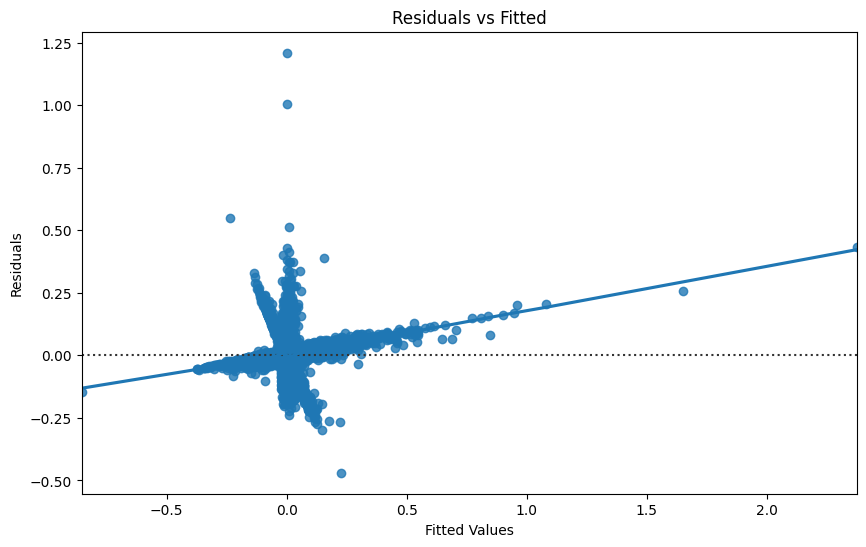

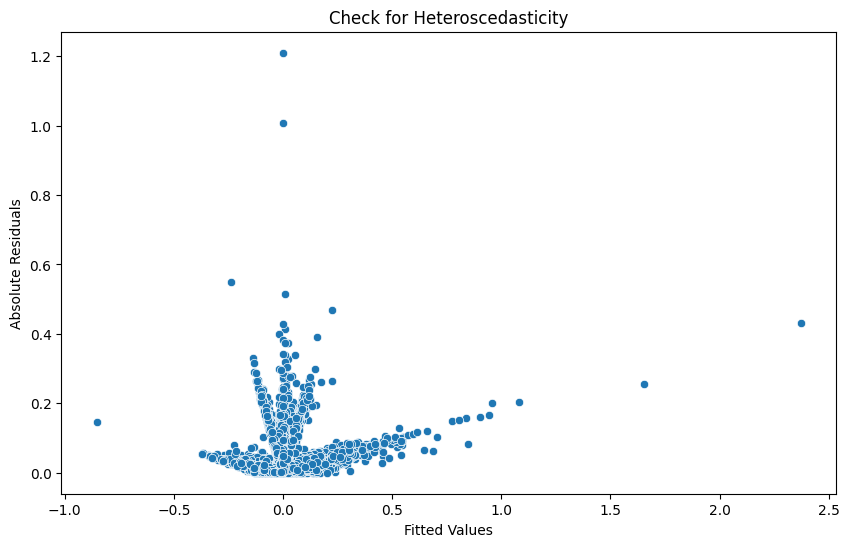

Results and plots have been saved to the output directory.


In [19]:
import os
import pandas as pd
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt
# output_dir = 'econo/combined/'
# os.makedirs(output_dir, exist_ok=True)  

YELLOW_BOLD = "\033[1;33m"
RESET = "\033[0m"
combined_df = pd.read_csv('econo_combined.csv')
print(combined_df.columns)
combined_df.replace('.','0', inplace=True)
combined_df['T10YIE'] = combined_df['T10YIE'].astype(float)
combined_df.fillna(0, inplace=True)
X = combined_df[['Market_Cap', 'Momentum', 'Volatility', 'Liquidity', 
            'amihud_illiquidity', 'Bid Price', 'Ask Price', 'Bid Depth', 'Ask Depth',
            'Bid-Ask Spread',
            # 'Market_Factor', 
            'T10YIE','DFF', 'size_factor', 'NVT', 'HML', ]]
y = combined_df['return']

X = sm.add_constant(X)

model = sm.OLS(y, X).fit()
print(model.summary())
# with open(os.path.join(output_dir, f"model_summary.txt"), 'a') as f:
#     f.write('\n'+name)
#     f.write(str(model.summary()))
# Residuals vs Fitted plot
plt.figure(figsize=(10, 6))
sns.residplot(x=model.fittedvalues, y=model.resid, lowess=True)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Residuals vs Fitted')
plt.show()
plt.close()   

# Check for Heteroscedasticity plot
plt.figure(figsize=(10, 6))
sns.scatterplot(x=model.fittedvalues, y=abs(model.resid))
plt.xlabel('Fitted Values')
plt.ylabel('Absolute Residuals')
plt.title('Check for Heteroscedasticity')
plt.show()
plt.close()  
print("Results and plots have been saved to the output directory.")

normalized econo combined 

                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.542
Model:                            OLS   Adj. R-squared:                  0.542
Method:                 Least Squares   F-statistic:                     7104.
Date:                Mon, 26 Aug 2024   Prob (F-statistic):               0.00
Time:                        11:43:44   Log-Likelihood:             2.8244e+05
No. Observations:               89965   AIC:                        -5.649e+05
Df Residuals:                   89949   BIC:                        -5.647e+05
Df Model:                          15                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.0431      0

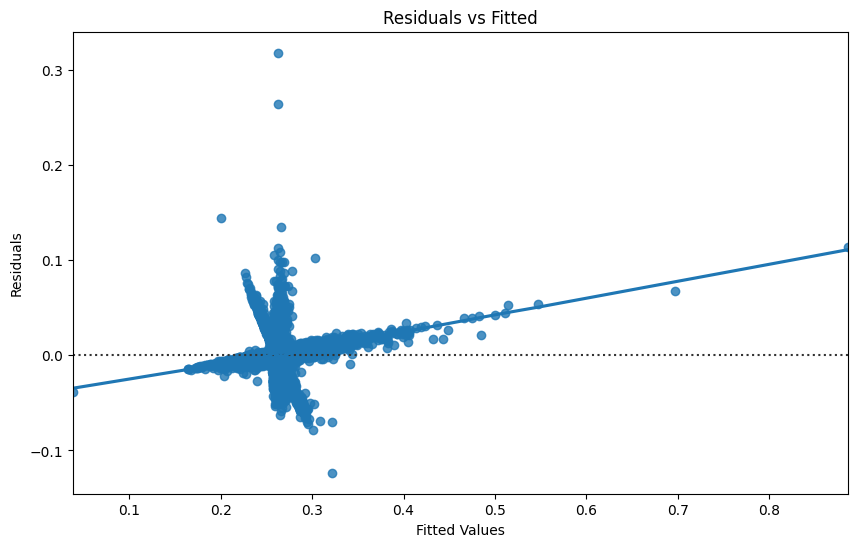

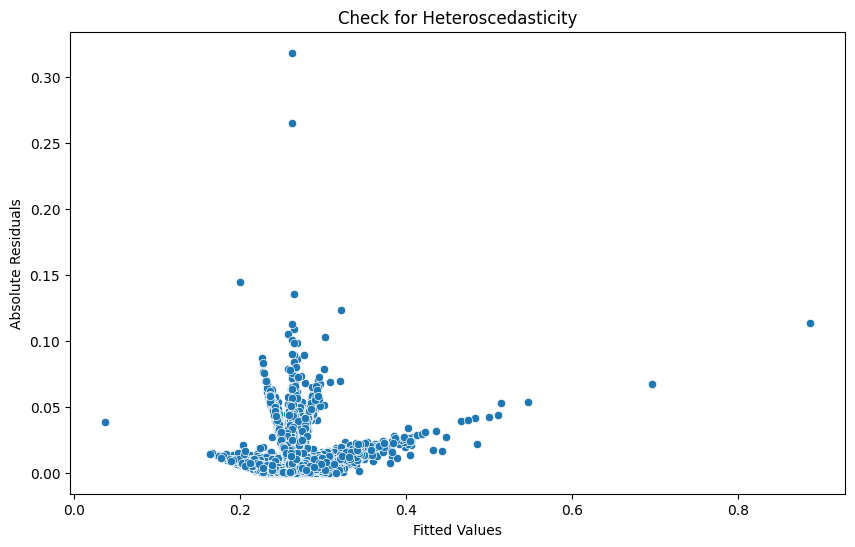

Results and plots have been saved to the output directory.


In [24]:

from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler

# Initialize StandardScaler
scaler = MinMaxScaler()

# Apply standardization

output_dir = 'econo/combined/'
os.makedirs(output_dir, exist_ok=True)  

YELLOW_BOLD = "\033[1;33m"
RESET = "\033[0m"
combined_df = pd.read_csv('econo_combined.csv')
combined_df.replace('.','0', inplace=True)
combined_df['T10YIE'] = combined_df['T10YIE'].astype(float)
combined_df['DFF'] = combined_df['DFF'].astype(float)
combined_df.fillna(0, inplace=True)
columns = ['Market_Cap', 'Momentum', 'Volatility', 'Liquidity', 
            'amihud_illiquidity', 'Bid Price', 'Ask Price', 'Bid Depth', 'Ask Depth',
            'Bid-Ask Spread',
            # 'Market_Factor', 
            'T10YIE','DFF', 'size_factor', 'NVT', 'HML', 'return' ]
df_standardized = pd.DataFrame(scaler.fit_transform(combined_df[columns]), columns=columns)

X = df_standardized[['Market_Cap', 'Momentum', 'Volatility', 'Liquidity', 
            'amihud_illiquidity', 'Bid Price', 'Ask Price', 'Bid Depth', 'Ask Depth',
            'Bid-Ask Spread',
            # 'Market_Factor', 
            'T10YIE','DFF', 'size_factor', 'NVT', 'HML',  ]]
y = df_standardized['return']

X = sm.add_constant(X)

model = sm.OLS(y, X).fit()
print(model.summary())
with open(os.path.join(output_dir, f"model_summary.txt"), 'a') as f:
    f.write('\n'+name)
    f.write(str(model.summary()))
# Residuals vs Fitted plot
plt.figure(figsize=(10, 6))
sns.residplot(x=model.fittedvalues, y=model.resid, lowess=True)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Residuals vs Fitted')
plt.show()
plt.close()   

# Check for Heteroscedasticity plot
plt.figure(figsize=(10, 6))
sns.scatterplot(x=model.fittedvalues, y=abs(model.resid))
plt.xlabel('Fitted Values')
plt.ylabel('Absolute Residuals')
plt.title('Check for Heteroscedasticity')
plt.show()
plt.close()  
print("Results and plots have been saved to the output directory.")

google trends combined

                            OLS Regression Results                            
Dep. Variable:                 return   R-squared:                       0.317
Model:                            OLS   Adj. R-squared:                  0.317
Method:                 Least Squares   F-statistic:                     930.1
Date:                Mon, 26 Aug 2024   Prob (F-statistic):               0.00
Time:                        09:59:30   Log-Likelihood:                 28626.
No. Observations:               16016   AIC:                        -5.723e+04
Df Residuals:                   16007   BIC:                        -5.717e+04
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.0017      0

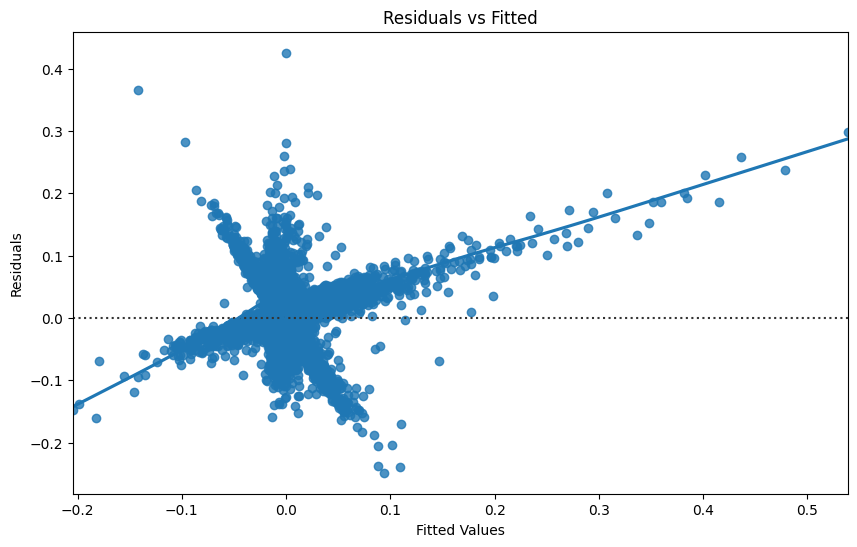

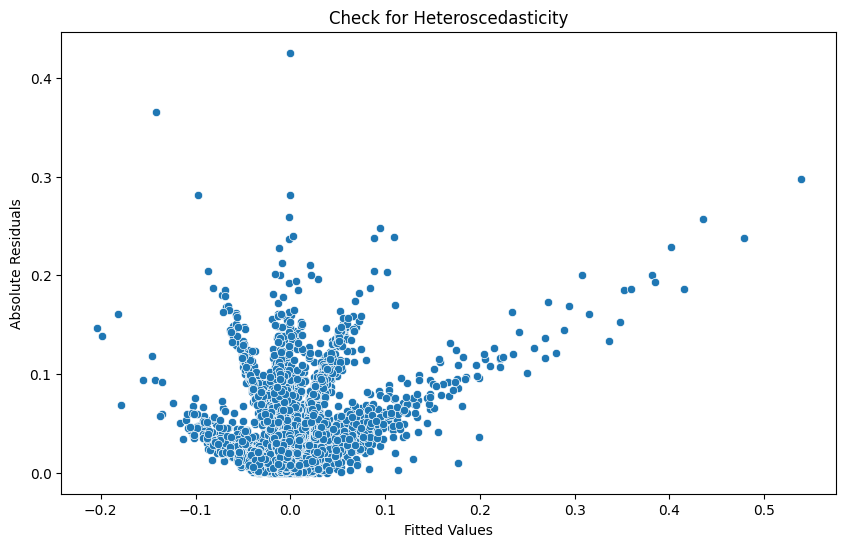

Results and plots have been saved to the output directory.


In [4]:
import os
import pandas as pd
import statsmodels.api as sm
import seaborn as sns
import matplotlib.pyplot as plt

YELLOW_BOLD = "\033[1;33m"
RESET = "\033[0m"

combined_df.fillna(0, inplace=True)
X = combined_df[['Market_Cap', 'Momentum', 'Volatility', 'Liquidity', 
            'amihud_illiquidity', 
            # 'Market_Factor', 
            'size_factor', 
            'NVT', 'HML', 'google_trend']]
y = combined_df['return']

X = sm.add_constant(X)

model = sm.OLS(y, X).fit()
print(model.summary())

# Residuals vs Fitted plot
plt.figure(figsize=(10, 6))
sns.residplot(x=model.fittedvalues, y=model.resid, lowess=True)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Residuals vs Fitted')
plt.show()
plt.close()   

# Check for Heteroscedasticity plot
plt.figure(figsize=(10, 6))
sns.scatterplot(x=model.fittedvalues, y=abs(model.resid))
plt.xlabel('Fitted Values')
plt.ylabel('Absolute Residuals')
plt.title('Check for Heteroscedasticity')
plt.show()
plt.close()  
print("Results and plots have been saved to the output directory.")